In [1]:
import matplotlib.pyplot as plt
import numpy as np
import math 
import sklearn.preprocessing 
import random
import yaml
import h5py
import logging
import datetime
import os
import time

import pprint
from tqdm import tqdm_notebook as tqdm

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, SequentialSampler, BatchSampler
import torch.nn.functional as F


from load_matlab_timedata import get_data_from
from src.TSGenerator import f_Y, f_X, get_func_timeseries
from src.DataLoader import TimeSeriesDataset
from src.model_utils import init_logger, plot_shared_scale, plot_multiscale
from src.Model import LSTM
from src.Losses import myLoss, aux_loss_jordan, prognose_dy

from torch.optim.lr_scheduler import ReduceLROnPlateau  


## Loading config files, setup execution parameters, init objects

In [2]:
plt.rcParams['figure.figsize'] = 20, 7.
CONFIG_FILENAME = "model_params_jordan.yaml"
# ! ls DC_motor_simulation
with open(CONFIG_FILENAME, 'r') as f:
        config = yaml.load(f, Loader=yaml.FullLoader)
   
pprint.pprint(config)


p_net = config['network_params']

p_train = config['train_params']

p_gen = config['generator_params']

p_data = config['data_params']
need_normalize = p_data['need_normalize']

{'data_params': {'integration_step': 0.01,
                 'leave_nth': 13,
                 'mat_file': 'DC_motor_simulation/res_hyster_and_eddy_u_8_15_5.mat',
                 'need_normalize': True,
                 'test_size': 0.3,
                 'use_part_of_data': 1.0},
 'exp_path': 'only_batches',
 'generator_params': {'a': 0.5, 'b': 1.0, 'f_X': 'math.sin', 'f_Y': 'math.cos'},
 'is_debug': False,
 'network_params': {'dtype': 'torch.float',
                    'hidden_size': 16,
                    'input_size': 64,
                    'num_layers': 1,
                    'output_dim': 3,
                    'per_element': True,
                    'retrospective_steps': 64},
 'to_generate_data': False,
 'train_params': {'auto_loss': True,
                  'aux_loss': {'part_of_max_for_const': 0.05,
                               'scaling_order': 7,
                               'steady_state_threshold': 0.001},
                  'batch_size': 1024,
                  'core_

# Set parameters

In [3]:

# # If `per_element` is True, then LSTM reads in one timestep at a time.
if  p_net['per_element']:
    lstm_input_size = 1
else:
    lstm_input_size = p_net['input_size']
    
# if is_debug:
#     x, y = get_func_timeseries(f_Y = f_Y, f_X = f_X, a=p_generate['a'], b=p_generate['b'])
to_generate_data = config['to_generate_data'] 
if to_generate_data:
    p_gen = config['generator_params']
    print("Data generator params:")
    pprint.pprint(p_gen)
    a = p_gen['a']
    b = p_gen['b']
is_debug = config['is_debug']


init_logger(config)

logging.info("Experiment started with params")
logging.info(f"data_par: {p_data}")
logging.info(f"net_par: {p_net}")
logging.info(f"train_par: {p_train}") 

logger inited to file [only_batcheslogs/exp_2019-05-12_19:25:05.log]


## Init data loader and get appropriate part of data

## Creating objects from imported files

In [4]:
from src.Model import LSTM, LSTM_jordan
from src.Losses import myLoss, prognose_dy, myLoss_jordan  # imports here for faster rerun and debug procedure

model = LSTM_jordan(lstm_input_size,
             p_net['hidden_size'],
             batch_size=p_train['batch_size'],
            jordan_params=2,
             output_dim=1,
             num_layers=p_net['num_layers'])

loss_fn = myLoss_jordan


In [5]:
for name, parameter in model.named_parameters():
    print(name, '\t\t', parameter.shape)

jordan 		 torch.Size([1, 2])
lstm.weight_ih_l0 		 torch.Size([64, 3])
lstm.weight_hh_l0 		 torch.Size([64, 16])
lstm.bias_ih_l0 		 torch.Size([64])
lstm.bias_hh_l0 		 torch.Size([64])
linear.weight 		 torch.Size([1, 16])
linear.bias 		 torch.Size([1])


In [6]:
p_optim = p_train['optimizer']

if p_optim['optimizer'] == "adam":
    optimizer = torch.optim.Adam(
        [
                {
                    'params': model.jordan,
                    'lr': p_optim['jordan']['lr'],
                    'weight_decay':p_optim['jordan']['wd']
                },
                {
                    'params': model.lstm.parameters(), 
                    'lr': p_optim['lstm']['lr'],
                    'weight_decay':p_optim['lstm']['wd']
                },
                {
                    'params': model.linear.parameters(),
                    'lr': p_optim['linear']['lr'],
                    'weight_decay':p_optim['linear']['wd']
                }
            ]
    )

logging.info(f"Model n params: {model.get_num_params()}")
print(f"model has [{model.get_num_params()}] params")
num_epochs = p_train['num_epochs']
logging.info("Training process INITIALIZED")
optimizer

model has [1363.0] params


Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.01
    weight_decay: 0

Parameter Group 1
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0

Parameter Group 2
    amsgrad: False
    betas: (0.9, 0.999)
    eps: 1e-08
    lr: 0.001
    weight_decay: 0
)

In [7]:
p_sched = p_train['lr_scheduler']
scheduler = ReduceLROnPlateau(optimizer=optimizer,
                              mode='min',
                              factor=p_sched['lr_drop'],
                              patience=p_sched['patience'],
                              cooldown=p_sched['cooldown'],
                              threshold=p_sched['threshold'],
                              threshold_mode='rel',
                              min_lr=10**p_sched['early_stop_order'],
                             verbose=True
                             )
print("LR scheduler set_uped")
scheduler.state_dict()

LR scheduler set_uped


{'factor': 0.3,
 'min_lrs': [1e-08, 1e-08, 1e-08],
 'patience': 4,
 'verbose': True,
 'cooldown': 4,
 'cooldown_counter': 0,
 'mode': 'min',
 'threshold': 0.001,
 'threshold_mode': 'rel',
 'best': inf,
 'num_bad_epochs': 0,
 'mode_worse': inf,
 'eps': 1e-08,
 'last_epoch': -1}

In [8]:
sample_x= torch.rand([p_net['retrospective_steps'], p_train['batch_size'], 1])
y, pars = model(sample_x)

In [9]:
sample_x.shape


torch.Size([64, 1024, 1])

In [10]:
# a = torch.cat((sample_x, sample_x, sample_x), dim=2)
# a.shape

In [11]:
# y.shape

using 1.0 of data
X normalized, norms: [14.99712541]
x shape (76924, 1)
x_normalized shaoe (76924, 1)


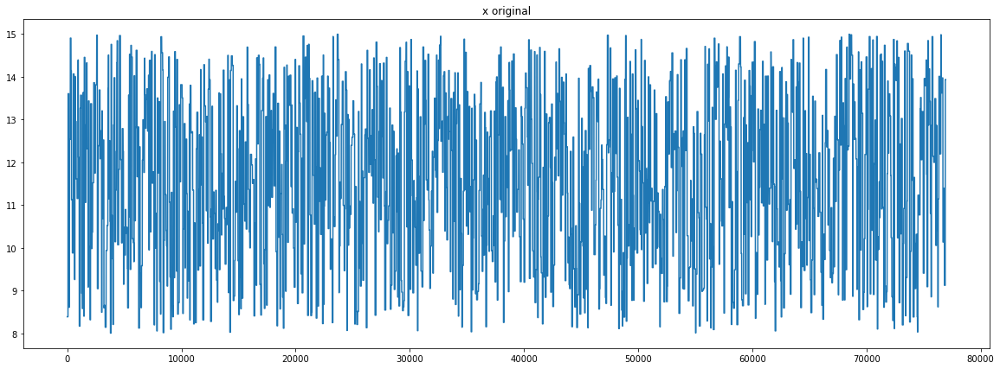

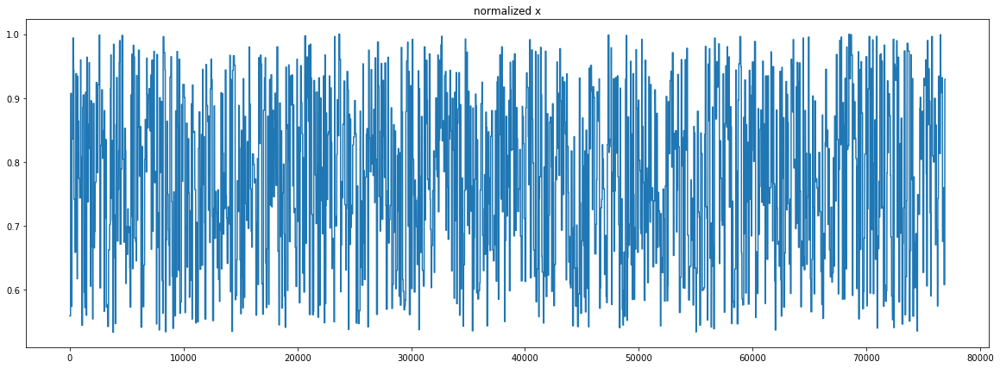

Y normalized, norms: [0.01466037]
input shape (76924, 1)
input partition shape (23078, 1)
output partition shape (23078, 1)
stacked Y shape  (23014, 1)
Y_tensor torch.Size([23014, 1])
X_tensor torch.Size([64, 23013, 1])
X normalized, norms: [14.99712541]
x shape (76924, 1)
x_normalized shaoe (76924, 1)


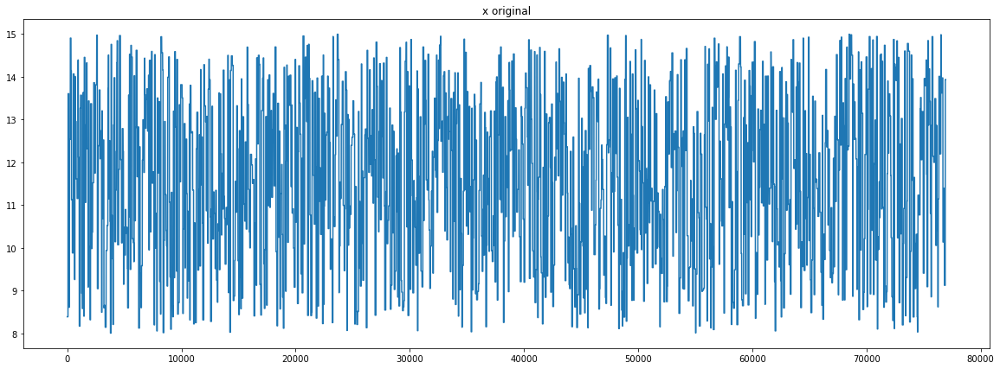

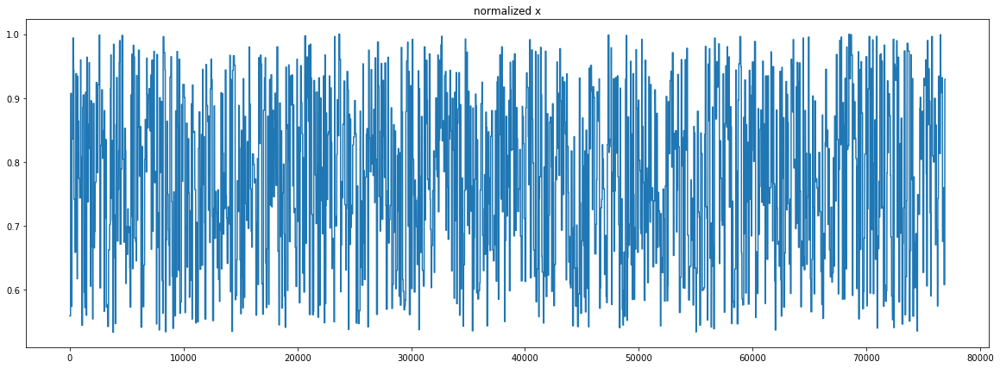

Y normalized, norms: [0.01466037]
input shape (76924, 1)
input partition shape (53846, 1)
output partition shape (53846, 1)
stacked Y shape  (53782, 1)
Y_tensor torch.Size([53782, 1])
X_tensor torch.Size([64, 53781, 1])
train set: [53782] batches
test set: [23014] batches
data_loading time 28.463313817977905 secs


In [12]:
# todo add time tracking for this cell
use_part = p_data['use_part_of_data']
print(f"using {use_part} of data")

t_tick = time.time()

test_ts_ds = TimeSeriesDataset(config=config,
                               partition=(use_part - use_part*p_data['test_size'], use_part),                        
                               logging=logging)

train_ts_ds = TimeSeriesDataset(config=config,
                                partition=(0, use_part - use_part*p_data['test_size']),
                                logging=logging)

print(f"train set: [{len(train_ts_ds)}] batches")
print(f"test set: [{len(test_ts_ds)}] batches")

if need_normalize:
    config['x_norm'] = train_ts_ds.x_norms[0]
    config['y_norm'] = train_ts_ds.y_norms[0]
    config['x_norm']
else:
    config['x_norm'] = 1
    config['y_norm'] = 1
    config['x_norm']

train_dl = DataLoader(dataset = train_ts_ds,
                      batch_sampler = BatchSampler(
                          sampler = SequentialSampler(train_ts_ds), 
                          batch_size = p_train['batch_size'],
                          drop_last = True)
                     )
test_dl = DataLoader(dataset = test_ts_ds,
                     batch_sampler = BatchSampler(
                     sampler = SequentialSampler(test_ts_ds), 
                     batch_size = p_train['batch_size'], 
                     drop_last = True)
                    )    
    
t_tock = time.time()
dataload_time = t_tock - t_tick
print(f"data_loading time {dataload_time} secs")

## Inspecting data we have, get several batches and look inside on pretty large scale to see individual iterations:

x [batch_size, retrospective_steps, channels] :torch.Size([1024, 64, 1])
y [batch_size, channels]: torch.Size([1024, 1])
y_last [slice_size]: (150,)


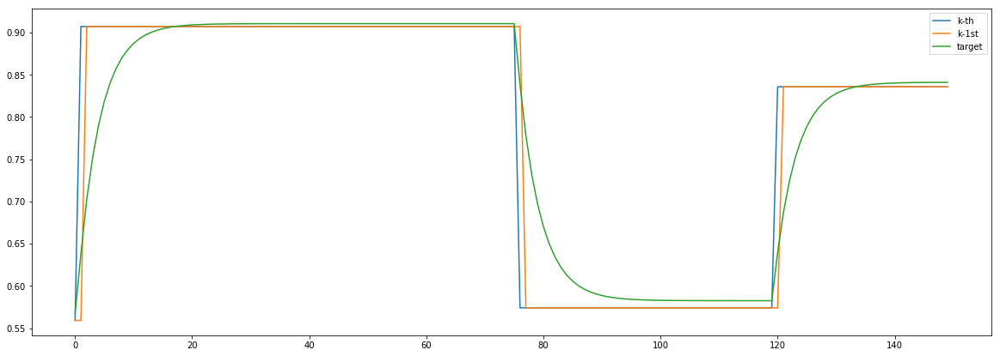

x [batch_size, retrospective_steps, channels] :torch.Size([1024, 64, 1])
y [batch_size, channels]: torch.Size([1024, 1])
y_last [slice_size]: (150,)


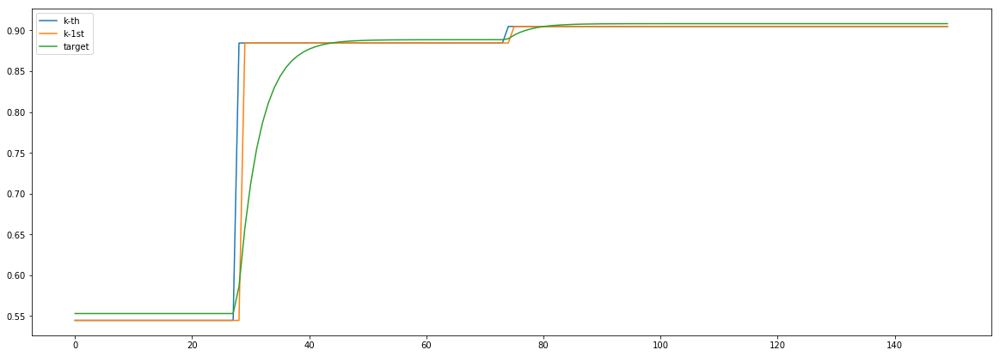

In [13]:
f, t = 0, 150
for i, batch in enumerate(train_dl):
    x, y, ind = batch
    print(f"x [batch_size, retrospective_steps, channels] :{x.shape}")
    print(f"y [batch_size, channels]: {y.shape}")
    y_kth = y.detach().numpy()[f:t, 0]
    print(f"y_last [slice_size]: {y_kth.shape}")
    x = x.transpose(0,1)
    plt.plot(x.detach().numpy()[-1][f:t], label='k-th')
    plt.plot(x.detach().numpy()[-2][f:t], label='k-1st')
    plt.plot(y_kth, label='target')
    plt.legend()
    plt.show()
    if i == 1:
        break

In [14]:
# #####################
# # 
# #####################
# from torch.nn import init
# for layer_p in a._all_weights:
#     for p in layer_p:
#         if 'weight' in p:
#             # print(p, a.__getattr__(p))
#             init.normal(a.__getattr__(p), 0.0, 0.02)

In [15]:
logging.info("History INITIALIZED")

hist = {
    
    "train":{
        "batches":{
            "main":np.zeros(len(train_dl)),
            "aux":np.zeros(len(train_dl)),
            "jordan":np.zeros(len(train_dl))
        },
        "epochs":{
            "main":np.zeros(num_epochs),
            "aux":np.zeros(num_epochs),
            "jordan":np.zeros(num_epochs)
        }
    },
    
    "eval_train":{
        "batches":{
            "main":np.zeros(len(train_dl)),
            "aux":np.zeros(len(train_dl)),
            "jordan":np.zeros(len(train_dl))
        },
        "epochs":{
            "main":np.zeros(num_epochs),
            "aux":np.zeros(num_epochs),
            "jordan":np.zeros(num_epochs)
        }
    },
    
    "eval_test":{
        "batches":{
            "main":np.zeros(len(test_dl)),
            "aux":np.zeros(len(test_dl)),
            "jordan":np.zeros(len(test_dl))
        },
        "epochs":{
            "main":np.zeros(num_epochs),
            "aux":np.zeros(num_epochs),
            "jordan":np.zeros(num_epochs)
        }
    },
    
    'mean_params_sample':
    {
        '1':np.zeros(num_epochs),
        '2':np.zeros(num_epochs),            
    },
    'lr': np.zeros(num_epochs),
    'loss_rate': np.zeros(num_epochs),
    'weights_sum': np.zeros(num_epochs), 
    'weights_var': np.zeros(num_epochs),
    
    'grads':{
        'batches':{name: np.zeros(len(train_dl)) for name, parameter in model.named_parameters()},
        'epochs':{name: np.zeros(num_epochs) for name, parameter in model.named_parameters()}
    },
    'weights':{
        'batches':{name: np.zeros(len(train_dl)) for name, parameter in model.named_parameters()},
        'epochs':{name: np.zeros(num_epochs) for name, parameter in model.named_parameters()}
    },
    'vars':{
        'batches':{name: np.zeros(len(train_dl)) for name, parameter in model.named_parameters()},
        'epochs':{name: np.zeros(num_epochs) for name, parameter in model.named_parameters()}
    },
    'param_grads':{
        'batches':{"p1":np.zeros(len(train_dl)), "p2":np.zeros(len(train_dl))},
        'epochs':{"p1":np.zeros(num_epochs), "p2":np.zeros(num_epochs)}
    },
    'aux_global':[],
    'grad_global':{'p1':[], 'p2':[], 'lstm':[], 'linear':[]}
}

In [16]:
def batch_iteration(iter_index, model, optimizer, batch_data, backprop, hist_part):
    
    x_batch, y_batch, indexes = data
    x_batch.transpose_(0, 1) # todo get rid of it
    model.hidden = model.init_hidden()

    y_pred, jordan = model(x_batch)
    losses = loss_fn(y_pred, jordan.t(), y_batch, x_batch, config)
    main_loss, aux_loss, aux_residuals, jordan_loss = losses
    
    aux_loss *= 10**p_train['aux_loss']['scaling_order']
    
    jordan_loss *= 10**p_train['aux_loss']['scaling_order'] # TODO change to special
    
    main_loss *= 0 #10*p_train['core_loss']['scaling_order']
    losses = [aux_loss, main_loss, jordan_loss]    
    
    
    if backprop:
            
        combined_loss = sum(losses)

        optimizer.zero_grad()

        combined_loss.backward()
    # TODO or manually add weight decay here when grad is ready
    #         print(f"losses after scaling: m[{main_loss.item()}] a[{aux_loss.item()}] c[{const_loss.item()}]")
        for name, parameter in model.named_parameters():
            hist['grads']['batches'][name][iter_index] = parameter.grad.sum().item()
            hist['weights']['batches'][name][iter_index] = parameter.sum().item()
            hist['vars']['batches'][name][iter_index] = parameter.var().item()
        hist['param_grads']['batches']['p1'][iter_index] = model.jordan.grad[0][0].item()
        hist['param_grads']['batches']['p2'][iter_index] = model.jordan.grad[0][1].item()
        
        hist['grad_global']['p1'].append(model.jordan.grad[0][0].item())
        hist['grad_global']['p2'].append(model.jordan.grad[0][1].item())
        
        hist['grad_global']['lstm'].append(sum([p.grad.abs().sum() for p in model.lstm.parameters()]).item())
        hist['grad_global']['linear'].append(sum([p.grad.abs().sum() for p in model.linear.parameters()]).item())
        hist['aux_global'].append(aux_loss.item())
        
        optimizer.step()
    
    hist_part["main"][iter_index] = main_loss.item()
    hist_part["aux"][iter_index] = aux_loss.item()
    hist_part["jordan"][iter_index] = jordan_loss.item()
    
    return y_pred, jordan

In [17]:
def update_long_term_hist(batches_hist, long_term_hist):
    mean_main = np.average(batches_hist["main"])
    mean_aux = np.average(batches_hist["aux"])
    mean_jord = np.average(batches_hist["jordan"])
    long_term_hist["main"][t] = mean_main
    long_term_hist["aux"][t] = mean_aux
    long_term_hist["jordan"][t] = mean_jord
    return mean_main, mean_aux, mean_jord

In [18]:
def slice_loss_sum(losses_dict, index):
    return sum([val[index] for val in losses_dict.values()])

## Train model

Negative param value penalty tensor([0.], grad_fn=<SelectBackward>) tensor([0.], grad_fn=<SelectBackward>)
Negative param value penalty tensor([0.], grad_fn=<SelectBackward>) tensor([0.], grad_fn=<SelectBackward>)
Negative param value penalty tensor([0.], grad_fn=<SelectBackward>) tensor([0.0100], grad_fn=<SelectBackward>)
Negative param value penalty tensor([0.], grad_fn=<SelectBackward>) tensor([0.0100], grad_fn=<SelectBackward>)
Negative param value penalty tensor([0.0074], grad_fn=<SelectBackward>) tensor([0.0167], grad_fn=<SelectBackward>)
Negative param value penalty tensor([0.0074], grad_fn=<SelectBackward>) tensor([0.0167], grad_fn=<SelectBackward>)

aux preds: 0.15259602665901184 0.3427758812904358
main loss 0.0
aux loss 11595688.554124098
jord loss 10619639.082970252
combined loss 22215327.63709435 



Parameter containing:
tensor([[0.1526, 0.3428]], requires_grad=True)


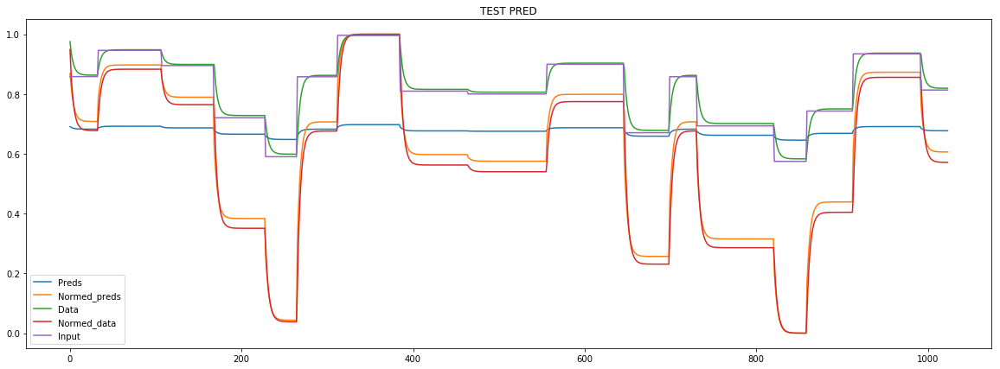

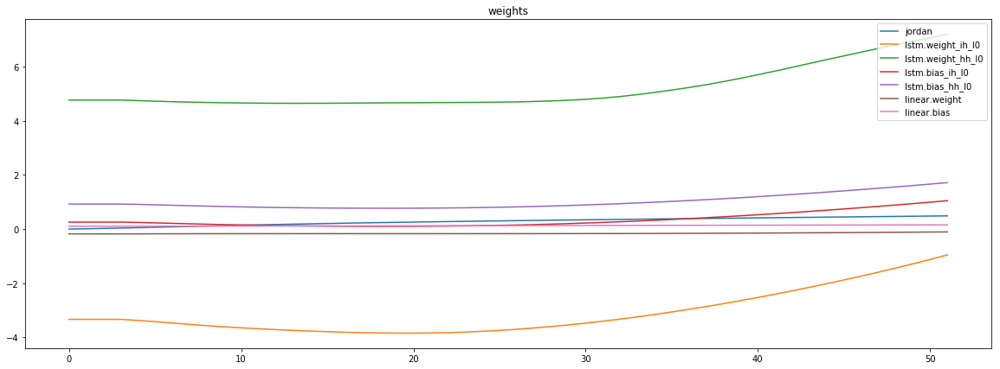

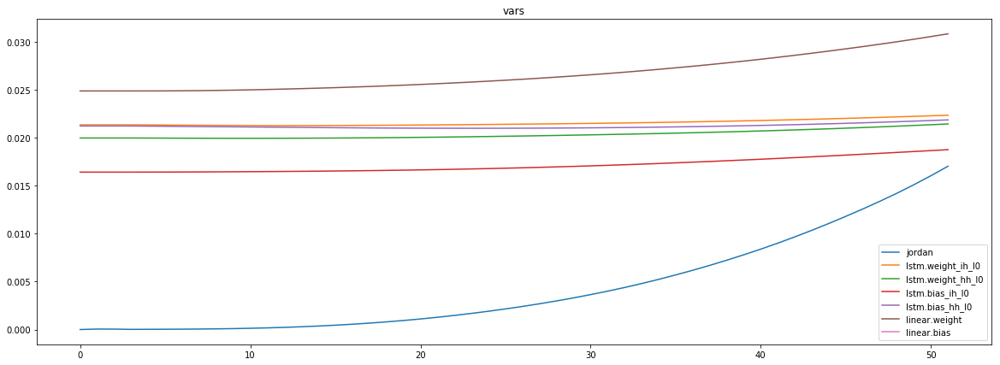

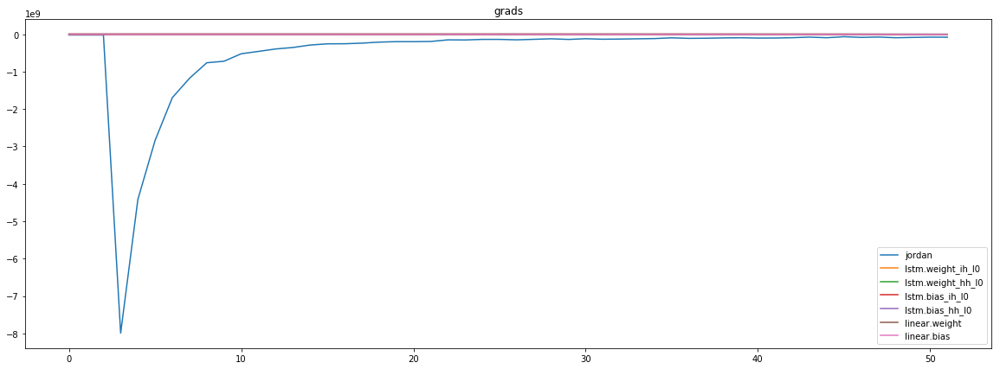

mean_p1 : -494405736.53846157
mean_p2 : -15665929.076923076


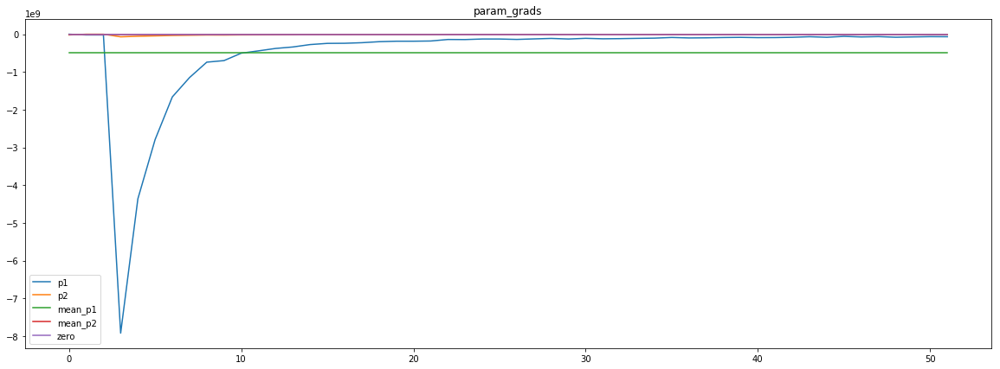

Epoch [0] 
     train_loss[22215327.63709435] 
     eval_train[9680934.754807692] 
     eval_test[9764843.96590909]



aux preds: 0.1731429249048233 0.5872066617012024
main loss 0.0
aux loss 1778741.014423077
jord loss 3358587.1971153845
combined loss 5137328.211538462 



Parameter containing:
tensor([[0.1731, 0.5872]], requires_grad=True)


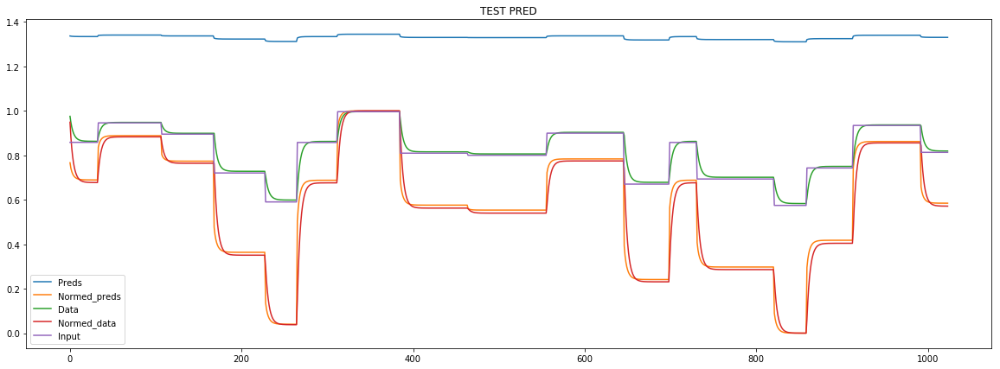

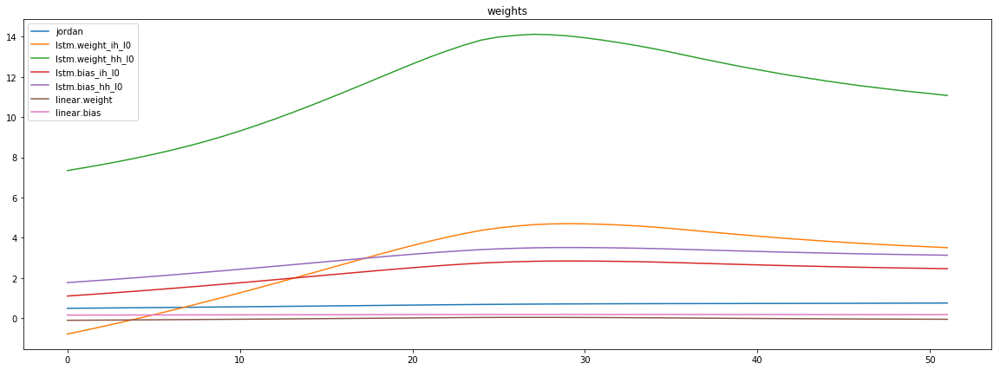

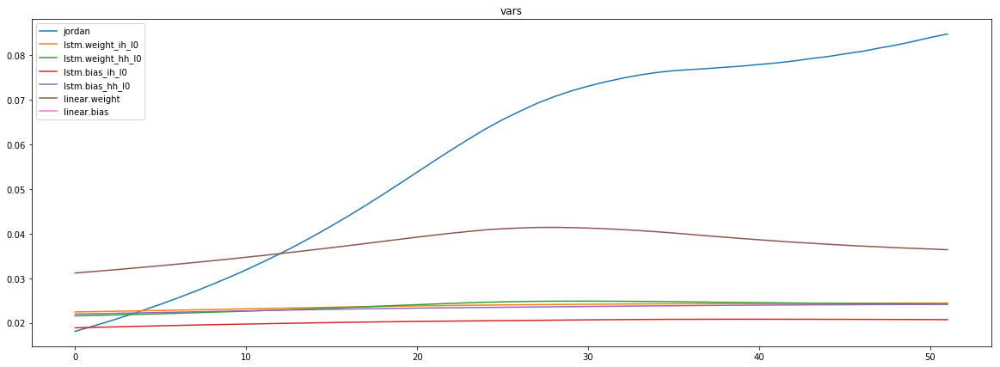

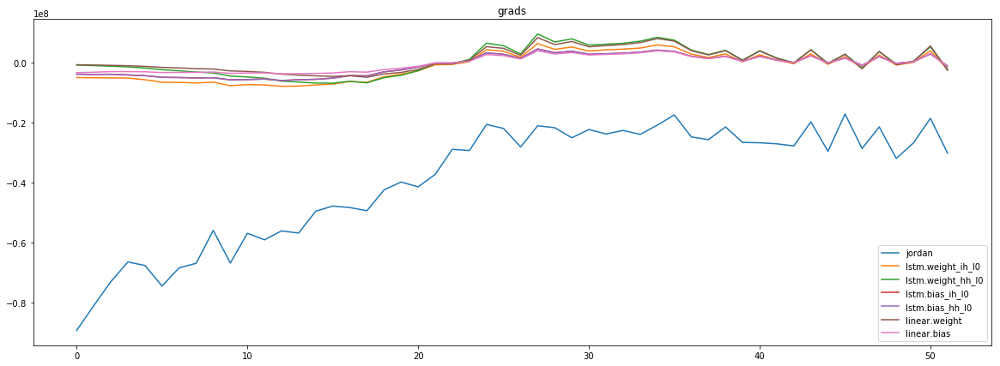

mean_p1 : -31976195.596153848
mean_p2 : -7049785.118990385


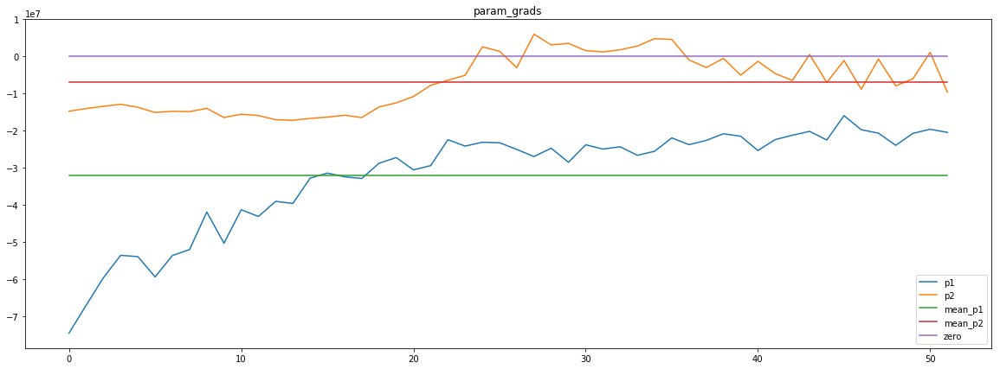

Epoch [1] 
     train_loss[5137328.211538462] 
     eval_train[3436366.4242788465] 
     eval_test[3518359.3636363633]



aux preds: 0.18417270481586456 0.7733597755432129
main loss 0.0
aux loss 781720.5396634615
jord loss 2012860.2524038462
combined loss 2794580.792067308 



Parameter containing:
tensor([[0.1842, 0.7734]], requires_grad=True)


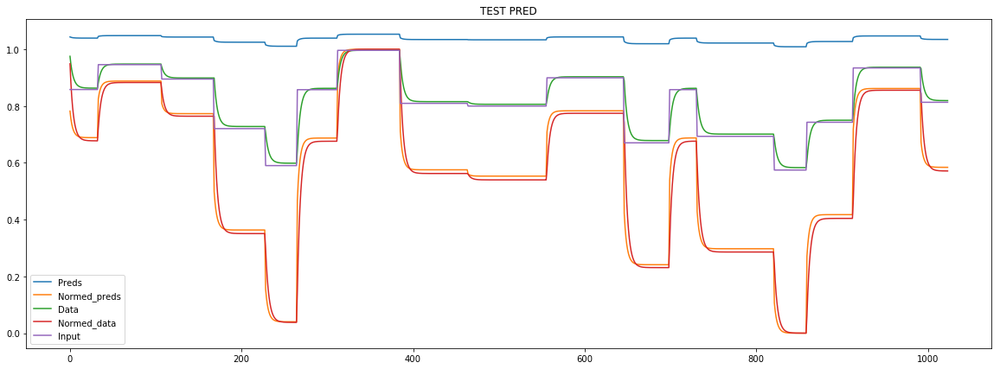

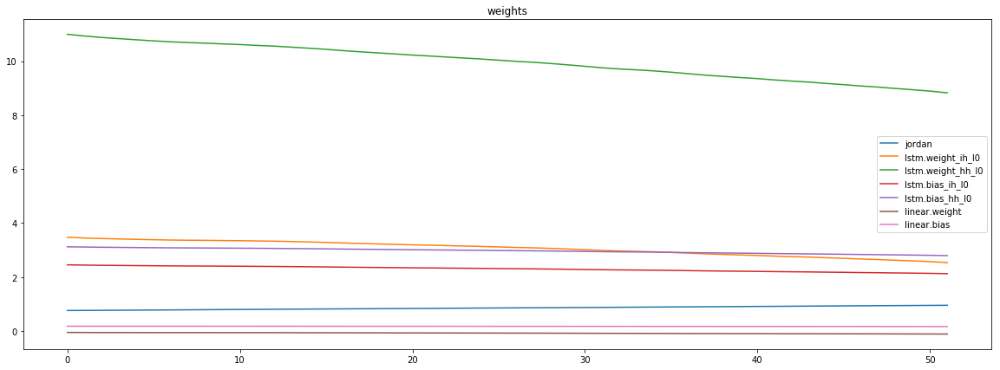

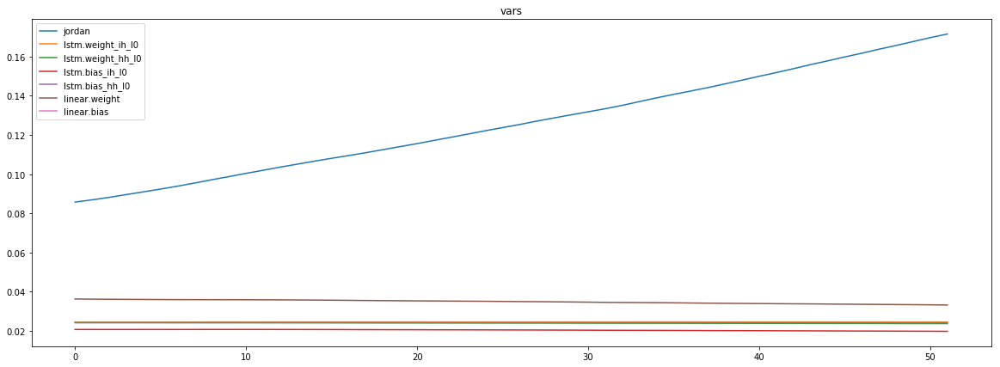

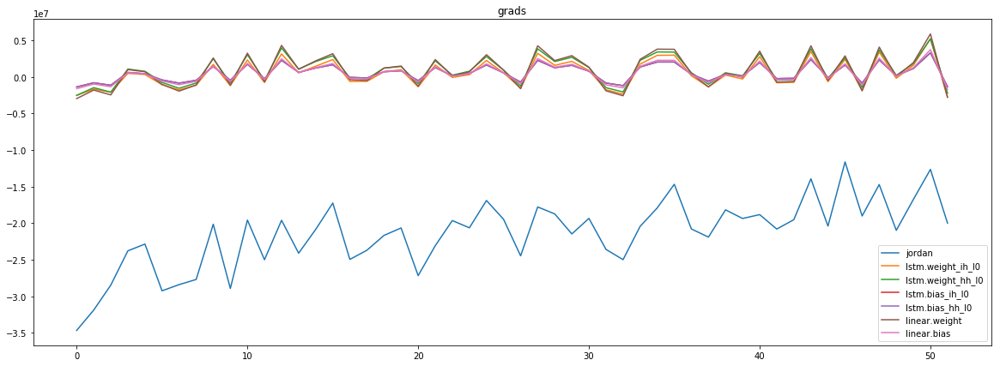

mean_p1 : -16290991.307692308
mean_p2 : -5108872.752403846


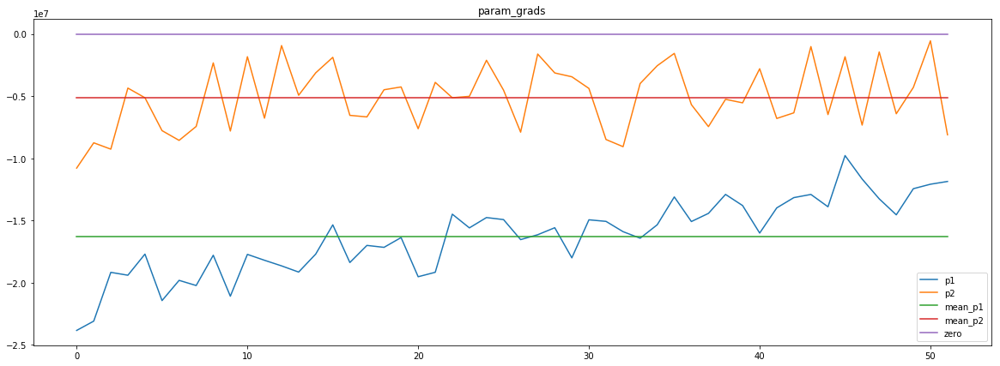

Epoch [2] 
     train_loss[2794580.792067308] 
     eval_train[2131735.798677885] 
     eval_test[2198213.059659091]



aux preds: 0.1917881816625595 0.9771243929862976
main loss 0.0
aux loss 692087.4681490385
jord loss 849601.6652644231
combined loss 1541689.1334134615 



Parameter containing:
tensor([[0.1918, 0.9771]], requires_grad=True)


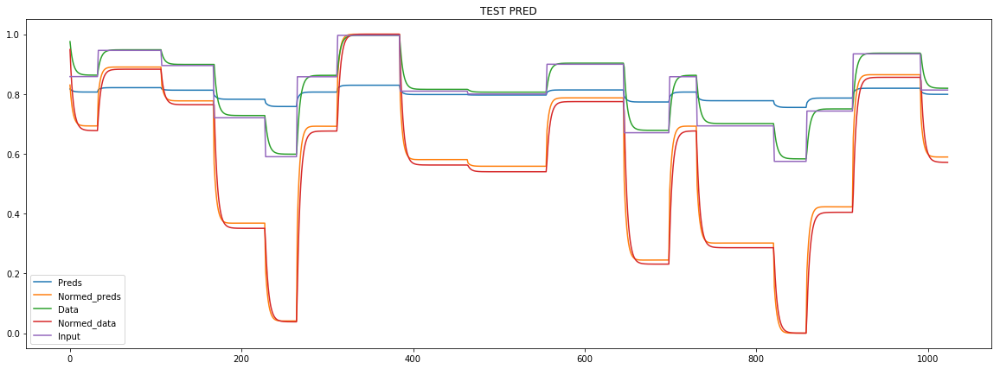

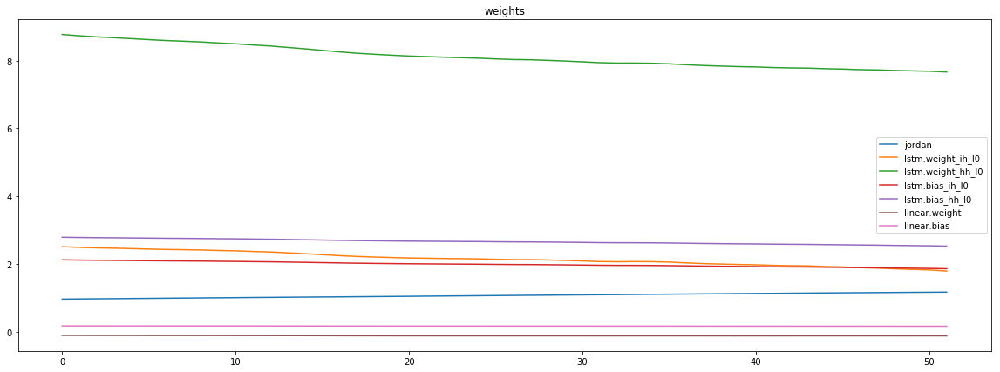

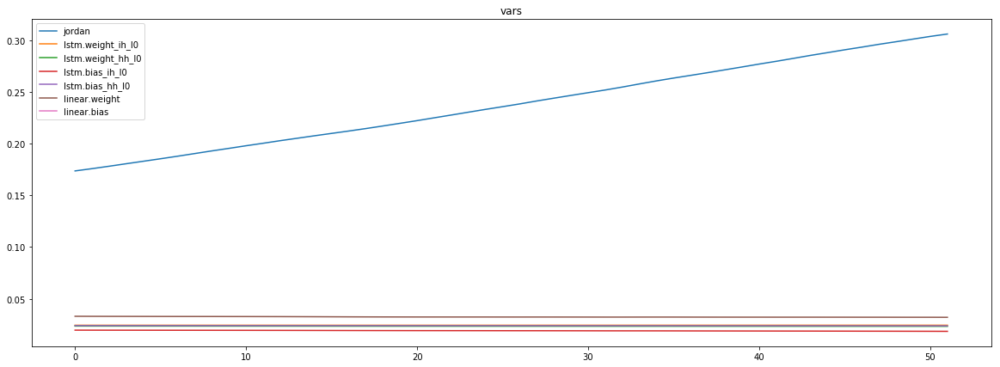

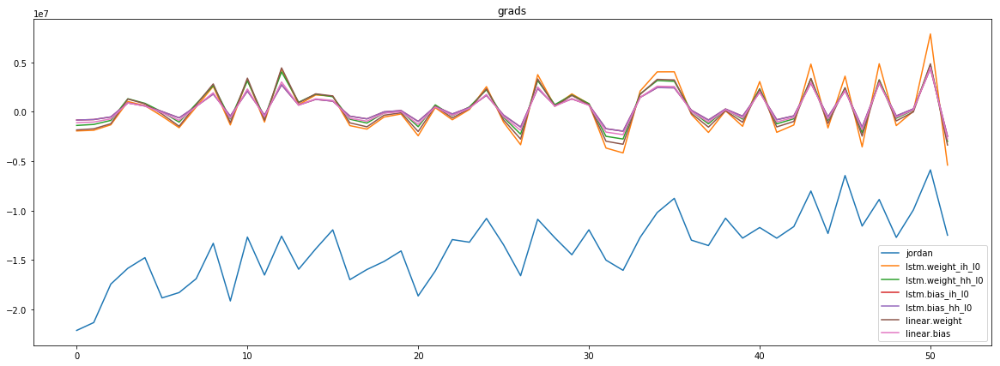

mean_p1 : -9186862.413461538
mean_p2 : -4532650.440054087


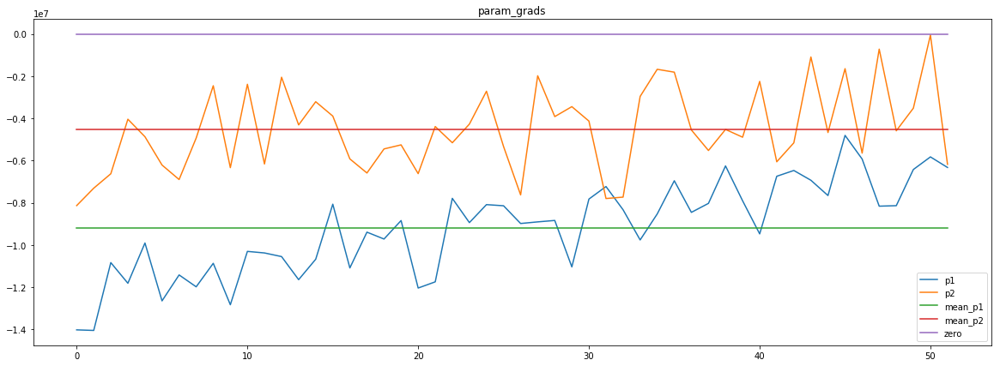

Epoch [3] 
     train_loss[1541689.1334134615] 
     eval_train[1028713.9864783653] 
     eval_test[1087087.21875]



aux preds: 0.19710807502269745 1.0160748958587646
main loss 0.0
aux loss 584320.1051682692
jord loss 285218.63055889425
combined loss 869538.7357271635 



Parameter containing:
tensor([[0.1971, 1.0161]], requires_grad=True)


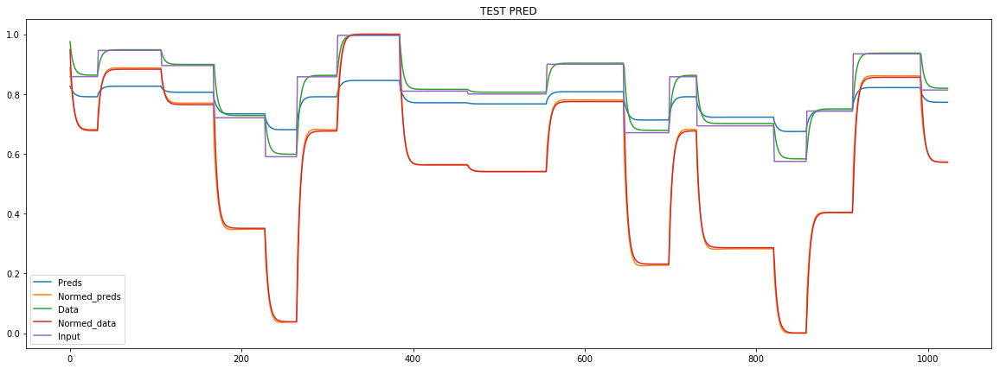

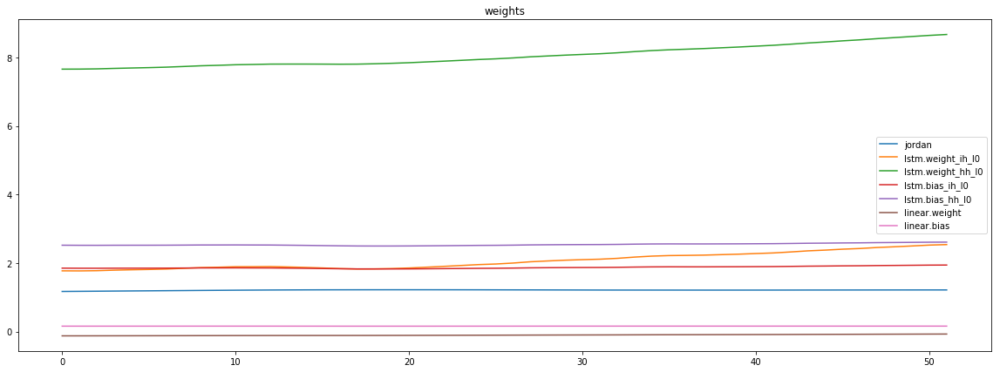

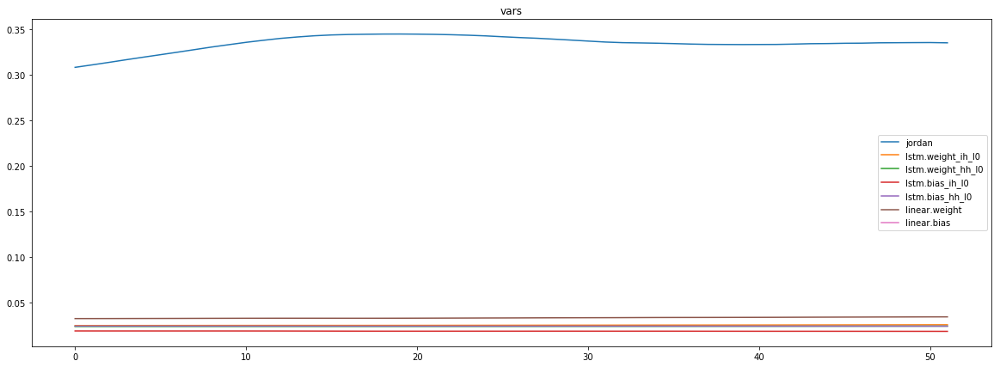

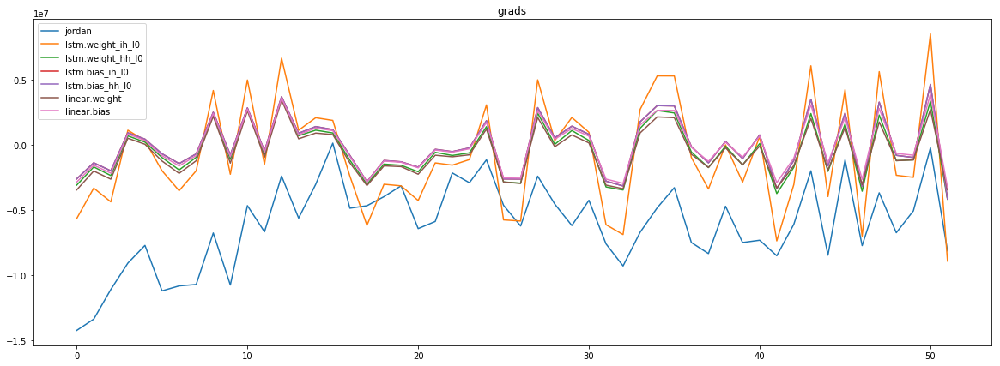

mean_p1 : -5868241.139423077
mean_p2 : -203486.76592548078


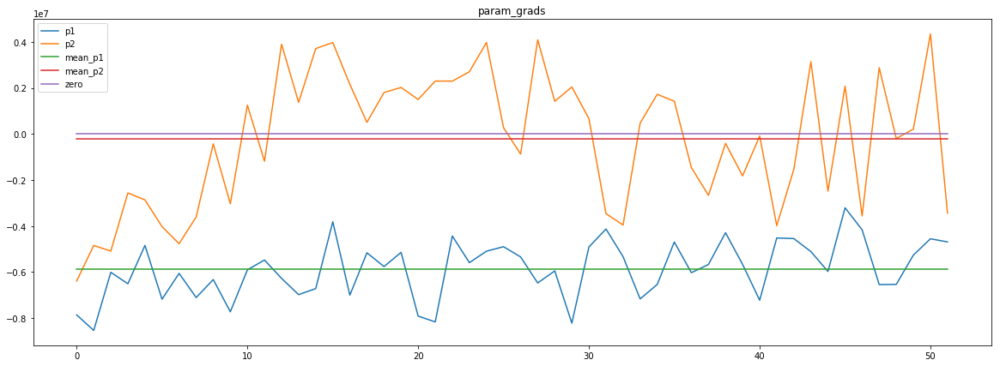

loss rate [0.6411440924870165]
Epoch [4] 
     train_loss[869538.7357271635] 
     eval_train[771861.8617788462] 
     eval_test[813844.4850852273]



aux preds: 0.20188556611537933 1.014542818069458
main loss 0.0
aux loss 393059.7749399039
jord loss 260727.20102163462
combined loss 653786.9759615385 



Parameter containing:
tensor([[0.2019, 1.0145]], requires_grad=True)


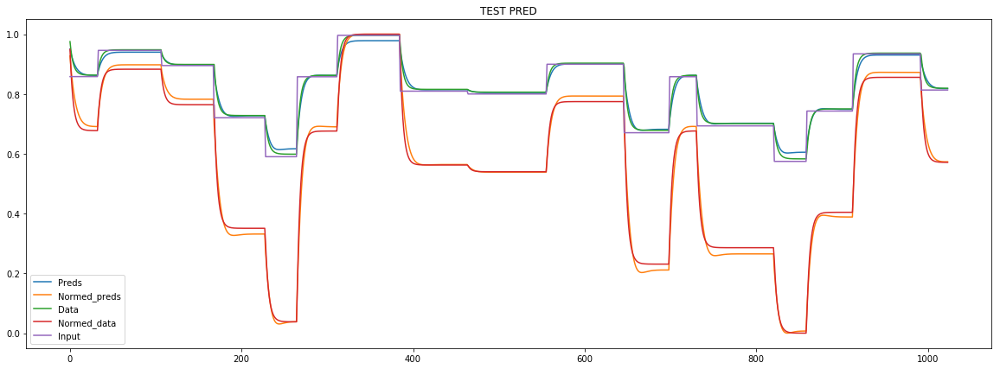

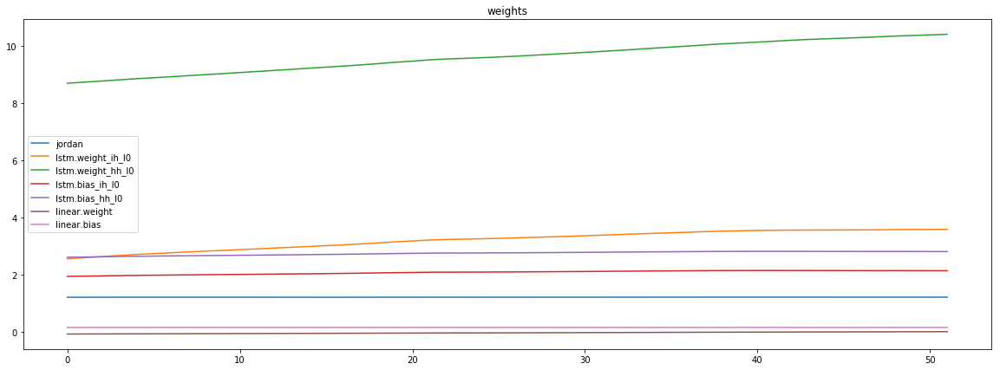

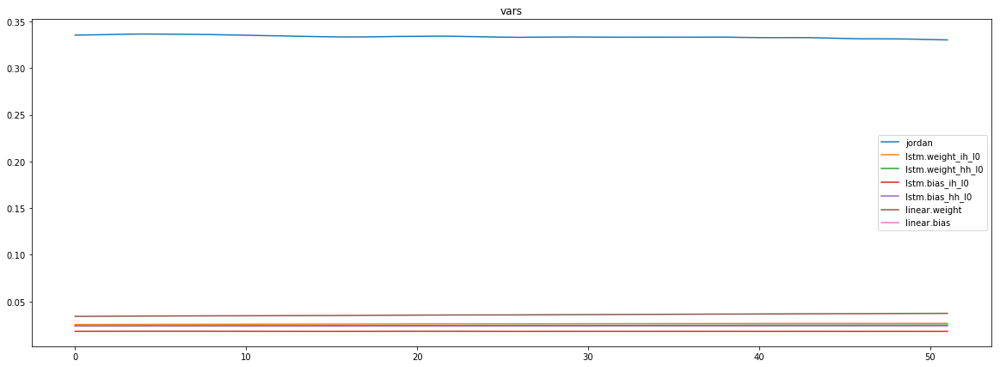

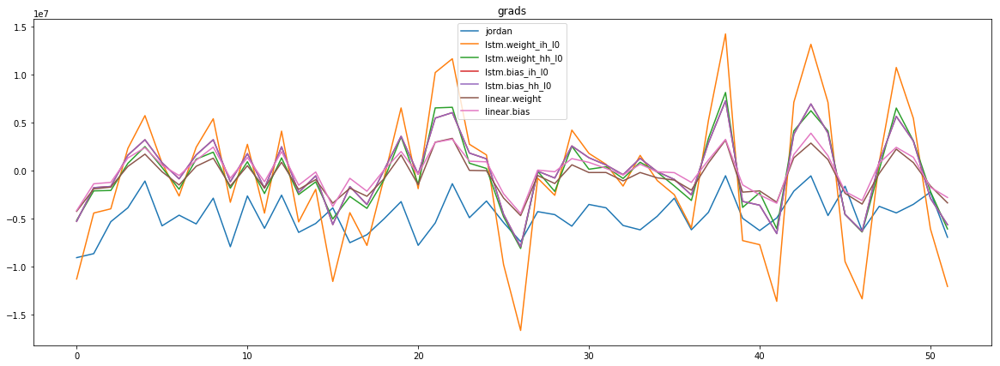

mean_p1 : -4770284.701923077
mean_p2 : 33154.81760817308


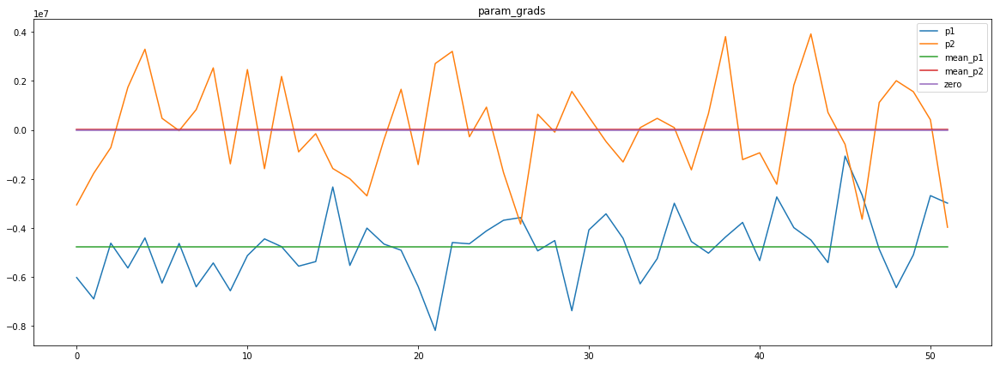

loss rate [0.5877869536757498]
Epoch [5] 
     train_loss[653786.9759615385] 
     eval_train[542242.0450721154] 
     eval_test[563240.3167613636]



aux preds: 0.206221342086792 1.0157601833343506
main loss 0.0
aux loss 254852.01126802884
jord loss 251504.32001201922
combined loss 506356.33128004806 



Parameter containing:
tensor([[0.2062, 1.0158]], requires_grad=True)


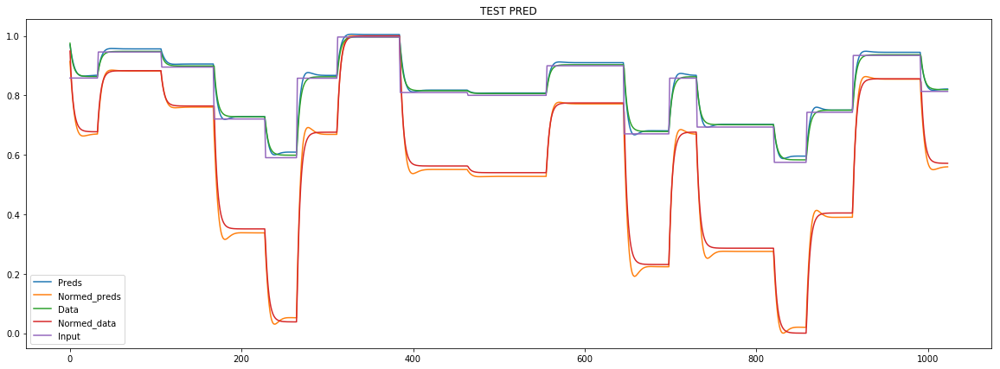

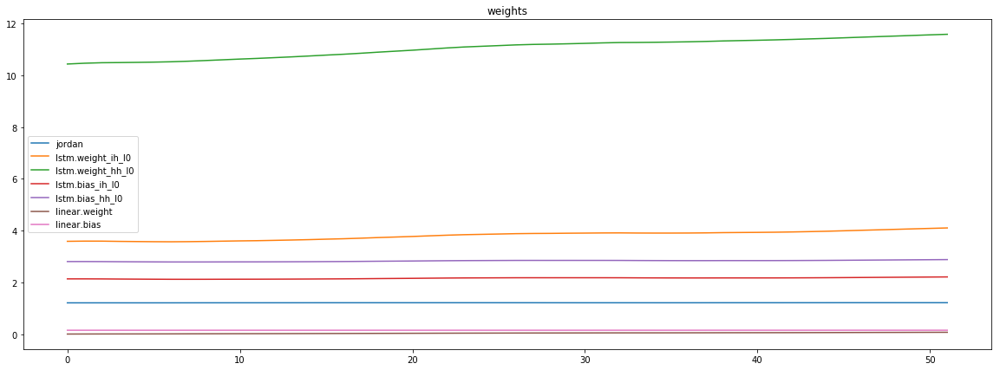

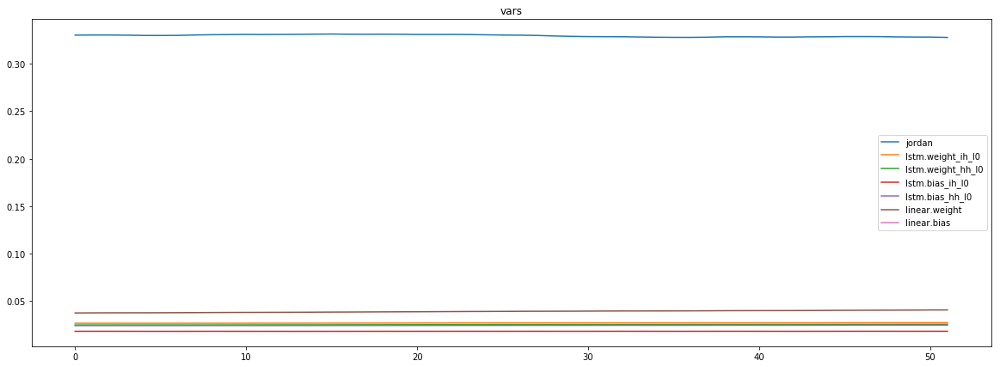

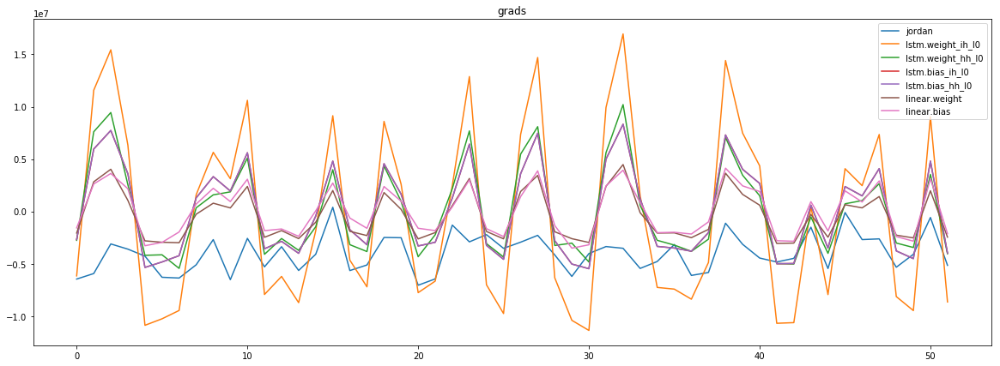

mean_p1 : -3991844.105769231
mean_p2 : -7796.651141826923


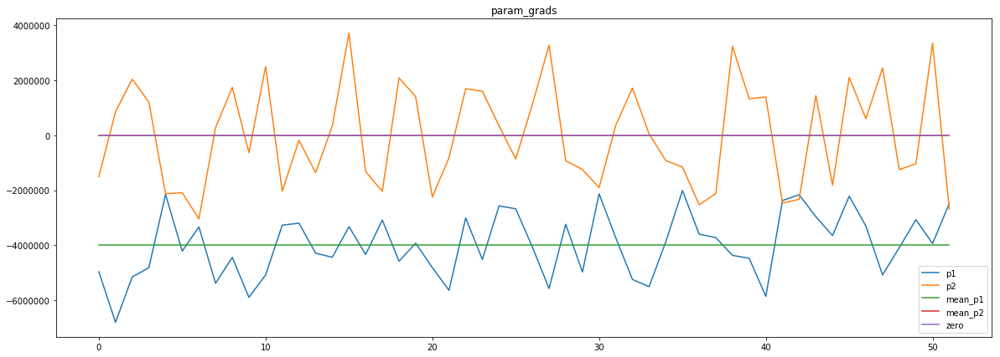

loss rate [0.42560095411450705]
Epoch [6] 
     train_loss[506356.33128004806] 
     eval_train[456497.07061298075] 
     eval_test[471806.01917613635]



aux preds: 0.21035970747470856 1.0143314599990845
main loss 0.0
aux loss 196257.54747596153
jord loss 243120.3916766827
combined loss 439377.93915264425 



Parameter containing:
tensor([[0.2104, 1.0143]], requires_grad=True)


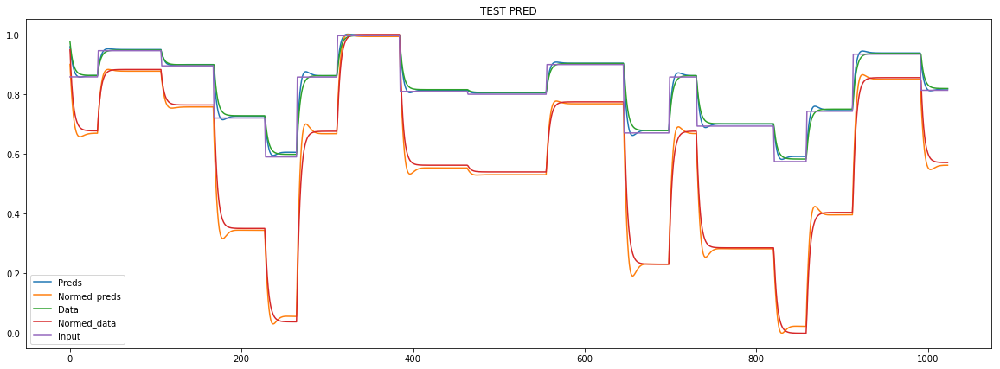

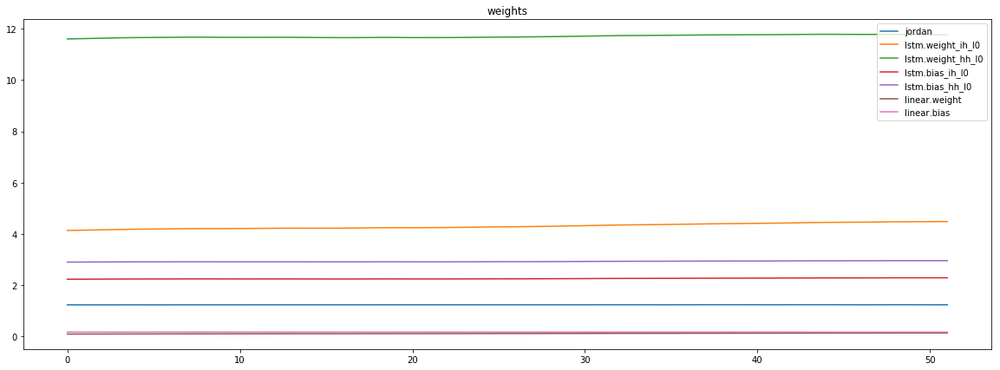

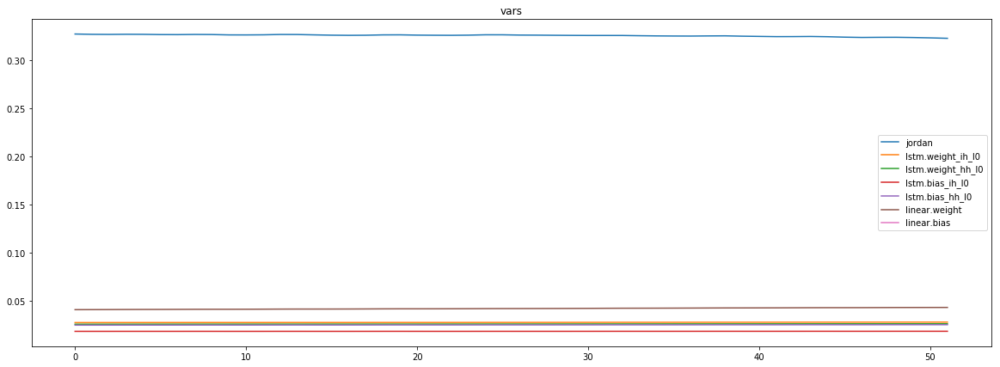

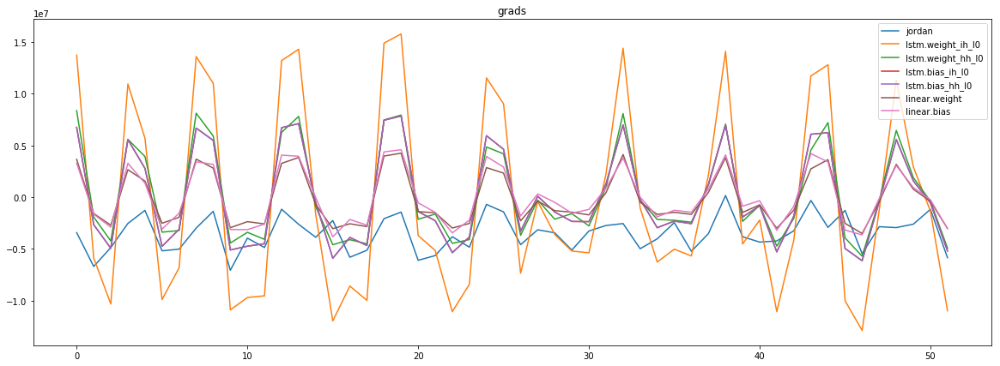

mean_p1 : -3511272.8365384615
mean_p2 : 9998.659254807691


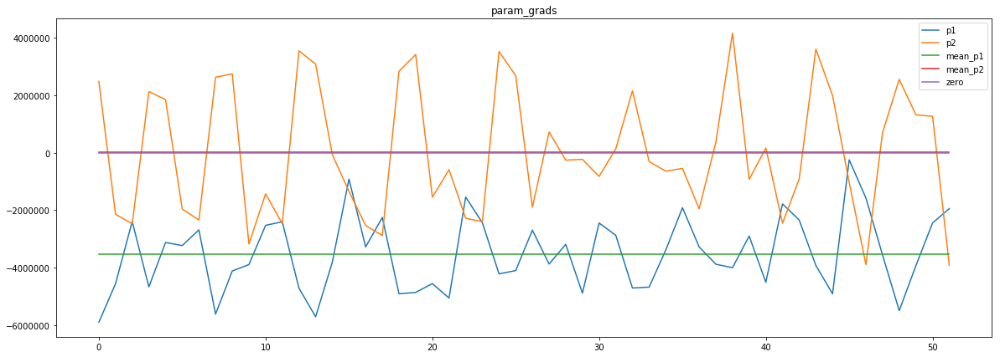

loss rate [0.3101039537726895]
Epoch [7] 
     train_loss[439377.93915264425] 
     eval_train[410659.3781550481] 
     eval_test[425180.8224431818]



aux preds: 0.21449899673461914 1.0149500370025635
main loss 0.0
aux loss 187191.87124399038
jord loss 235511.6885516827
combined loss 422703.55979567306 



Parameter containing:
tensor([[0.2145, 1.0150]], requires_grad=True)


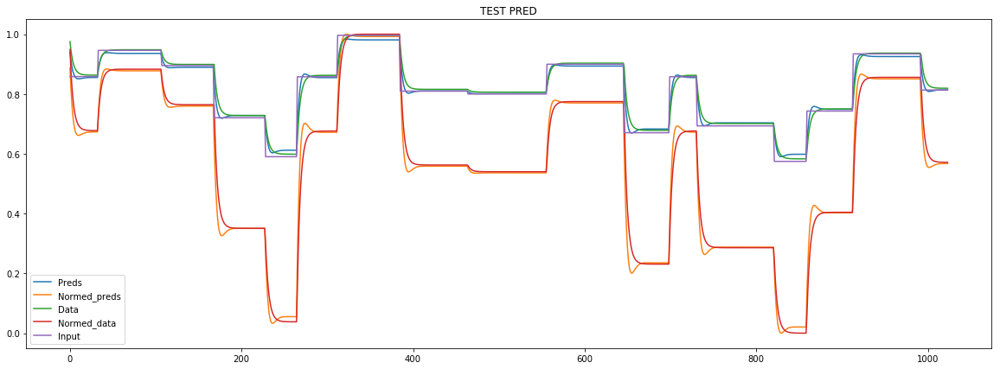

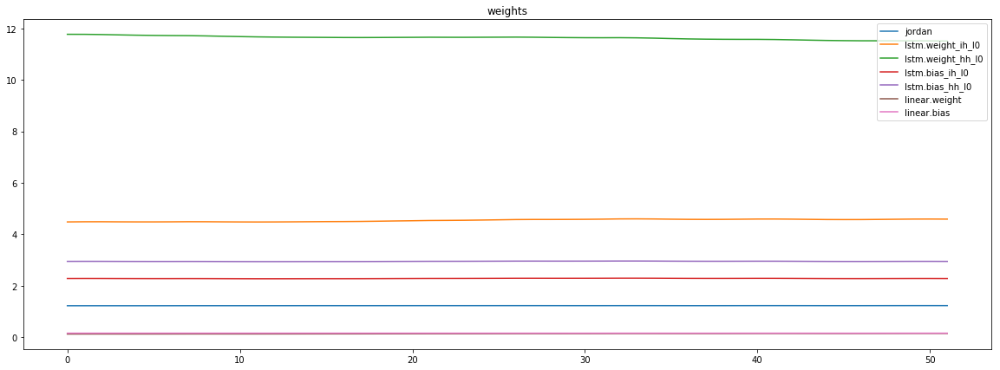

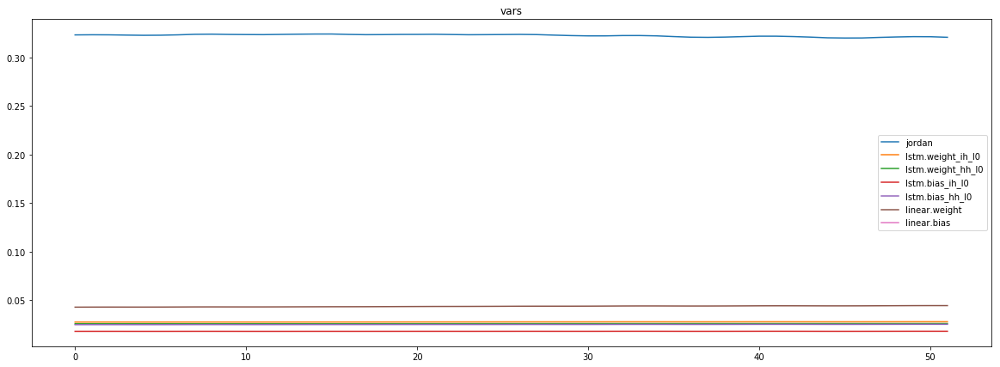

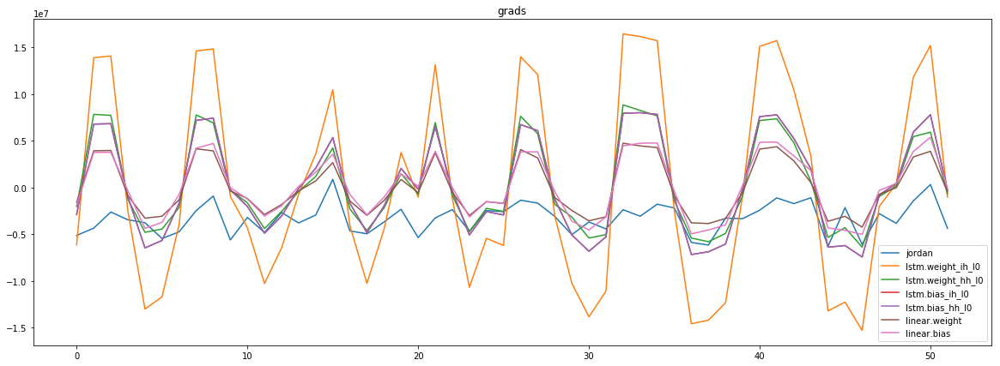

mean_p1 : -3333905.6875
mean_p2 : 44767.56189903846


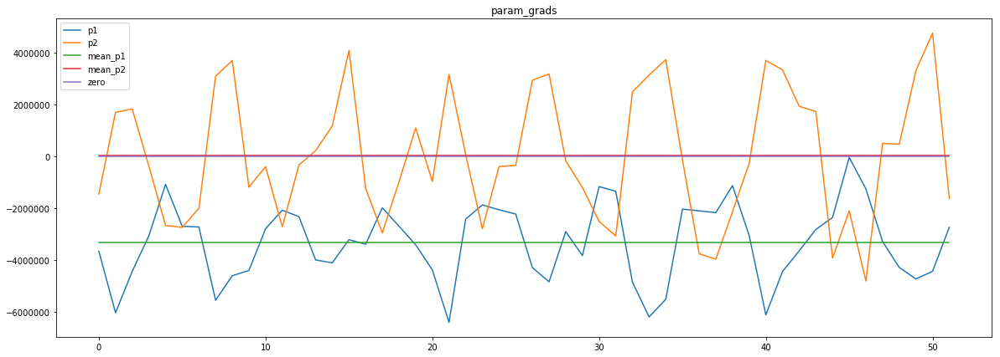

loss rate [0.15383846121984068]
Epoch [8] 
     train_loss[422703.55979567306] 
     eval_train[396126.9140625] 
     eval_test[411862.68643465906]



aux preds: 0.21863391995429993 1.013472318649292
main loss 0.0
aux loss 160999.8876201923
jord loss 228072.66571514422
combined loss 389072.5533353365 



Parameter containing:
tensor([[0.2186, 1.0135]], requires_grad=True)


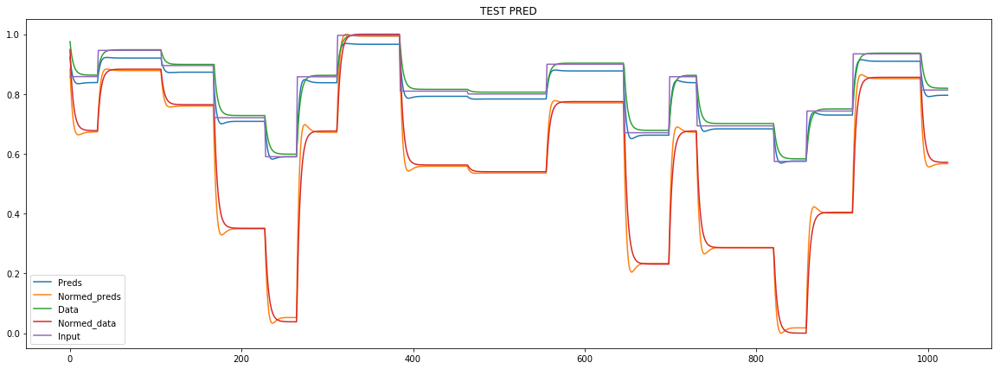

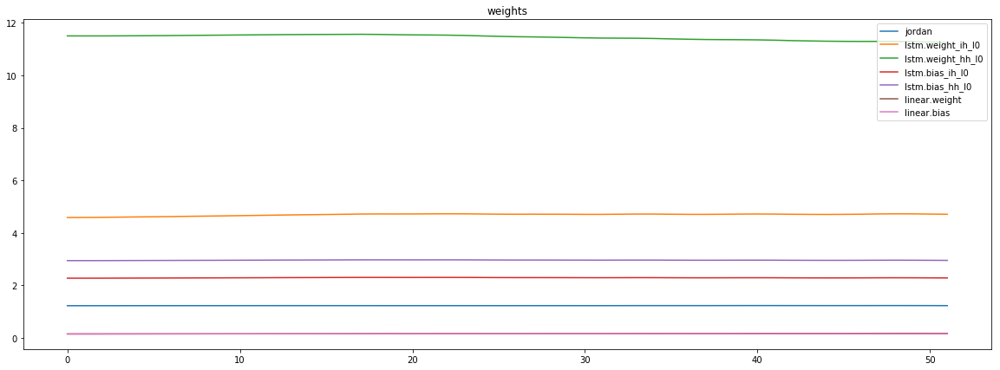

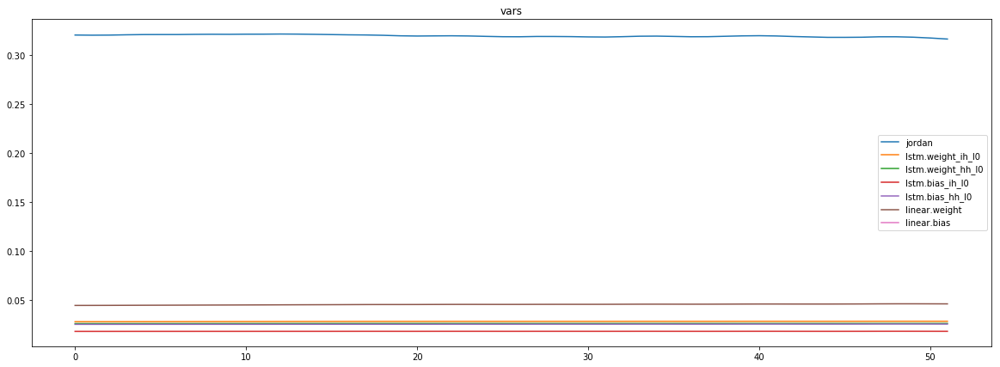

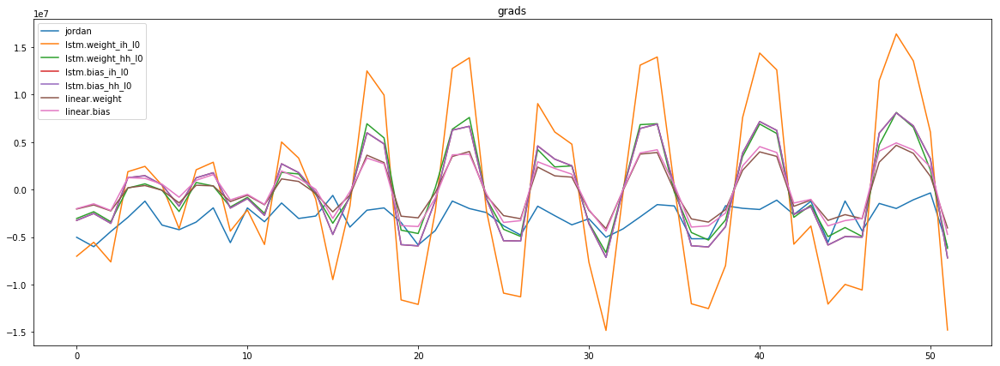

mean_p1 : -3045120.8798076925
mean_p2 : 20992.898888221152


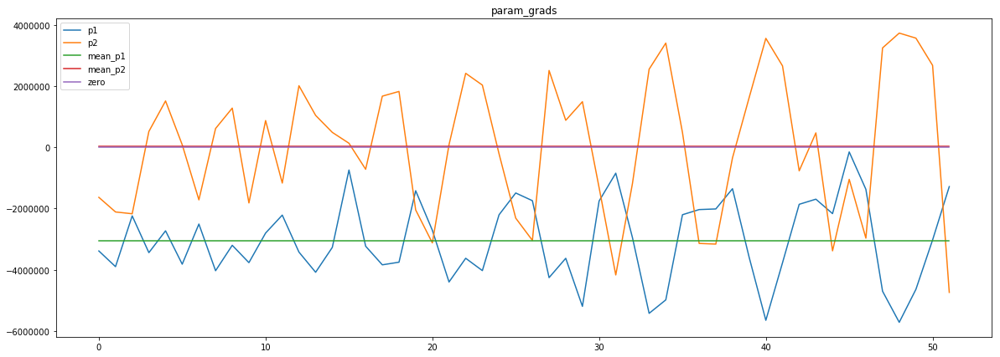

loss rate [-0.02622540721837674]
Epoch [9] 
     train_loss[389072.5533353365] 
     eval_train[435093.6888521635] 
     eval_test[447724.87997159094]



aux preds: 0.22275204956531525 1.0147889852523804
main loss 0.0
aux loss 144493.81182391828
jord loss 220812.40940504806
combined loss 365306.2212289664 



Parameter containing:
tensor([[0.2228, 1.0148]], requires_grad=True)


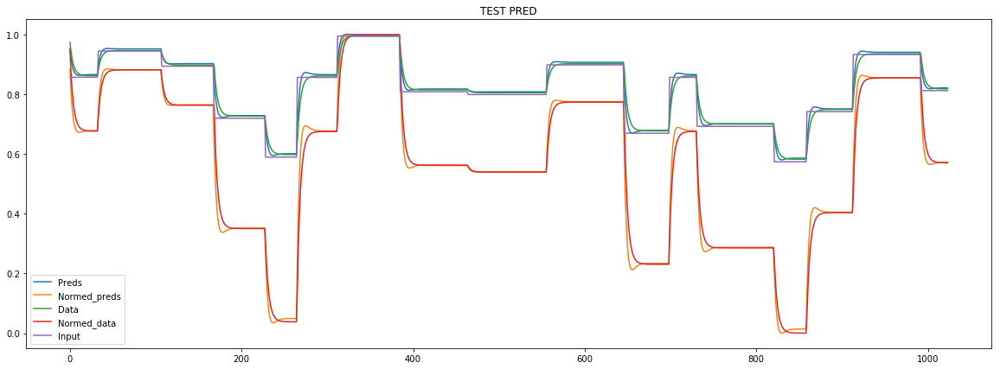

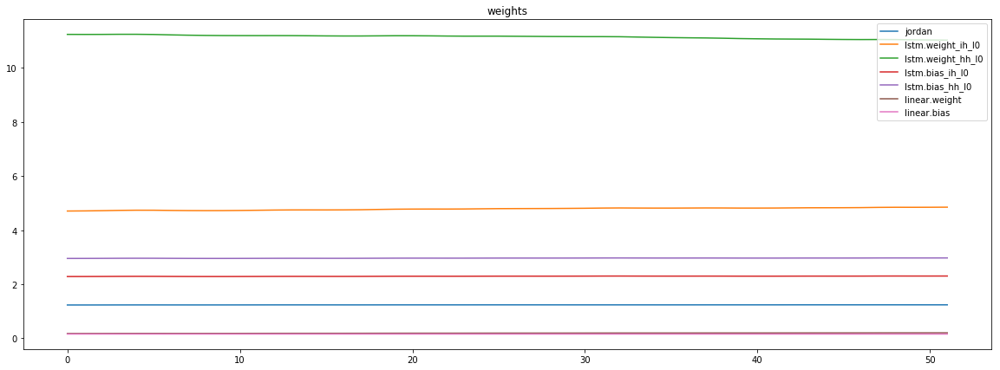

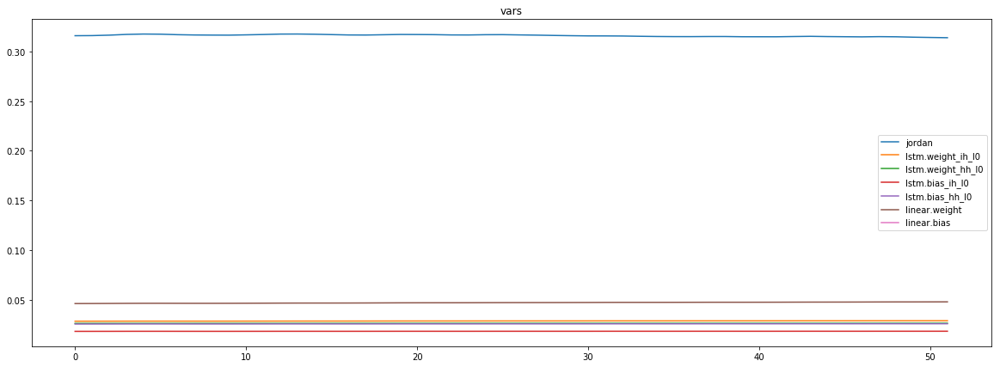

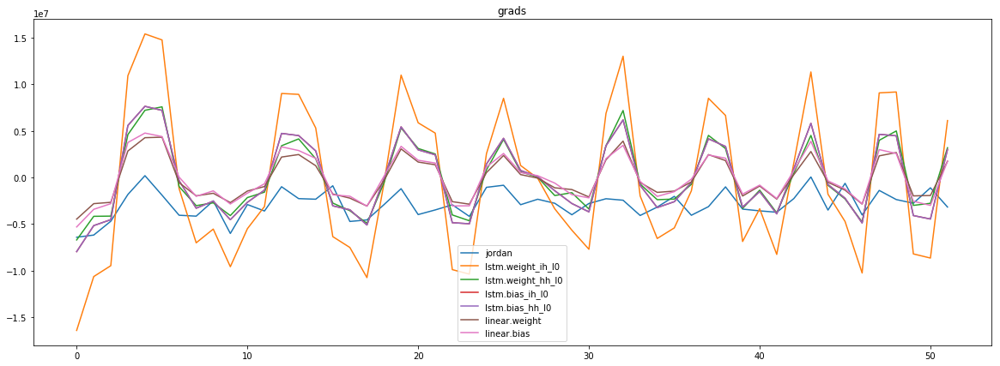

mean_p1 : -2822858.080528846
mean_p2 : -46777.62710336538


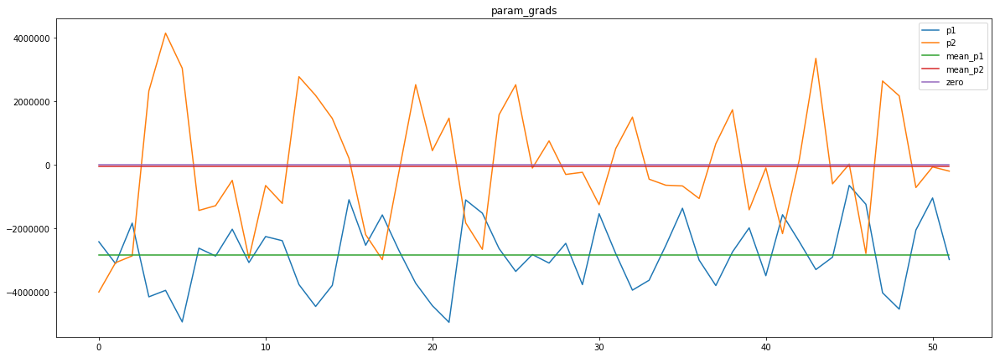

loss rate [0.16023306501176215]
Epoch [10] 
     train_loss[365306.2212289664] 
     eval_train[348356.370718149] 
     eval_test[359635.3373579546]



aux preds: 0.22682514786720276 1.0147247314453125
main loss 0.0
aux loss 126561.44290865384
jord loss 213958.046875
combined loss 340519.4897836539 



Parameter containing:
tensor([[0.2268, 1.0147]], requires_grad=True)


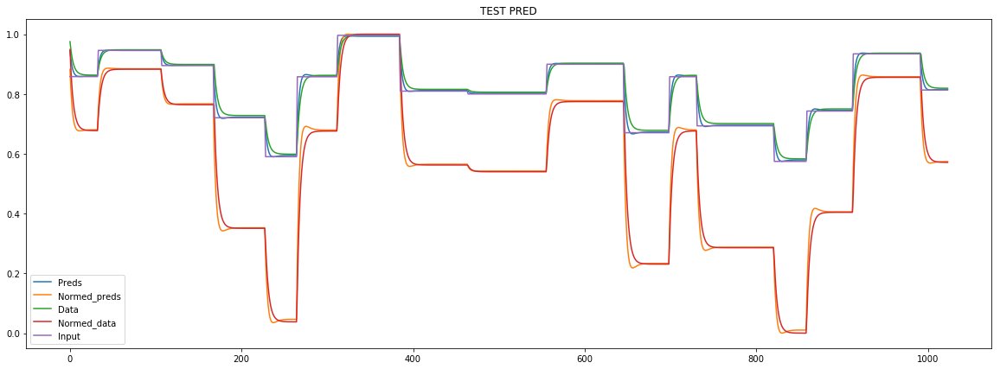

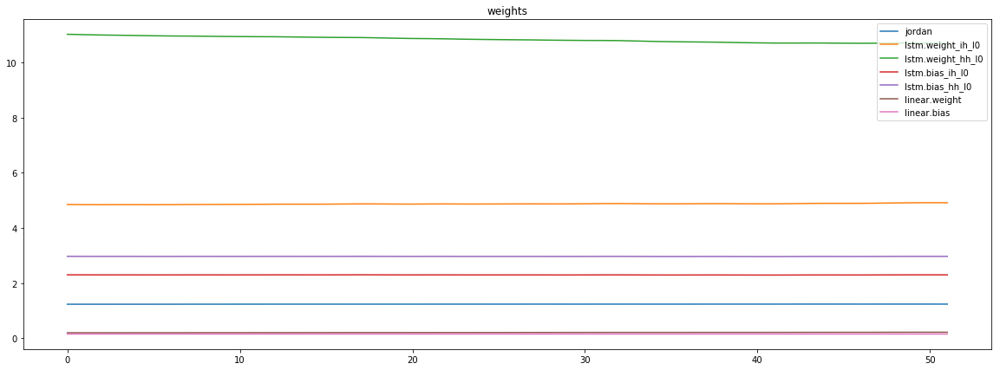

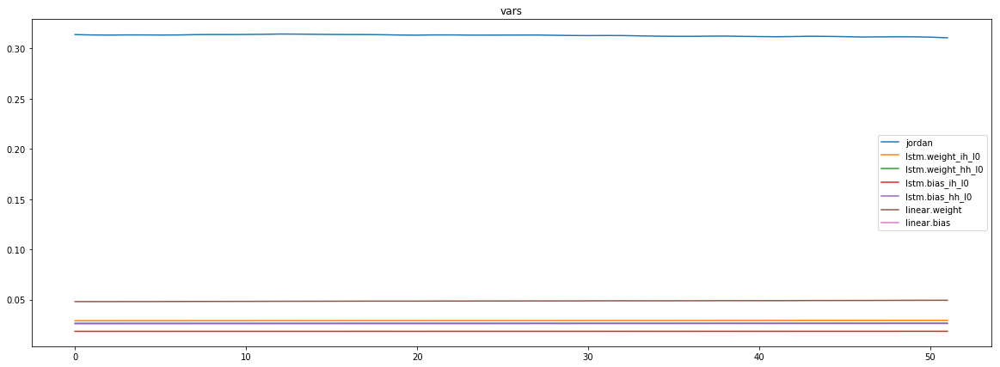

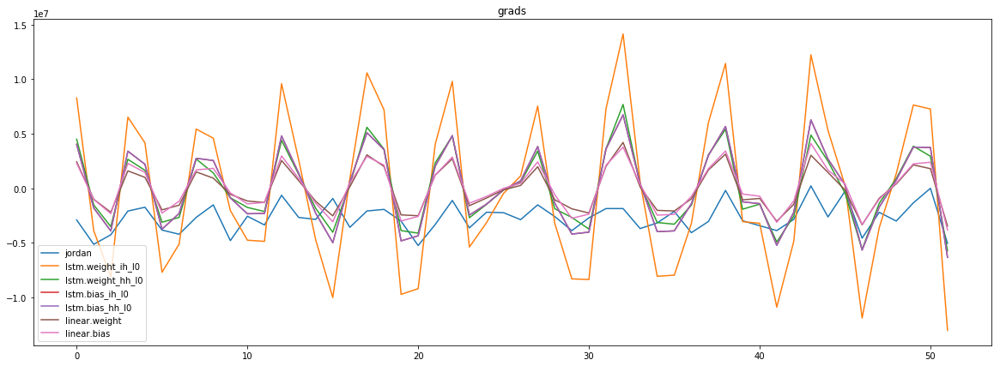

mean_p1 : -2671470.0360576925
mean_p2 : -18068.458533653848


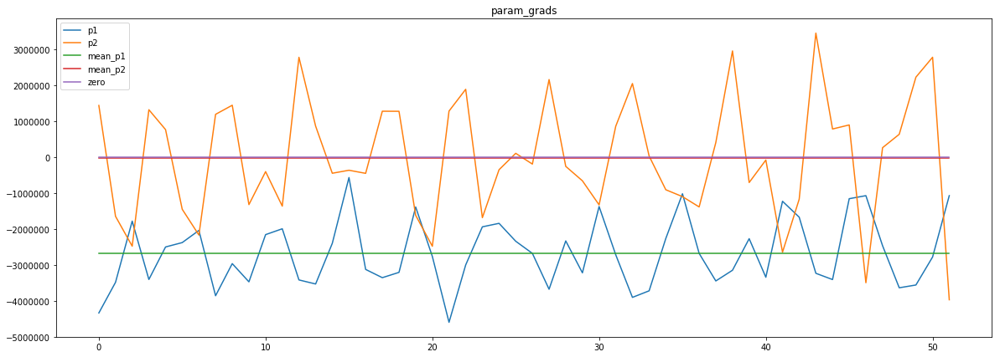

loss rate [0.14755322750862077]
Epoch [11] 
     train_loss[340519.4897836539] 
     eval_train[335067.6160606971] 
     eval_test[346440.87642045453]



aux preds: 0.2309180200099945 1.0145609378814697
main loss 0.0
aux loss 118735.23655348558
jord loss 207321.67052283653
combined loss 326056.9070763221 



Parameter containing:
tensor([[0.2309, 1.0146]], requires_grad=True)


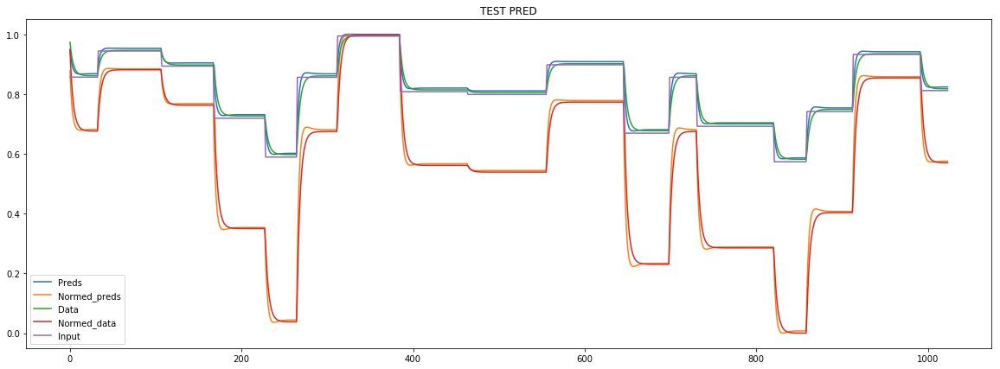

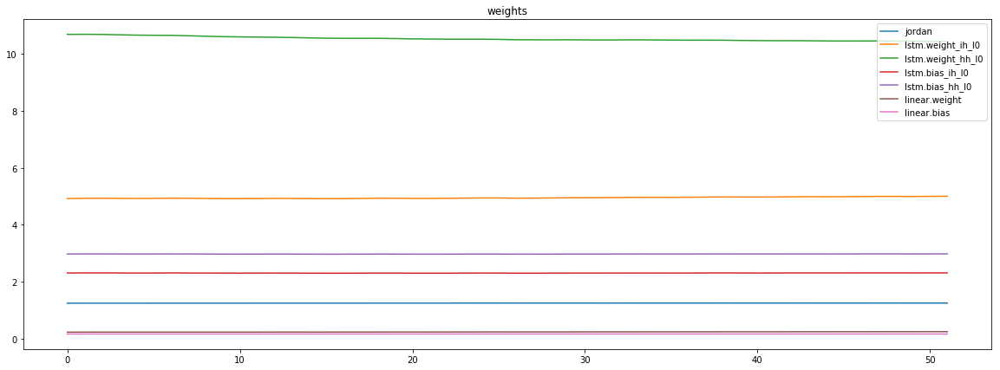

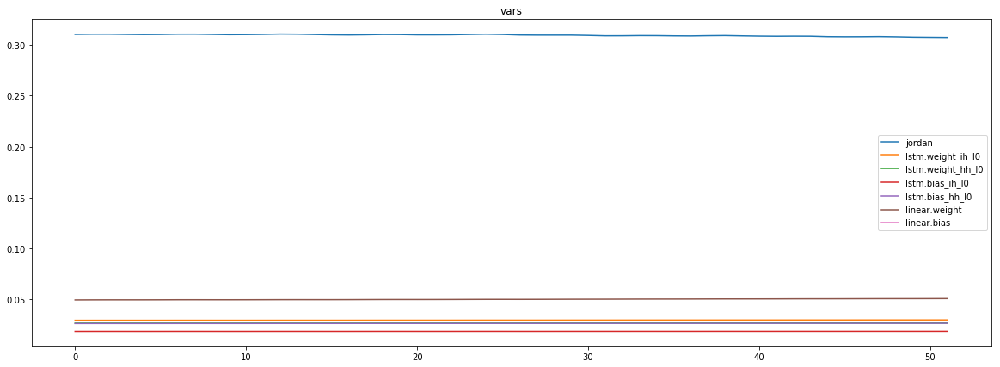

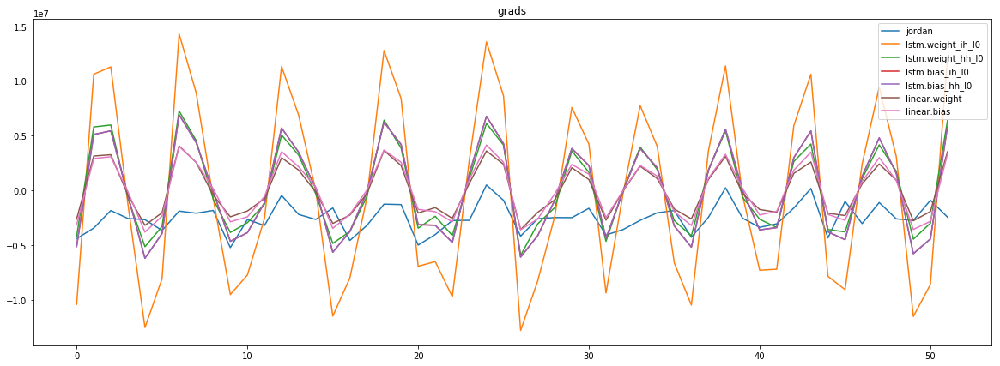

mean_p1 : -2532149.902644231
mean_p2 : 21119.115985576922


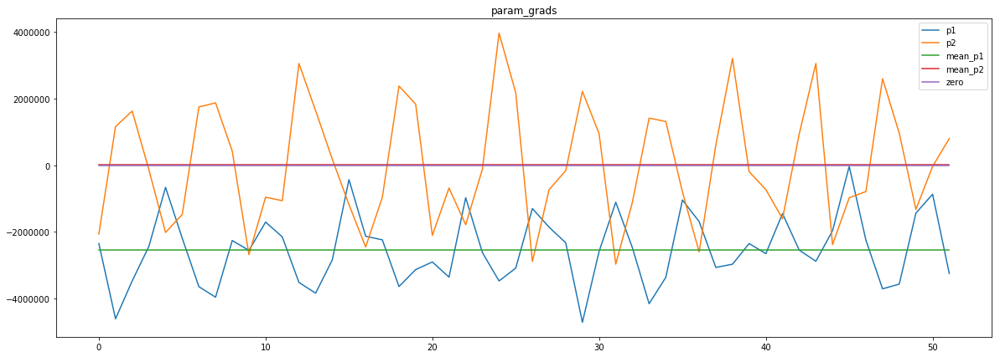

loss rate [0.13751428255350218]
Epoch [12] 
     train_loss[326056.9070763221] 
     eval_train[322177.2977013221] 
     eval_test[331712.3213778409]



aux preds: 0.23502053320407867 1.0150772333145142
main loss 0.0
aux loss 111914.63176081731
jord loss 201079.8094951923
combined loss 312994.4412560096 



Parameter containing:
tensor([[0.2350, 1.0151]], requires_grad=True)


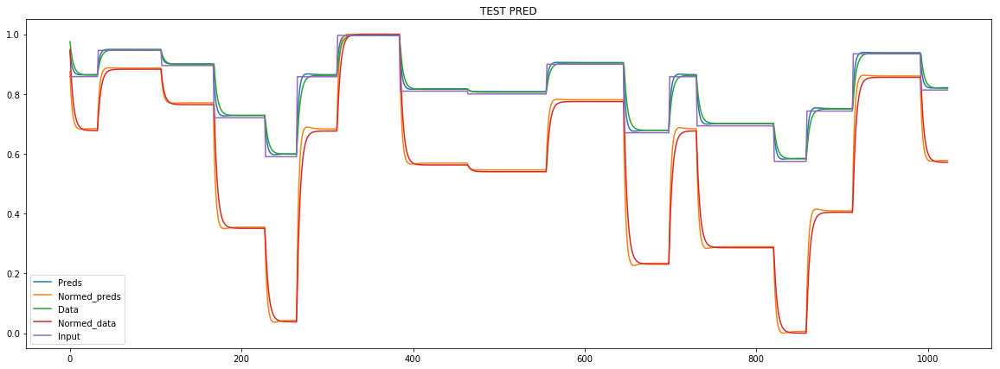

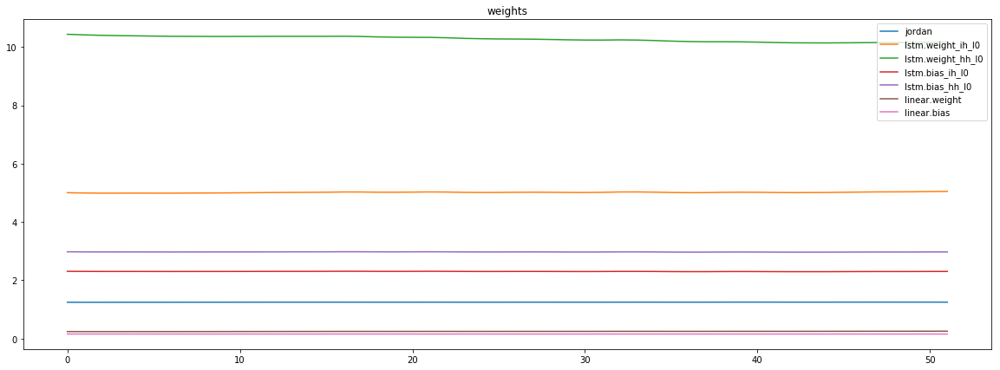

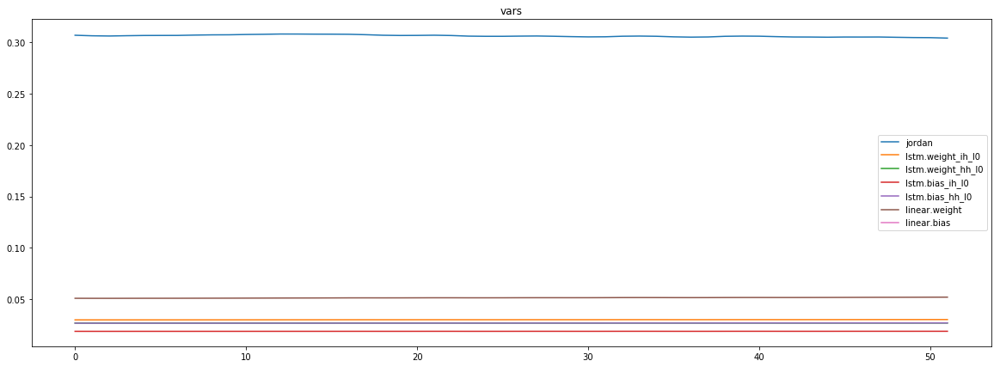

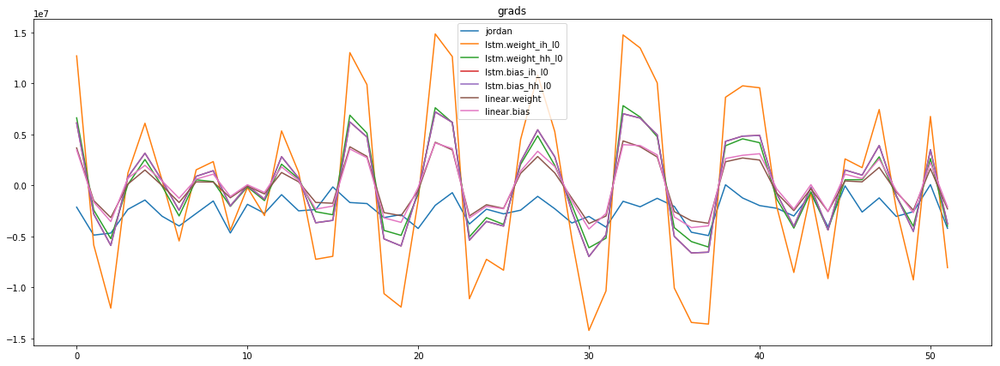

mean_p1 : -2410148.9326923075
mean_p2 : -33095.01817908654


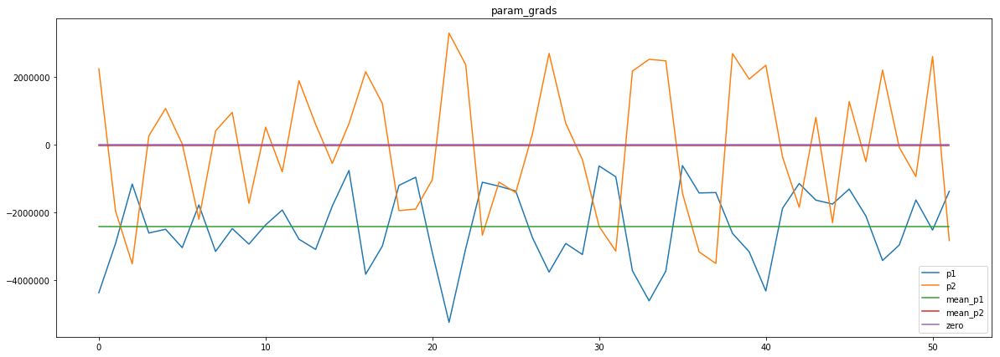

loss rate [0.10217984267015767]
Epoch [13] 
     train_loss[312994.4412560096] 
     eval_train[299874.62853064906] 
     eval_test[310582.48863636365]



aux preds: 0.239119291305542 1.0150413513183594
main loss 0.0
aux loss 103857.20072115384
jord loss 194840.96799879806
combined loss 298698.1687199519 



Parameter containing:
tensor([[0.2391, 1.0150]], requires_grad=True)


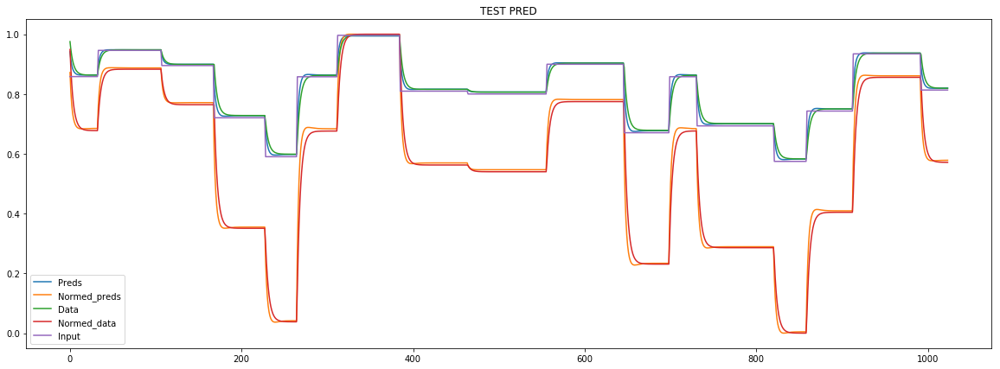

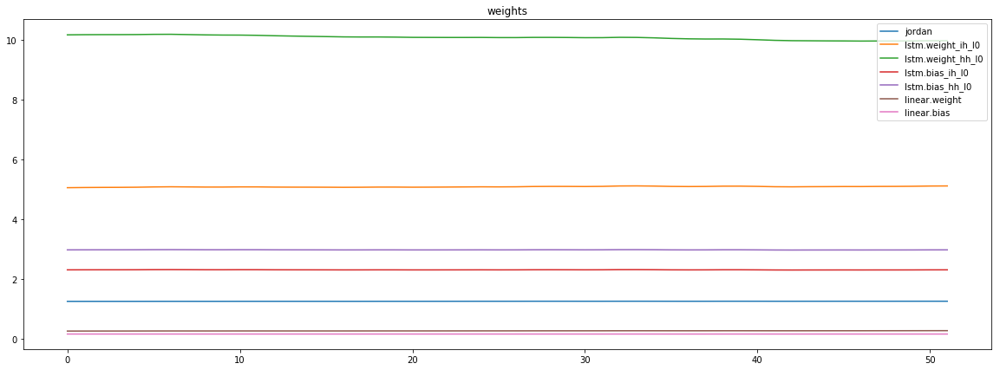

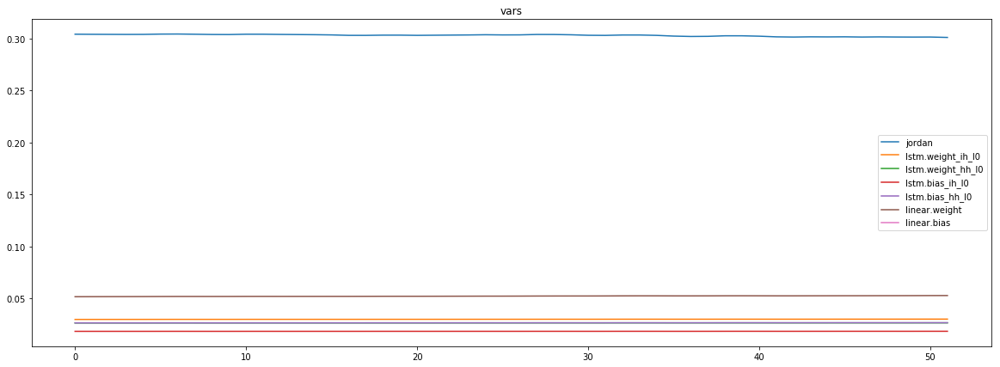

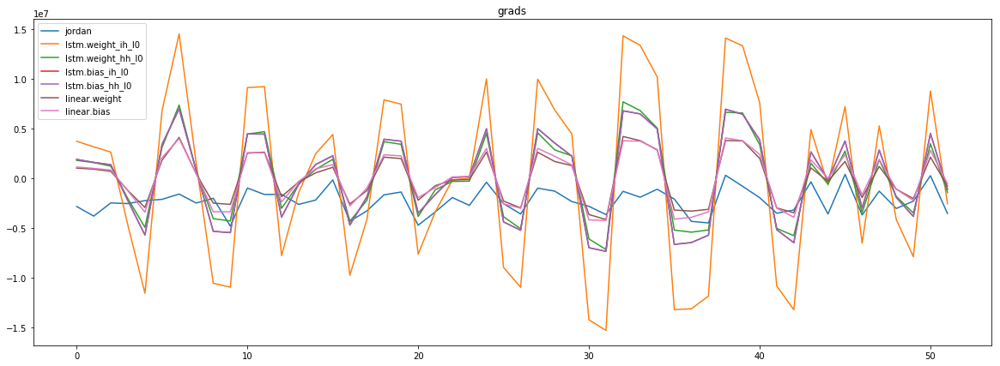

mean_p1 : -2298665.060096154
mean_p2 : 9676.518629807691


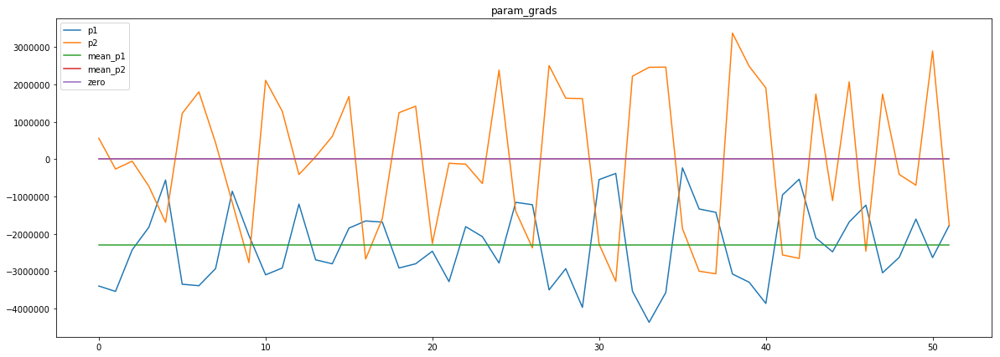

loss rate [0.10082503931116382]
Epoch [14] 
     train_loss[298698.1687199519] 
     eval_train[285881.7515024039] 
     eval_test[296348.79066051135]



aux preds: 0.24319717288017273 1.014270305633545
main loss 0.0
aux loss 96022.29214242789
jord loss 188886.96213942306
combined loss 284909.25428185094 



Parameter containing:
tensor([[0.2432, 1.0143]], requires_grad=True)


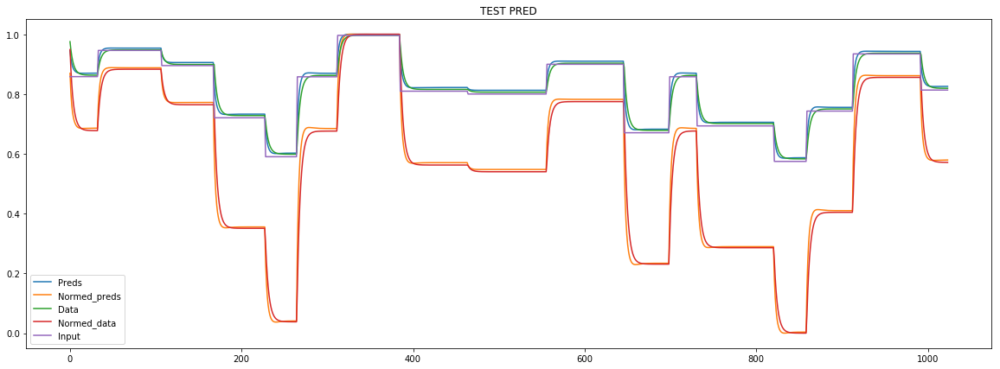

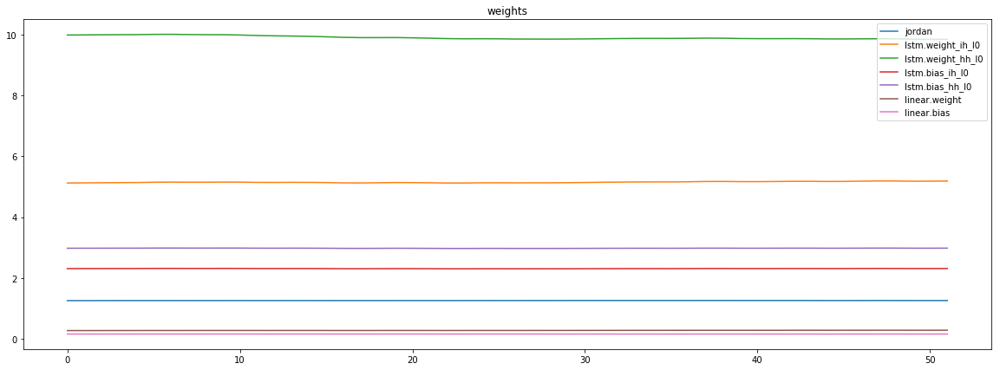

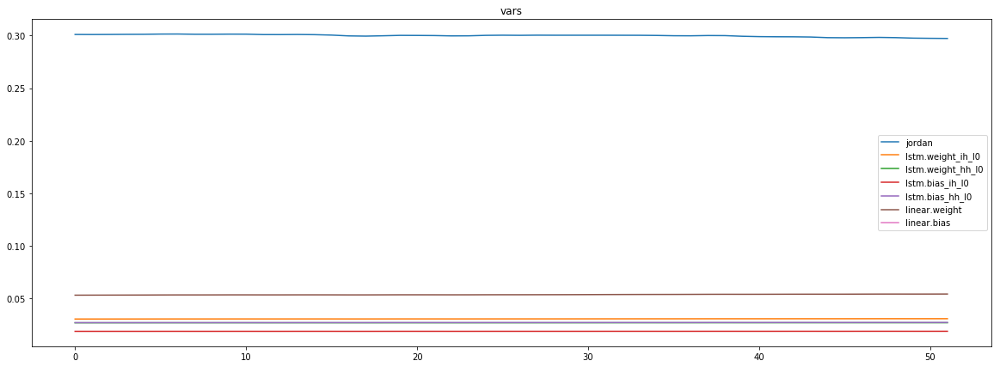

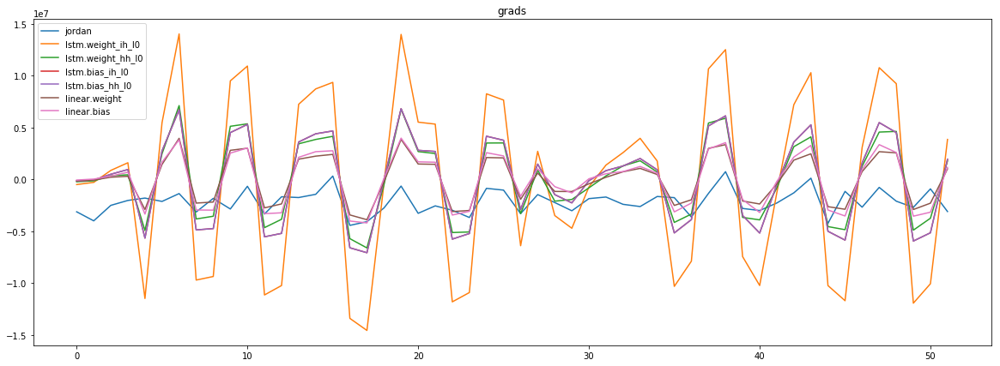

mean_p1 : -2157663.0528846155
mean_p2 : -6342.095102163462


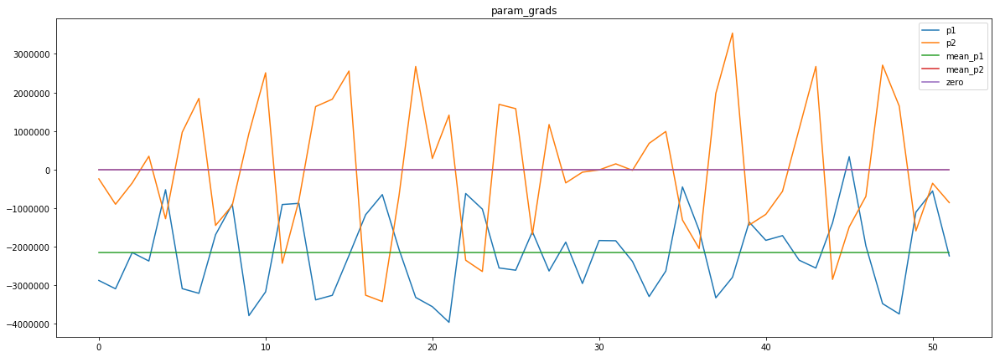

loss rate [0.06811882330979147]
Epoch [15] 
     train_loss[284909.25428185094] 
     eval_train[283055.1153846154] 
     eval_test[291568.10102982953]



aux preds: 0.24726082384586334 1.0139172077178955
main loss 0.0
aux loss 88273.14460637019
jord loss 183254.01322115384
combined loss 271527.157827524 



Parameter containing:
tensor([[0.2473, 1.0139]], requires_grad=True)


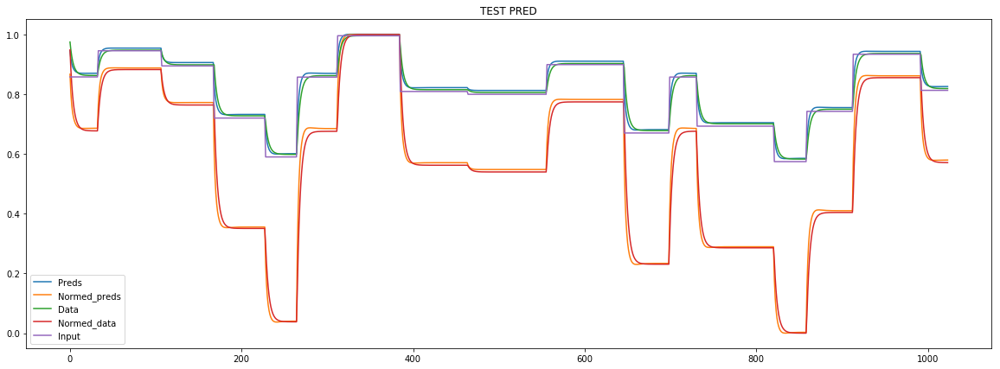

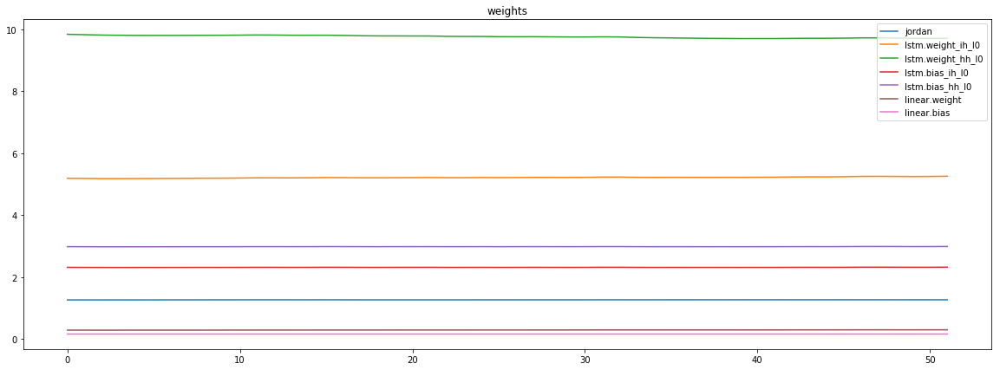

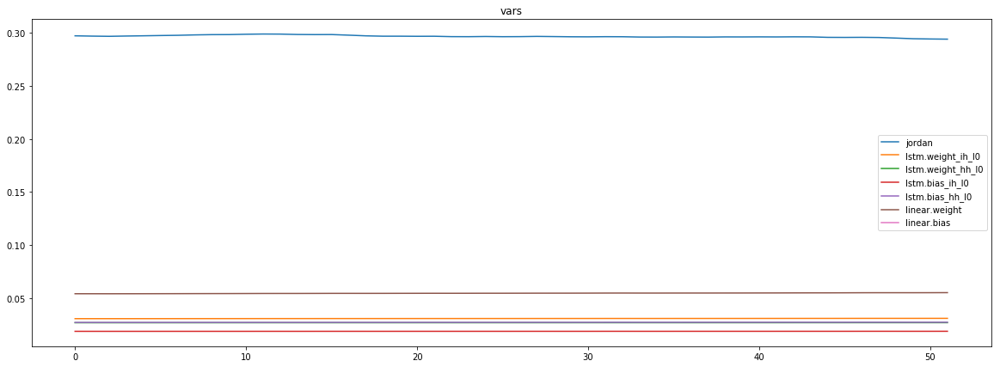

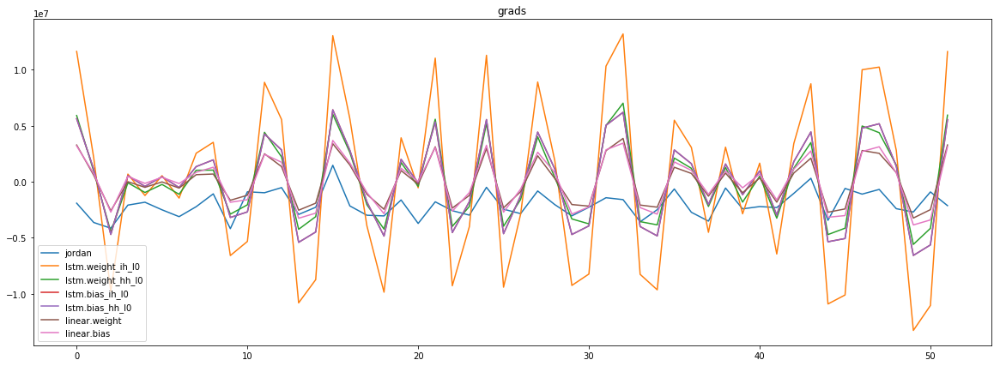

mean_p1 : -2072688.5060096155
mean_p2 : 33203.846003605766


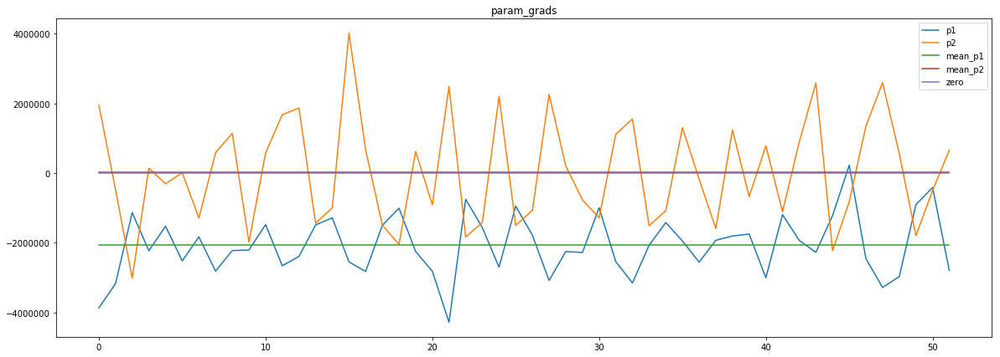

loss rate [0.06493346937481981]
Epoch [16] 
     train_loss[271527.157827524] 
     eval_train[272121.19598858175] 
     eval_test[280052.23277698865]



aux preds: 0.25133180618286133 1.014430284500122
main loss 0.0
aux loss 84616.61786358173
jord loss 177784.95057091347
combined loss 262401.5684344952 



Parameter containing:
tensor([[0.2513, 1.0144]], requires_grad=True)


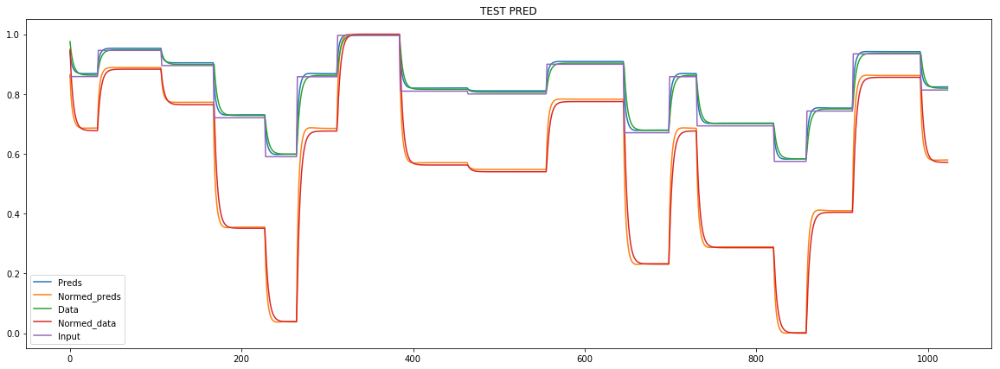

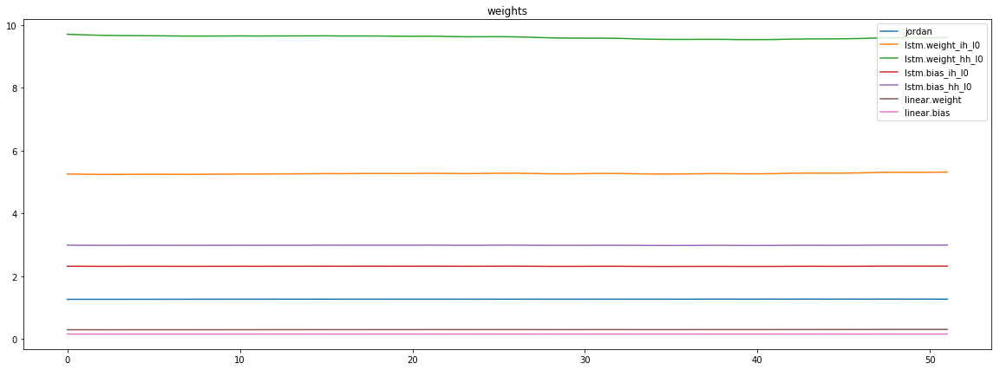

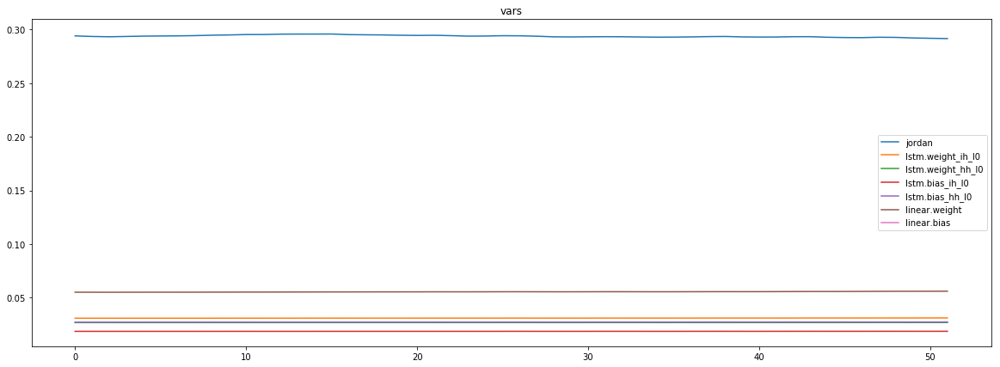

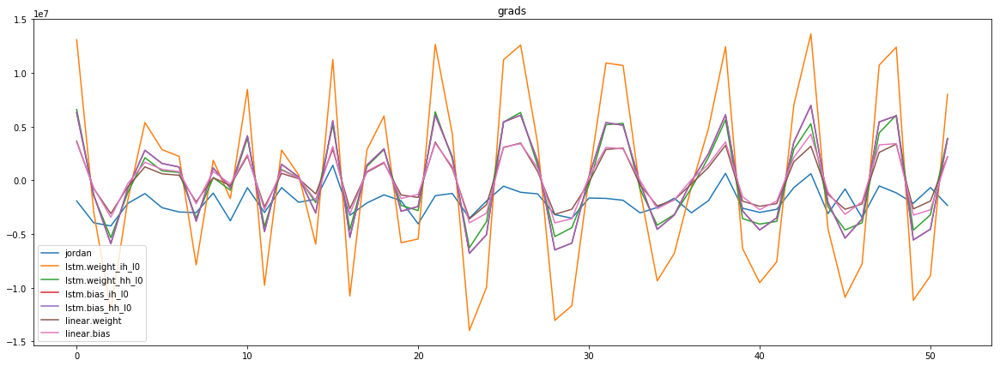

mean_p1 : -1986912.6586538462
mean_p2 : -6735.2854567307695


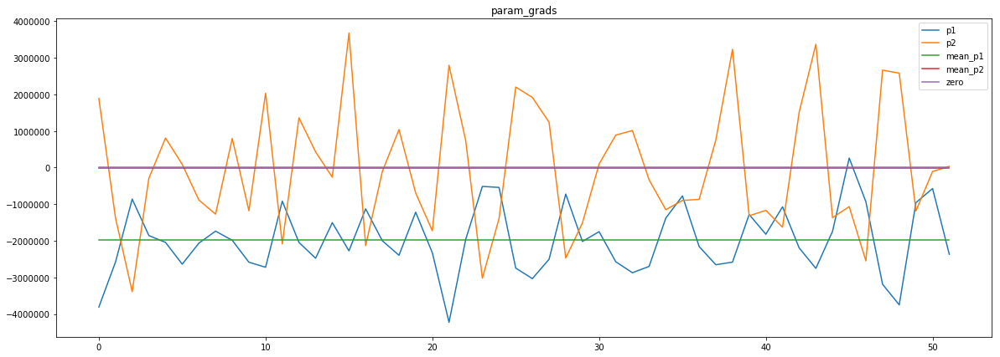

loss rate [0.08618262033402613]
Epoch [17] 
     train_loss[262401.5684344952] 
     eval_train[256181.42728365381] 
     eval_test[264388.4236505682]



aux preds: 0.25537237524986267 1.0138415098190308
main loss 0.0
aux loss 79044.59344951923
jord loss 172369.728515625
combined loss 251414.32196514425 



Parameter containing:
tensor([[0.2554, 1.0138]], requires_grad=True)


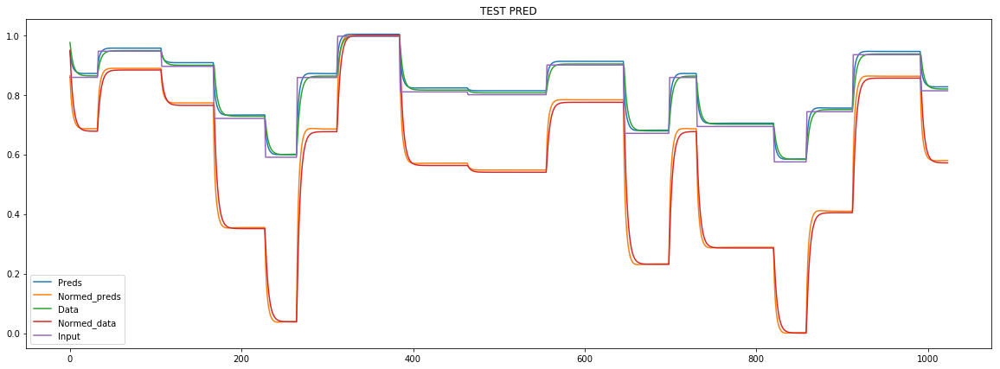

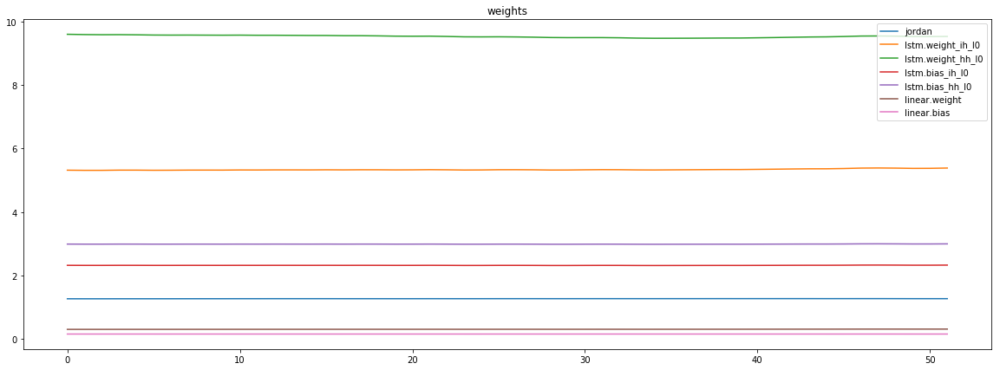

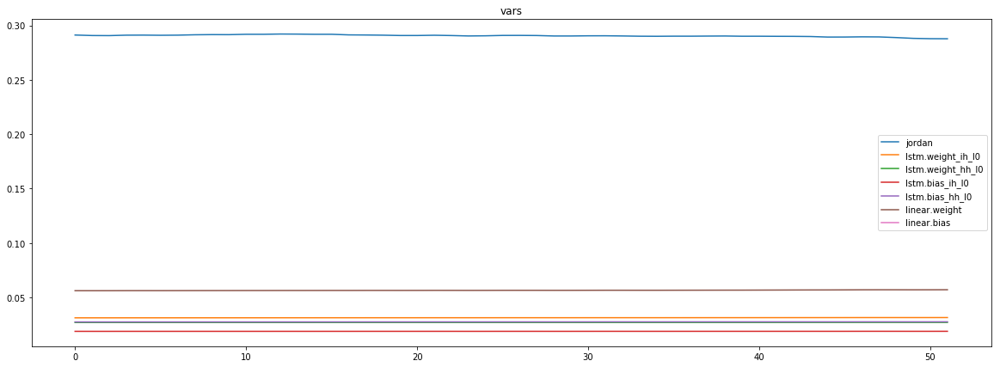

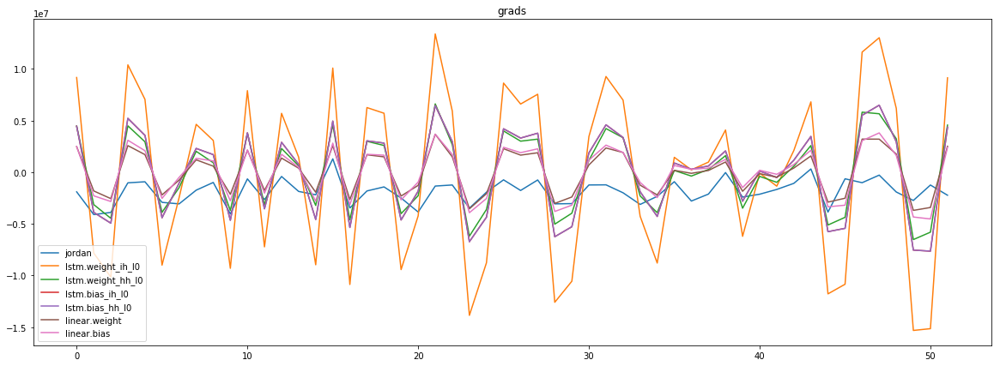

mean_p1 : -1875058.8485576923
mean_p2 : -11345.650390625


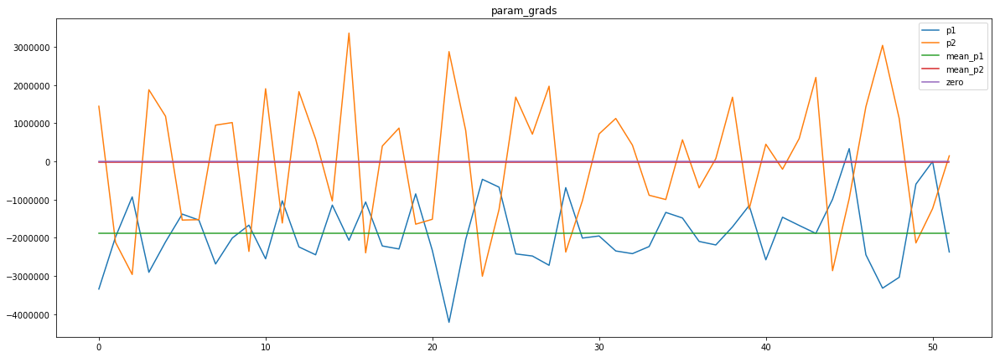

loss rate [0.06623834156675545]
Epoch [18] 
     train_loss[251414.32196514425] 
     eval_train[253062.6114032452] 
     eval_test[260210.974609375]



aux preds: 0.2594588100910187 1.0133684873580933
main loss 0.0
aux loss 81126.52779447116
jord loss 167370.39783653847
combined loss 248496.92563100962 



Parameter containing:
tensor([[0.2595, 1.0134]], requires_grad=True)


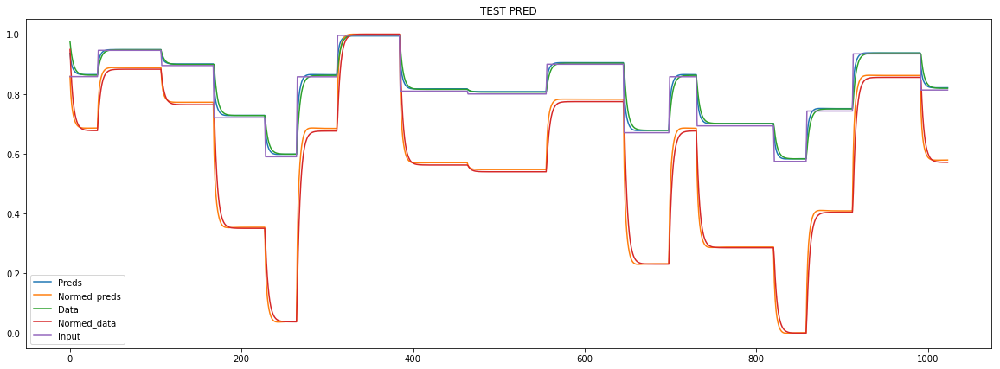

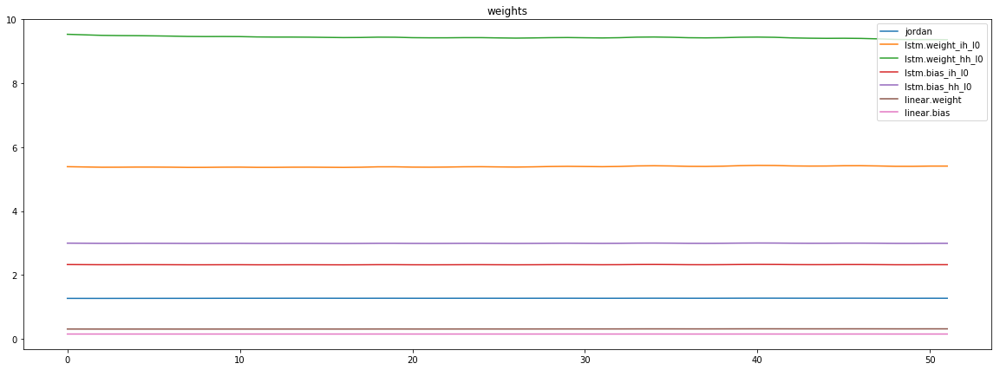

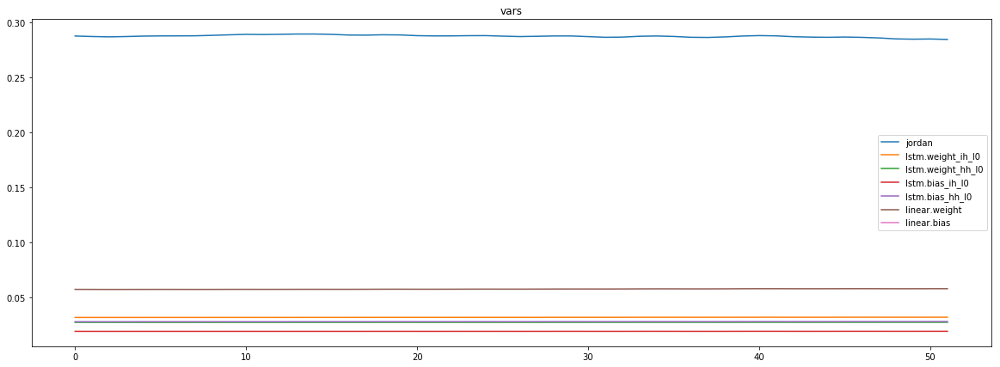

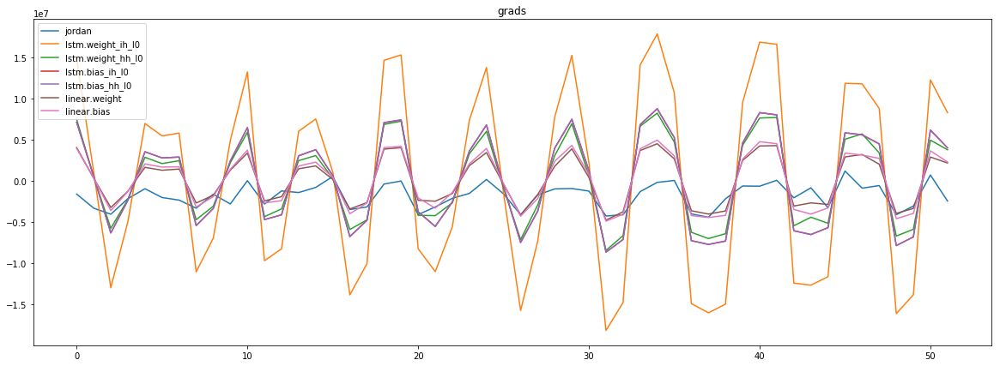

mean_p1 : -1855128.8040865385
mean_p2 : 27523.92638221154


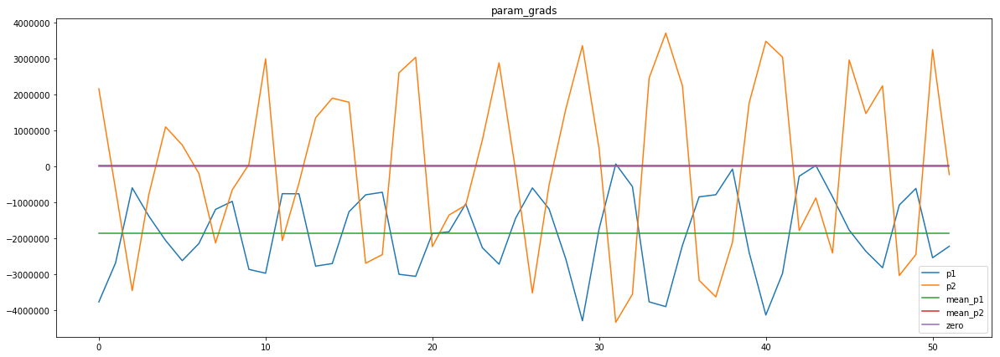

loss rate [0.08990728453887453]
Epoch [19] 
     train_loss[248496.92563100962] 
     eval_train[234994.94350961538] 
     eval_test[244102.529296875]



aux preds: 0.26354193687438965 1.014221429824829
main loss 0.0
aux loss 77956.44737830528
jord loss 162347.96364182694
combined loss 240304.41102013222 



Parameter containing:
tensor([[0.2635, 1.0142]], requires_grad=True)


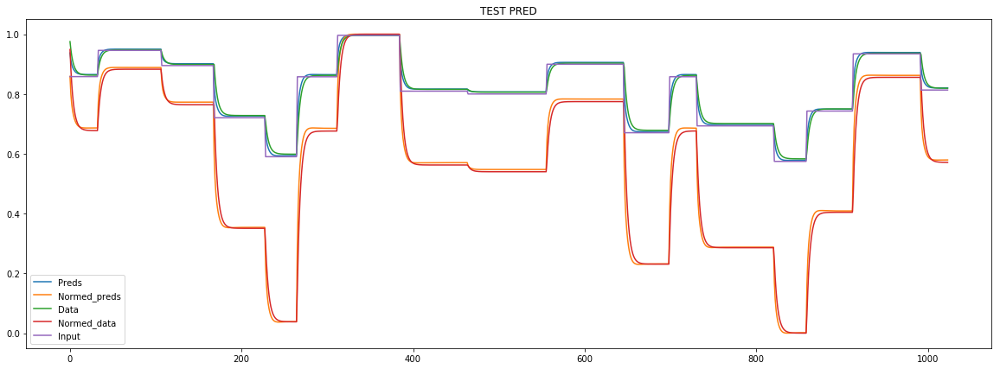

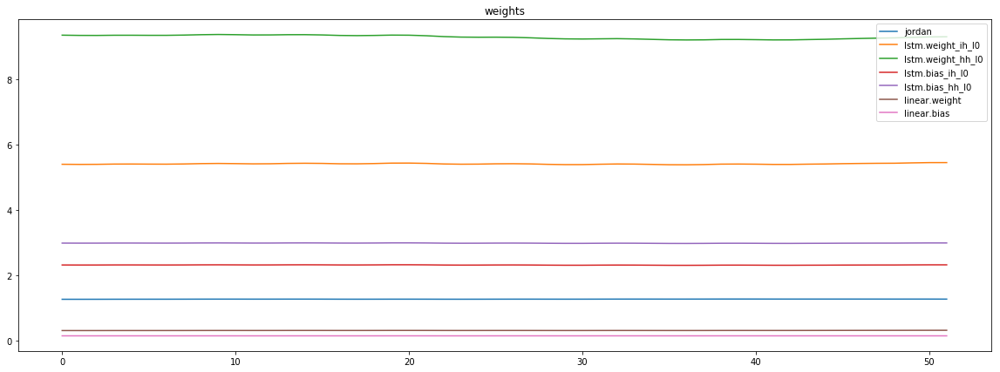

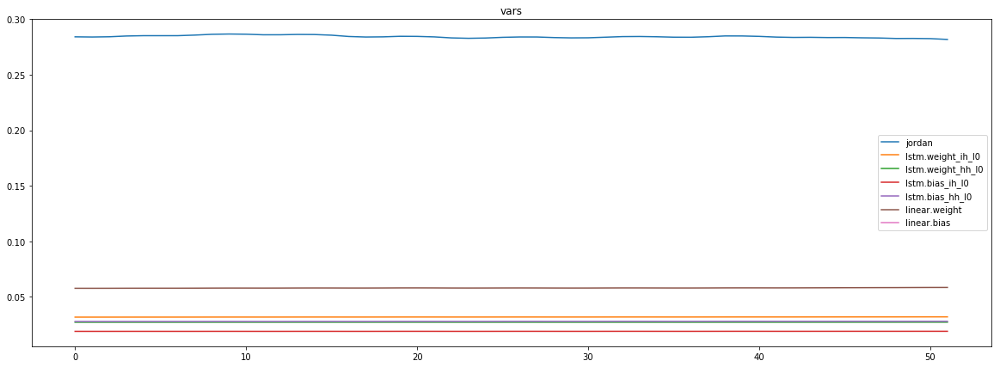

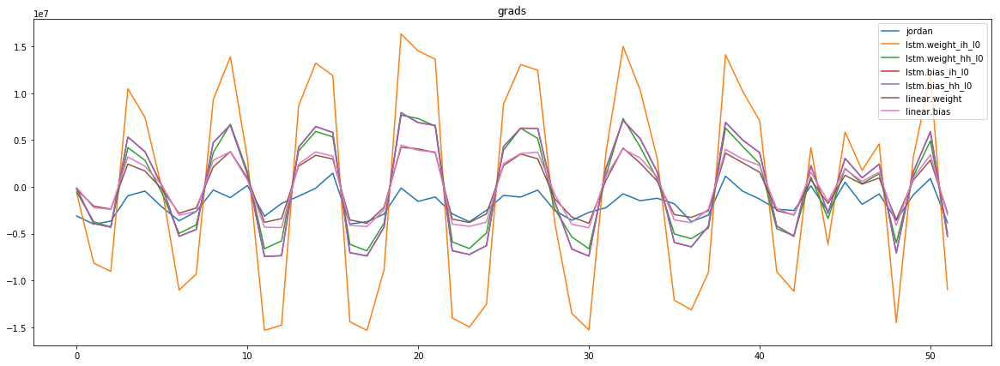

mean_p1 : -1737555.2584134615
mean_p2 : -32367.919471153848


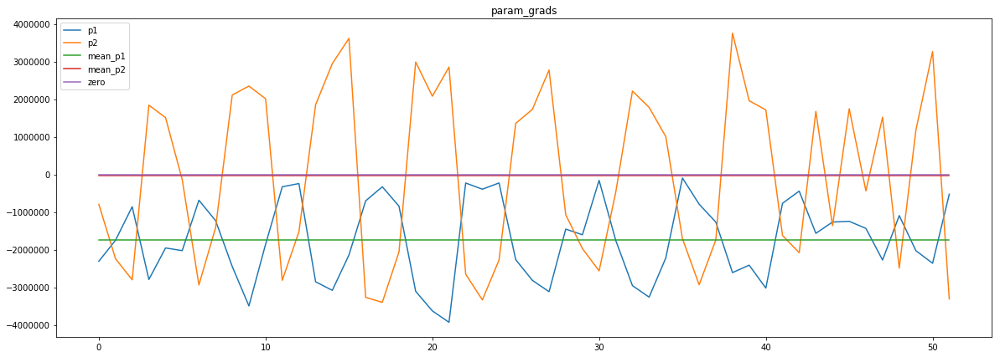

loss rate [0.08695419376529856]
Epoch [20] 
     train_loss[240304.41102013222] 
     eval_train[225537.4942157452] 
     eval_test[233953.35706676135]



aux preds: 0.2675081491470337 1.0139271020889282
main loss 0.0
aux loss 67499.71649639423
jord loss 157347.5821063702
combined loss 224847.29860276444 



Parameter containing:
tensor([[0.2675, 1.0139]], requires_grad=True)


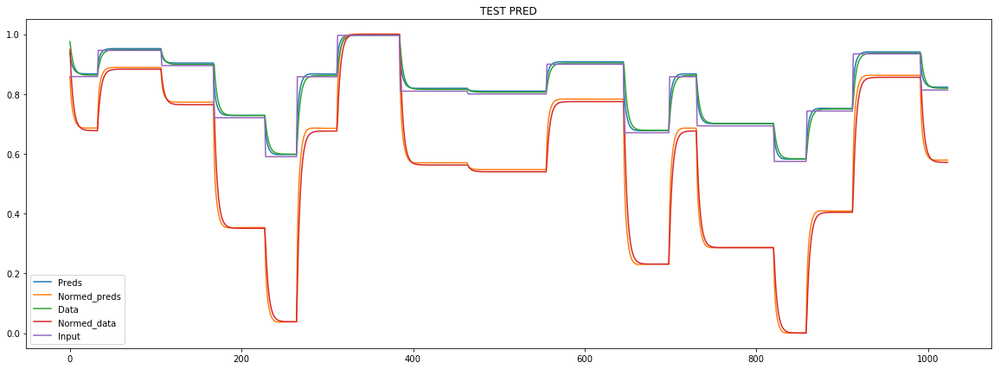

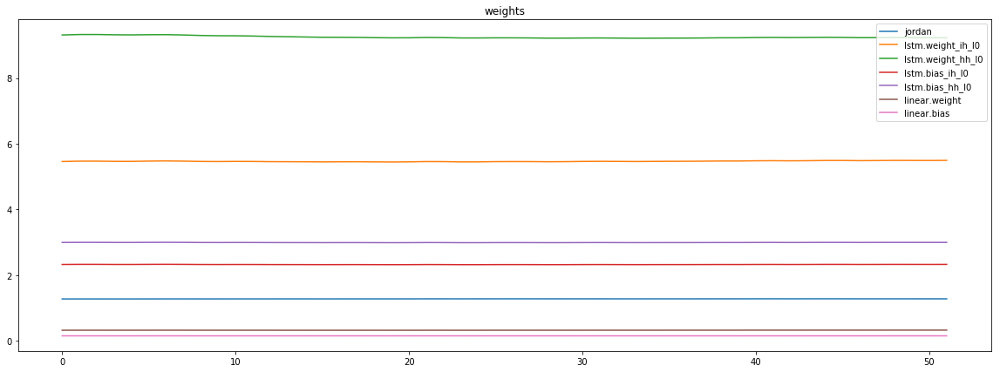

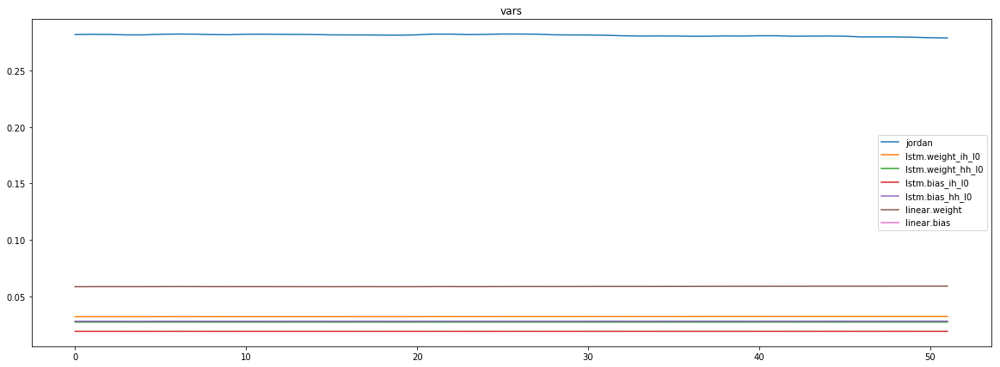

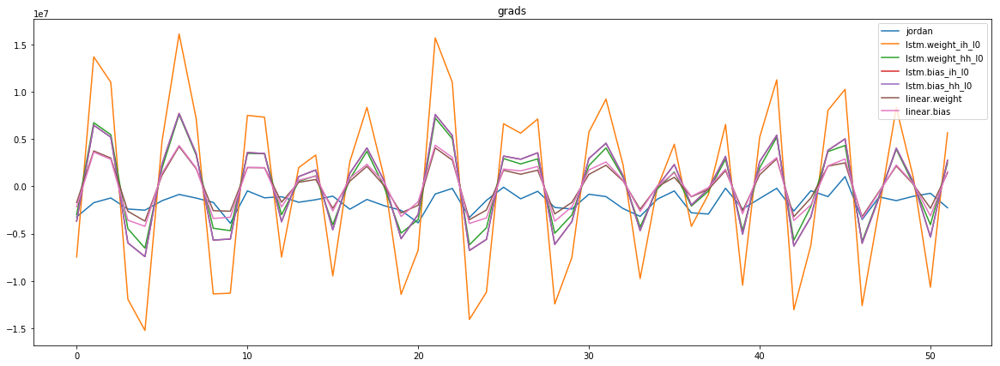

mean_p1 : -1636300.1189903845
mean_p2 : 10855.540264423076


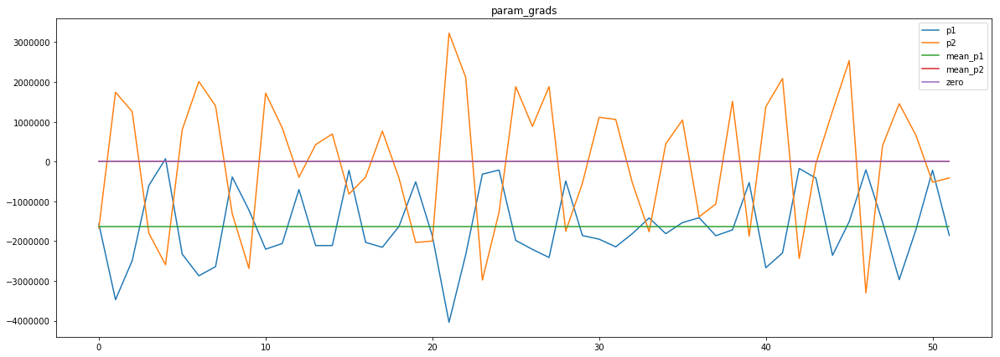

loss rate [0.08211780032333338]
Epoch [21] 
     train_loss[224847.29860276444] 
     eval_train[218157.29991736778] 
     eval_test[225880.67009943182]



aux preds: 0.2714785039424896 1.0150611400604248
main loss 0.0
aux loss 65219.60775991587
jord loss 152786.96559495194
combined loss 218006.5733548678 



Parameter containing:
tensor([[0.2715, 1.0151]], requires_grad=True)


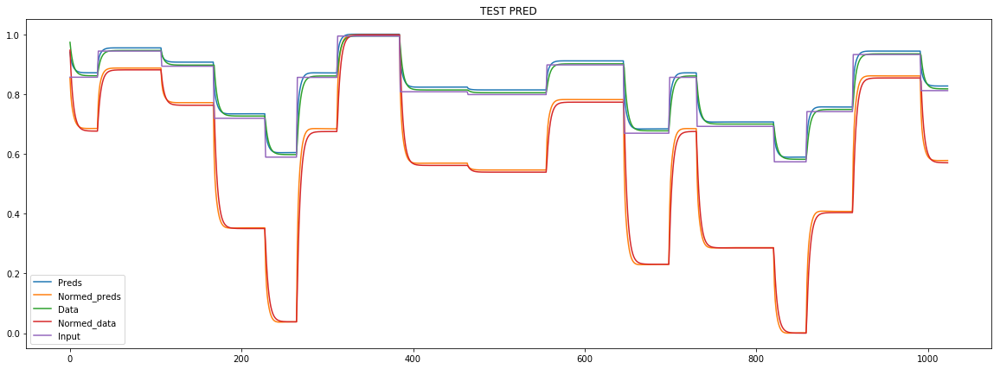

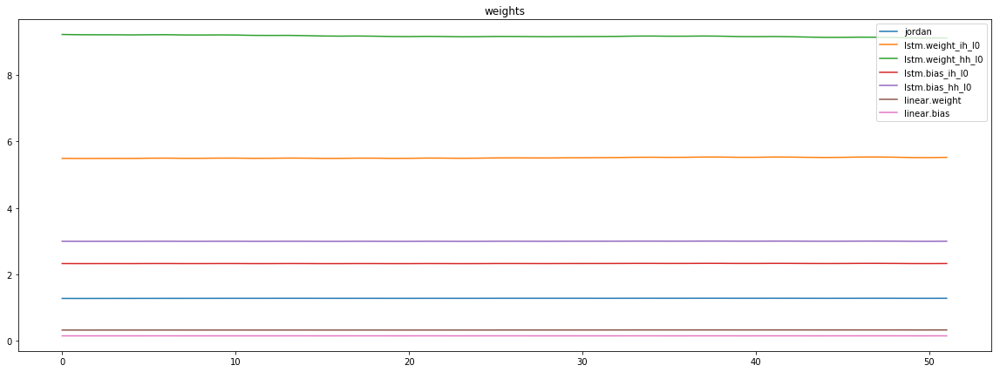

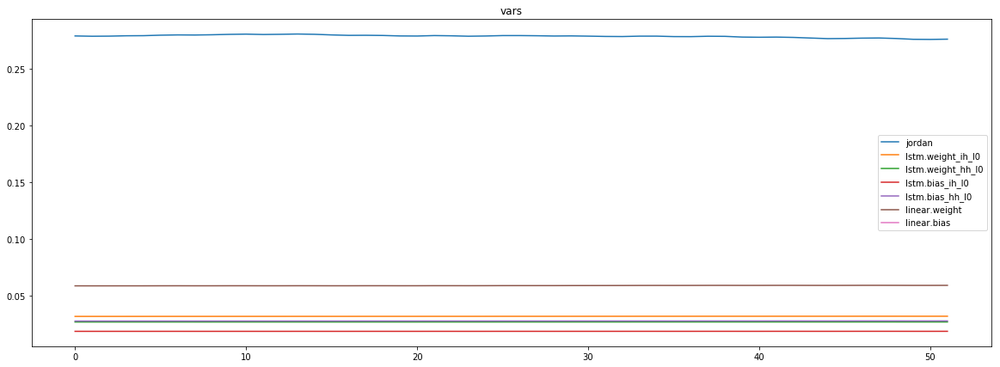

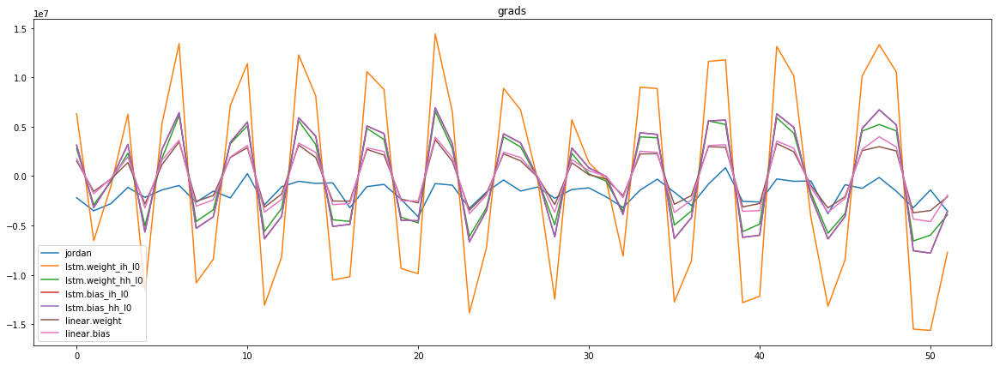

mean_p1 : -1559306.9471153845
mean_p2 : -92125.81670673077


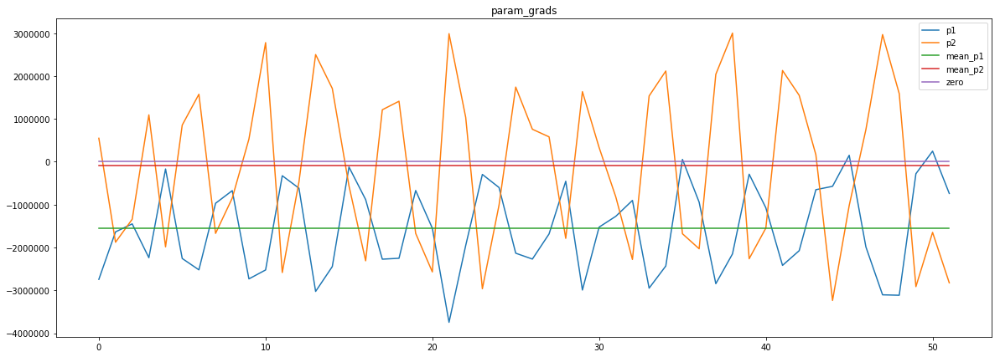

loss rate [-0.022865045973353704]
Epoch [22] 
     train_loss[218006.5733548678] 
     eval_train[234512.26111778847] 
     eval_test[240010.69939630682]



aux preds: 0.27550506591796875 1.014394998550415
main loss 0.0
aux loss 67961.45387620192
jord loss 148289.33188100962
combined loss 216250.78575721156 



Parameter containing:
tensor([[0.2755, 1.0144]], requires_grad=True)


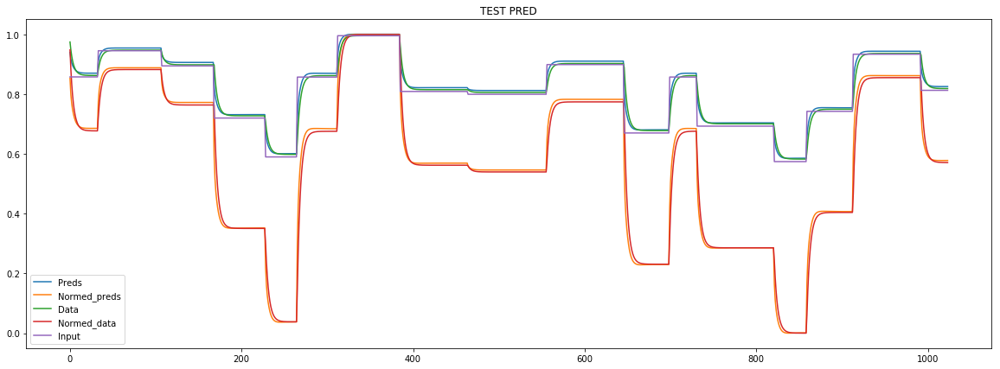

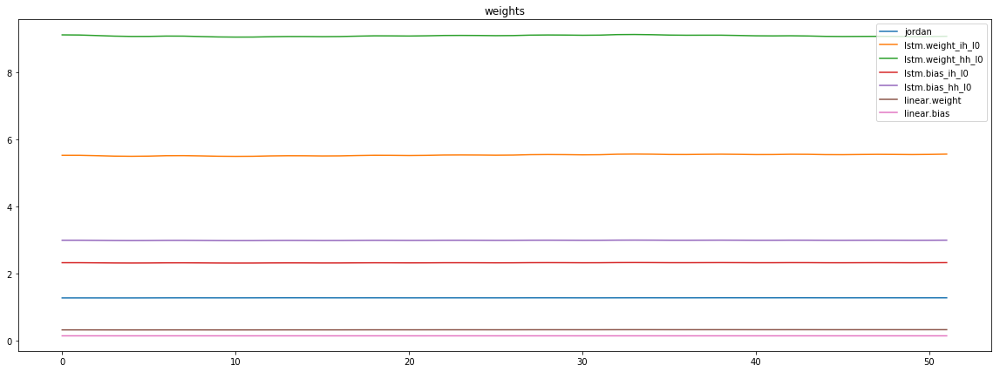

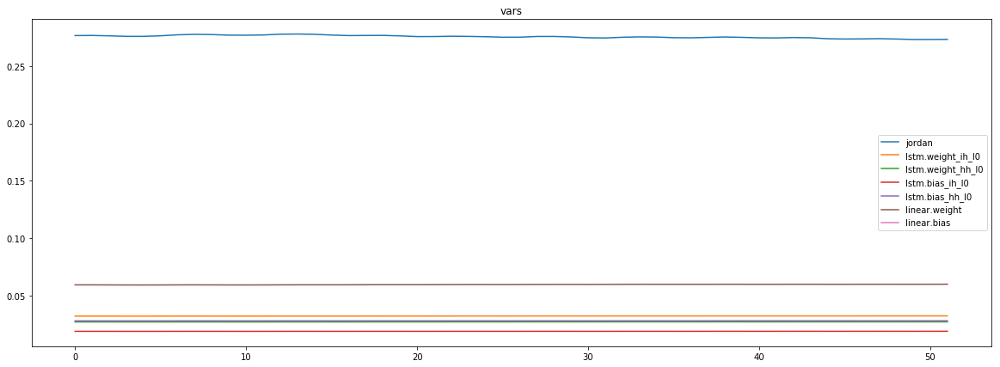

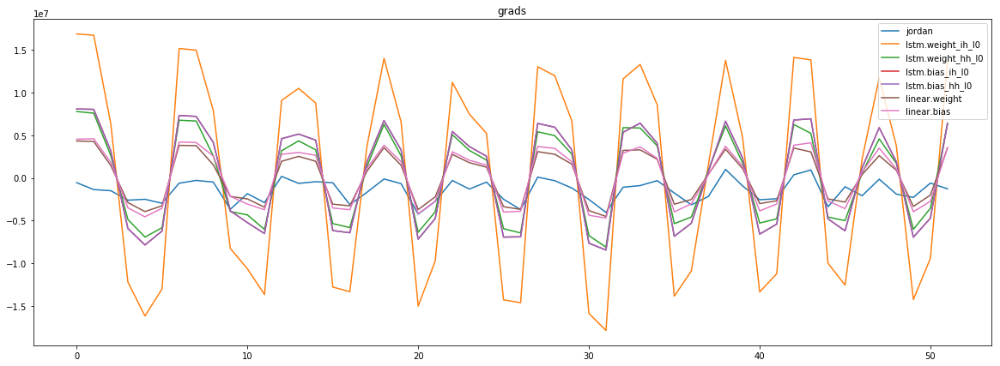

mean_p1 : -1574454.8221153845
mean_p2 : 85406.51742788461


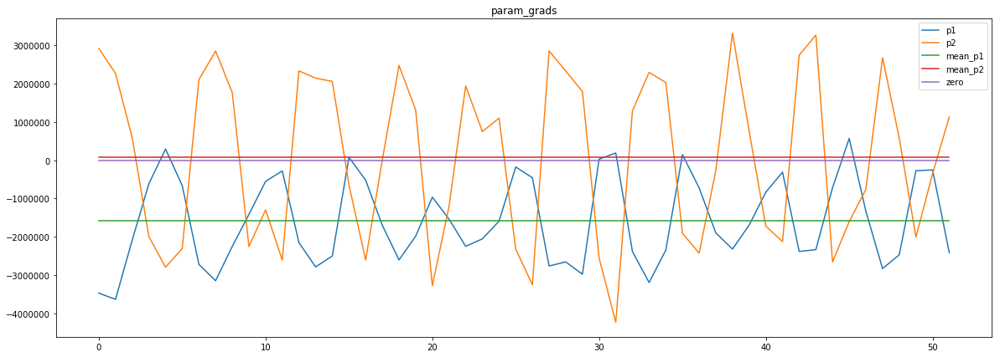

loss rate [0.05808272989734553]
Epoch [23] 
     train_loss[216250.78575721156] 
     eval_train[213752.9520733173] 
     eval_test[219731.94477982956]



aux preds: 0.2794623374938965 1.0146360397338867
main loss 0.0
aux loss 63594.70094651442
jord loss 143939.05739182694
combined loss 207533.75833834137 



Parameter containing:
tensor([[0.2795, 1.0146]], requires_grad=True)


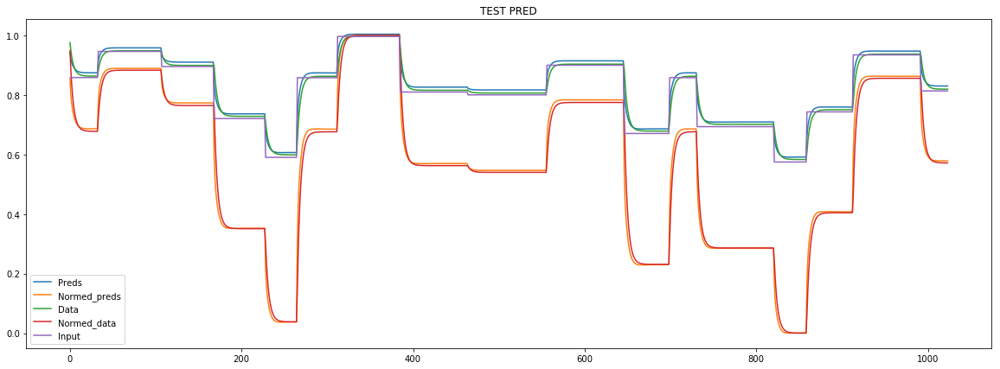

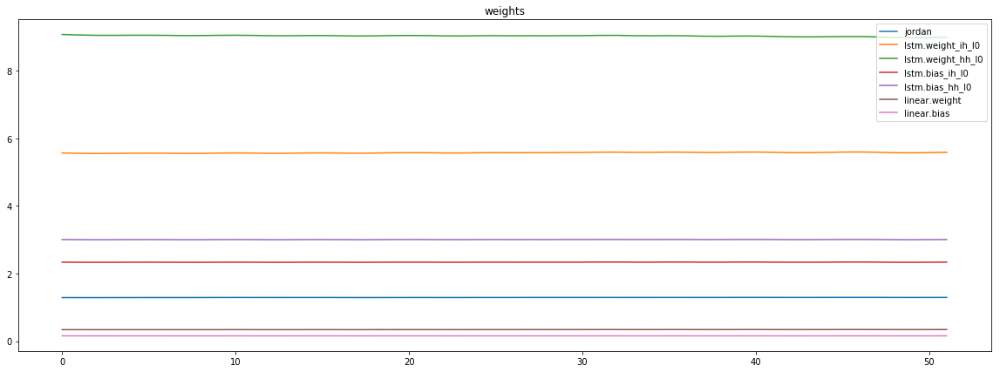

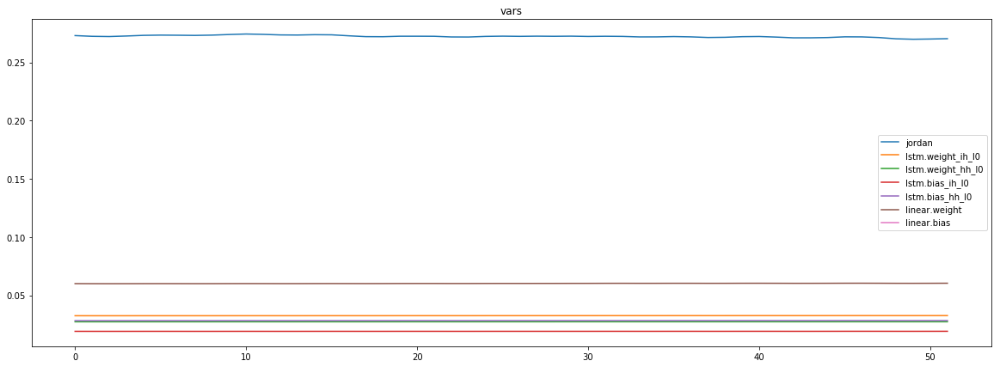

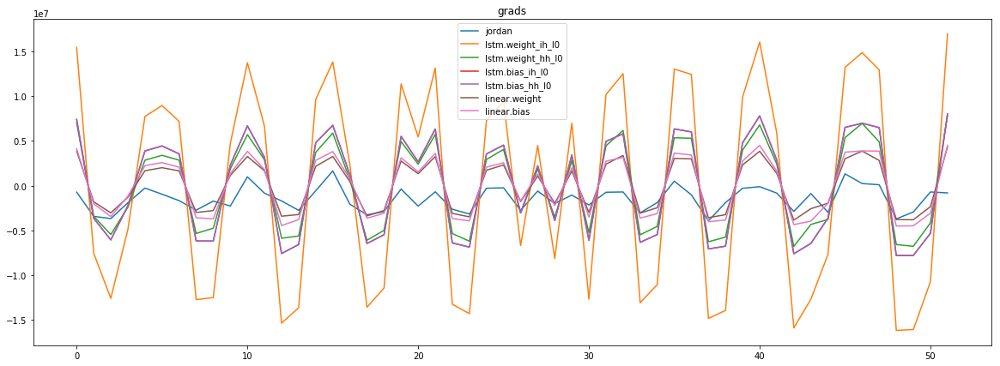

mean_p1 : -1458597.953125
mean_p2 : -7742.3870192307695


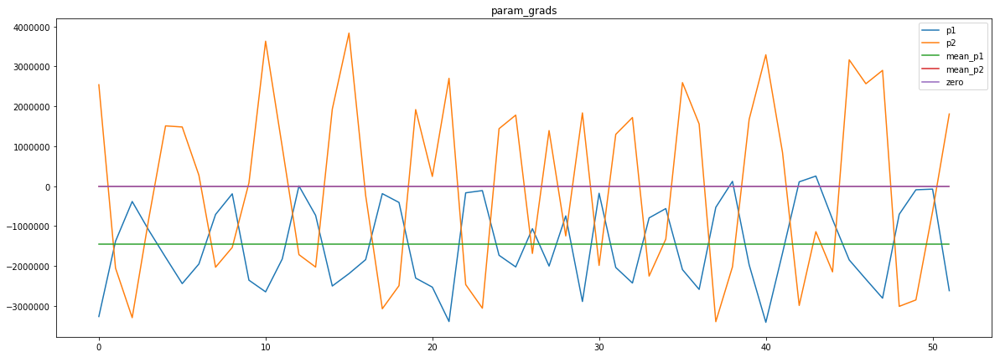

loss rate [-0.00209122370257675]
Epoch [24] 
     train_loss[207533.75833834137] 
     eval_train[223917.99496694712] 
     eval_test[229019.03533380682]



aux preds: 0.2834167182445526 1.0145424604415894
main loss 0.0
aux loss 64165.632286658656
jord loss 139785.89986478366
combined loss 203951.5321514423 



Parameter containing:
tensor([[0.2834, 1.0145]], requires_grad=True)


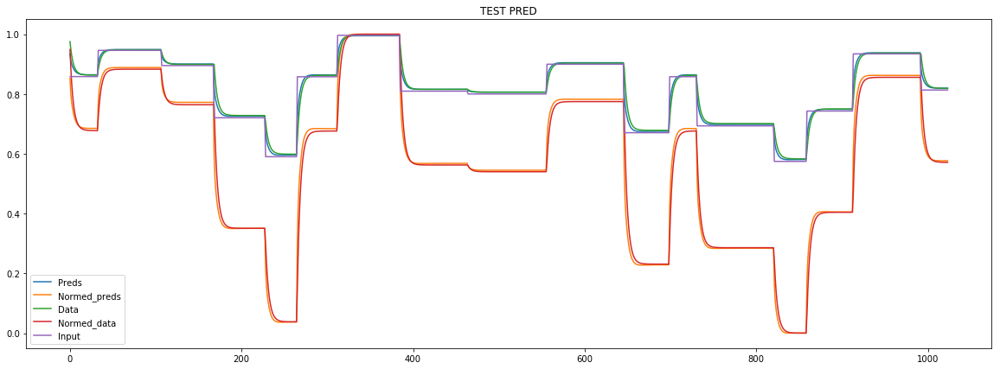

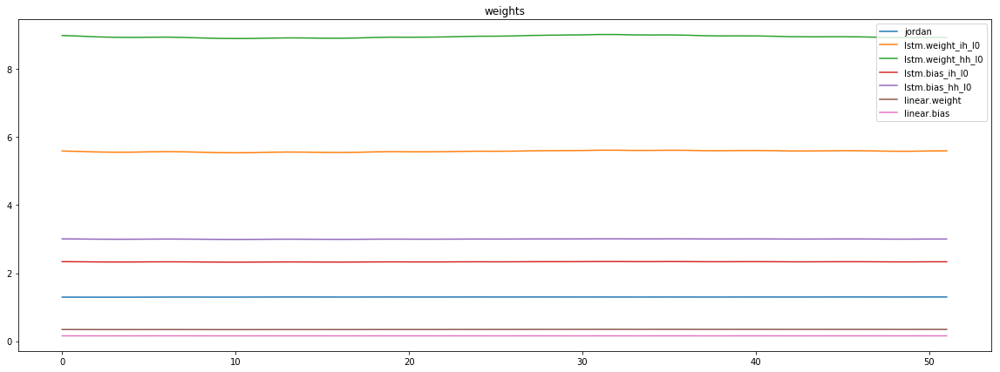

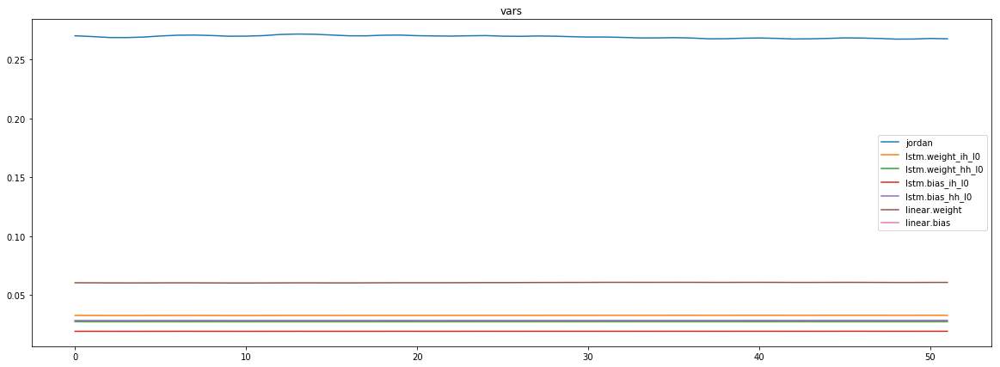

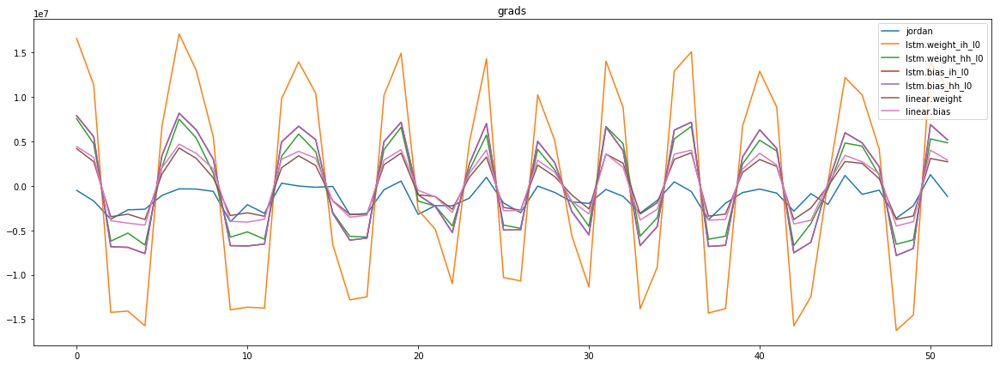

mean_p1 : -1427841.6772836538
mean_p2 : 29974.091947115383


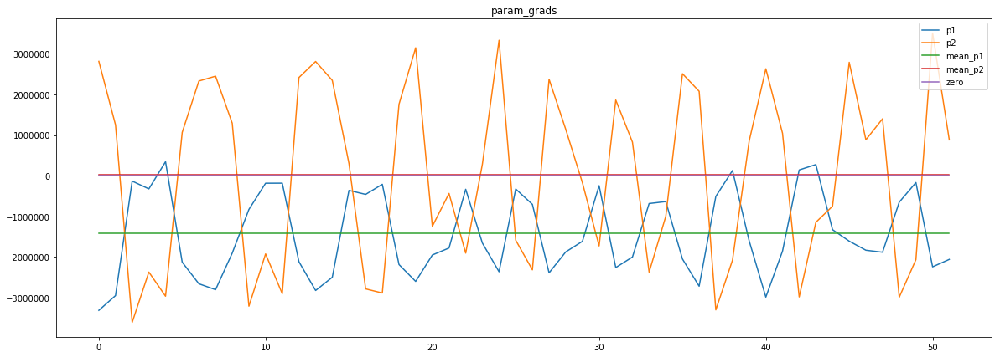

loss rate [0.138649004600913]
Epoch [25] 
     train_loss[203951.5321514423] 
     eval_train[190574.91056941106] 
     eval_test[197755.18607954547]



aux preds: 0.28731706738471985 1.0140026807785034
main loss 0.0
aux loss 58228.526179387016
jord loss 135720.2715594952
combined loss 193948.7977388822 



Parameter containing:
tensor([[0.2873, 1.0140]], requires_grad=True)


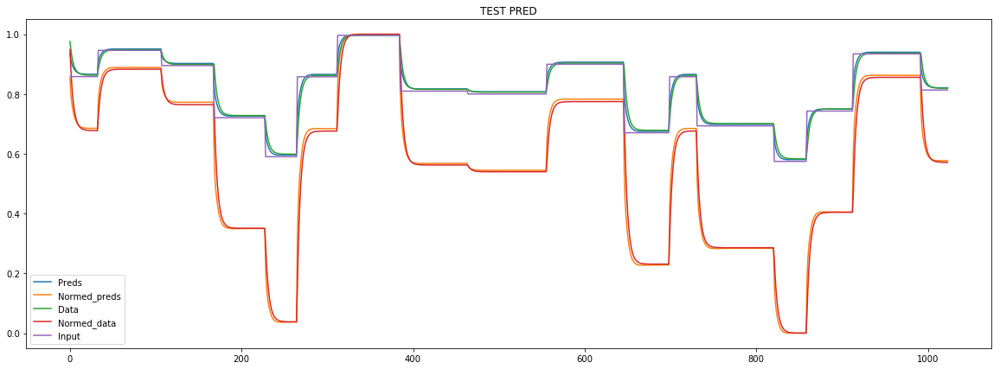

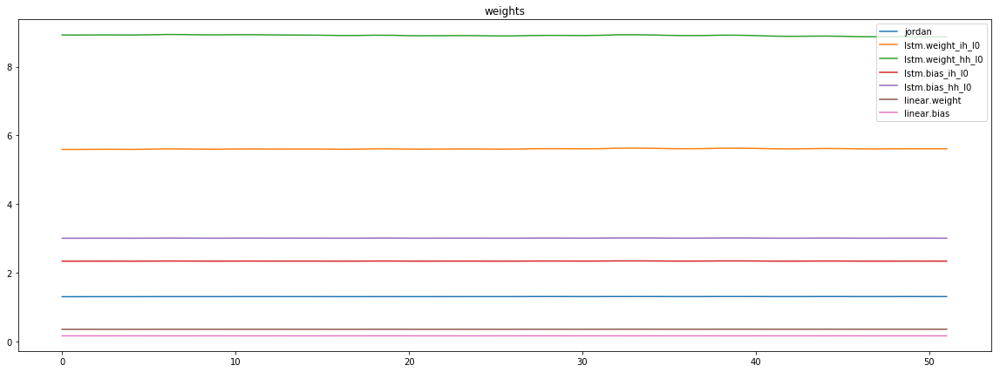

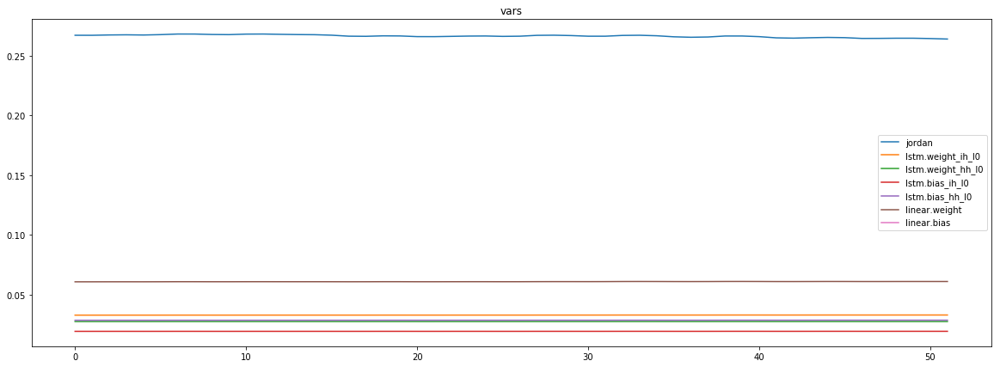

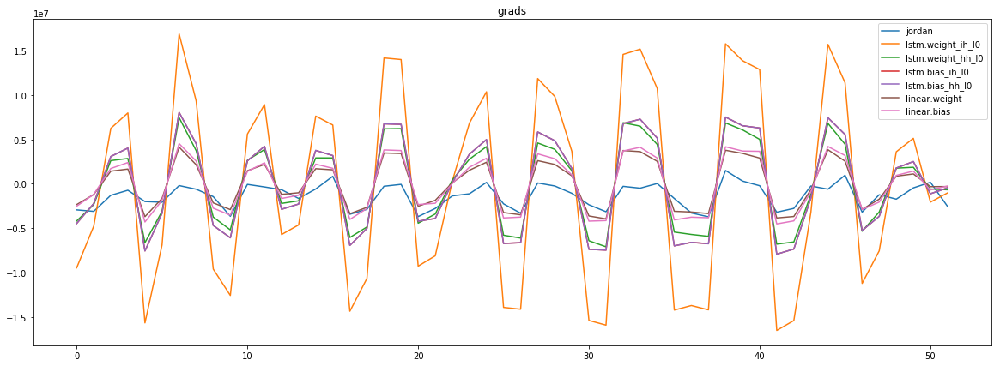

mean_p1 : -1329156.9435096155
mean_p2 : -27098.91736778846


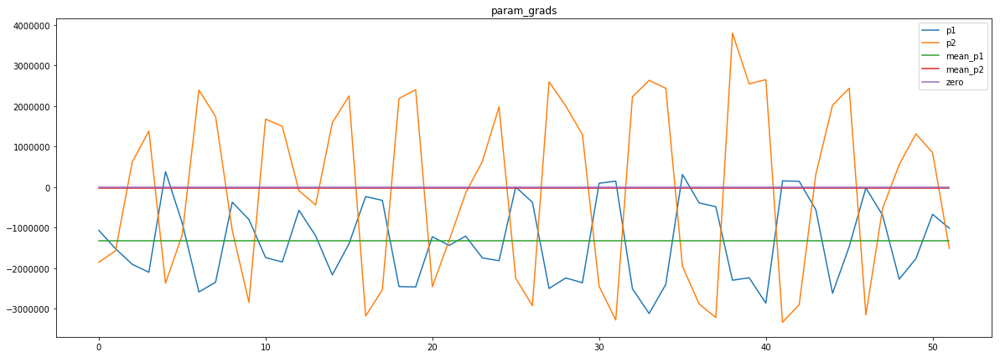

loss rate [0.11572288974490197]
Epoch [26] 
     train_loss[193948.7977388822] 
     eval_train[183670.90343299278] 
     eval_test[190563.53480113635]



aux preds: 0.2910982072353363 1.0136085748672485
main loss 0.0
aux loss 52651.818396935094
jord loss 131826.5956280048
combined loss 184478.4140249399 



Parameter containing:
tensor([[0.2911, 1.0136]], requires_grad=True)


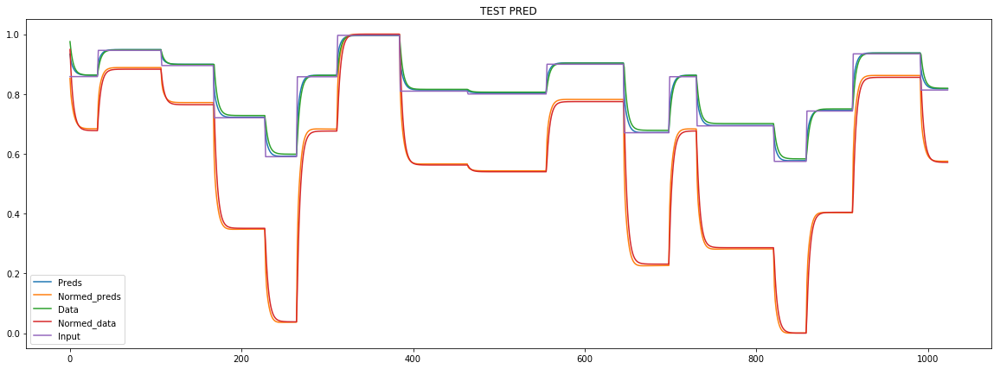

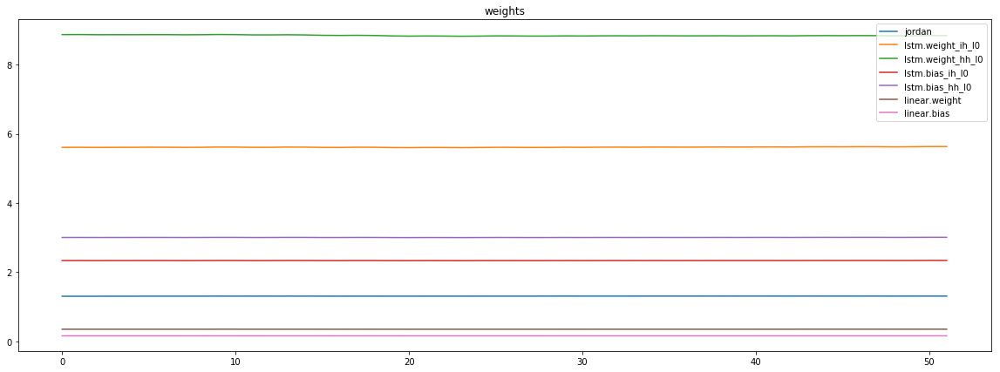

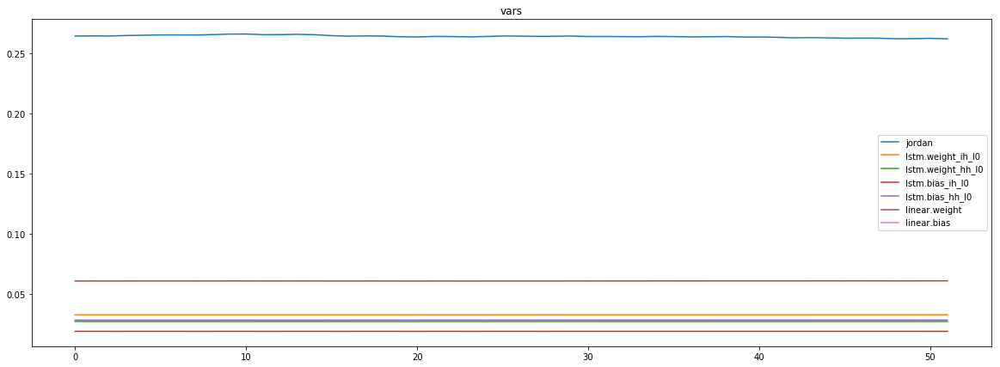

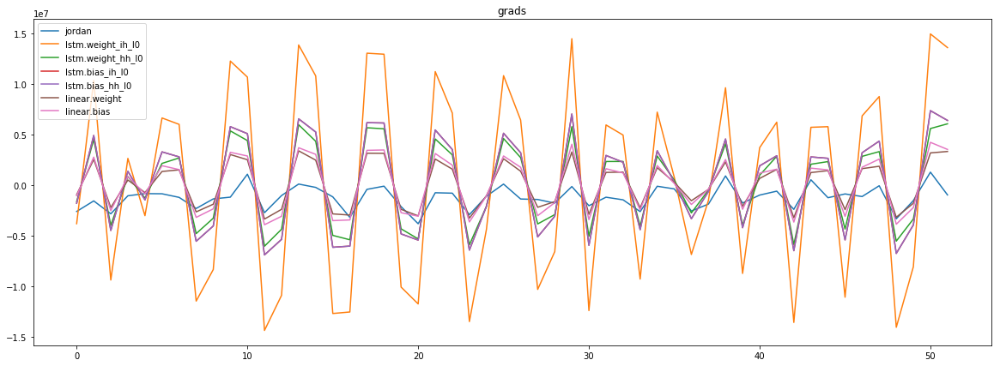

mean_p1 : -1279956.0576923077
mean_p2 : 54070.38100961538


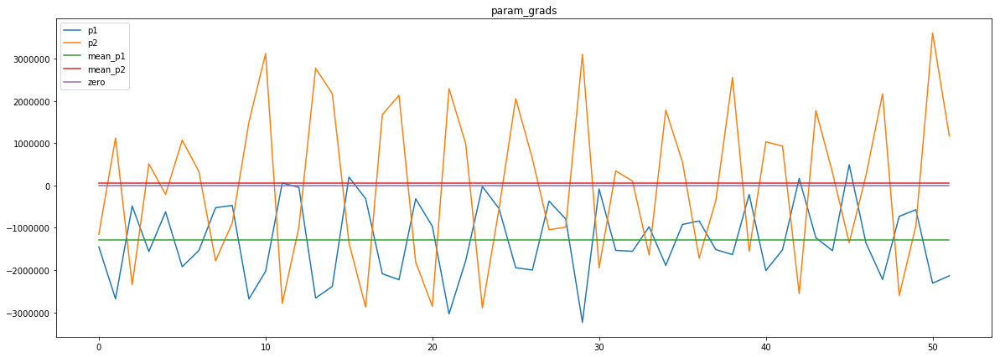

loss rate [0.048587495158899485]
Epoch [27] 
     train_loss[184478.4140249399] 
     eval_train[189094.03673377406] 
     eval_test[195780.95365767044]



aux preds: 0.2948516607284546 1.0151556730270386
main loss 0.0
aux loss 53607.975886418266
jord loss 128143.28177584134
combined loss 181751.25766225962 



Parameter containing:
tensor([[0.2949, 1.0152]], requires_grad=True)


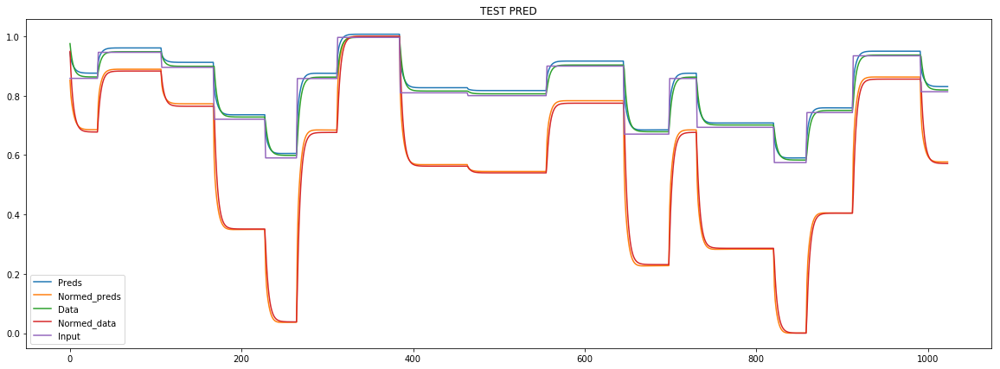

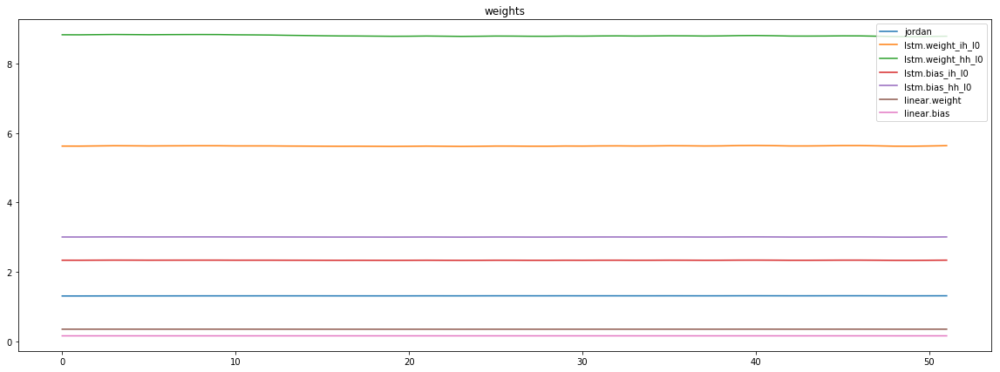

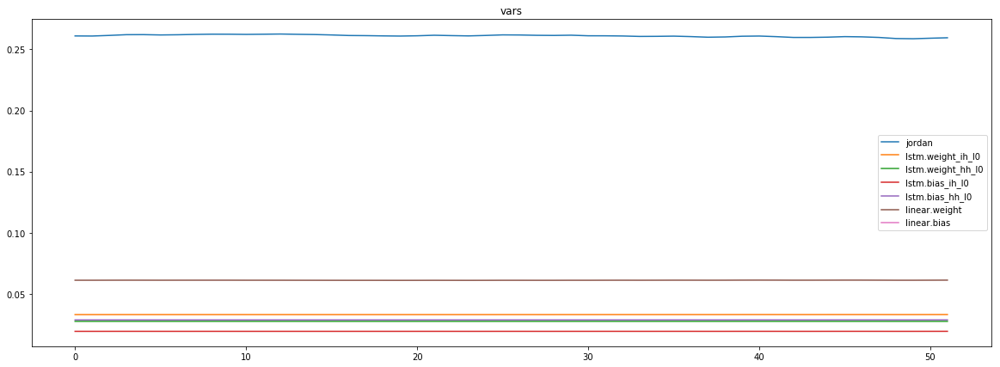

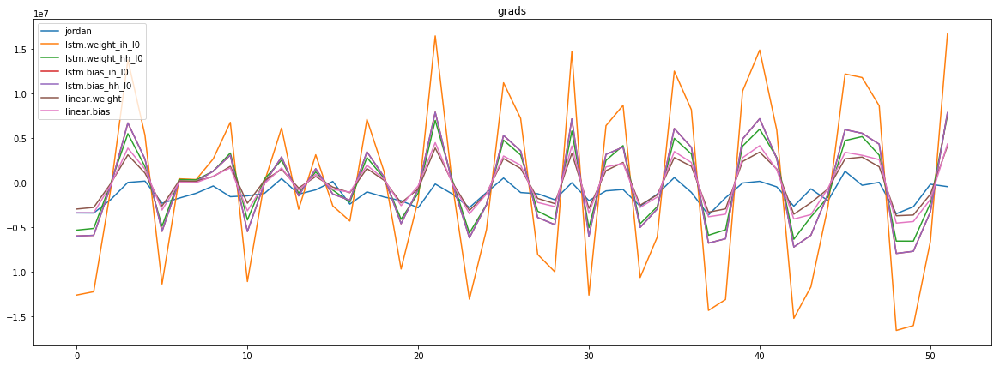

mean_p1 : -1184629.9549278845
mean_p2 : -60783.44320913462


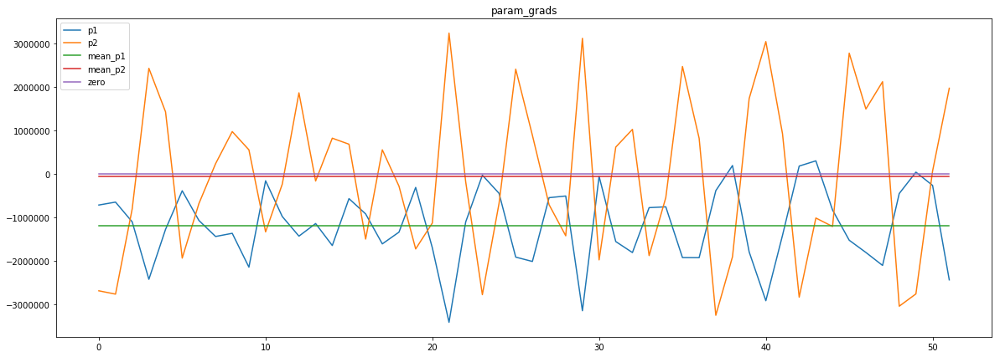

loss rate [-0.08154310994081082]
Epoch [28] 
     train_loss[181751.25766225962] 
     eval_train[205992.17645733175] 
     eval_test[210576.326171875]



aux preds: 0.2986500859260559 1.0144212245941162
main loss 0.0
aux loss 58597.75927734375
jord loss 124597.82249098558
combined loss 183195.5817683293 



Parameter containing:
tensor([[0.2987, 1.0144]], requires_grad=True)


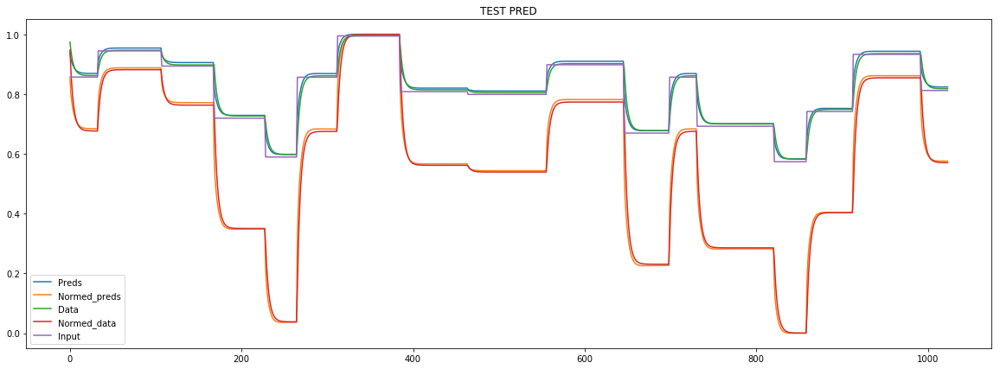

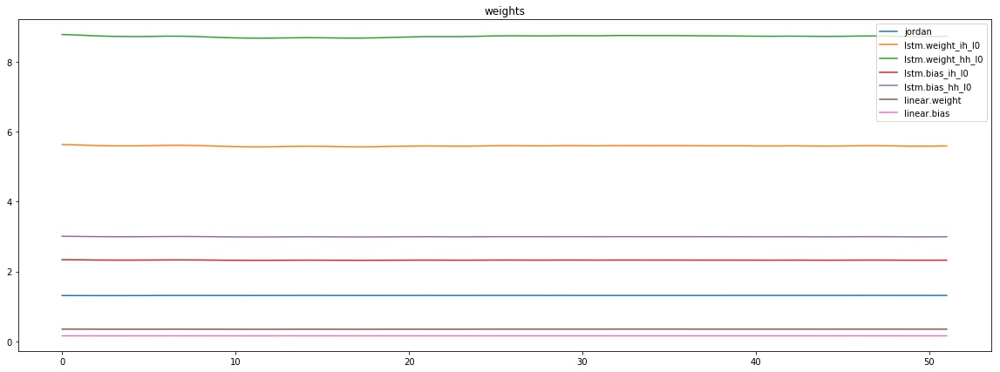

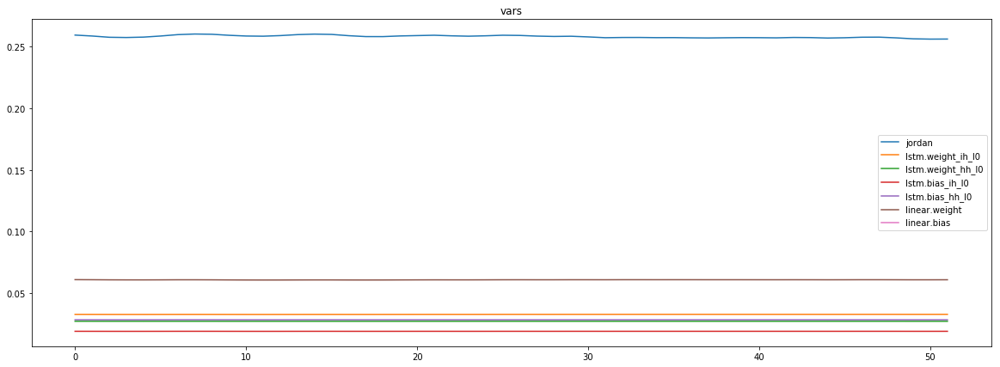

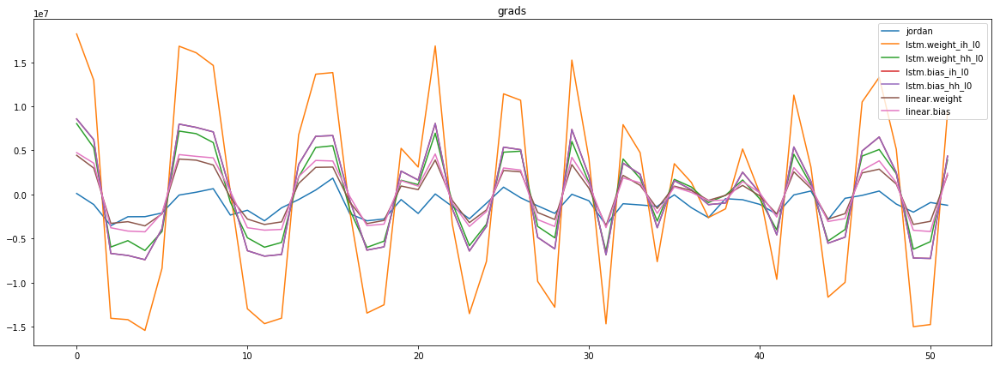

mean_p1 : -1173660.5679086538
mean_p2 : 862.1469350961538


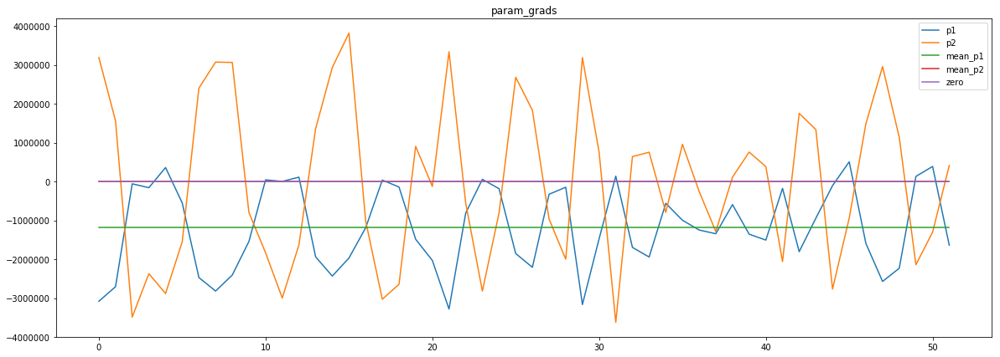

loss rate [0.08370727962221958]
Epoch [29] 
     train_loss[183195.5817683293] 
     eval_train[177283.26893028847] 
     eval_test[182318.06569602274]



aux preds: 0.3024580478668213 1.0136387348175049
main loss 0.0
aux loss 59088.71473106971
jord loss 121111.71446814903
combined loss 180200.42919921875 



Parameter containing:
tensor([[0.3025, 1.0136]], requires_grad=True)


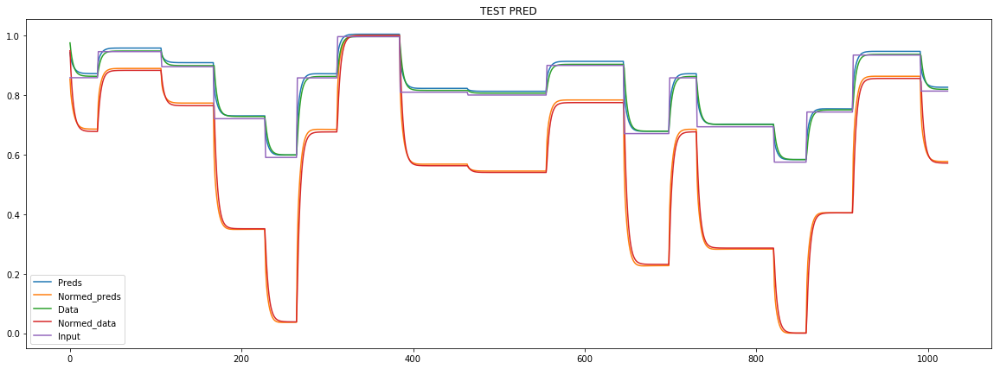

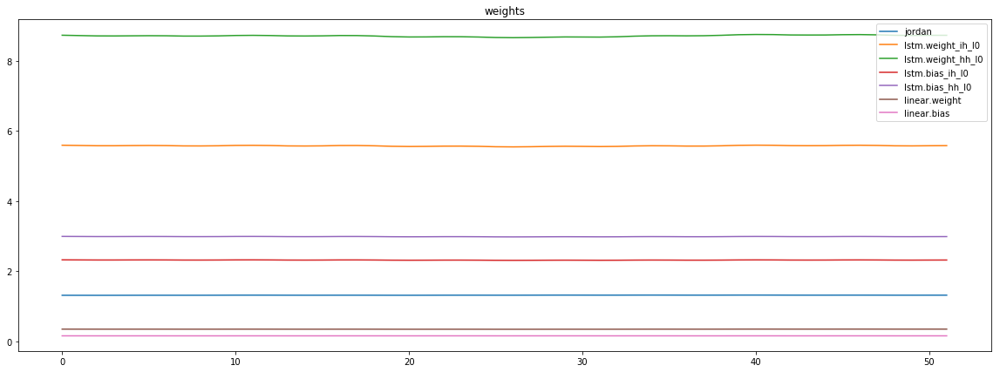

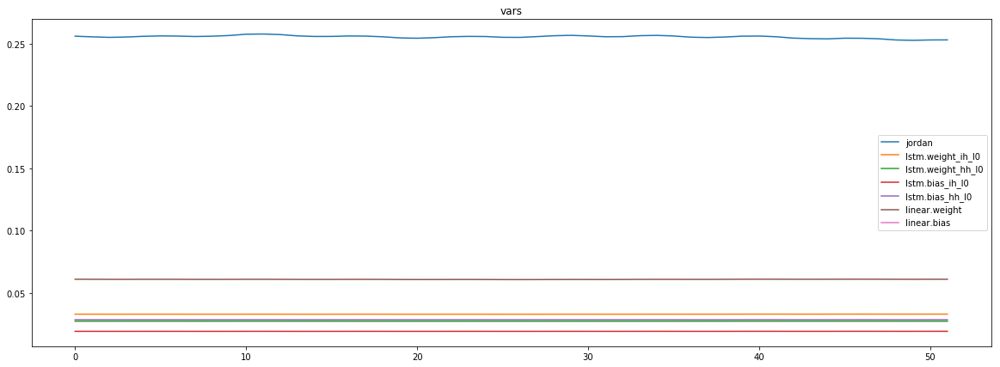

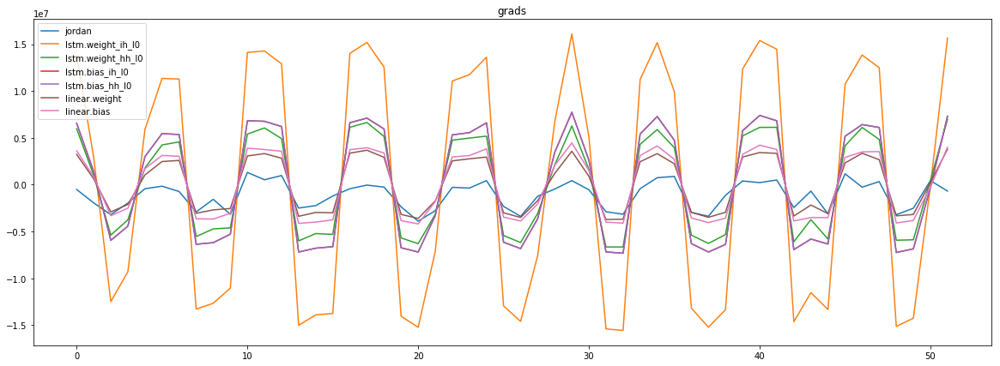

mean_p1 : -1167877.016826923
mean_p2 : 25695.78125


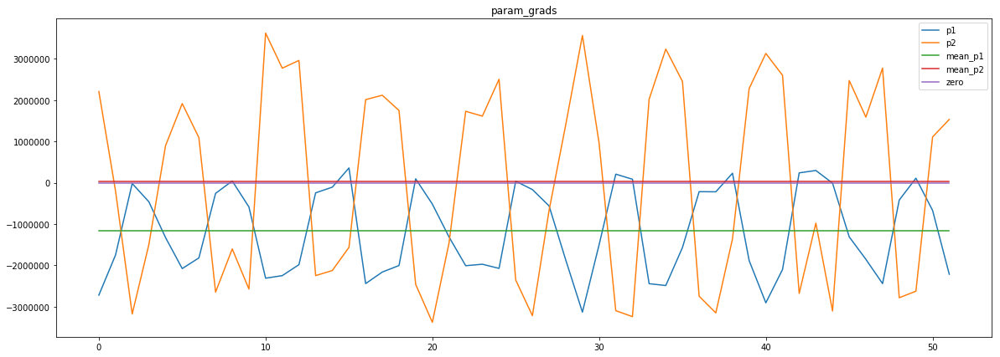

loss rate [0.09113931217681237]
Epoch [30] 
     train_loss[180200.42919921875] 
     eval_train[173686.4196965144] 
     eval_test[178341.29314630682]



aux preds: 0.30619364976882935 1.0145149230957031
main loss 0.0
aux loss 50985.68836388221
jord loss 117686.93930288461
combined loss 168672.6276667668 



Parameter containing:
tensor([[0.3062, 1.0145]], requires_grad=True)


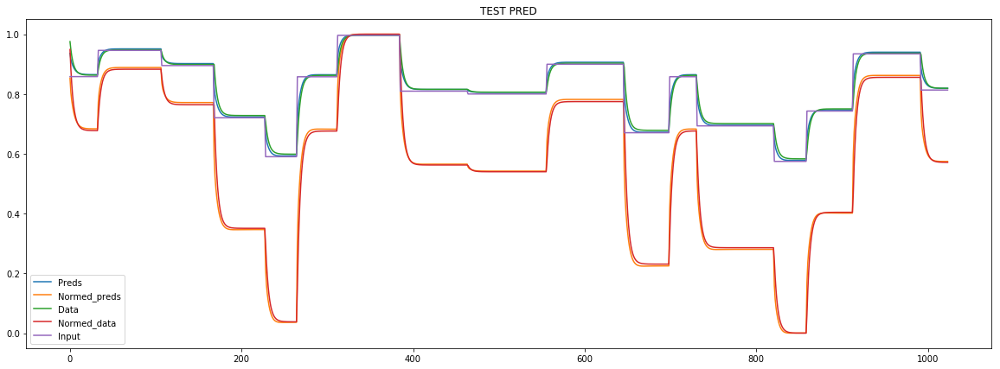

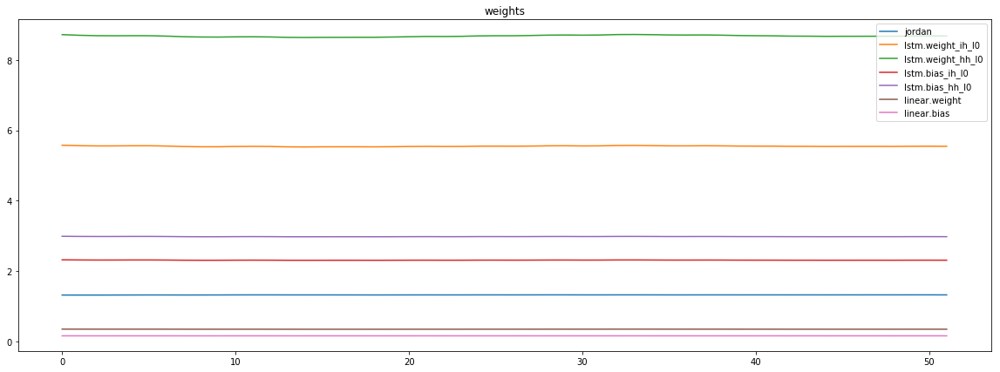

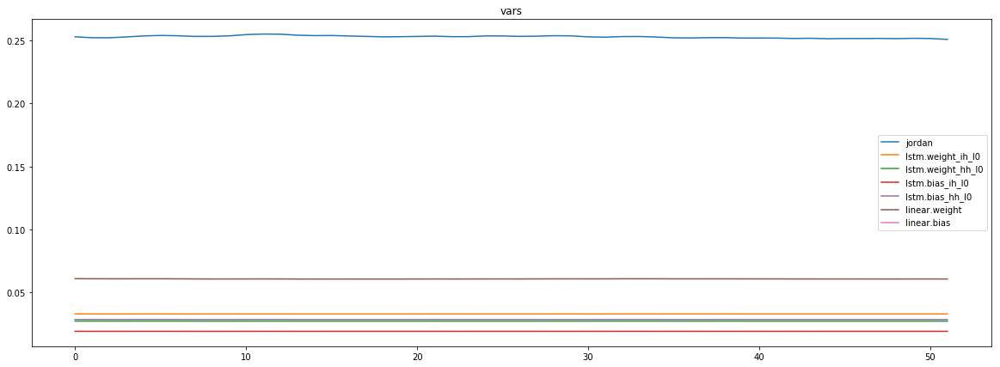

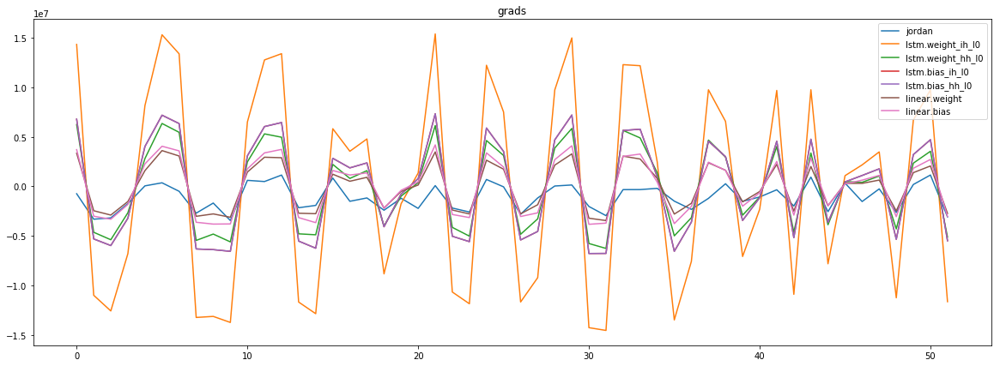

mean_p1 : -1071046.9939903845
mean_p2 : -32499.842998798078


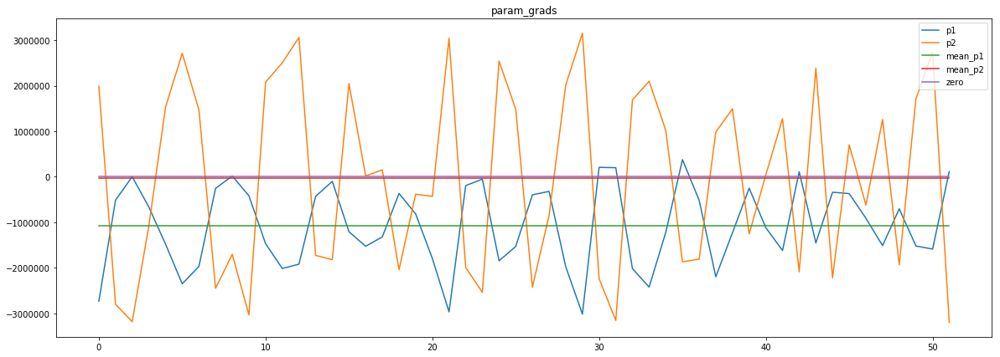

loss rate [0.11050739936454146]
Epoch [31] 
     train_loss[168672.6276667668] 
     eval_train[163539.7614558293] 
     eval_test[169369.9716796875]



aux preds: 0.30986663699150085 1.014260172843933
main loss 0.0
aux loss 48524.257286658656
jord loss 114309.99038461539
combined loss 162834.24767127406 



Parameter containing:
tensor([[0.3099, 1.0143]], requires_grad=True)


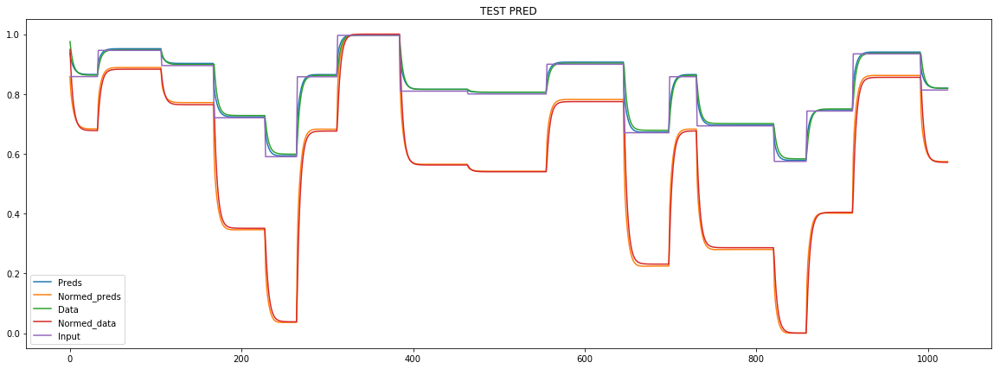

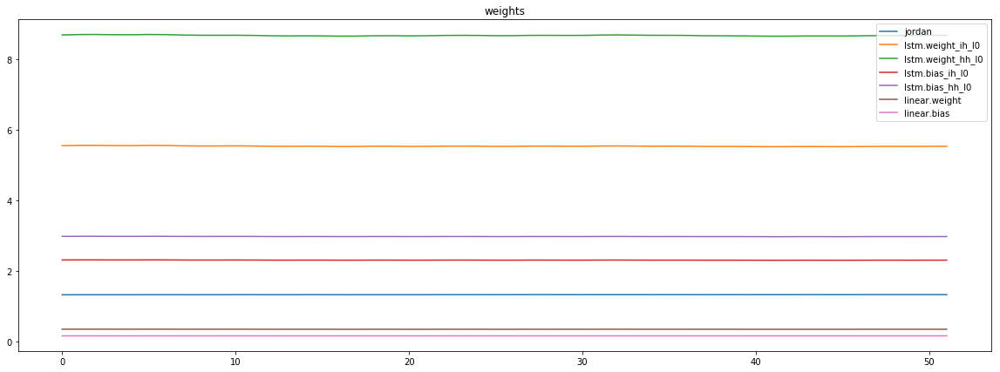

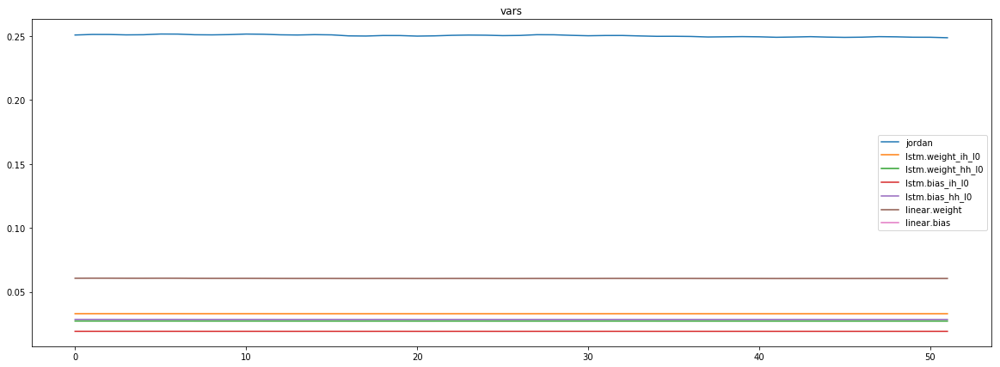

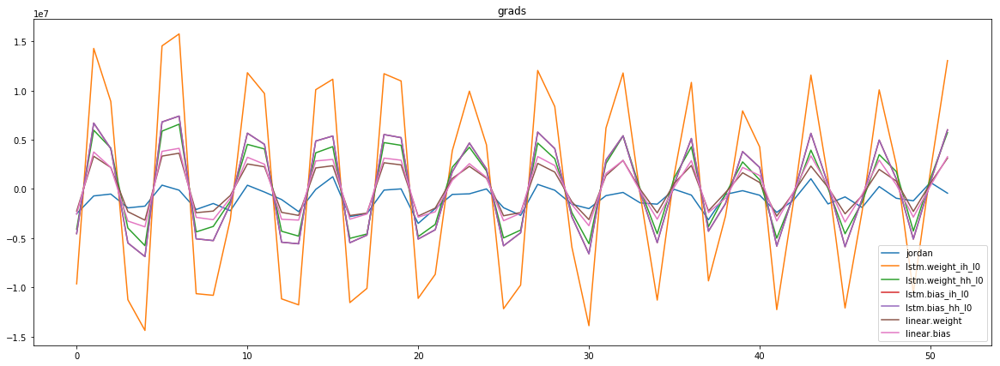

mean_p1 : -1055743.251201923
mean_p2 : 53932.78598257212


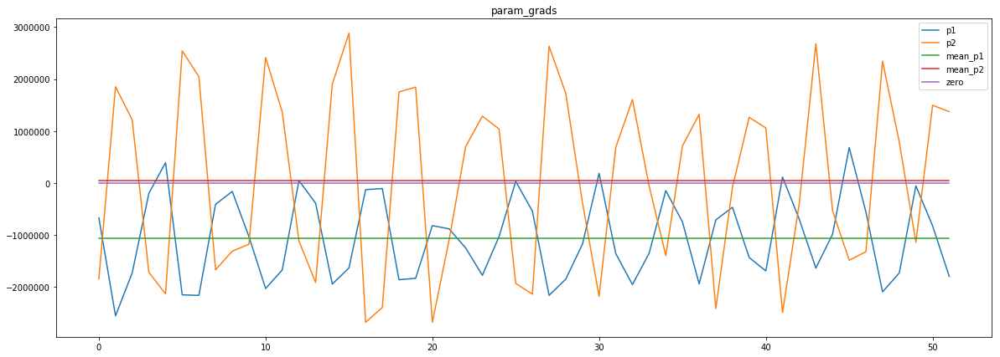

loss rate [0.06753365594485072]
Epoch [32] 
     train_loss[162834.24767127406] 
     eval_train[159109.30776742788] 
     eval_test[164744.83735795453]



aux preds: 0.31350743770599365 1.0138988494873047
main loss 0.0
aux loss 47434.19617638221
jord loss 111197.50465745192
combined loss 158631.70083383413 



Parameter containing:
tensor([[0.3135, 1.0139]], requires_grad=True)


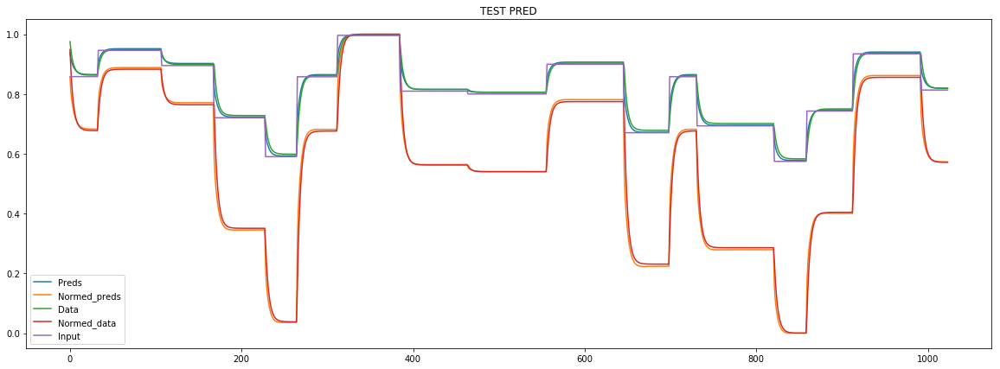

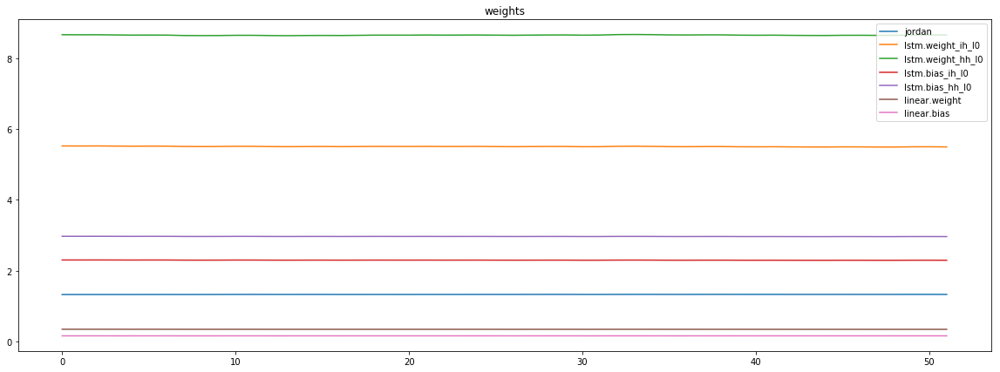

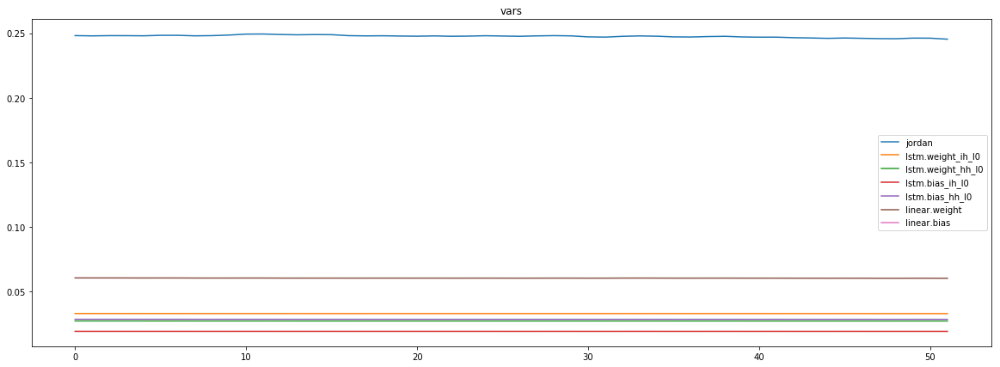

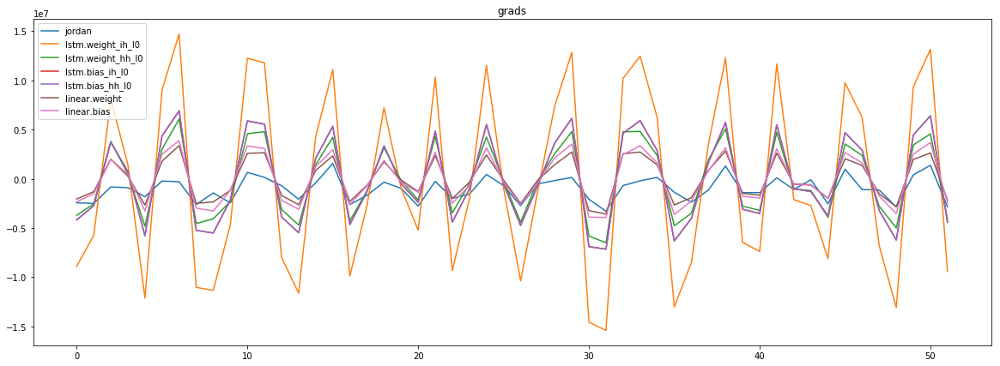

mean_p1 : -984185.3762019231
mean_p2 : -42920.728816105766


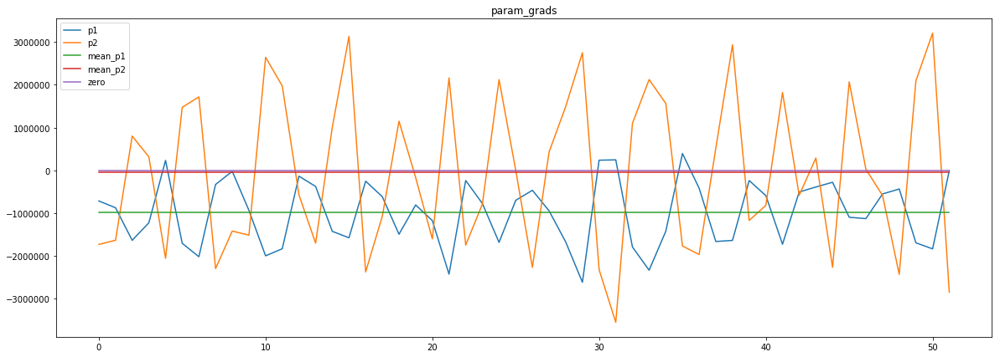

loss rate [0.049971507095561196]
Epoch [33] 
     train_loss[158631.70083383413] 
     eval_train[156856.2776066707] 
     eval_test[162282.6328125]



aux preds: 0.3171543776988983 1.0138792991638184
main loss 0.0
aux loss 48972.436222956734
jord loss 108141.68404447116
combined loss 157114.12026742788 



Parameter containing:
tensor([[0.3172, 1.0139]], requires_grad=True)


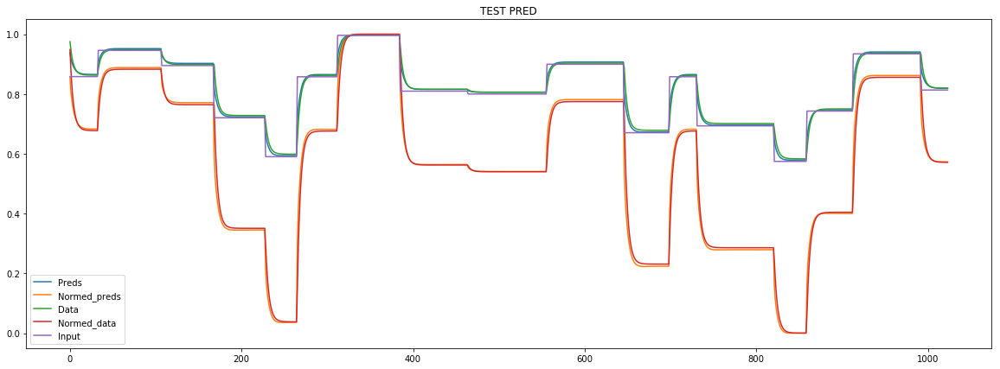

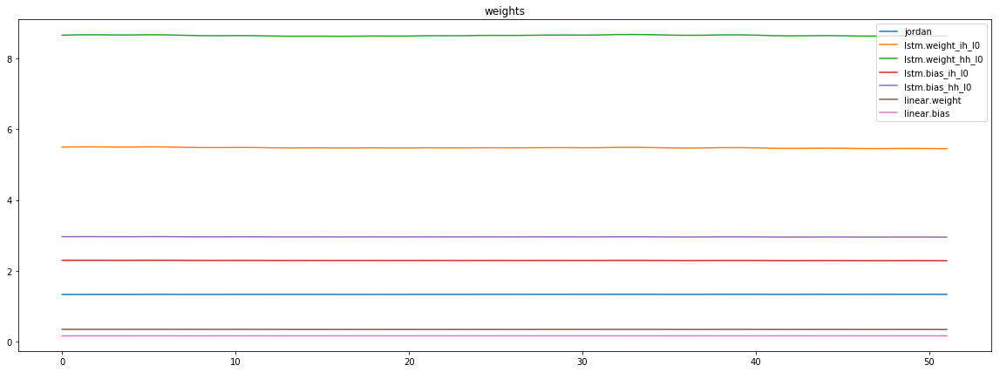

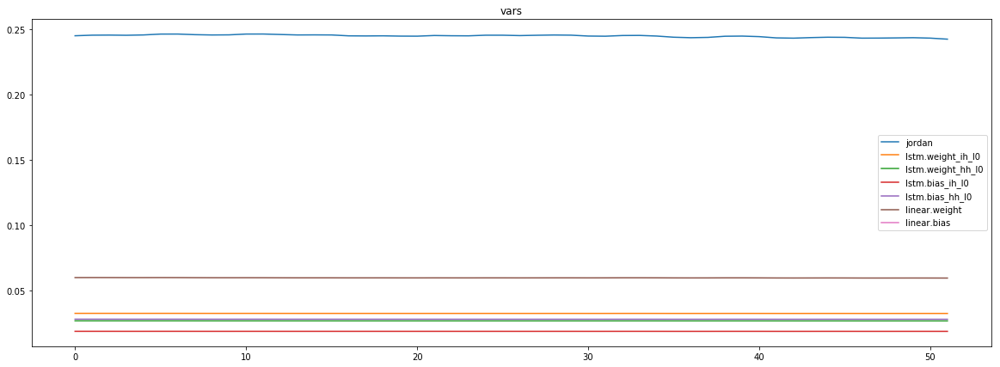

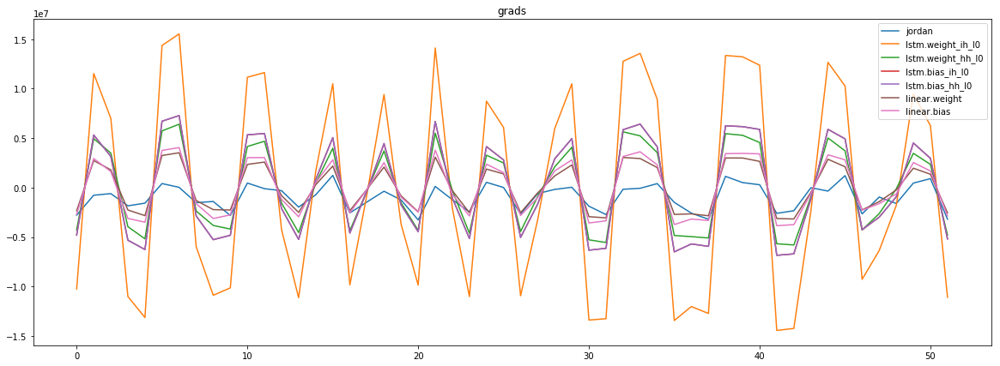

mean_p1 : -967551.5048076923
mean_p2 : -8050.4645432692305


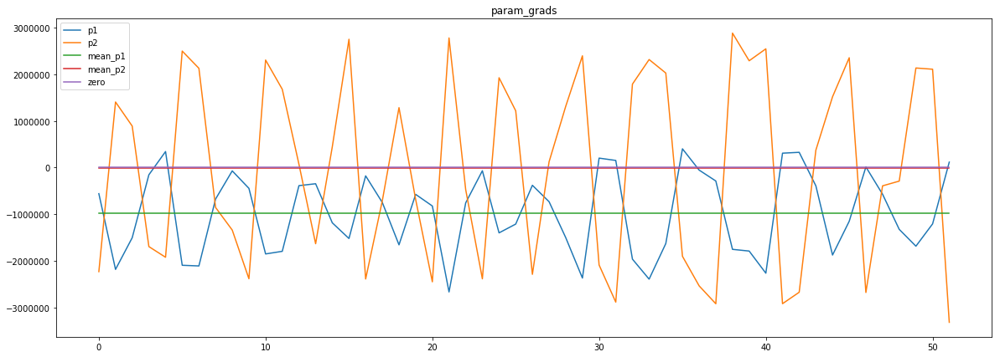

loss rate [0.04909299774690434]
Epoch [34] 
     train_loss[157114.12026742788] 
     eval_train[152095.6628230168] 
     eval_test[157342.60111860797]



aux preds: 0.32080891728401184 1.013979434967041
main loss 0.0
aux loss 46802.126652644234
jord loss 105085.28380408653
combined loss 151887.41045673075 



Parameter containing:
tensor([[0.3208, 1.0140]], requires_grad=True)


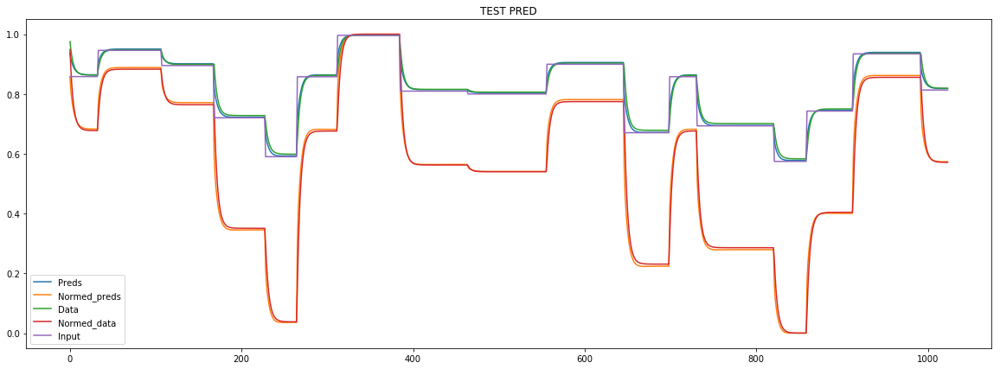

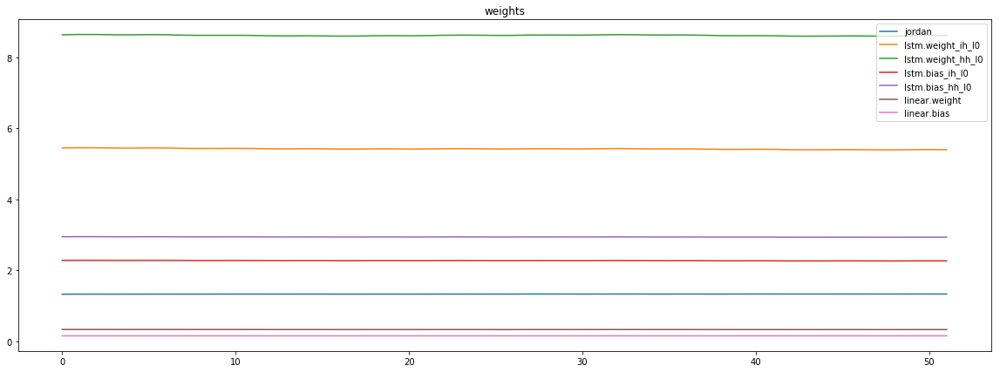

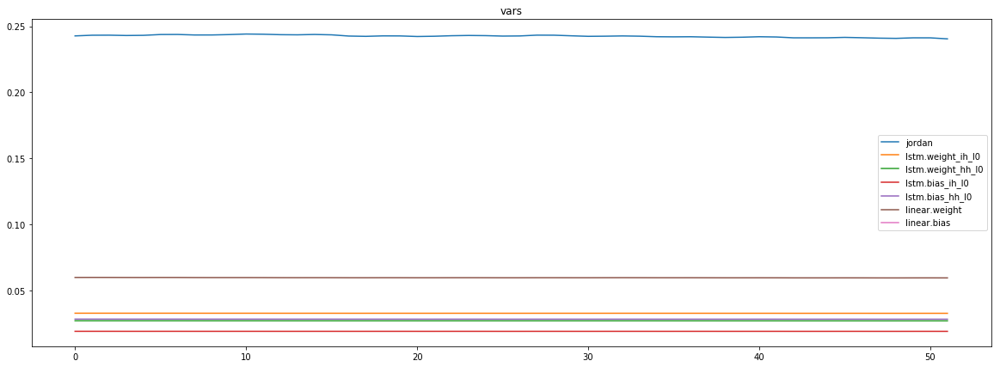

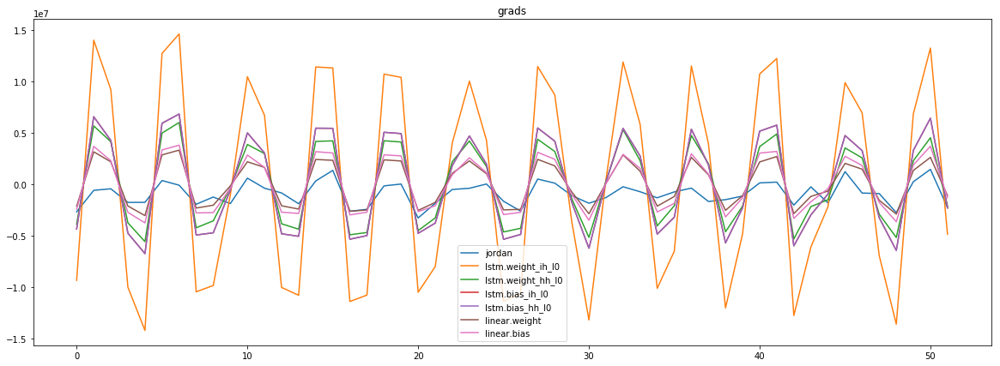

mean_p1 : -945597.9675480769
mean_p2 : 19877.061298076922


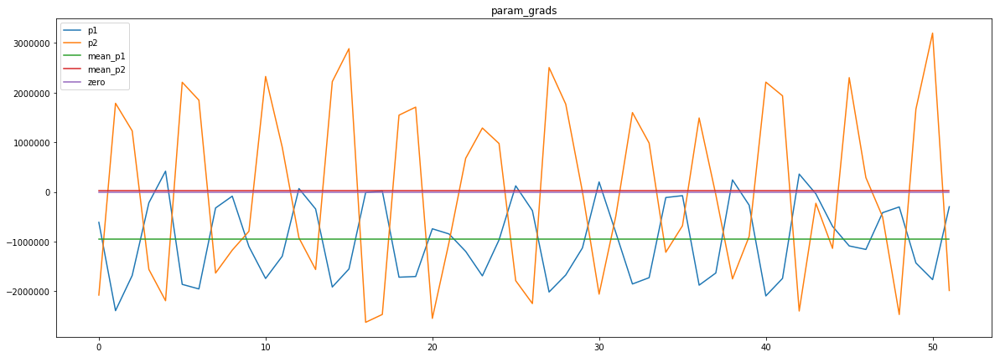

loss rate [0.028922346349322114]
Epoch [35] 
     train_loss[151887.41045673075] 
     eval_train[151660.47934194712] 
     eval_test[156786.9841086648]



aux preds: 0.3244955539703369 1.0129601955413818
main loss 0.0
aux loss 50405.52272385817
jord loss 102213.05942007211
combined loss 152618.58214393028 



Parameter containing:
tensor([[0.3245, 1.0130]], requires_grad=True)


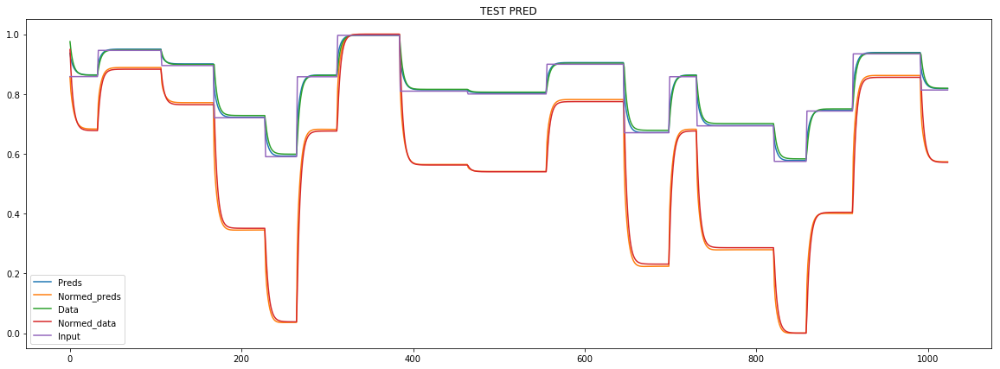

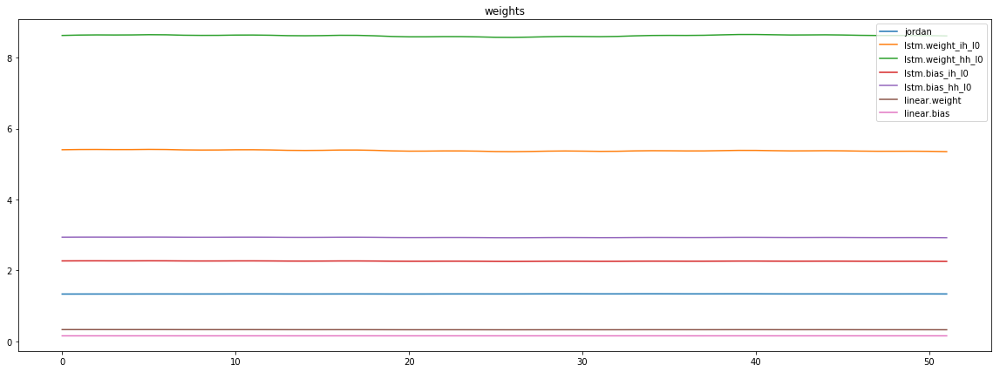

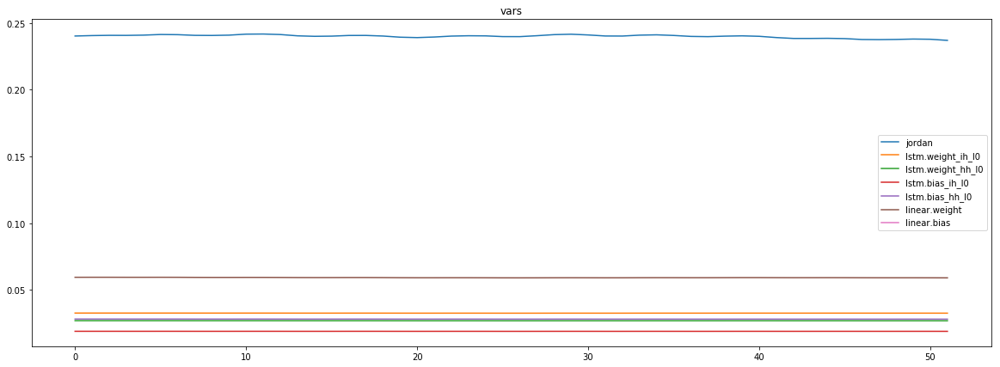

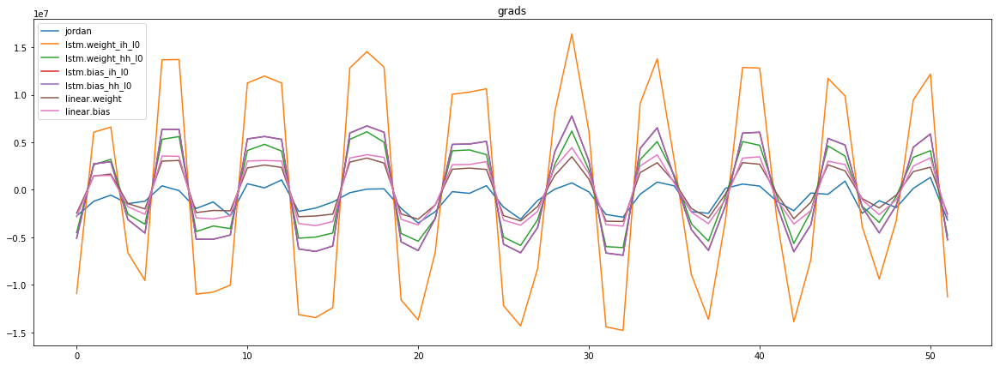

mean_p1 : -920010.1478365385
mean_p2 : -13216.603966346154


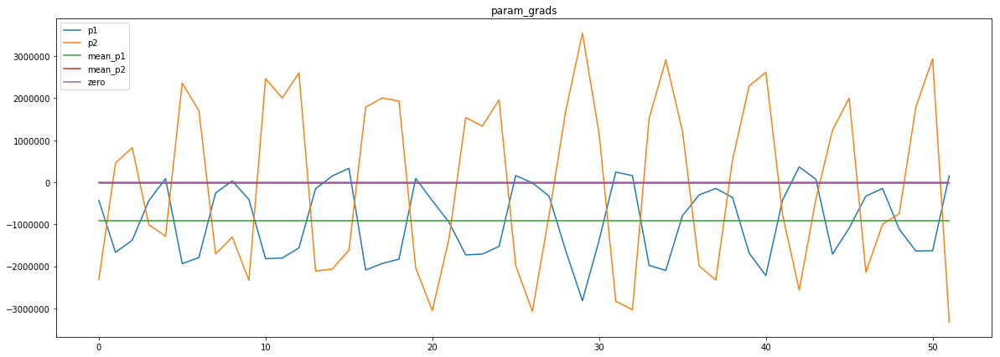

loss rate [0.010258345208749908]
Epoch [36] 
     train_loss[152618.58214393028] 
     eval_train[152145.81422776444] 
     eval_test[157175.00568181818]



aux preds: 0.3281029164791107 1.0139437913894653
main loss 0.0
aux loss 44838.5595703125
jord loss 99302.49609375
combined loss 144141.0556640625 



Parameter containing:
tensor([[0.3281, 1.0139]], requires_grad=True)


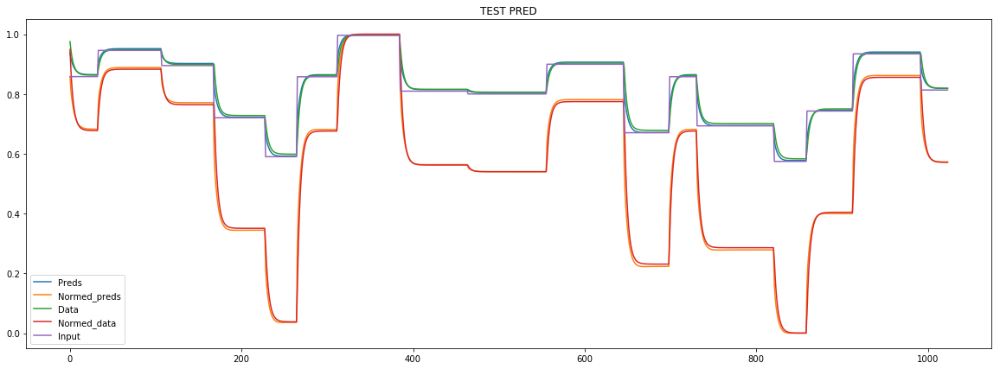

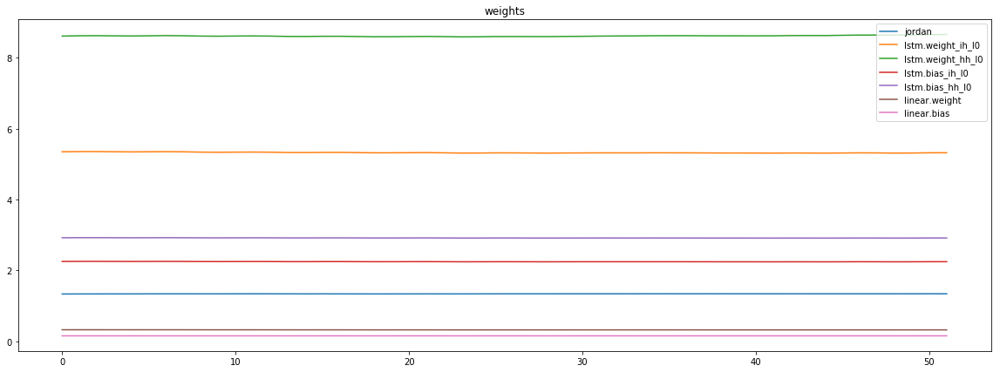

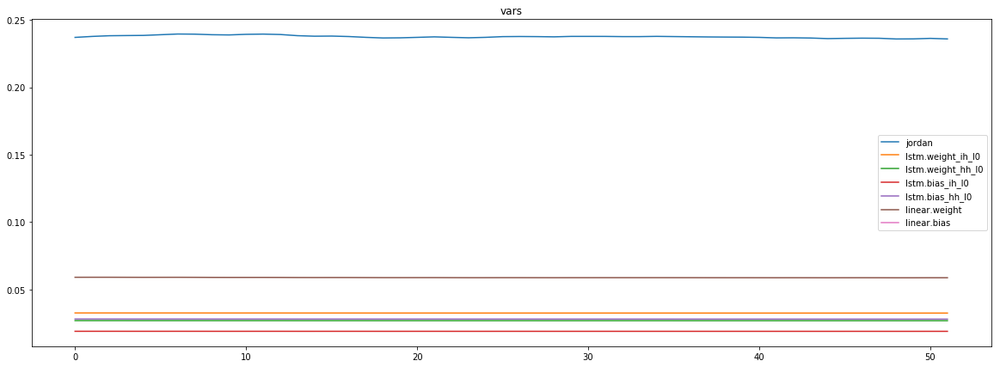

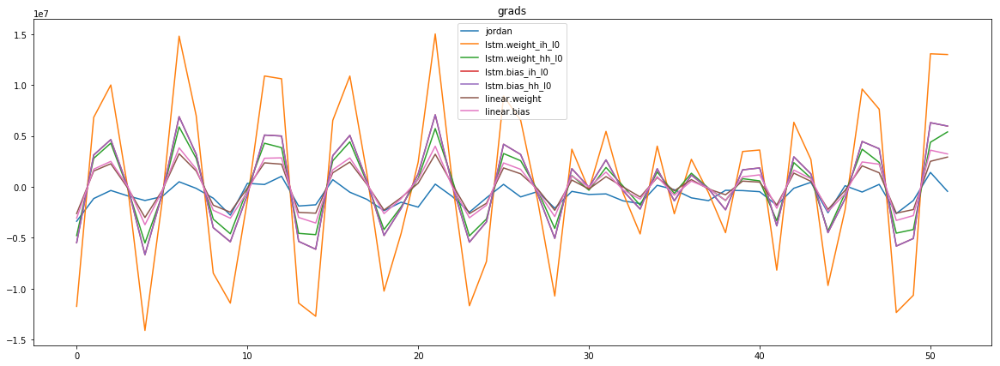

mean_p1 : -887464.7361778846
mean_p2 : 44253.228440504805


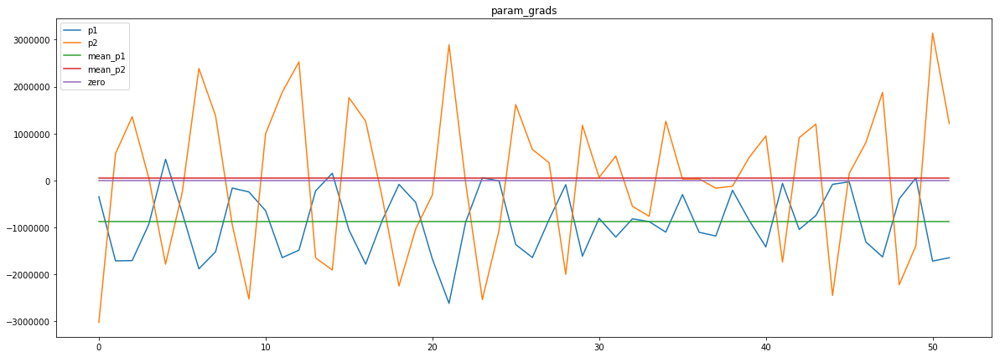

loss rate [0.05287606098451969]
Epoch [37] 
     train_loss[144141.0556640625] 
     eval_train[143990.93787560094] 
     eval_test[148794.6202059659]



aux preds: 0.33169224858283997 1.0144917964935303
main loss 0.0
aux loss 43835.974609375
jord loss 96535.06790865384
combined loss 140371.04251802884 



Parameter containing:
tensor([[0.3317, 1.0145]], requires_grad=True)


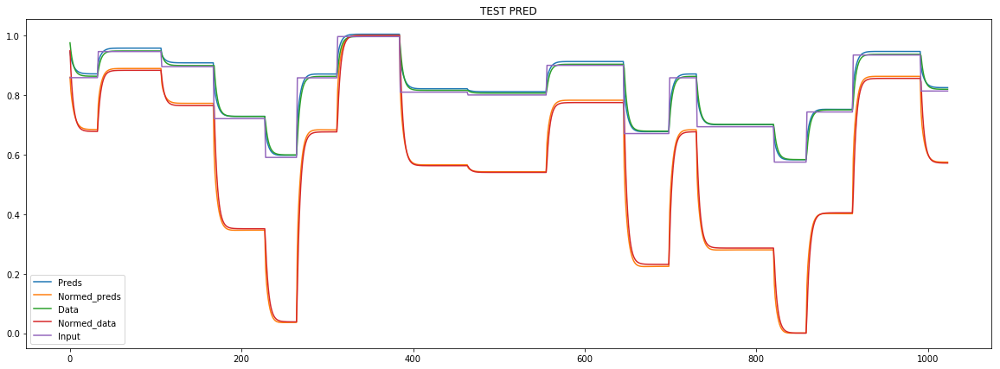

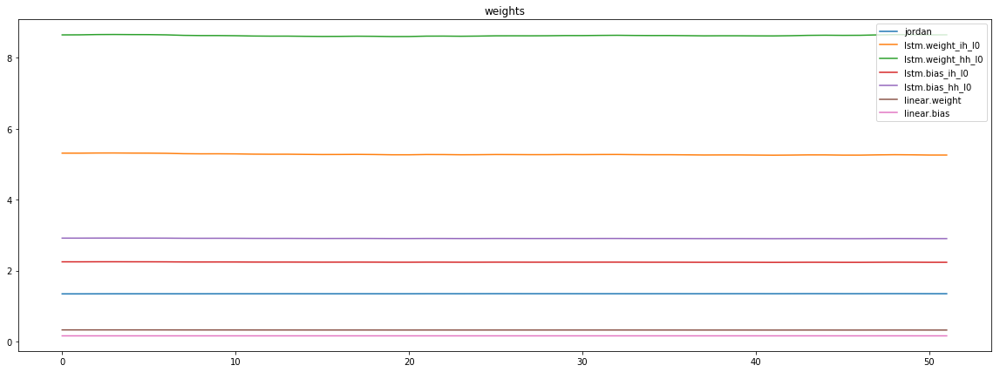

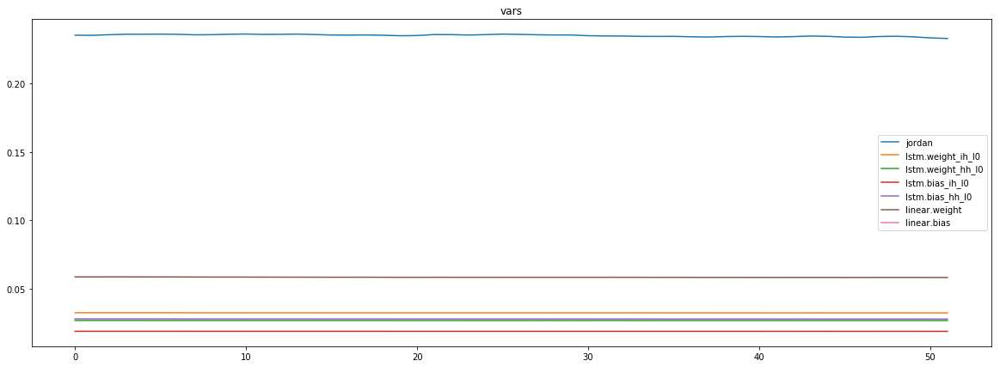

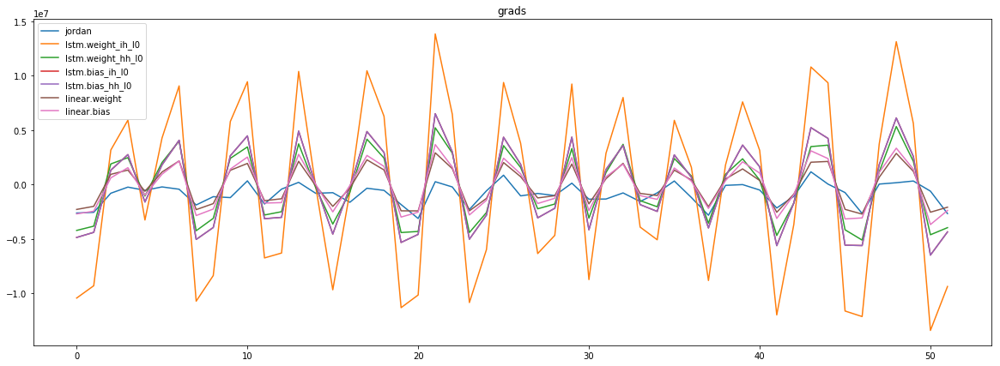

mean_p1 : -807920.4002403846
mean_p2 : -71360.11313100961


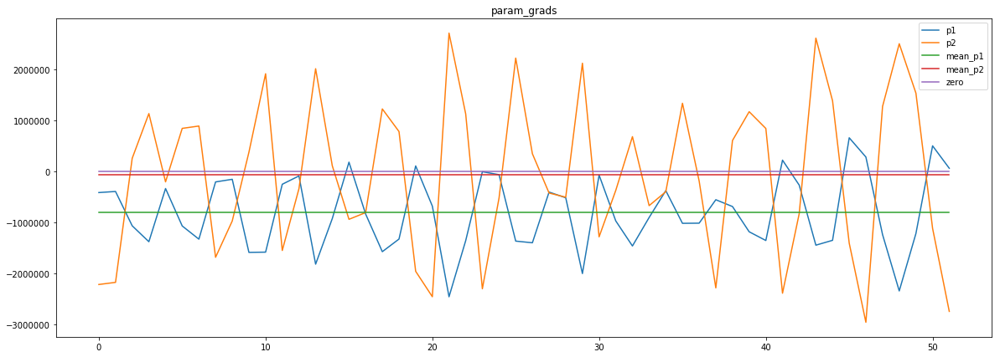

loss rate [0.05592387008025712]
Epoch [38] 
     train_loss[140371.04251802884] 
     eval_train[141935.72348257212] 
     eval_test[145625.8231534091]



aux preds: 0.33533477783203125 1.01398503780365
main loss 0.0
aux loss 44073.461125300484
jord loss 93823.57406850961
combined loss 137897.0351938101 



Parameter containing:
tensor([[0.3353, 1.0140]], requires_grad=True)


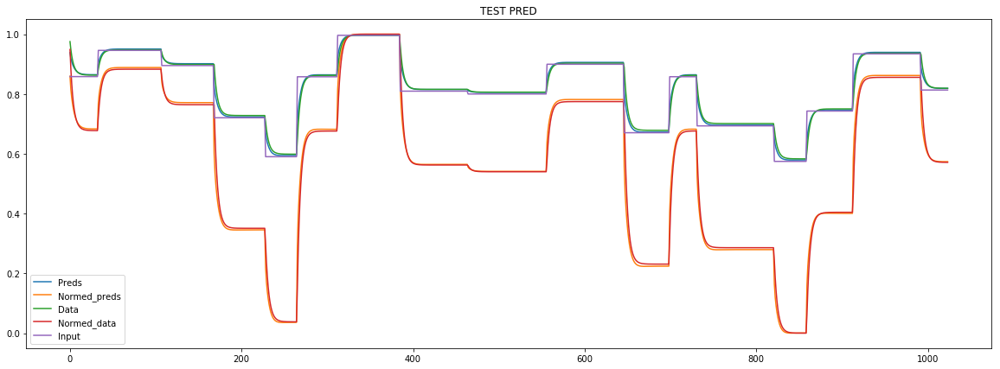

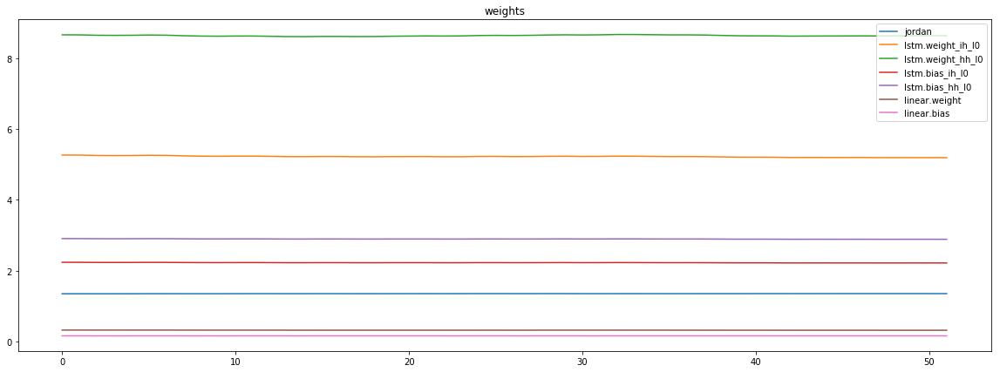

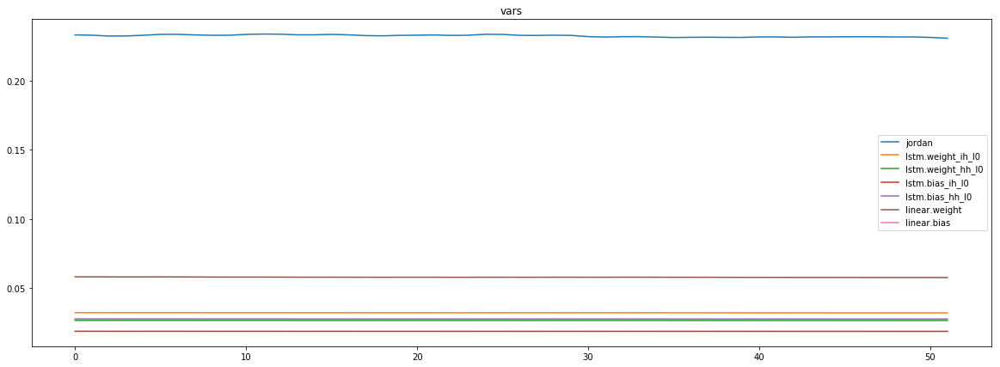

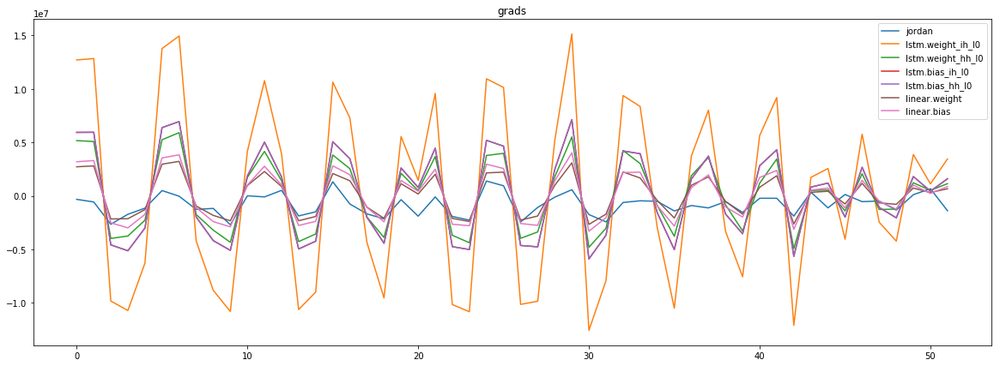

mean_p1 : -851039.5120192308
mean_p2 : 52045.469651442305


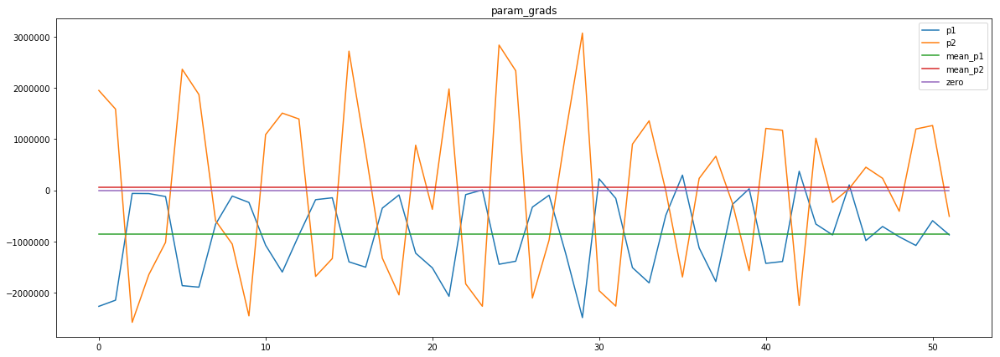

loss rate [0.06318861125849207]
Epoch [39] 
     train_loss[137897.0351938101] 
     eval_train[136373.56512920672] 
     eval_test[141019.919921875]



aux preds: 0.33904606103897095 1.0123873949050903
main loss 0.0
aux loss 48451.07008713942
jord loss 91156.66466346153
combined loss 139607.73475060094 



Parameter containing:
tensor([[0.3390, 1.0124]], requires_grad=True)


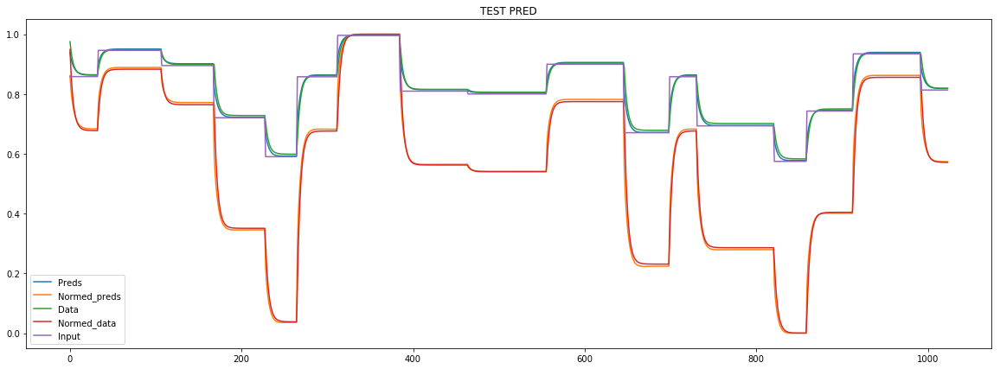

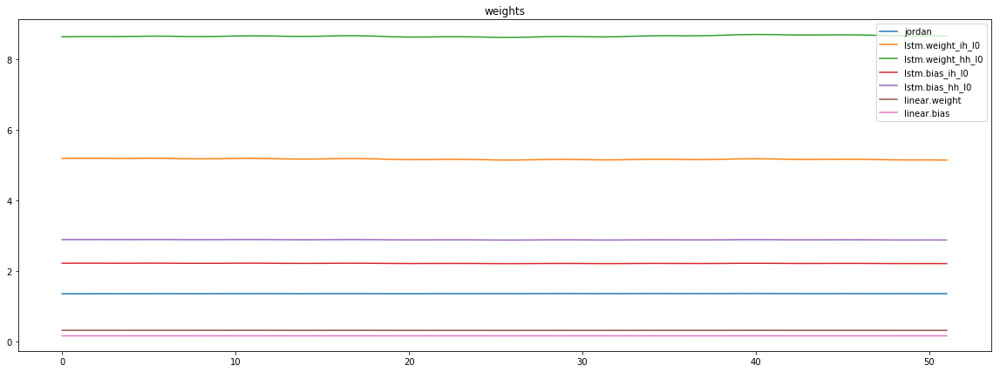

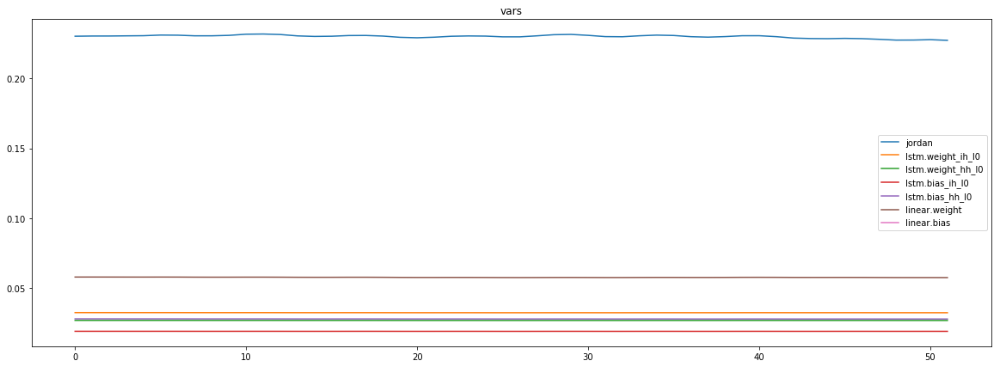

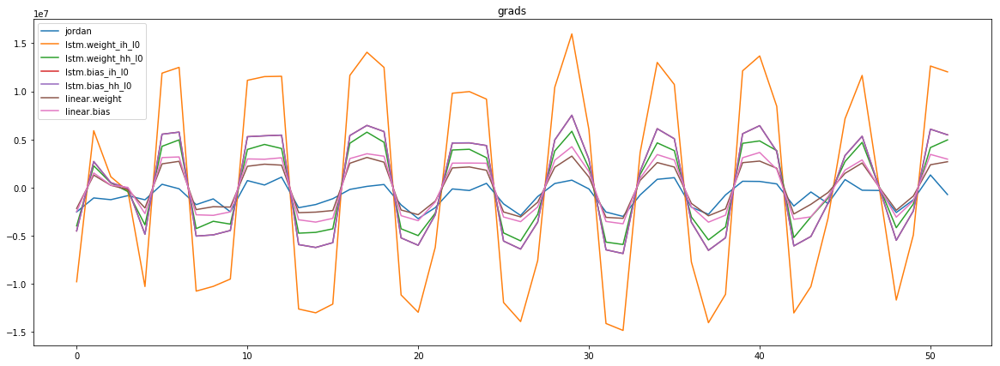

mean_p1 : -842098.0691105769
mean_p2 : 22863.741661658652


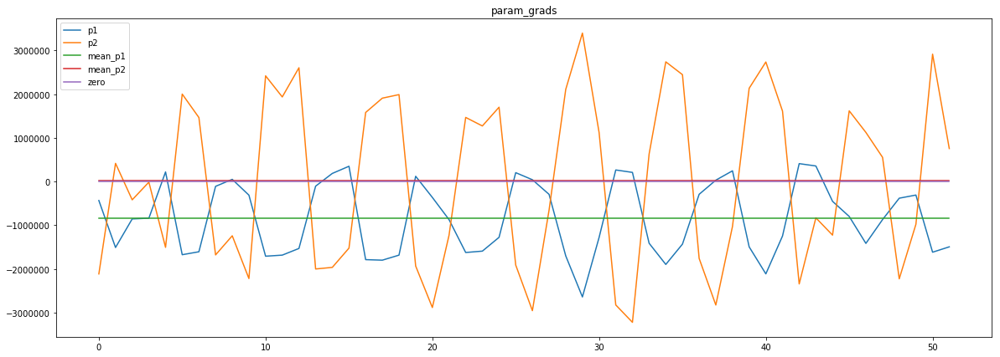

loss rate [0.00807019001107323]
Epoch [40] 
     train_loss[139607.73475060094] 
     eval_train[139391.95586688703] 
     eval_test[143975.42560369318]



aux preds: 0.3426695764064789 1.0132708549499512
main loss 0.0
aux loss 41910.70224233774
jord loss 88589.15301983173
combined loss 130499.85526216947 



Parameter containing:
tensor([[0.3427, 1.0133]], requires_grad=True)


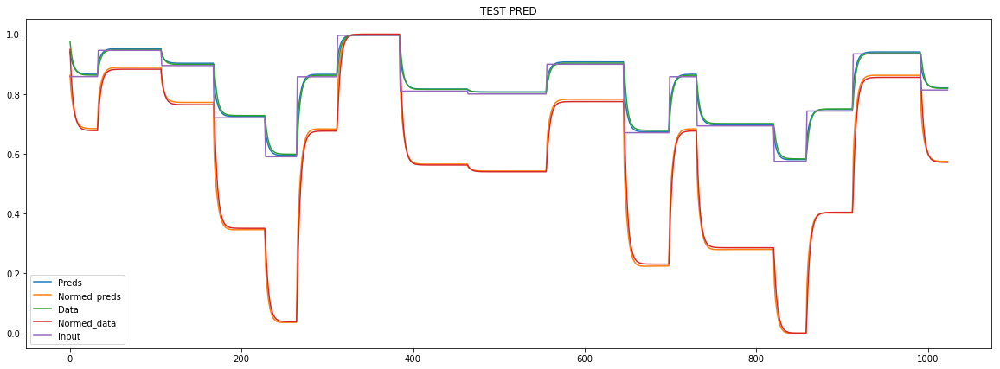

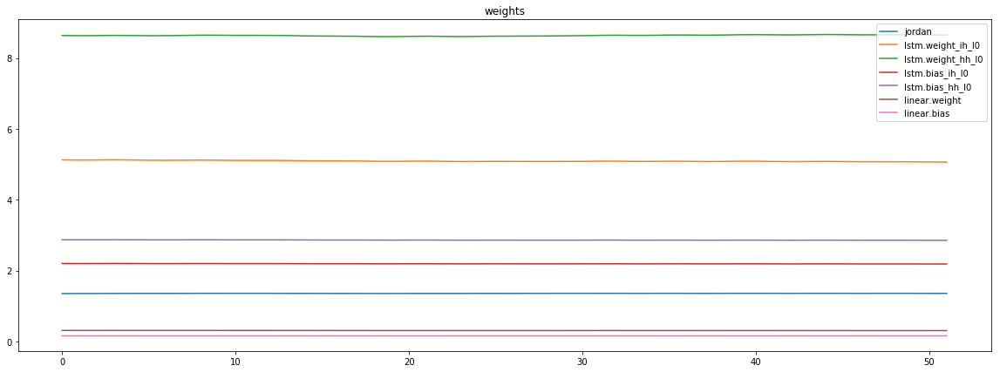

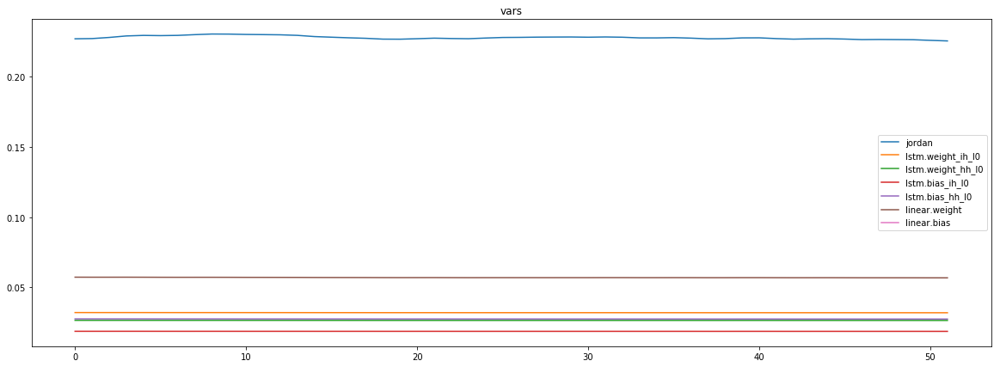

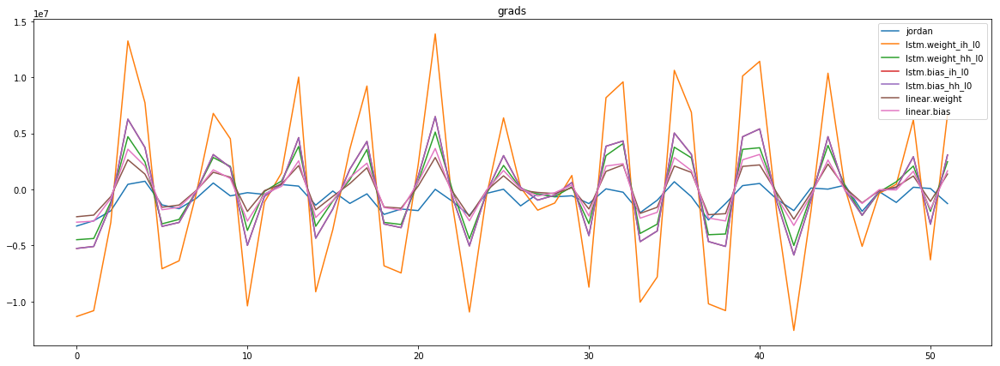

mean_p1 : -759286.4026442308
mean_p2 : -26158.21882512019


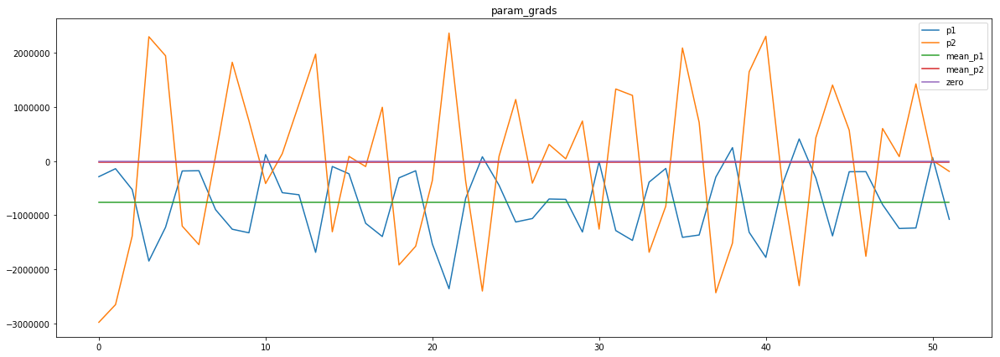

loss rate [0.07480552726022038]
Epoch [41] 
     train_loss[130499.85526216947] 
     eval_train[128314.82880108173] 
     eval_test[132802.77503551135]



aux preds: 0.346301794052124 1.0133658647537231
main loss 0.0
aux loss 41420.134465144234
jord loss 85963.02268629808
combined loss 127383.15715144231 



Parameter containing:
tensor([[0.3463, 1.0134]], requires_grad=True)


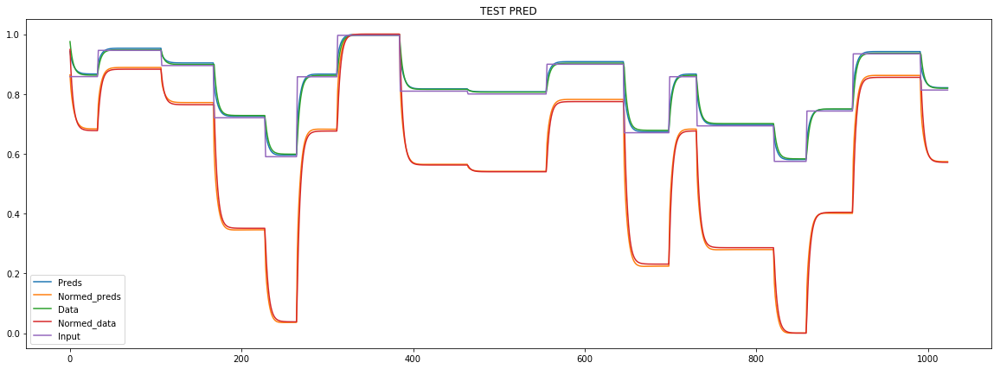

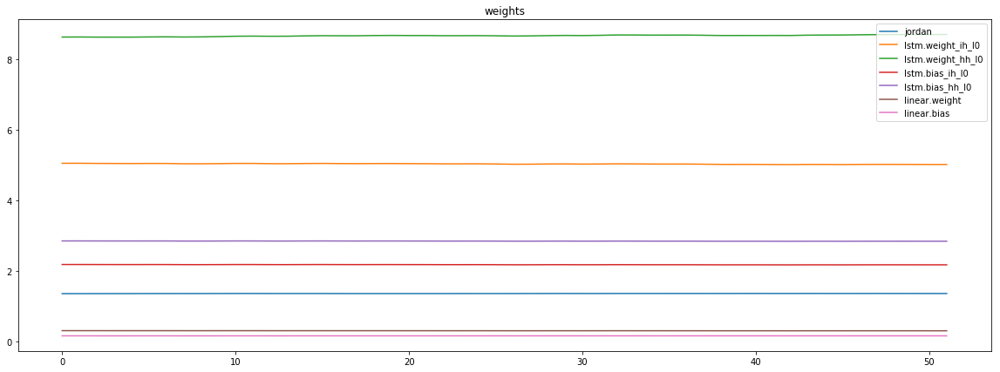

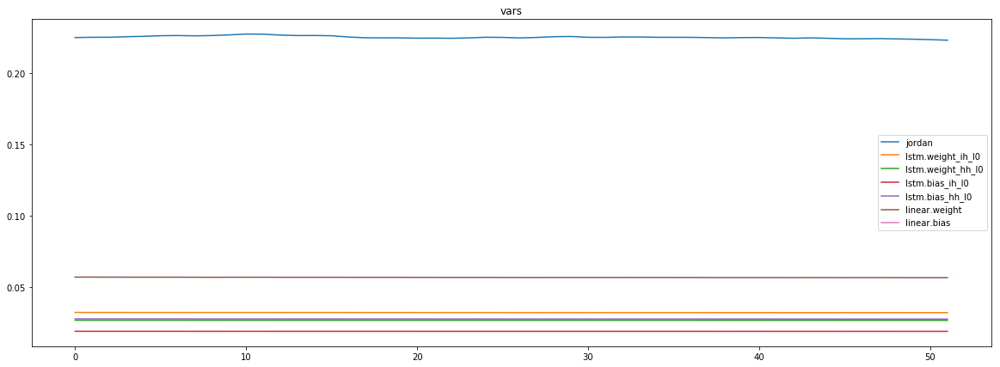

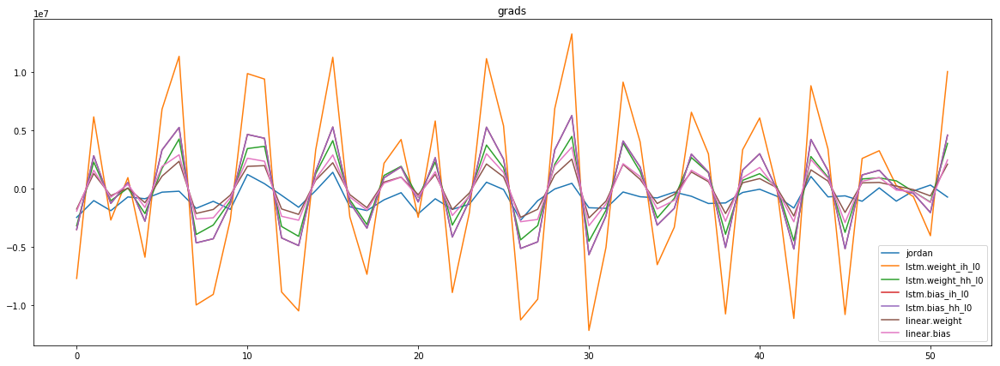

mean_p1 : -759754.6081730769
mean_p2 : 11388.740459735576


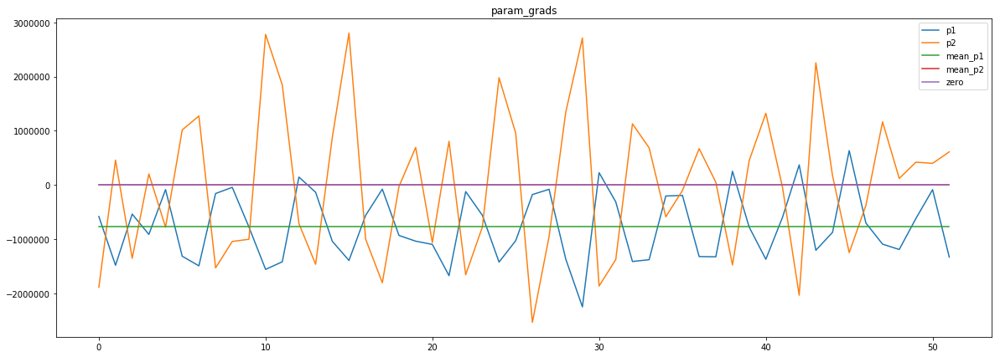

loss rate [0.07775064962108169]
Epoch [42] 
     train_loss[127383.15715144231] 
     eval_train[124186.89453125] 
     eval_test[128438.01509232954]



aux preds: 0.3499380052089691 1.0134764909744263
main loss 0.0
aux loss 42410.57301682692
jord loss 83433.25172776442
combined loss 125843.82474459134 



Parameter containing:
tensor([[0.3499, 1.0135]], requires_grad=True)


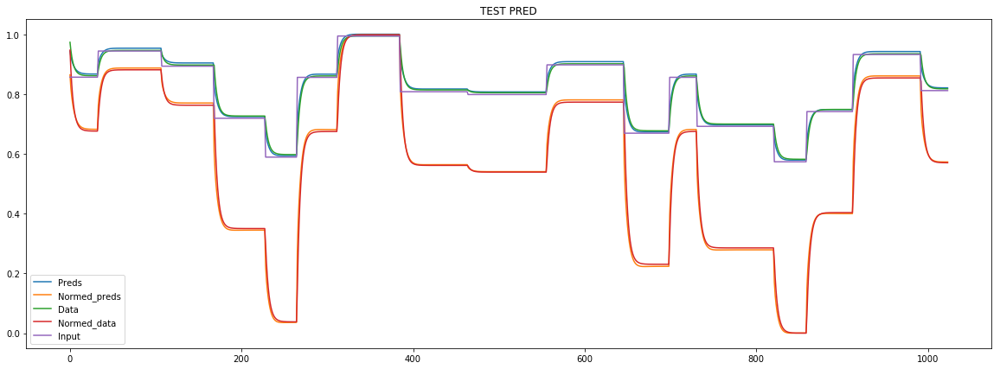

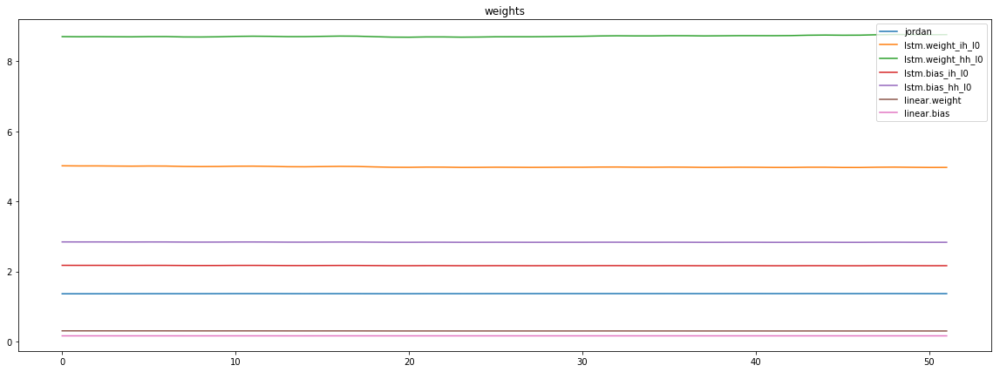

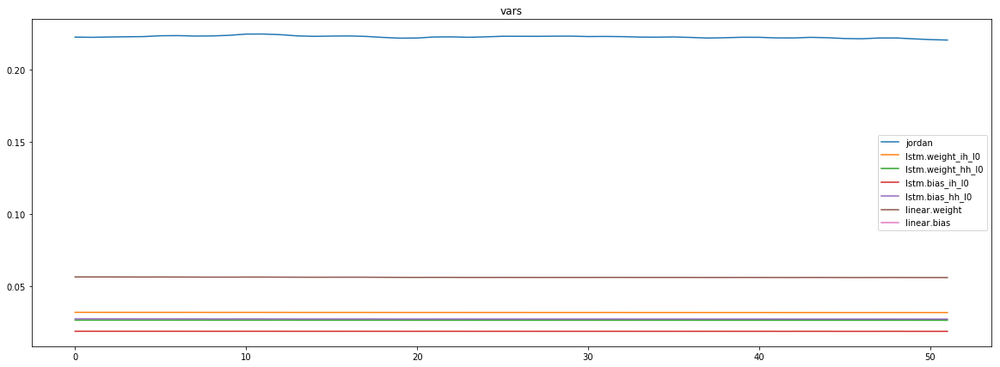

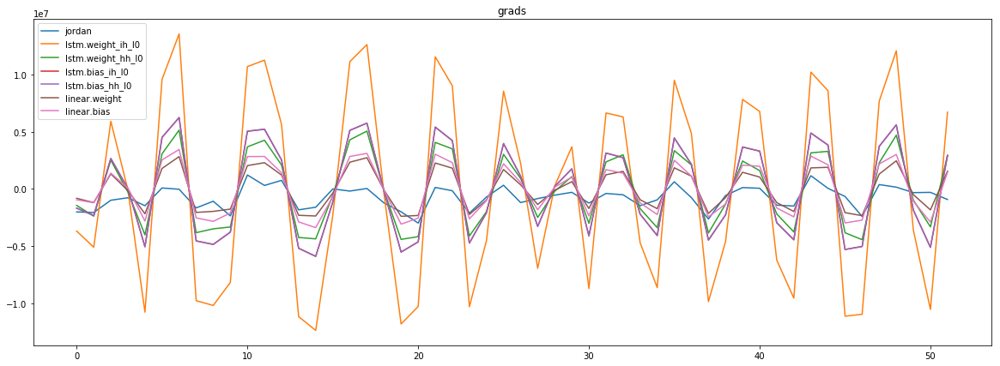

mean_p1 : -730781.2415865385
mean_p2 : -15104.199819711539


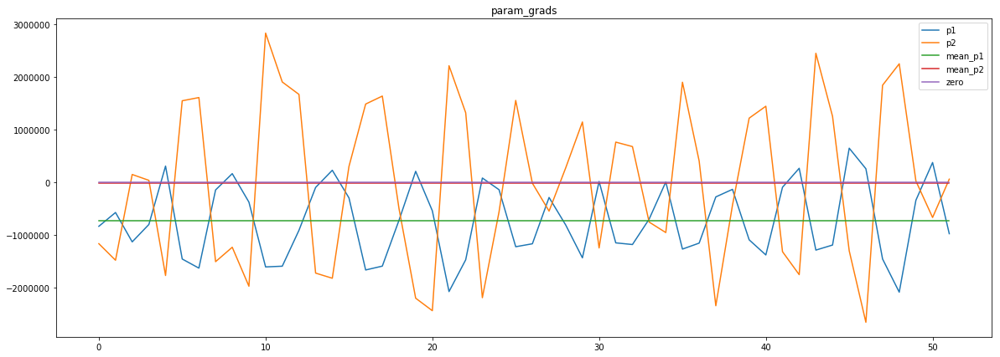

loss rate [0.07390119731021272]
Epoch [43] 
     train_loss[125843.82474459134] 
     eval_train[121389.57767427884] 
     eval_test[125090.08407315341]



aux preds: 0.3535770773887634 1.0136431455612183
main loss 0.0
aux loss 40420.12094350962
jord loss 80981.82767427884
combined loss 121401.94861778847 



Parameter containing:
tensor([[0.3536, 1.0136]], requires_grad=True)


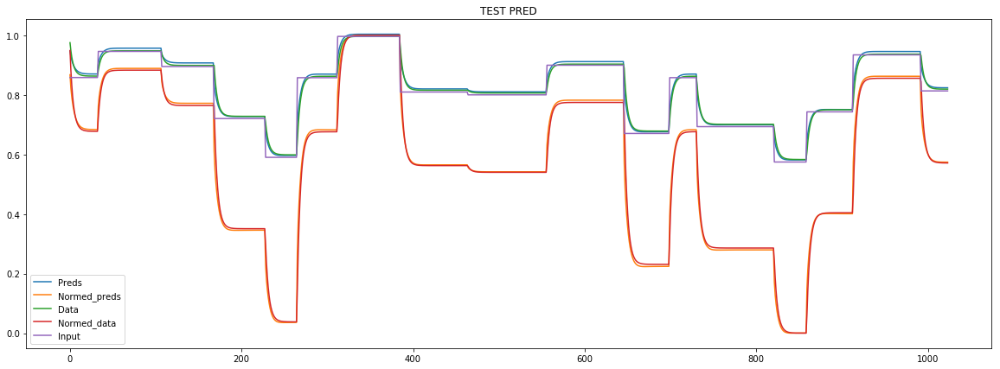

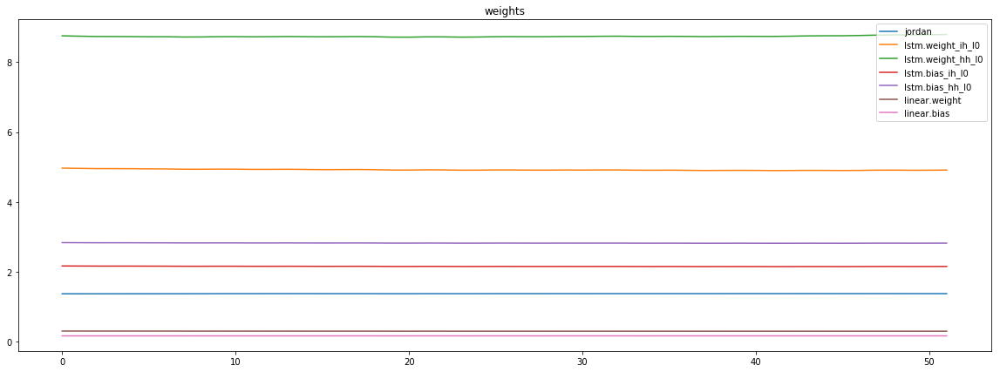

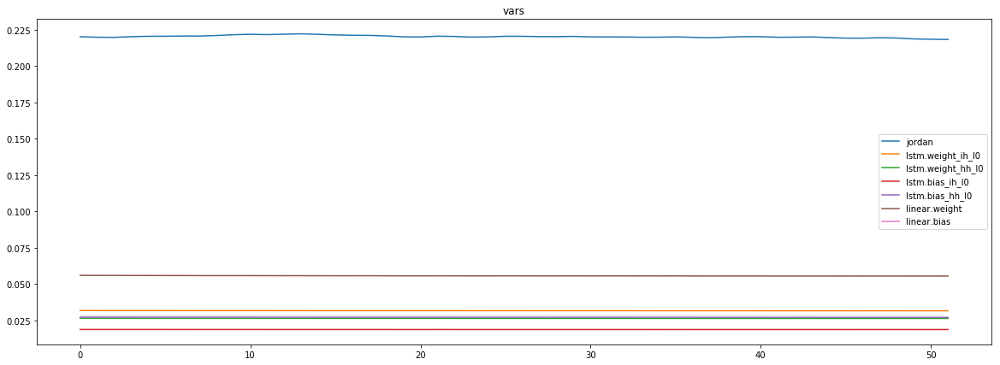

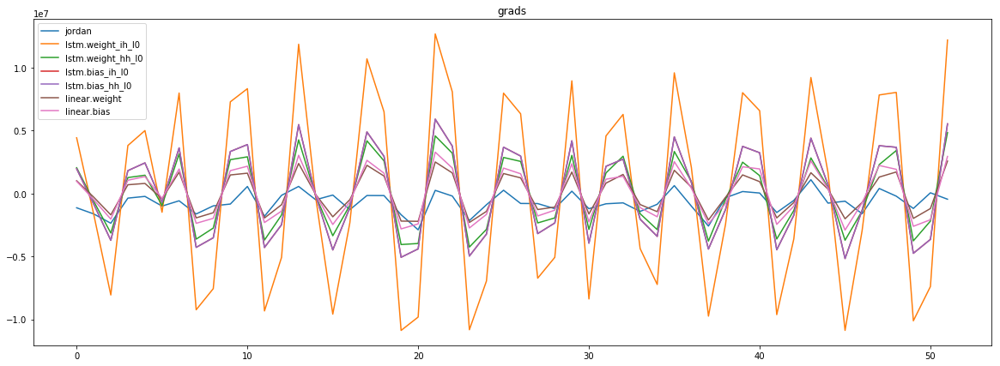

mean_p1 : -723022.0348557692
mean_p2 : 6225.438251201923


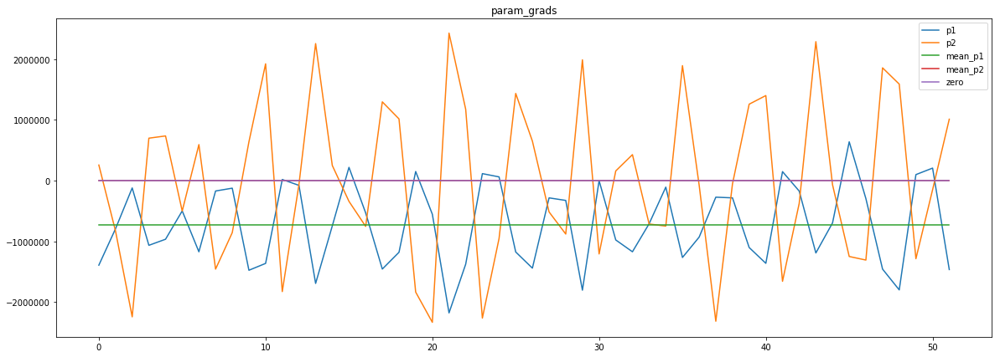

loss rate [0.04400060930074712]
Epoch [44] 
     train_loss[121401.94861778847] 
     eval_train[119781.28789813702] 
     eval_test[123110.69344815341]



aux preds: 0.35726457834243774 1.013148546218872
main loss 0.0
aux loss 40345.54420823317
jord loss 78575.32113882211
combined loss 118920.86534705528 



Parameter containing:
tensor([[0.3573, 1.0131]], requires_grad=True)


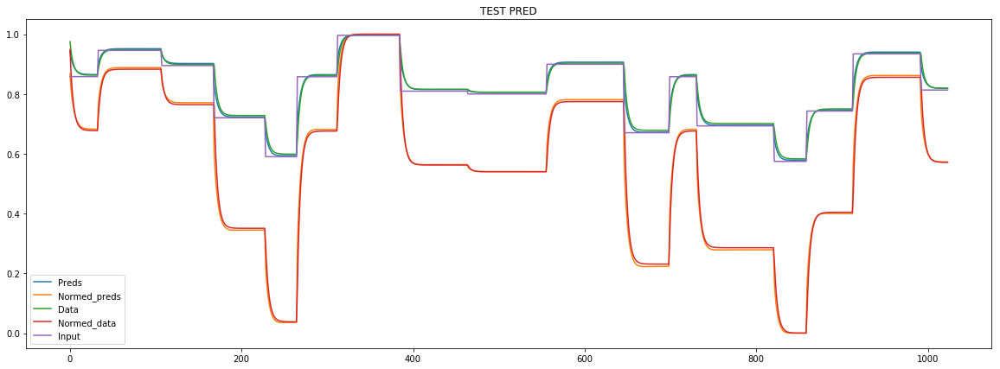

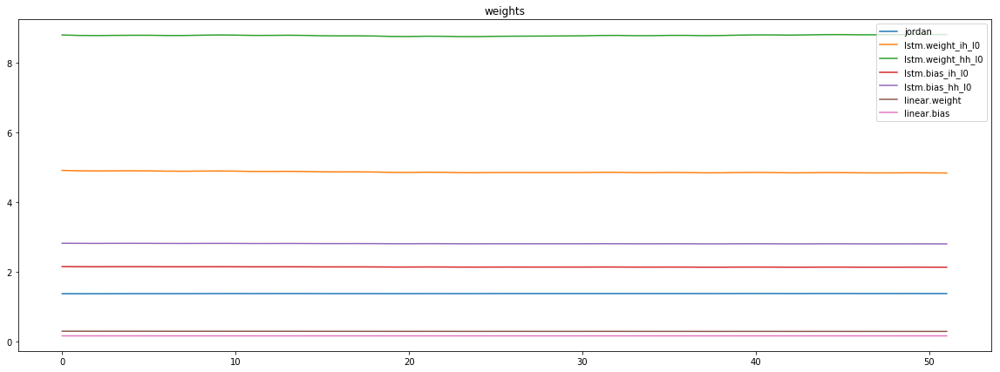

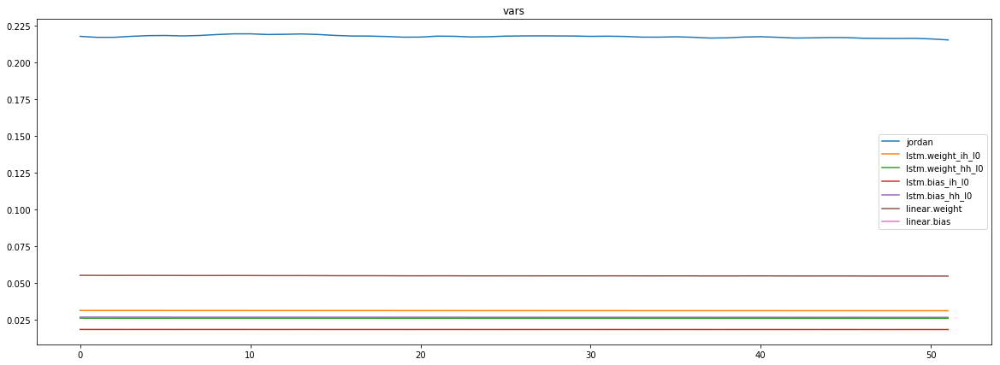

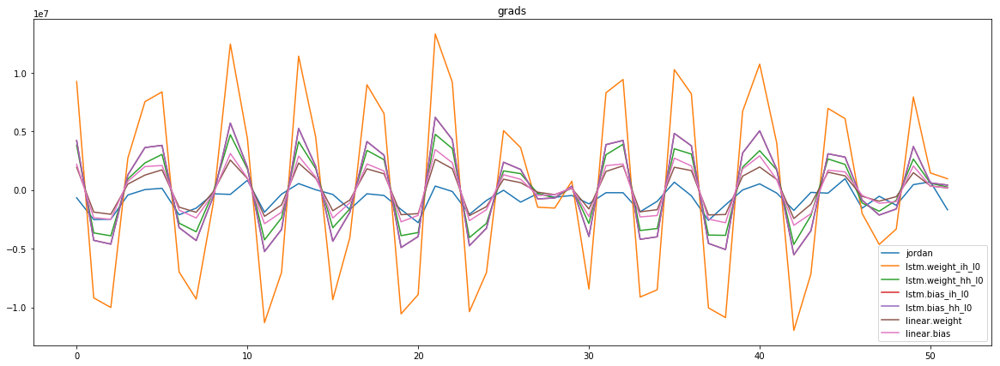

mean_p1 : -706708.1135817308
mean_p2 : -4135.308143028846


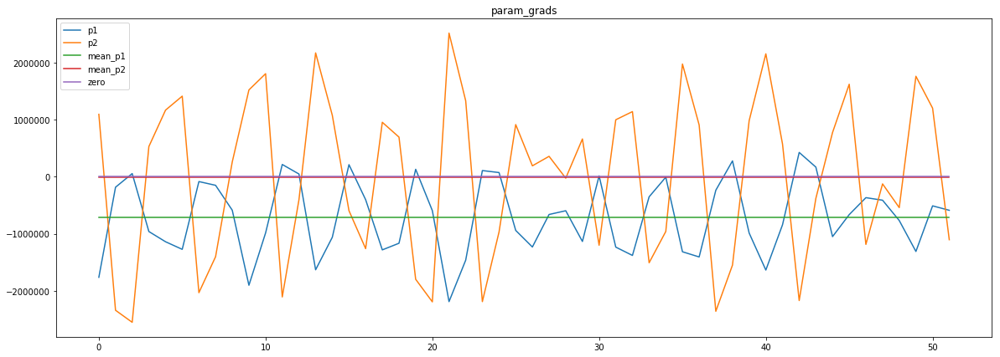

loss rate [0.016425784924902653]
Epoch [45] 
     train_loss[118920.86534705528] 
     eval_train[119502.8017202524] 
     eval_test[123484.06827059659]



aux preds: 0.3610427677631378 1.011969804763794
main loss 0.0
aux loss 44501.169245793266
jord loss 76196.18723707933
combined loss 120697.3564828726 



Parameter containing:
tensor([[0.3610, 1.0120]], requires_grad=True)


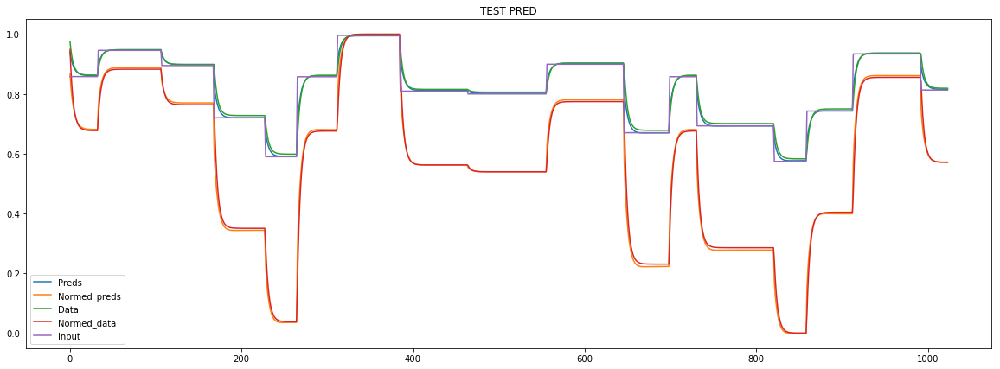

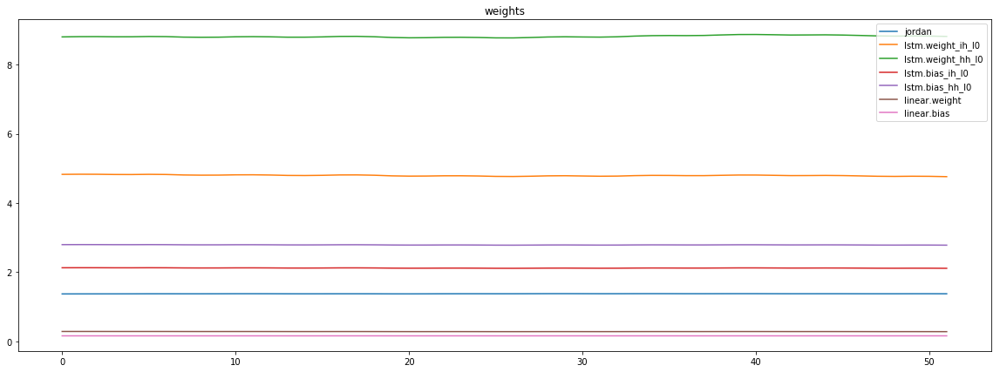

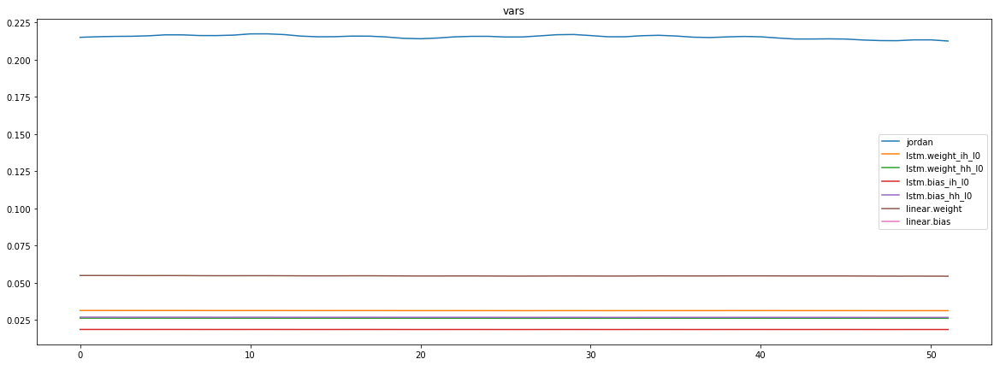

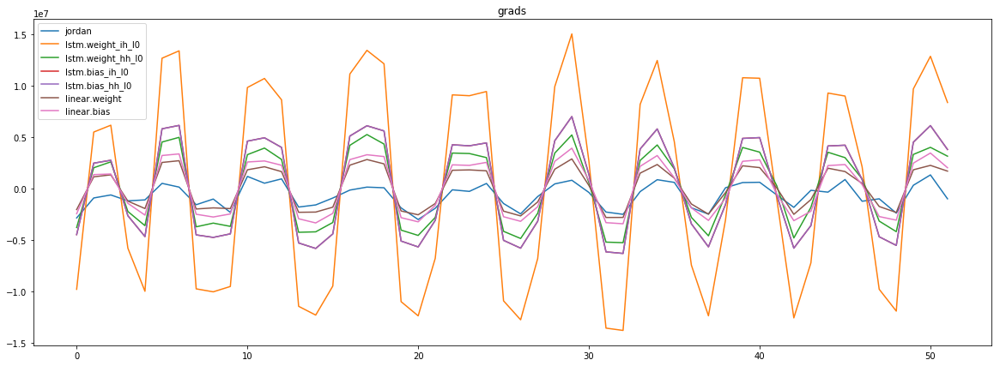

mean_p1 : -725009.0198317308
mean_p2 : 32142.189603365383


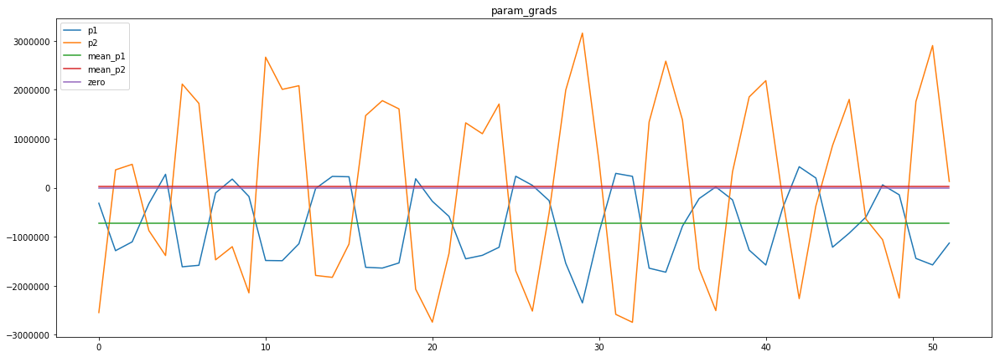

loss rate [-0.06661870163225037]
Epoch [46] 
     train_loss[120697.3564828726] 
     eval_train[128182.67104867788] 
     eval_test[132148.66921164774]



aux preds: 0.36478301882743835 1.013997197151184
main loss 0.0
aux loss 40912.886192908656
jord loss 73964.43415715144
combined loss 114877.3203500601 



Parameter containing:
tensor([[0.3648, 1.0140]], requires_grad=True)


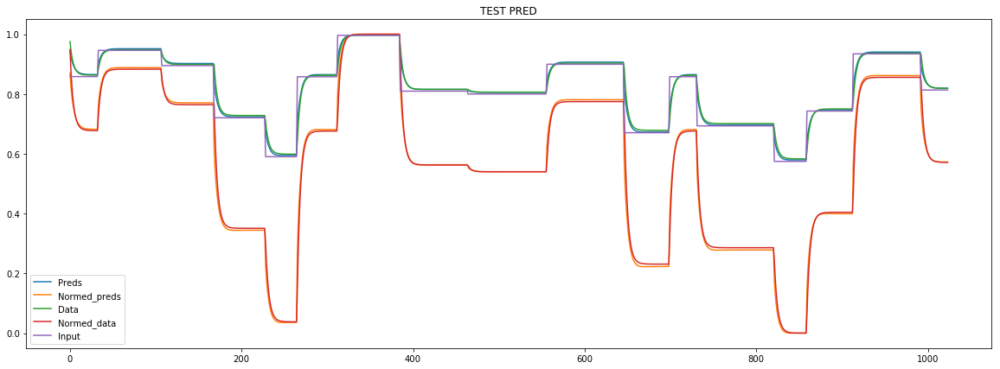

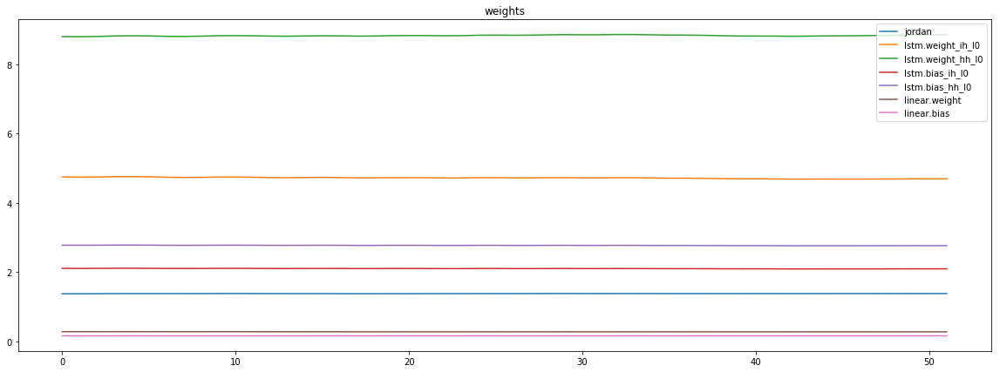

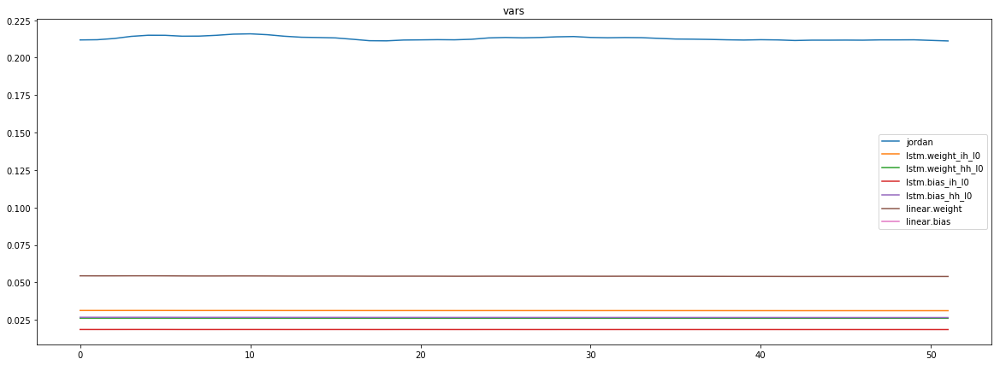

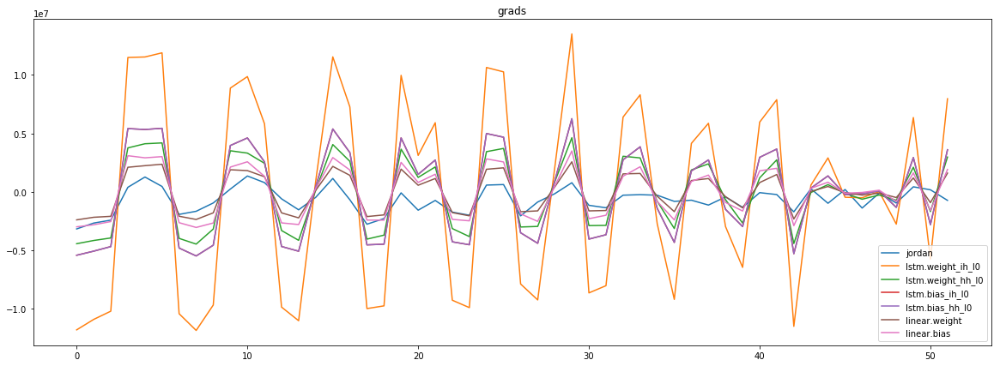

mean_p1 : -657427.515625
mean_p2 : -29345.371544471152


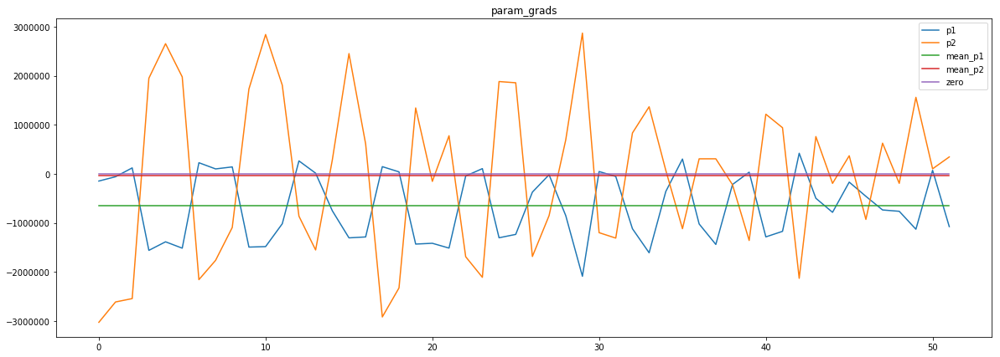

loss rate [0.08665389403039547]
Epoch [47] 
     train_loss[114877.3203500601] 
     eval_train[111562.98768028847] 
     eval_test[115307.94593394887]



aux preds: 0.3684910833835602 1.0136183500289917
main loss 0.0
aux loss 38687.18586613582
jord loss 71406.15865384616
combined loss 110093.34451998197 



Parameter containing:
tensor([[0.3685, 1.0136]], requires_grad=True)


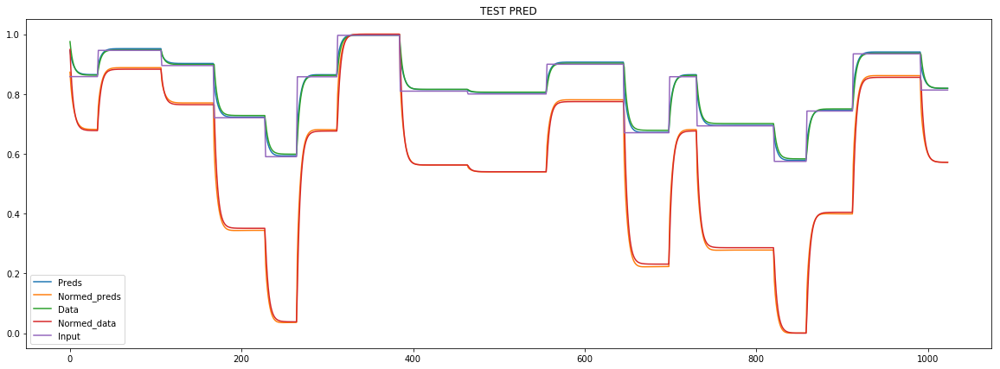

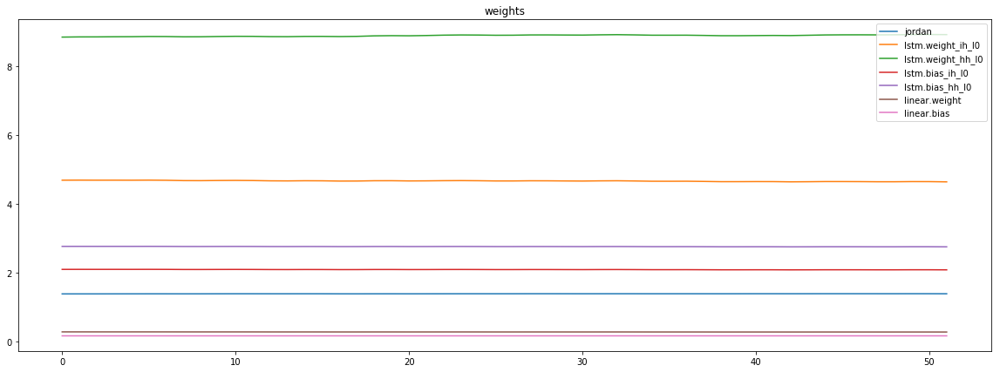

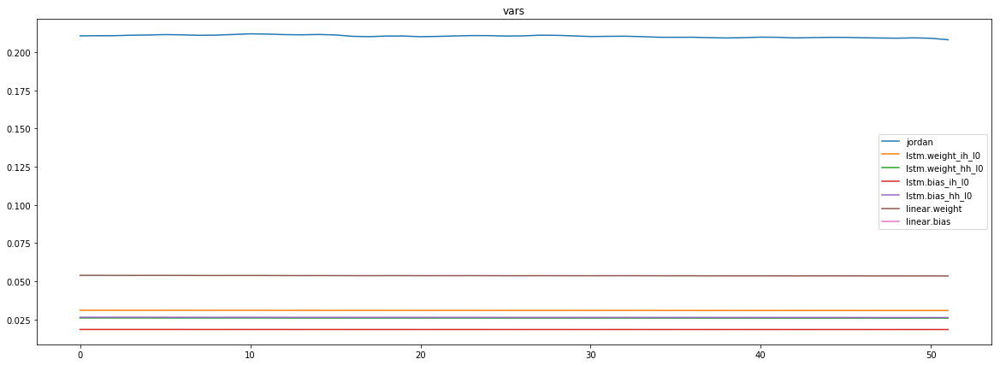

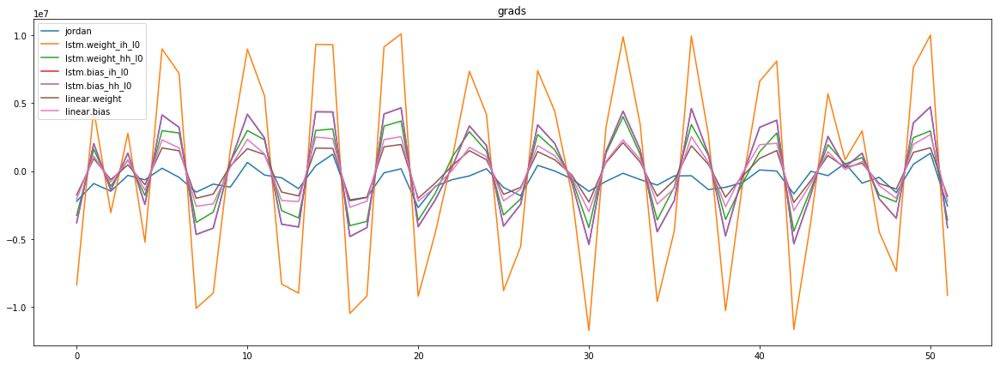

mean_p1 : -646378.4233774039
mean_p2 : -19407.75105168269


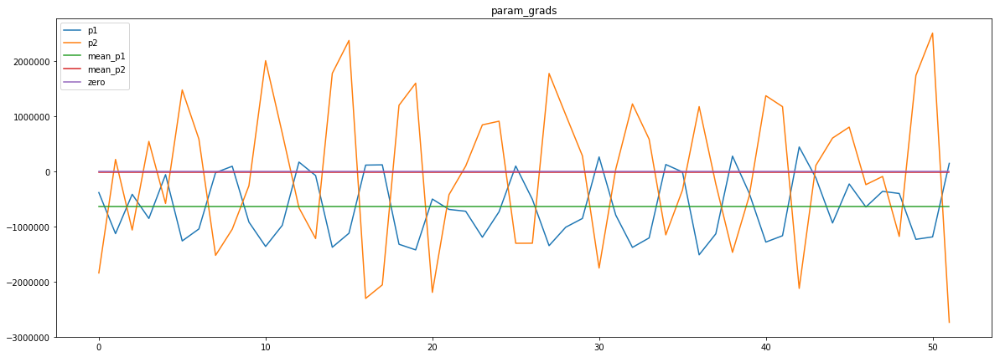

loss rate [0.07746235552645497]
Epoch [48] 
     train_loss[110093.34451998197] 
     eval_train[110439.17615685097] 
     eval_test[114068.91477272728]



aux preds: 0.3722180724143982 1.0139168500900269
main loss 0.0
aux loss 39266.19764122596
jord loss 69135.98606520433
combined loss 108402.18370643028 



Parameter containing:
tensor([[0.3722, 1.0139]], requires_grad=True)


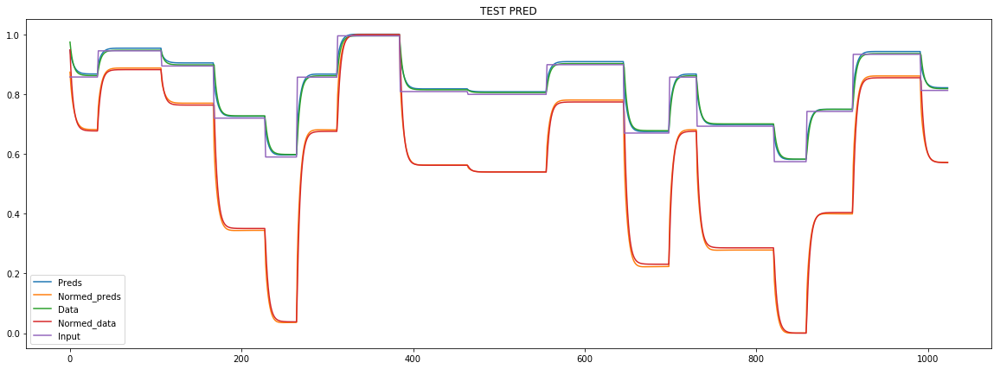

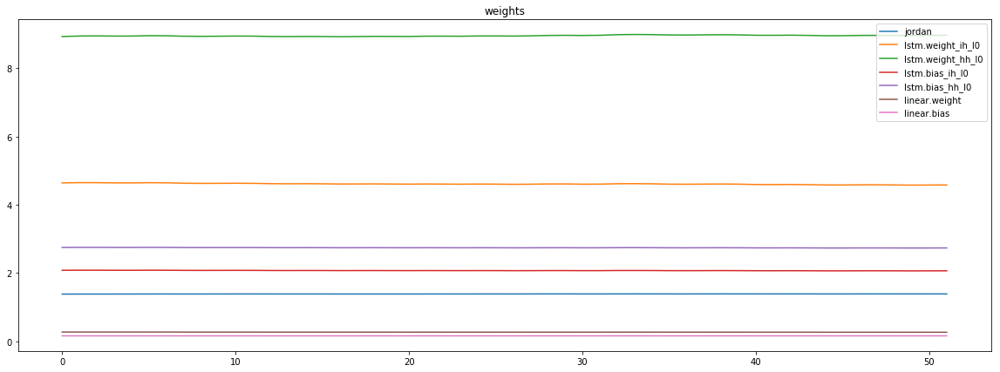

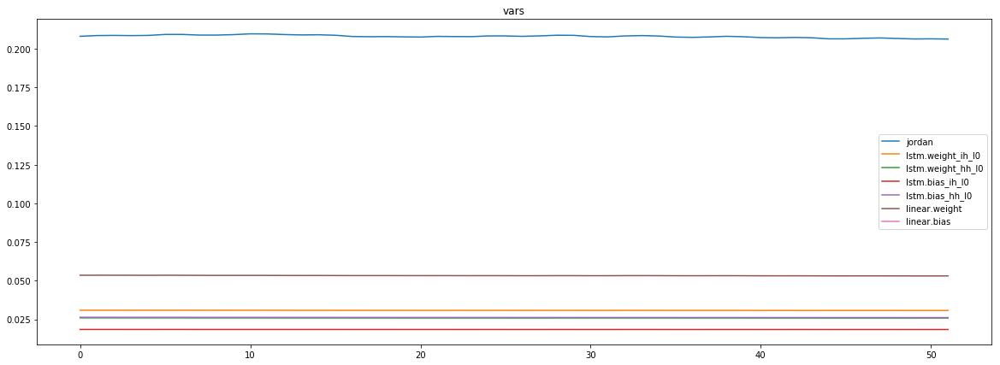

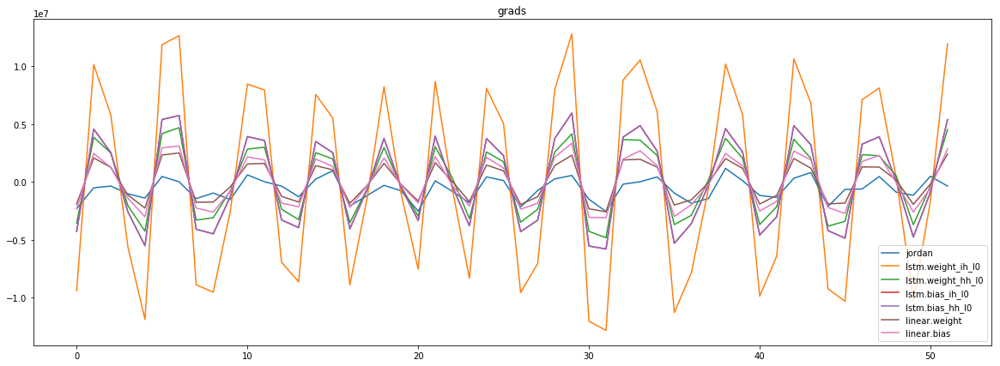

mean_p1 : -643111.5531850961
mean_p2 : 17045.49992487981


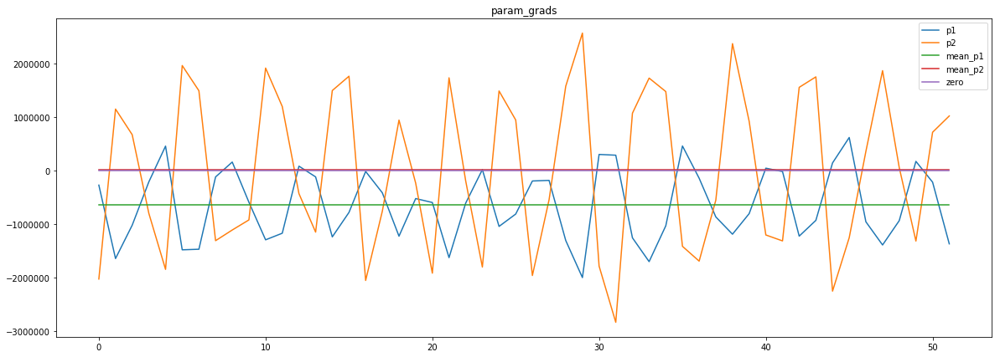

loss rate [0.10716426876021568]
Epoch [49] 
     train_loss[108402.18370643028] 
     eval_train[104412.05183293269] 
     eval_test[107594.30362215909]



aux preds: 0.3759806156158447 1.0129187107086182
main loss 0.0
aux loss 37814.946965144234
jord loss 66957.47521033653
combined loss 104772.42217548077 



Parameter containing:
tensor([[0.3760, 1.0129]], requires_grad=True)


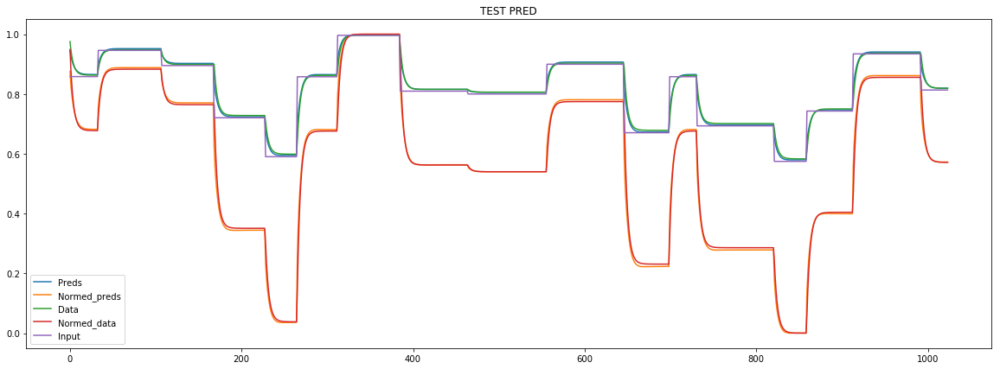

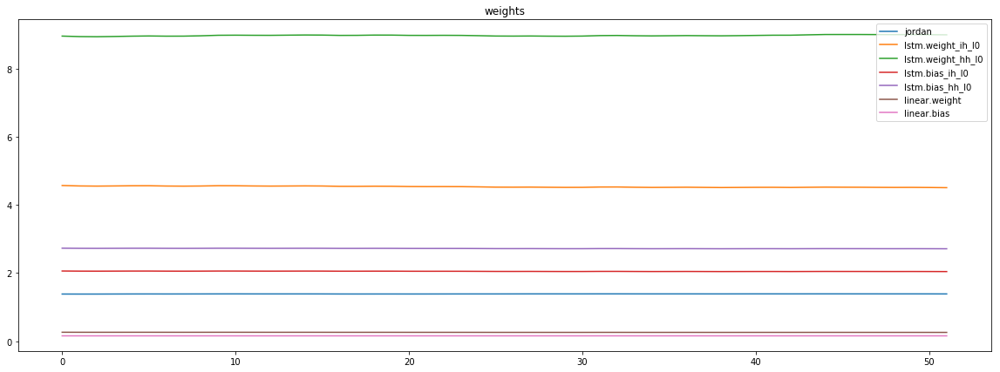

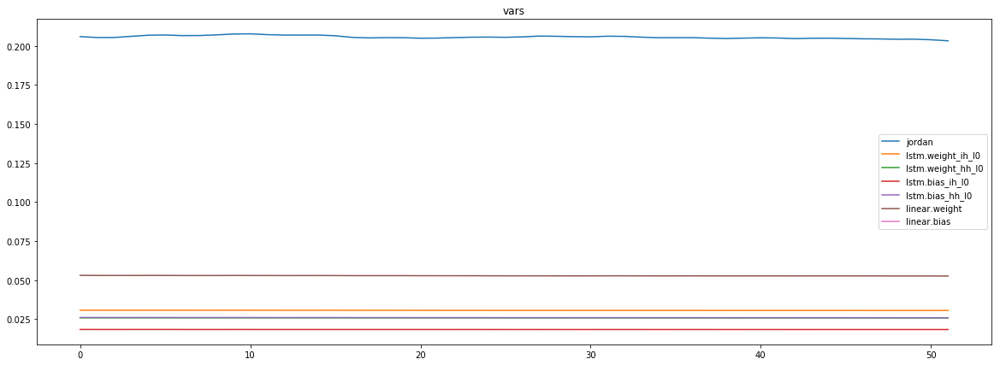

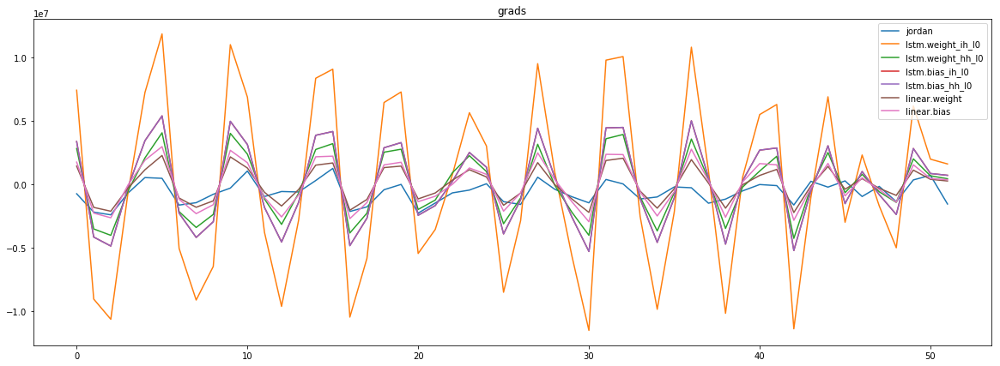

mean_p1 : -623284.8010817308
mean_p2 : 312.2109375


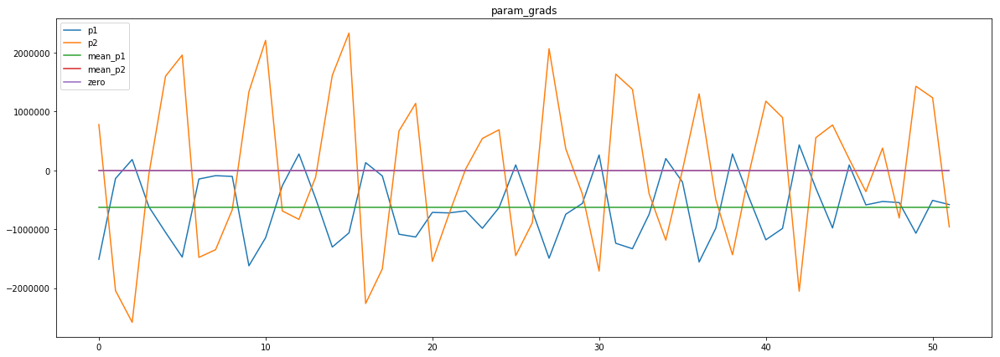

loss rate [0.032709666747271604]
Epoch [50] 
     train_loss[104772.42217548077] 
     eval_train[105180.07264122597] 
     eval_test[108649.64994673297]



aux preds: 0.3797169327735901 1.0132291316986084
main loss 0.0
aux loss 37841.617112379805
jord loss 64821.616511418266
combined loss 102663.23362379806 



Parameter containing:
tensor([[0.3797, 1.0132]], requires_grad=True)


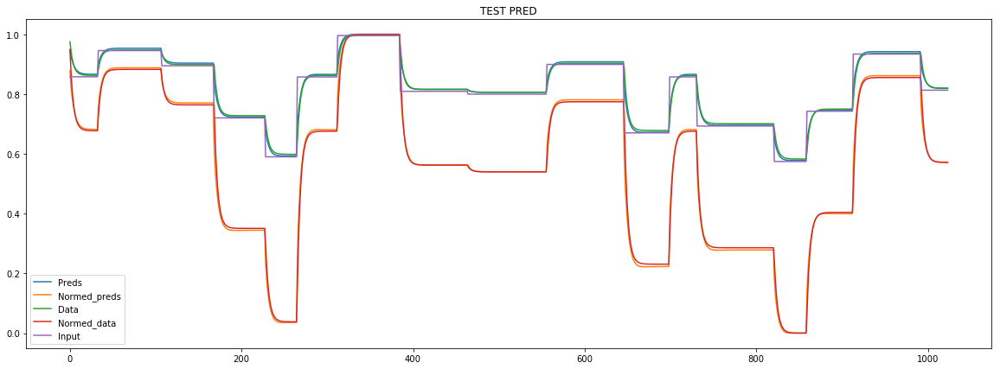

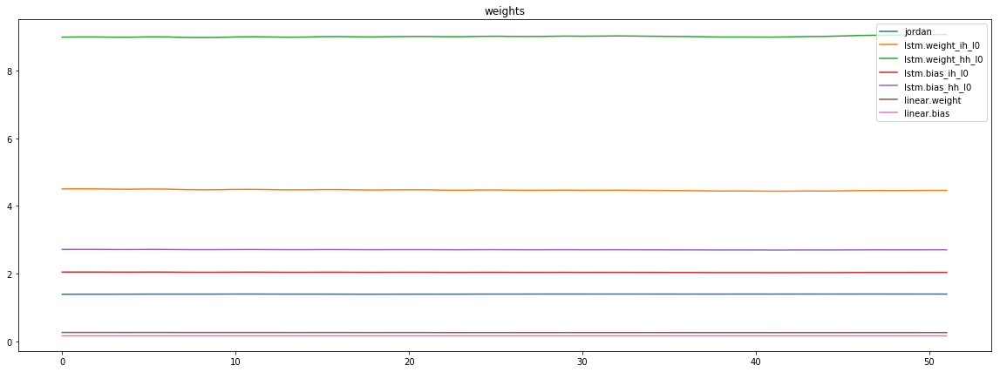

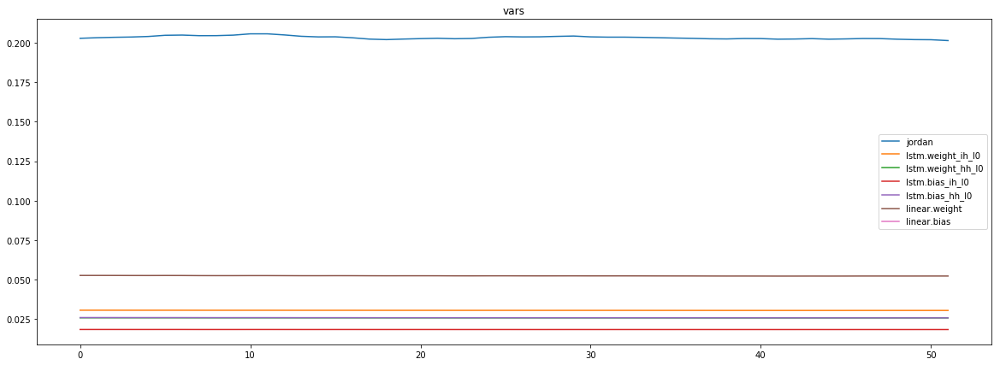

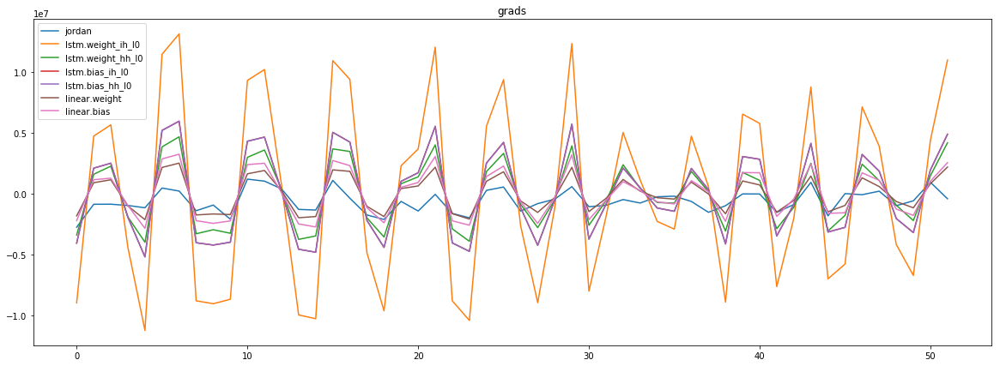

mean_p1 : -610625.0997596154
mean_p2 : 21807.459435096152


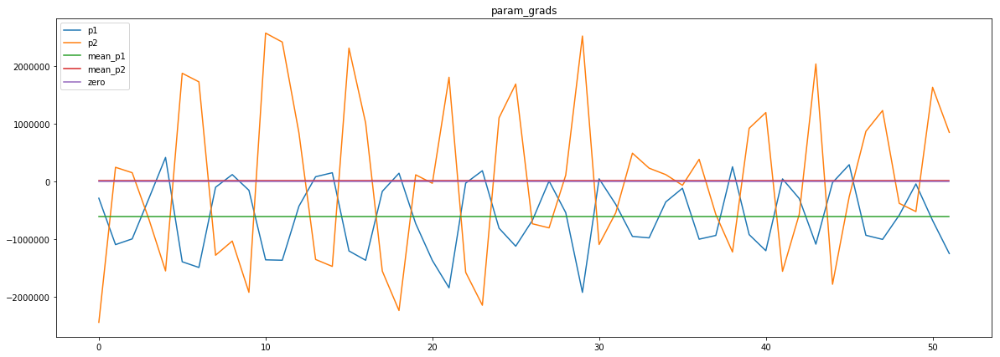

loss rate [0.05604643729662939]
Epoch [51] 
     train_loss[102663.23362379806] 
     eval_train[100588.1132436899] 
     eval_test[103933.33629261365]



aux preds: 0.3834892213344574 1.0137813091278076
main loss 0.0
aux loss 37139.740234375
jord loss 62592.14111328125
combined loss 99731.88134765625 



Parameter containing:
tensor([[0.3835, 1.0138]], requires_grad=True)


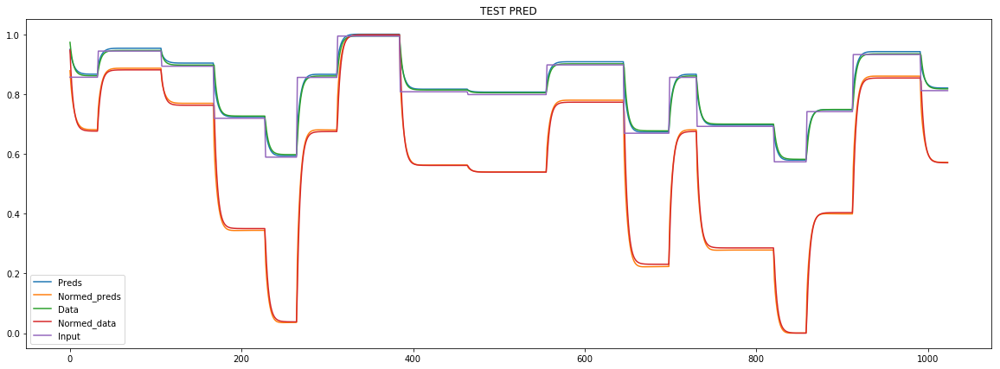

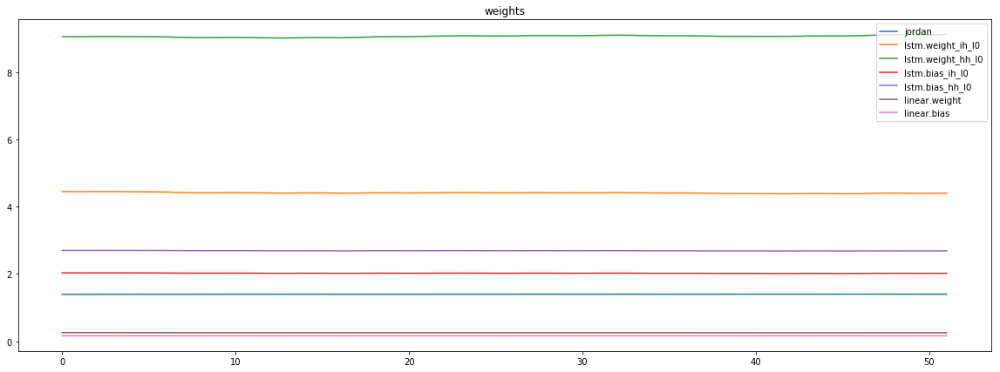

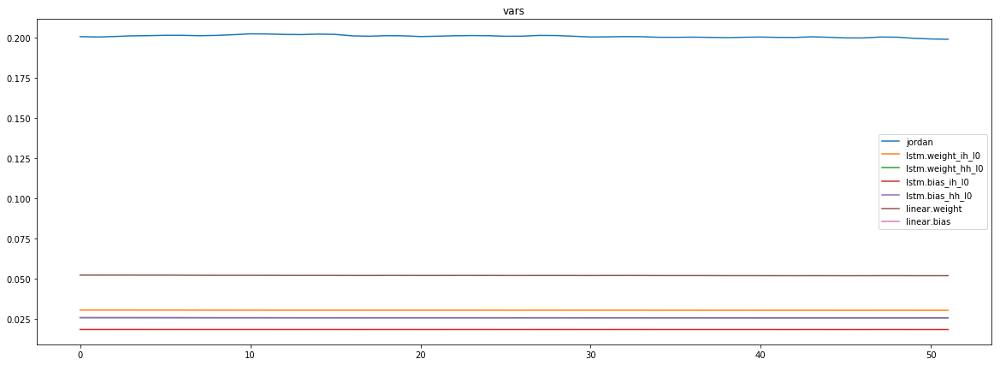

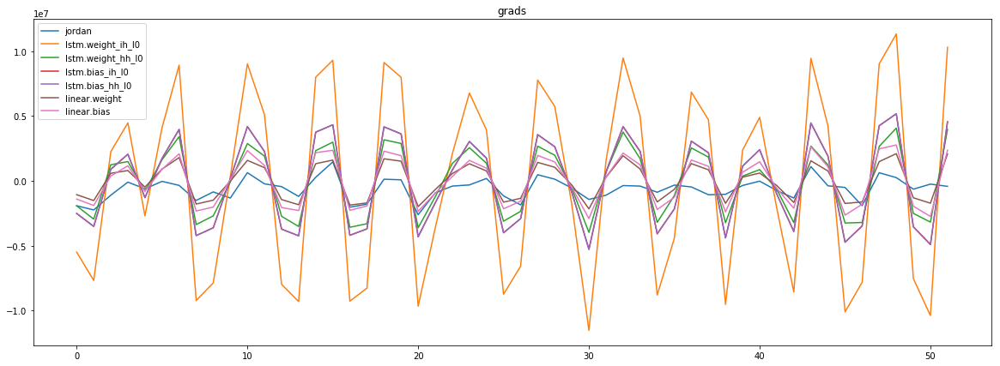

mean_p1 : -585484.1745793269
mean_p2 : -23736.71394230769


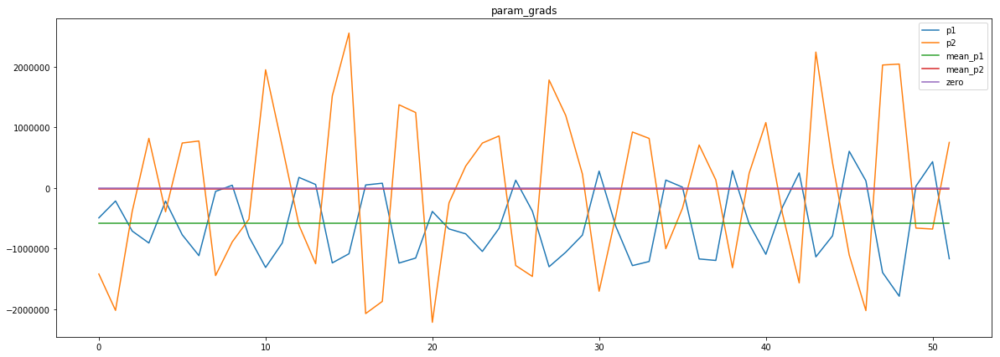

loss rate [0.068148778011628]
Epoch [52] 
     train_loss[99731.88134765625] 
     eval_train[96568.63405198317] 
     eval_test[99452.53293678976]



aux preds: 0.3872739374637604 1.0129497051239014
main loss 0.0
aux loss 35745.25448843149
jord loss 60467.25161508413
combined loss 96212.50610351562 



Parameter containing:
tensor([[0.3873, 1.0129]], requires_grad=True)


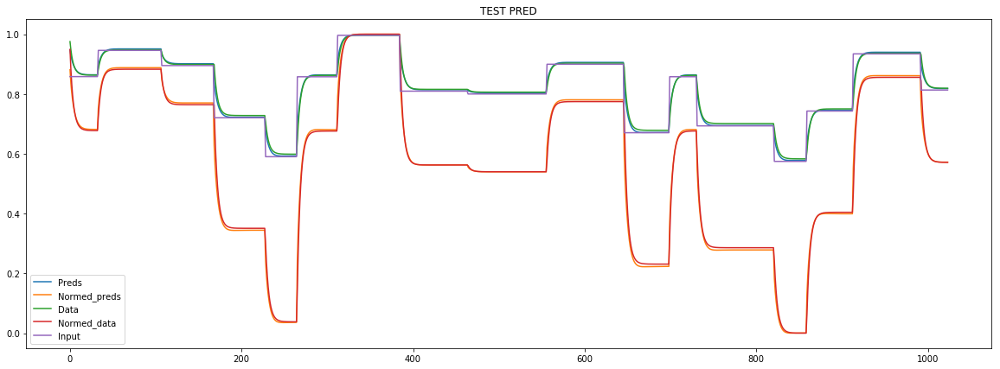

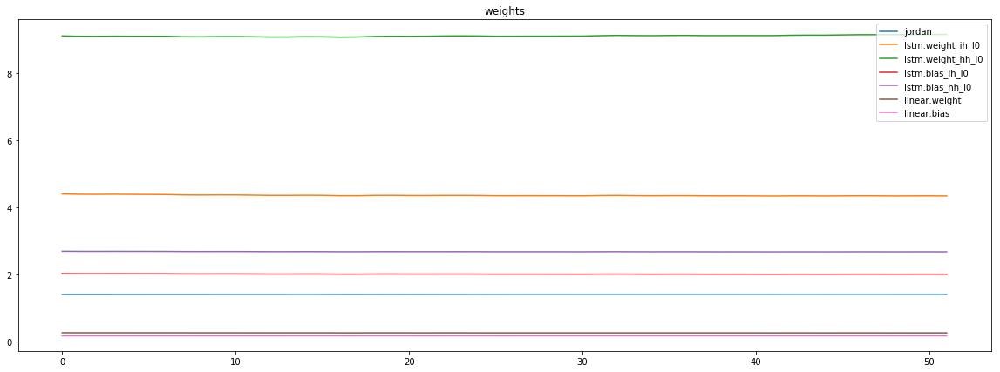

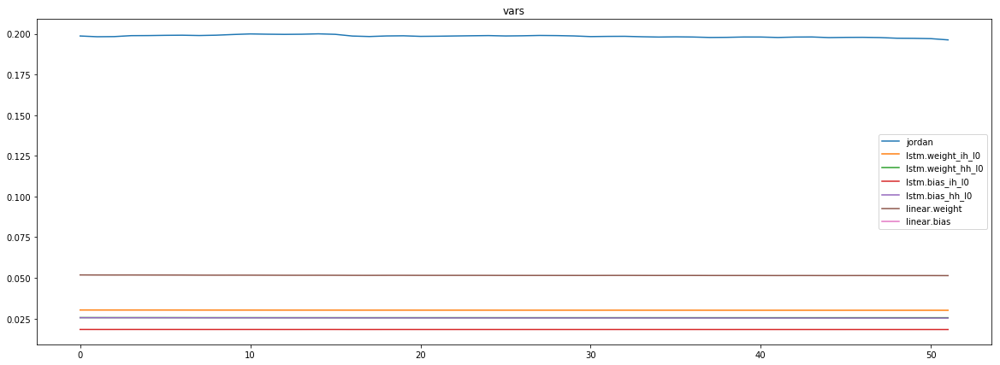

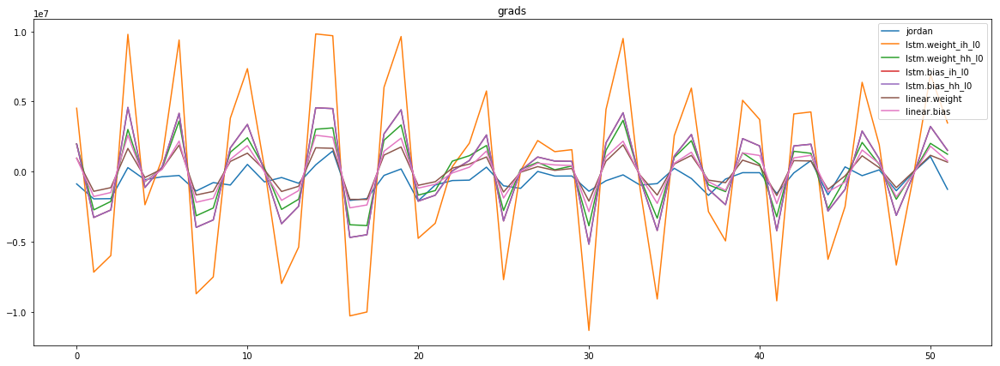

mean_p1 : -582375.1796875
mean_p2 : 10164.582181490385


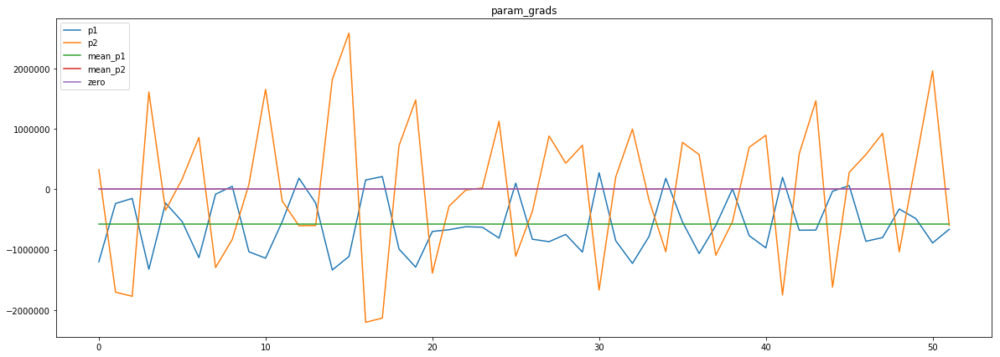

loss rate [0.004577591635400058]
Epoch [53] 
     train_loss[96212.50610351562] 
     eval_train[100329.00548377403] 
     eval_test[103535.71599786932]



aux preds: 0.39106449484825134 1.0136452913284302
main loss 0.0
aux loss 36394.40994966947
jord loss 58416.26772836538
combined loss 94810.67767803484 



Parameter containing:
tensor([[0.3911, 1.0136]], requires_grad=True)


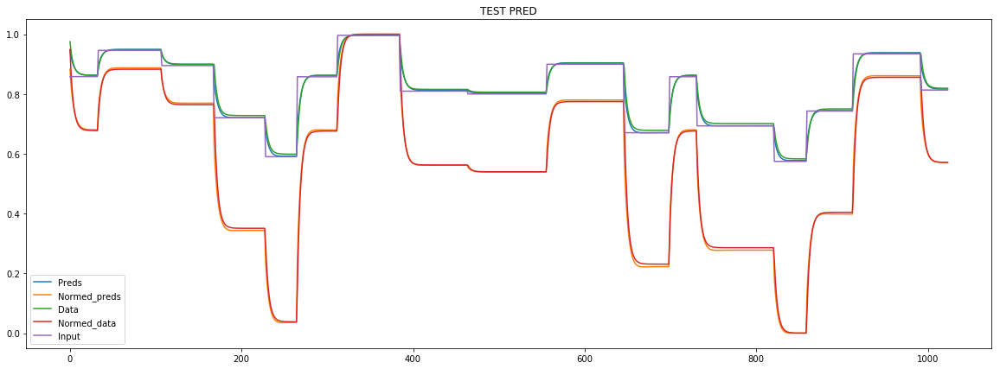

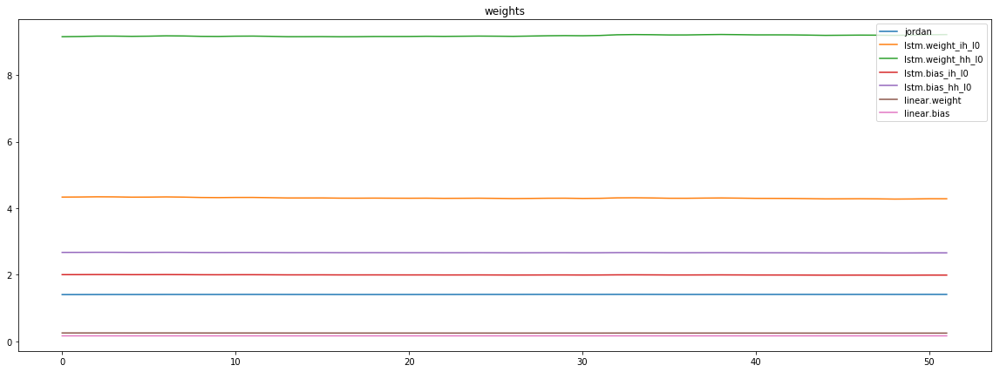

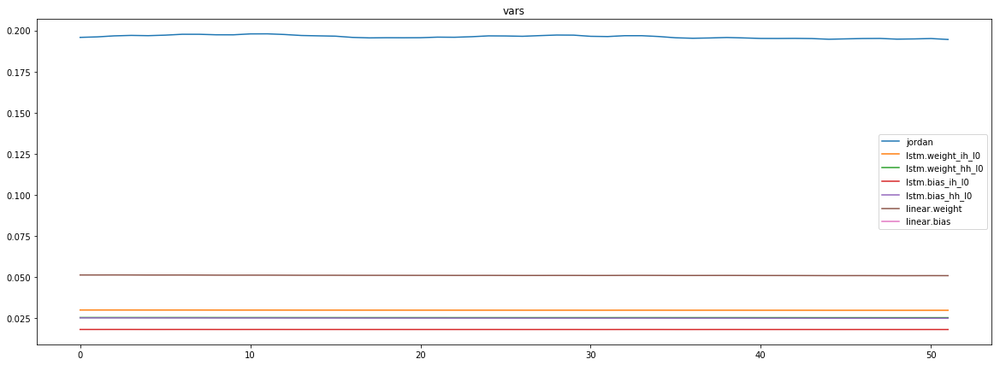

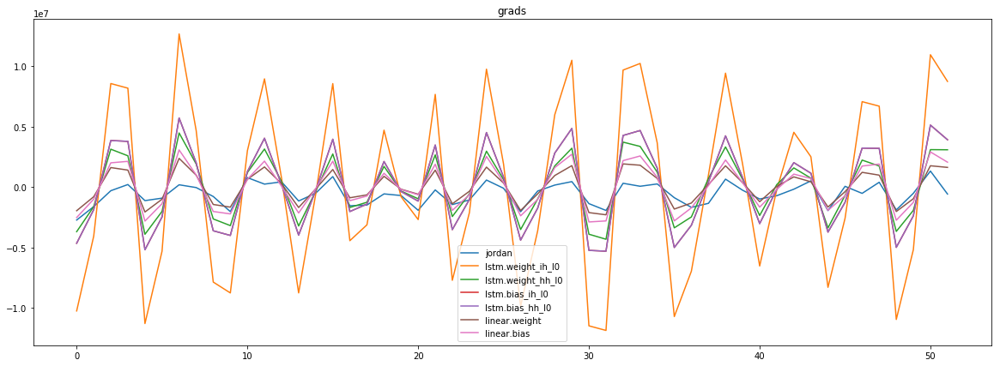

mean_p1 : -574224.1986177885
mean_p2 : 5266.521859975962


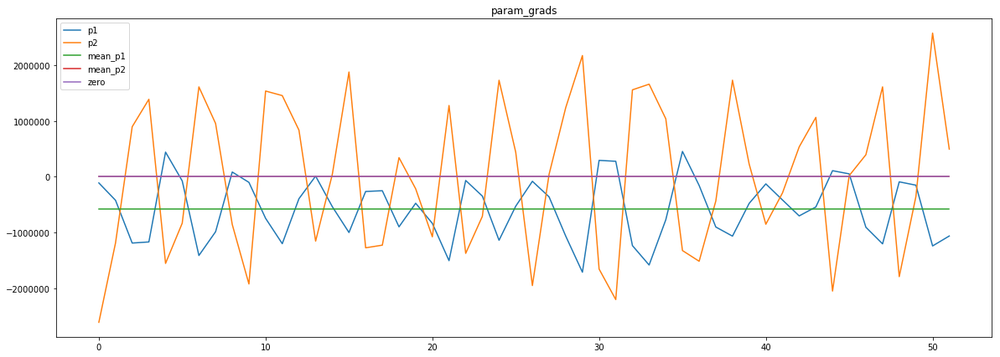

loss rate [0.0010575544641908685]
Epoch [54] 
     train_loss[94810.67767803484] 
     eval_train[99091.02005709134] 
     eval_test[102198.99964488635]



aux preds: 0.3949050307273865 1.0139448642730713
main loss 0.0
aux loss 35921.57577749399
jord loss 56314.06460336538
combined loss 92235.64038085938 



Parameter containing:
tensor([[0.3949, 1.0139]], requires_grad=True)


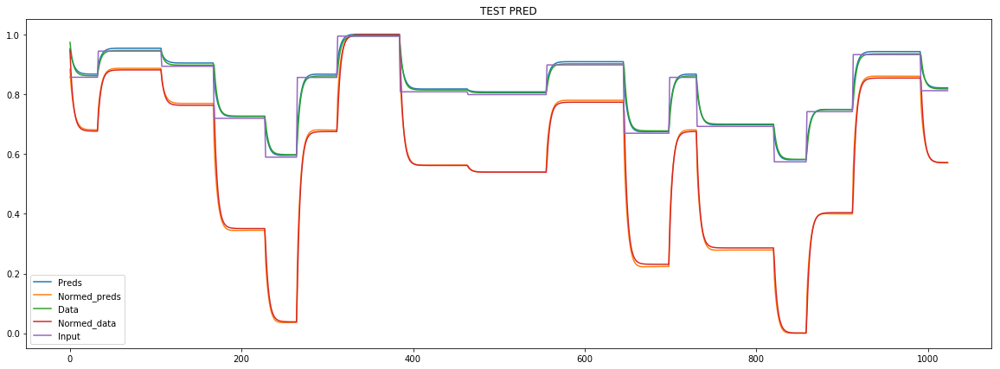

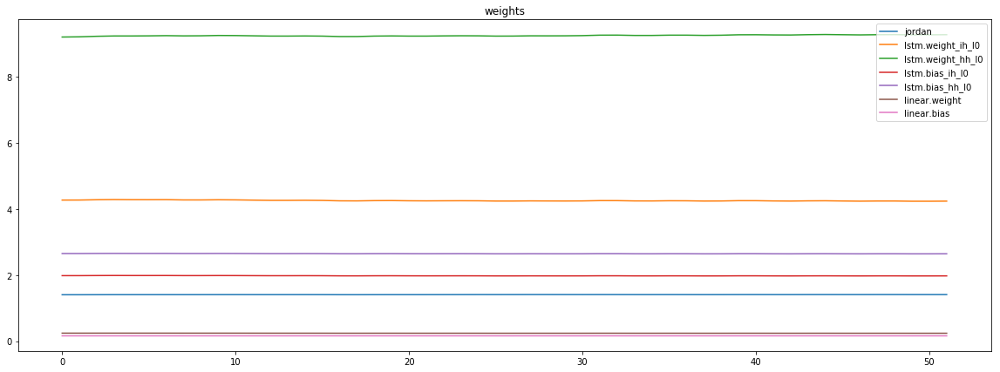

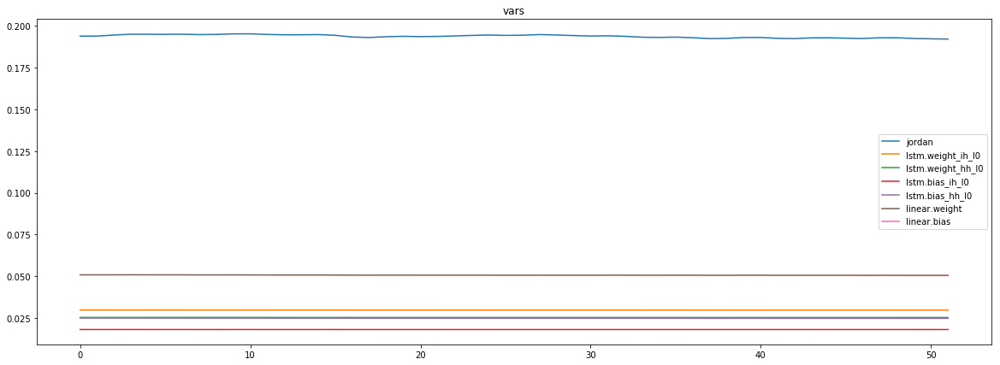

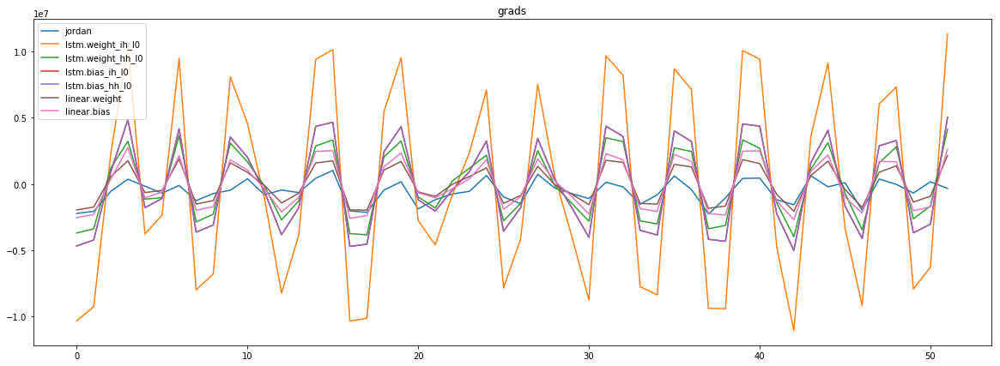

mean_p1 : -543723.6358173077
mean_p2 : -15123.209134615385


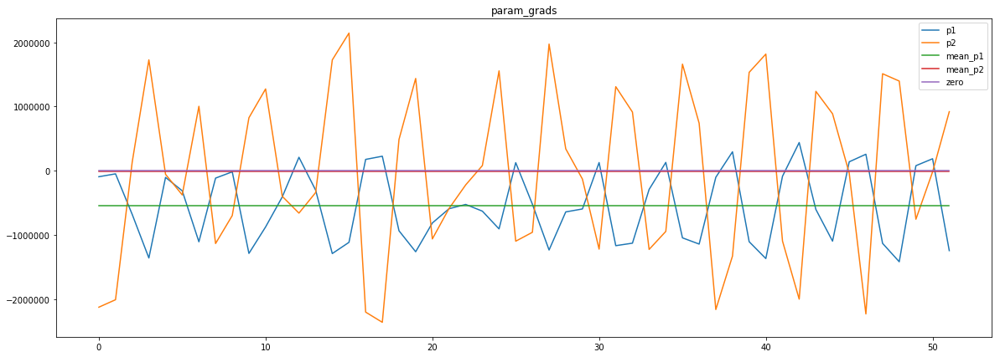

loss rate [0.0963350282464206]
Epoch [55] 
     train_loss[92235.64038085938] 
     eval_train[89366.26953125] 
     eval_test[91929.0087890625]



aux preds: 0.3988087773323059 1.0137957334518433
main loss 0.0
aux loss 35616.648737980766
jord loss 54338.616173377406
combined loss 89955.26491135817 



Parameter containing:
tensor([[0.3988, 1.0138]], requires_grad=True)


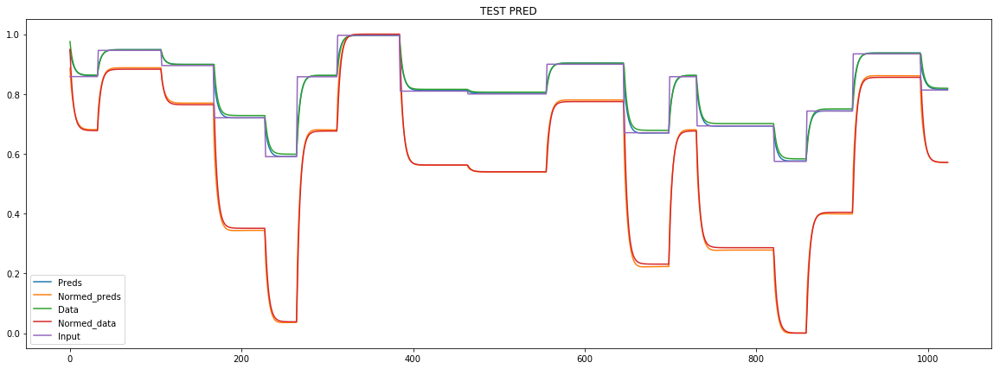

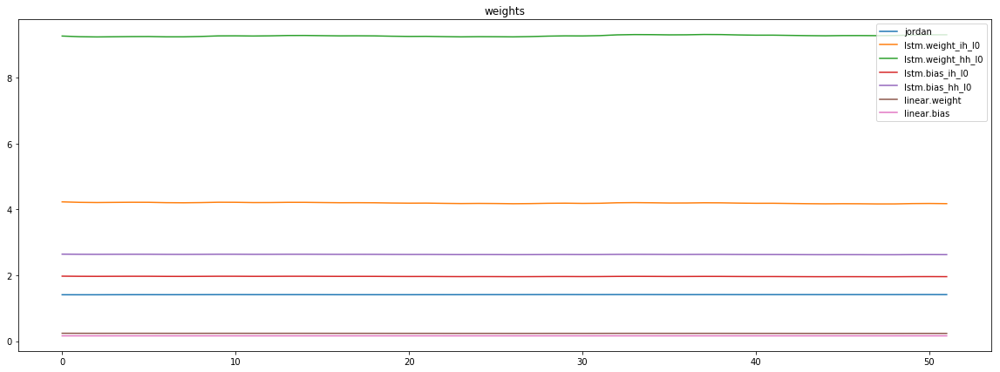

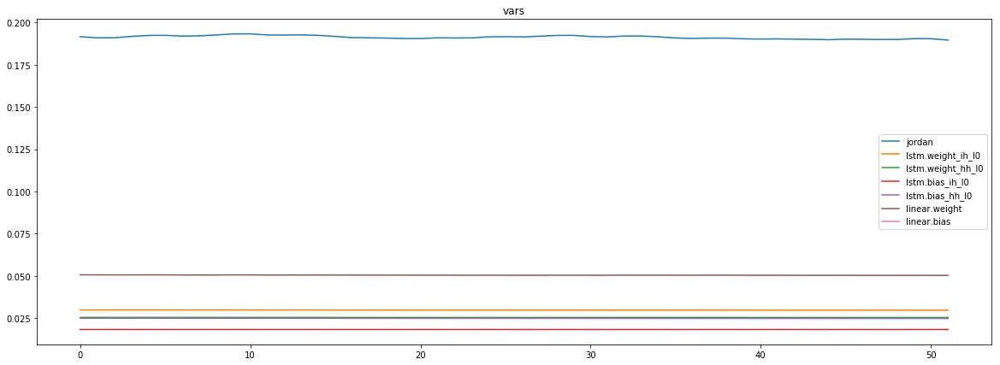

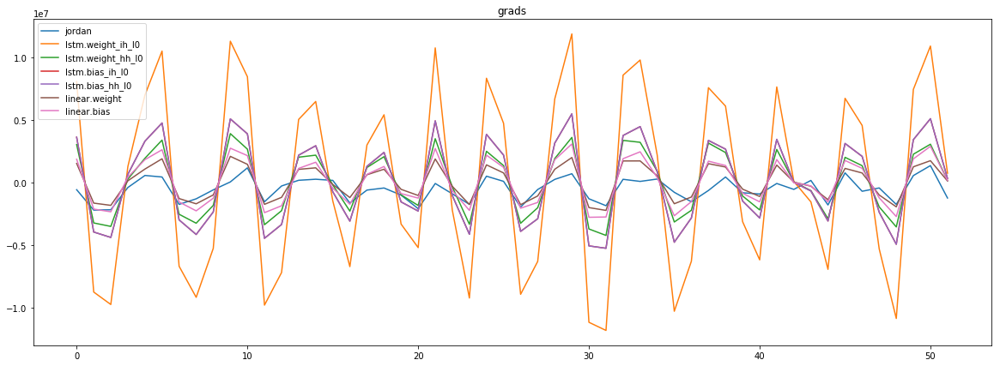

mean_p1 : -557530.7403846154
mean_p2 : 4528.884915865385


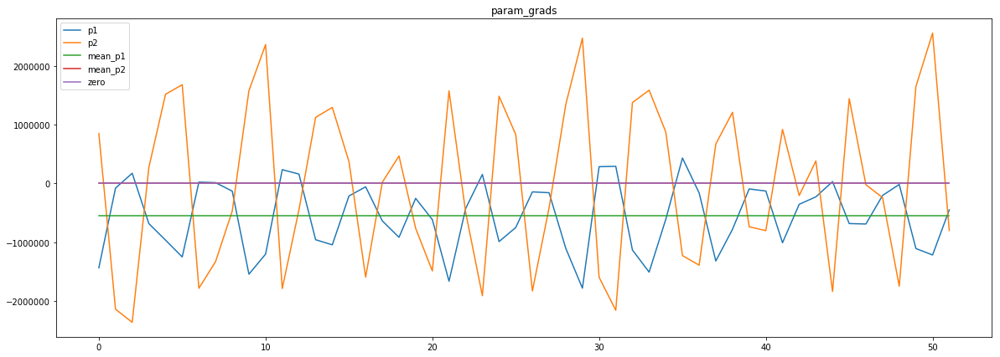

loss rate [-0.000556450772875472]
Epoch [56] 
     train_loss[89955.26491135817] 
     eval_train[96321.41379957933] 
     eval_test[99276.45321377841]



aux preds: 0.402688592672348 1.0124646425247192
main loss 0.0
aux loss 35181.07187124399
jord loss 52252.129469651445
combined loss 87433.20134089544 



Parameter containing:
tensor([[0.4027, 1.0125]], requires_grad=True)


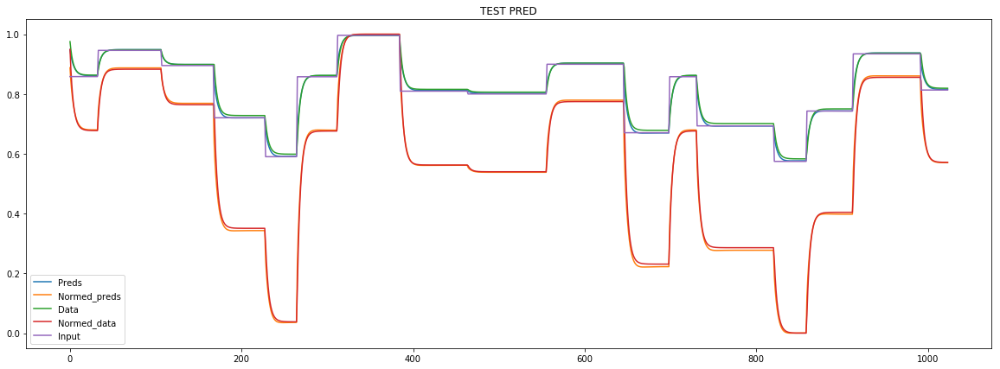

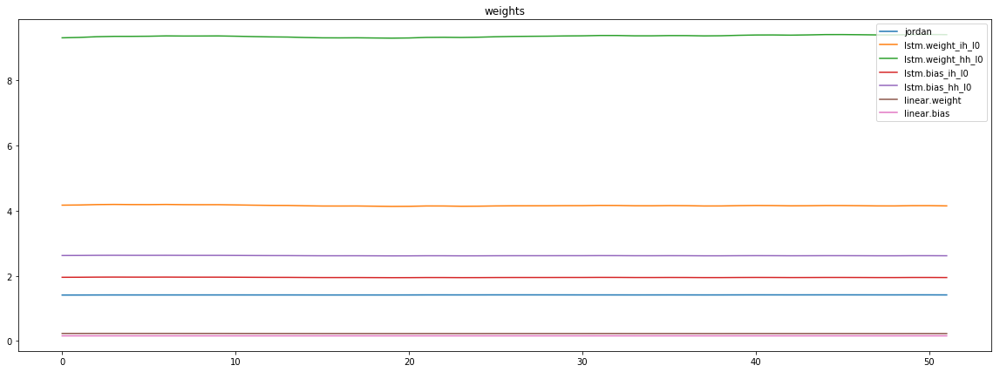

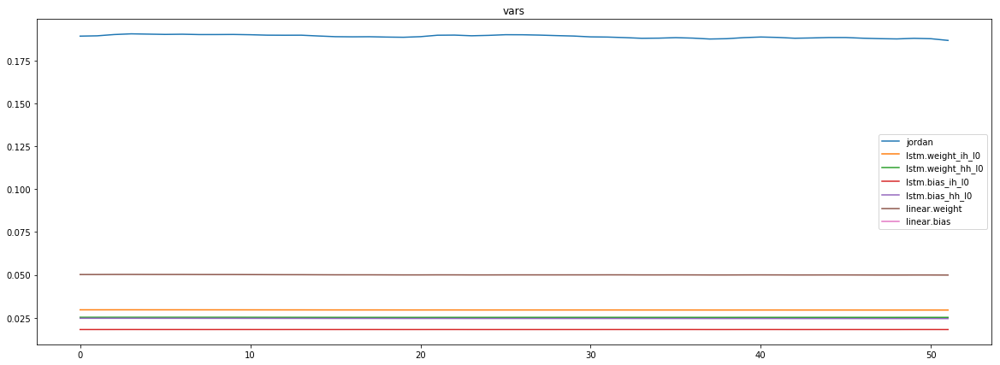

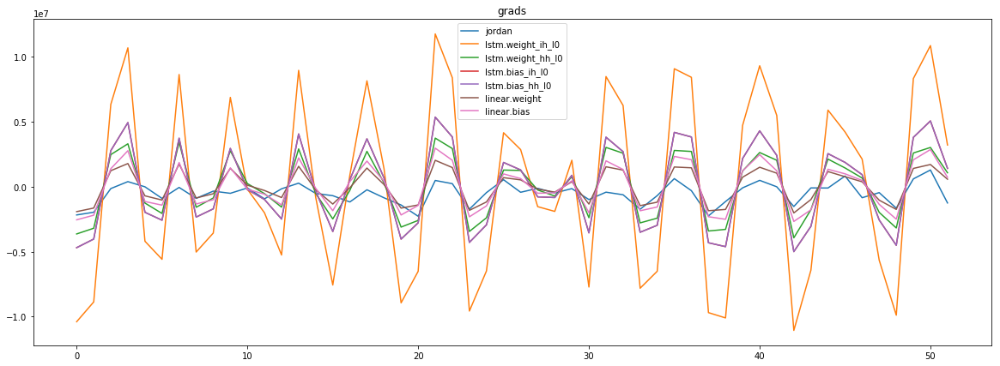

mean_p1 : -534792.0823317308
mean_p2 : 15941.919170673076


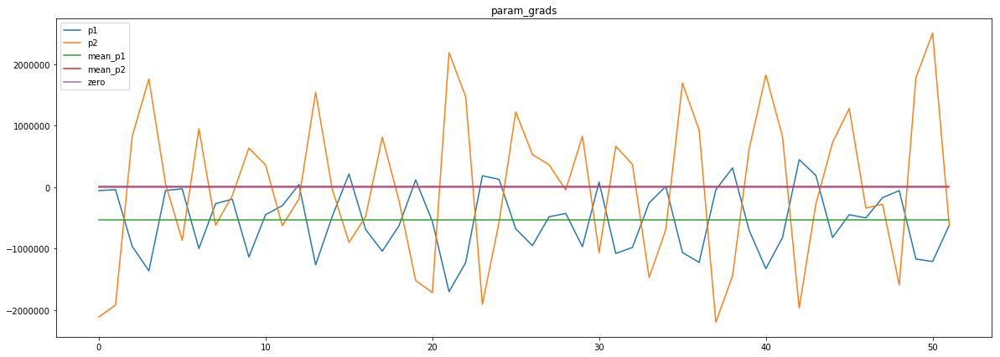

loss rate [-0.020674831788713988]
Epoch [57] 
     train_loss[87433.20134089544] 
     eval_train[96968.85302734375] 
     eval_test[99823.51651278409]



aux preds: 0.4066040515899658 1.0134609937667847
main loss 0.0
aux loss 34689.699350210336
jord loss 50344.547062800484
combined loss 85034.24641301081 



Parameter containing:
tensor([[0.4066, 1.0135]], requires_grad=True)


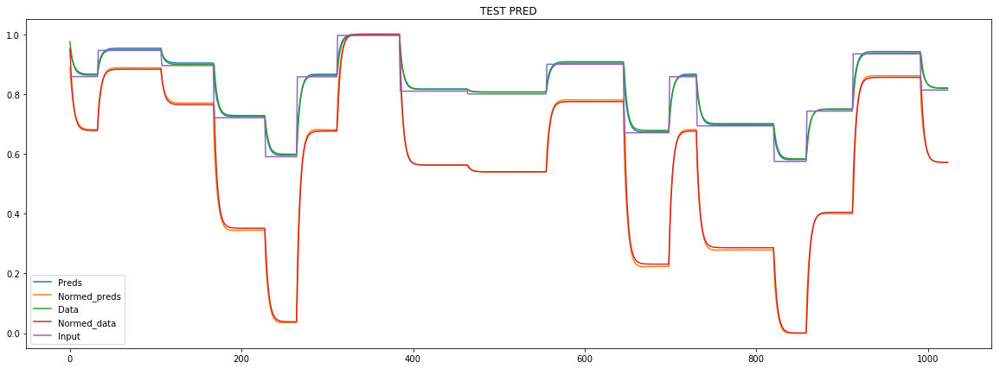

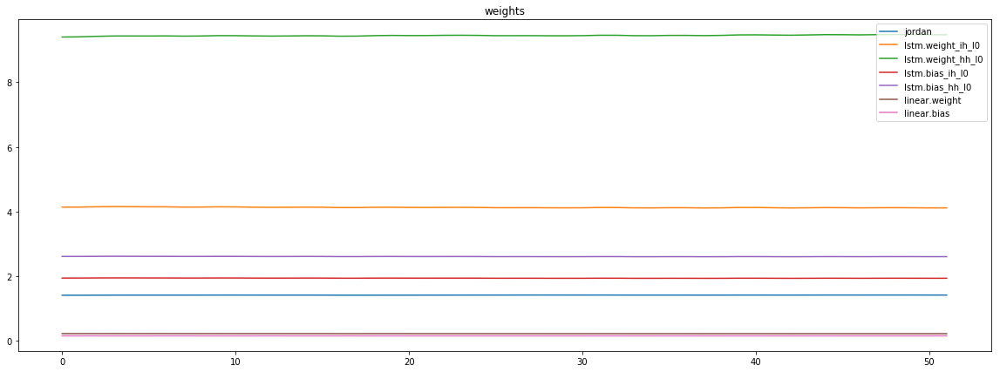

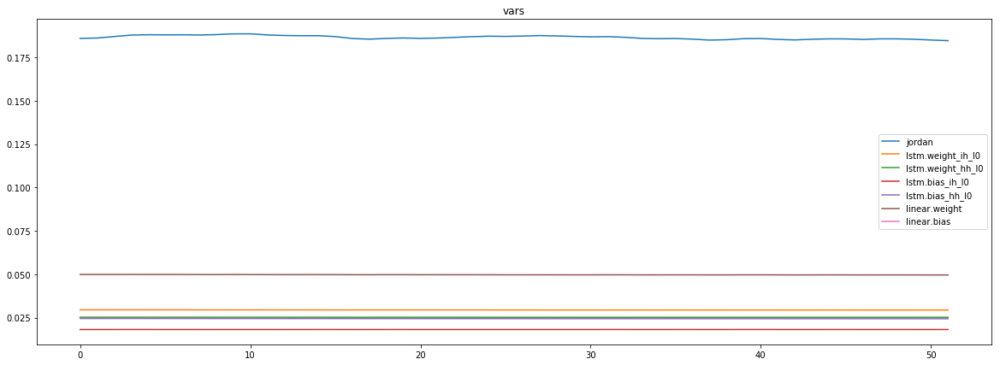

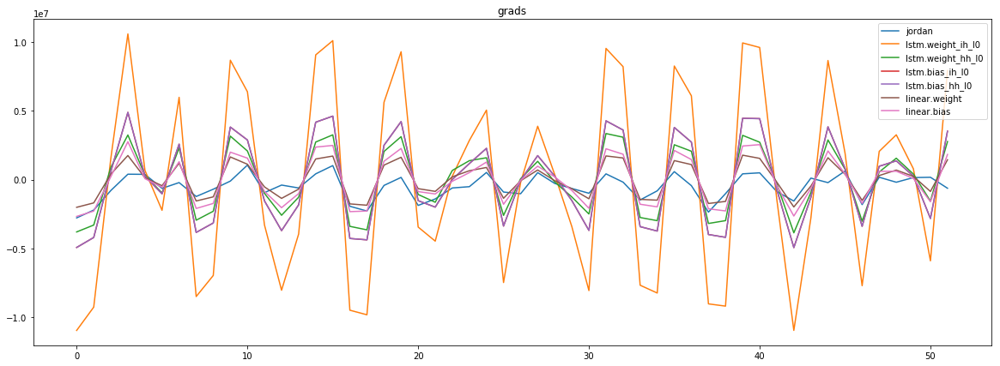

mean_p1 : -510249.3969350961
mean_p2 : -17946.45905949519


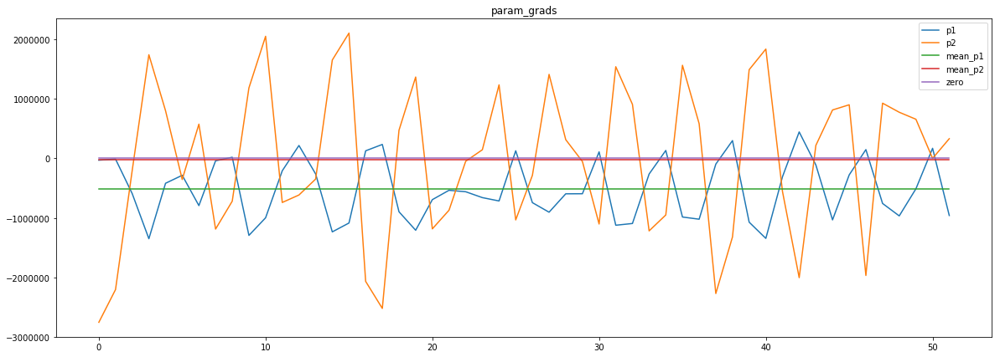

loss rate [0.12633616054690278]
Epoch [58] 
     train_loss[85034.24641301081] 
     eval_train[81994.91815655048] 
     eval_test[84753.83158735796]



aux preds: 0.4105416536331177 1.0140591859817505
main loss 0.0
aux loss 34365.865234375
jord loss 48351.185133713945
combined loss 82717.05036808894 



Parameter containing:
tensor([[0.4105, 1.0141]], requires_grad=True)


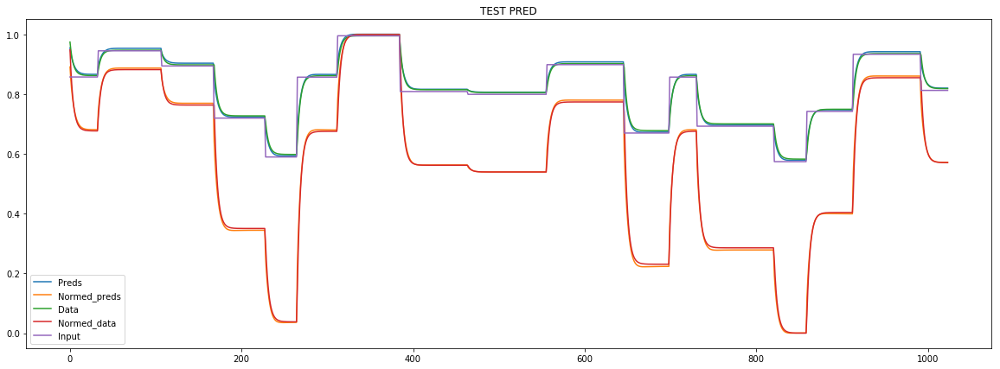

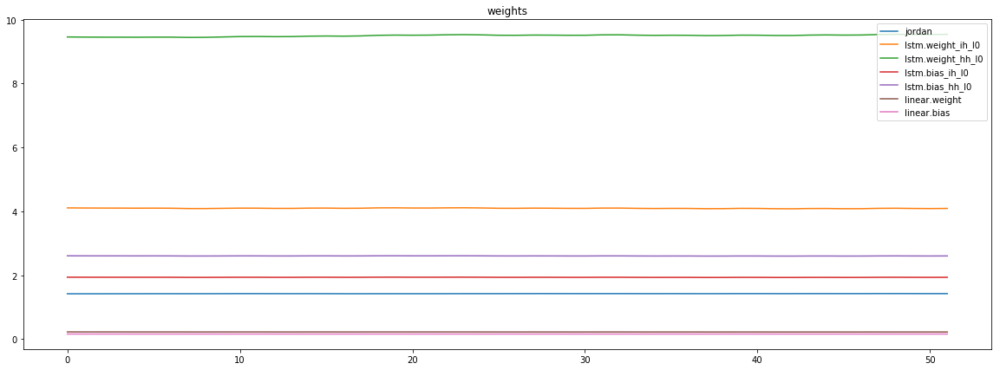

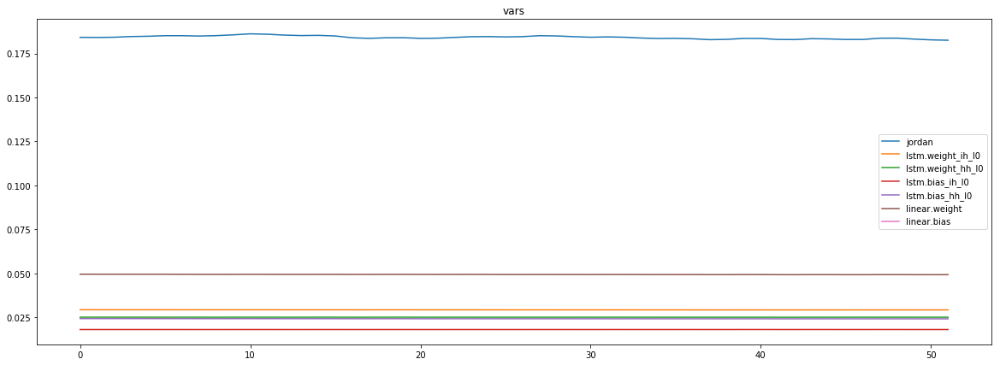

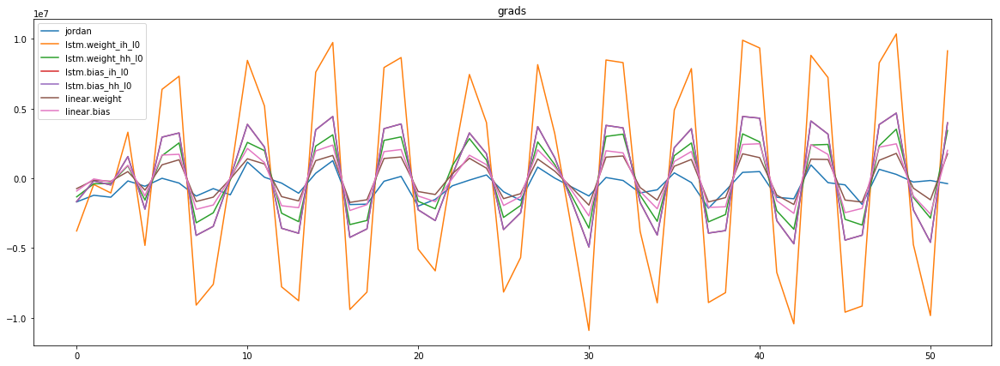

mean_p1 : -509764.6141826923
mean_p2 : -6411.389573317308


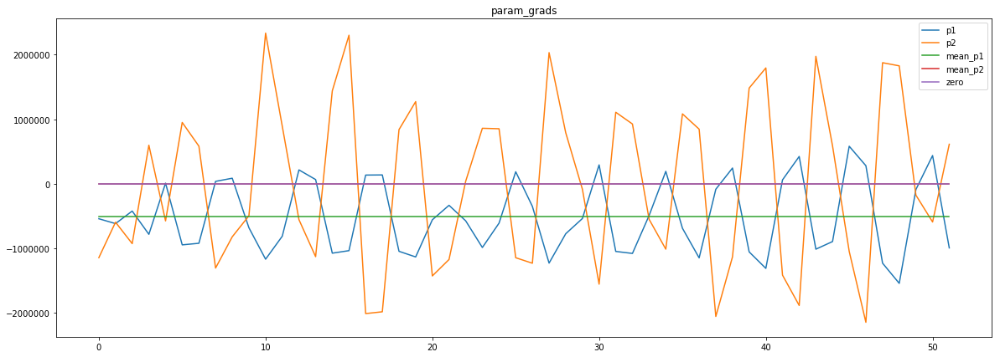

loss rate [0.1339640783903786]
Epoch [59] 
     train_loss[82717.05036808894] 
     eval_train[79516.3275052584] 
     eval_test[81942.52947443182]



aux preds: 0.4144529700279236 1.0145457983016968
main loss 0.0
aux loss 34461.276930588945
jord loss 46373.746394230766
combined loss 80835.02332481972 



Parameter containing:
tensor([[0.4145, 1.0145]], requires_grad=True)


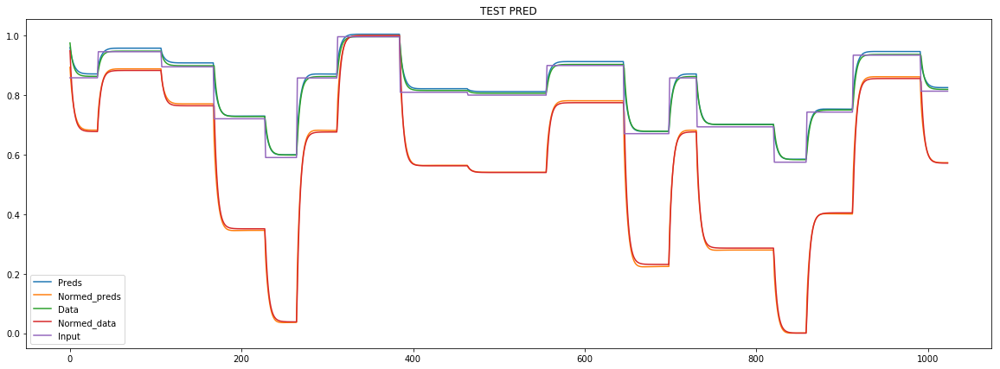

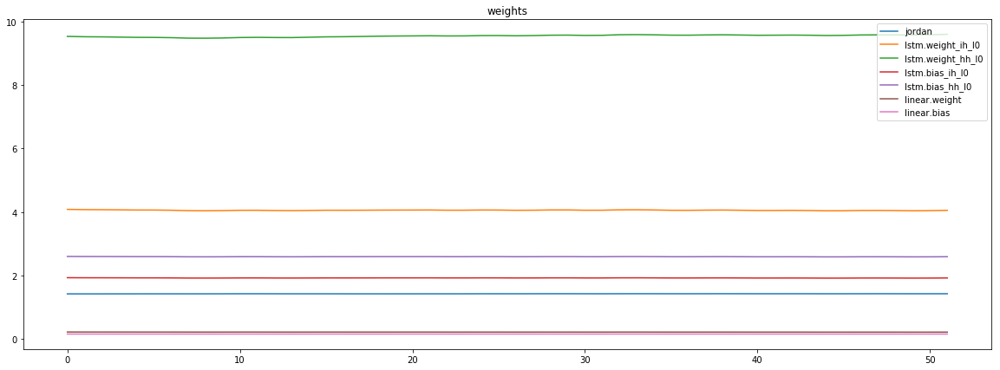

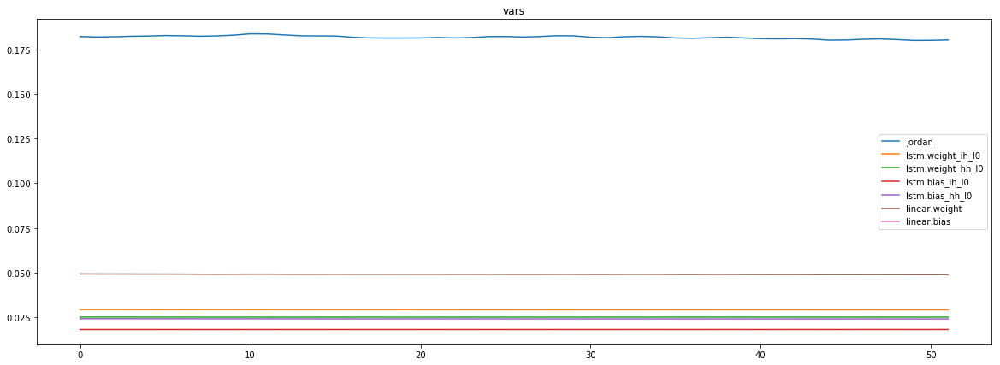

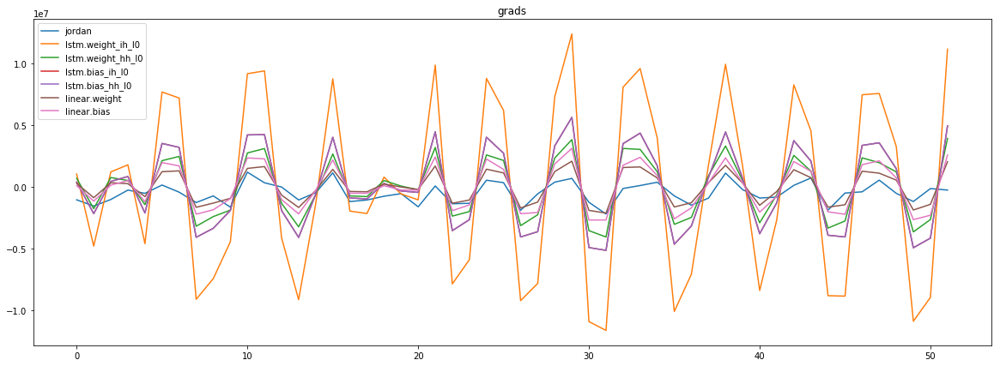

mean_p1 : -490541.80018028844
mean_p2 : -17140.36493389423


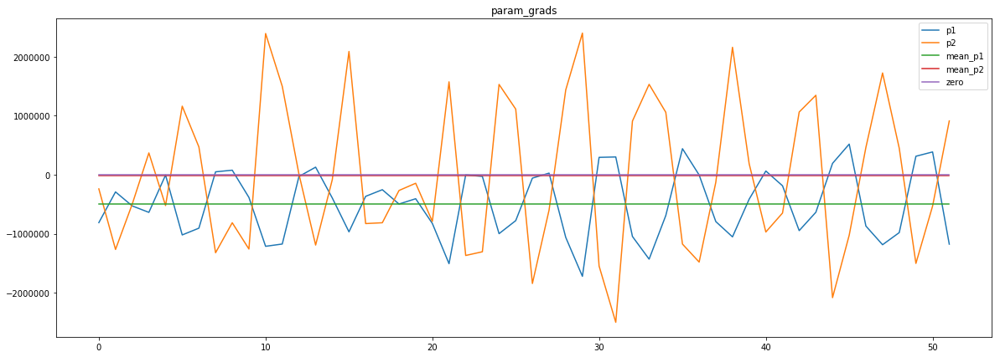

loss rate [0.035234890971677646]
Epoch [60] 
     train_loss[80835.02332481972] 
     eval_train[83816.47802734375] 
     eval_test[85709.69291548296]



aux preds: 0.41853067278862 1.0151621103286743
main loss 0.0
aux loss 38977.75076998197
jord loss 44564.735051081734
combined loss 83542.4858210637 



Parameter containing:
tensor([[0.4185, 1.0152]], requires_grad=True)


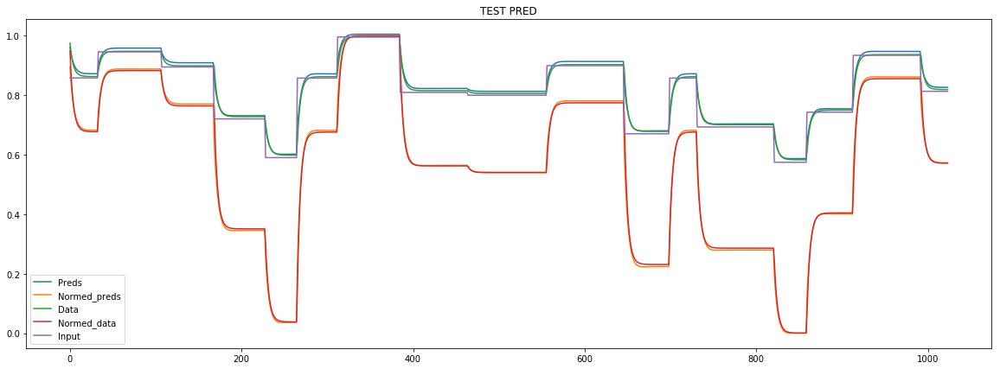

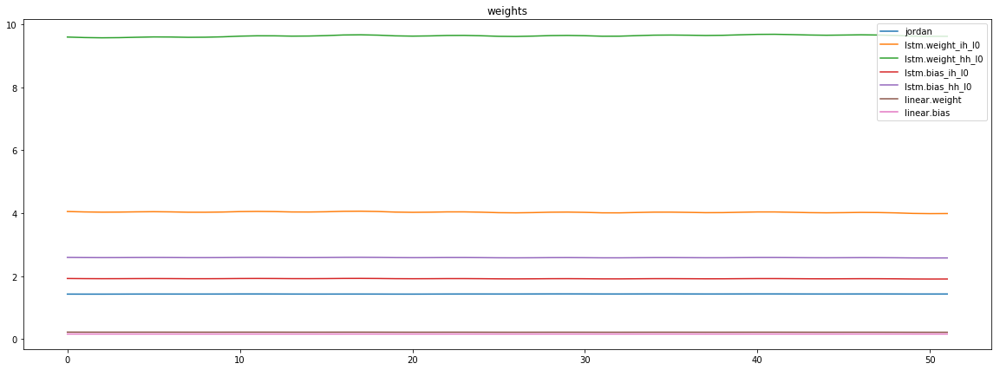

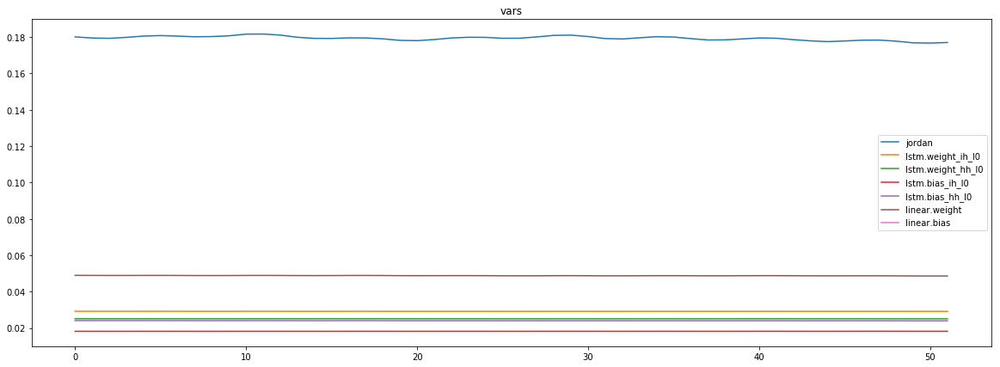

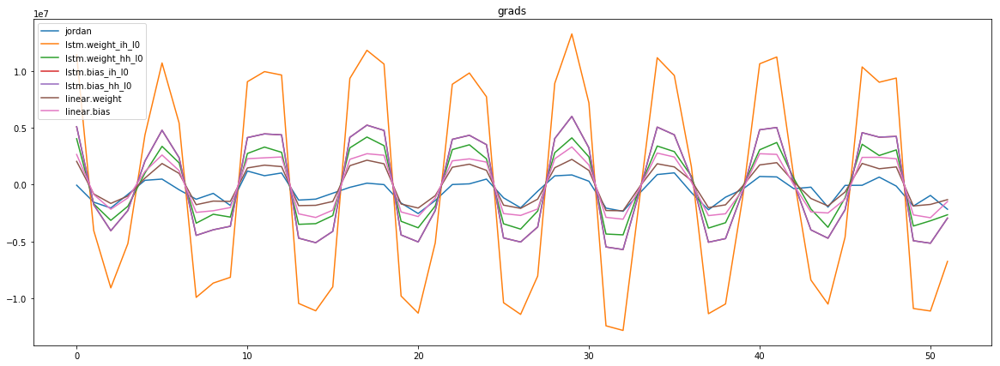

mean_p1 : -485663.7530048077
mean_p2 : -62912.260817307695


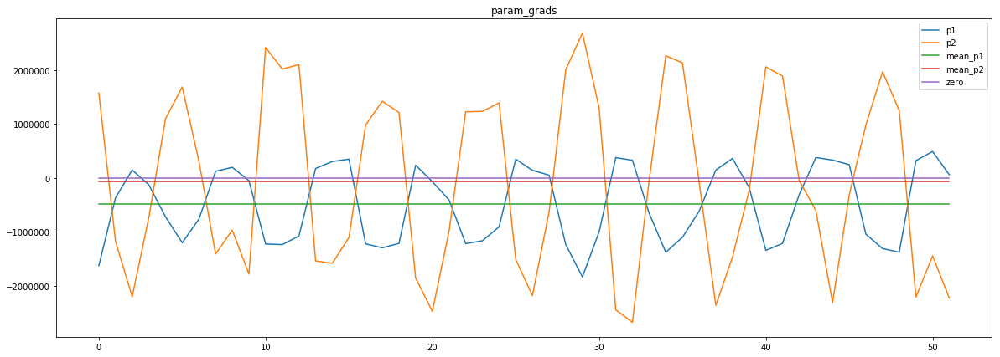

loss rate [-0.04668737762872177]
Epoch [61] 
     train_loss[83542.4858210637] 
     eval_train[86330.06820913462] 
     eval_test[88063.41024502841]



aux preds: 0.42262640595436096 1.013410210609436
main loss 0.0
aux loss 35123.036095252406
jord loss 42521.68043870192
combined loss 77644.71653395433 



Parameter containing:
tensor([[0.4226, 1.0134]], requires_grad=True)


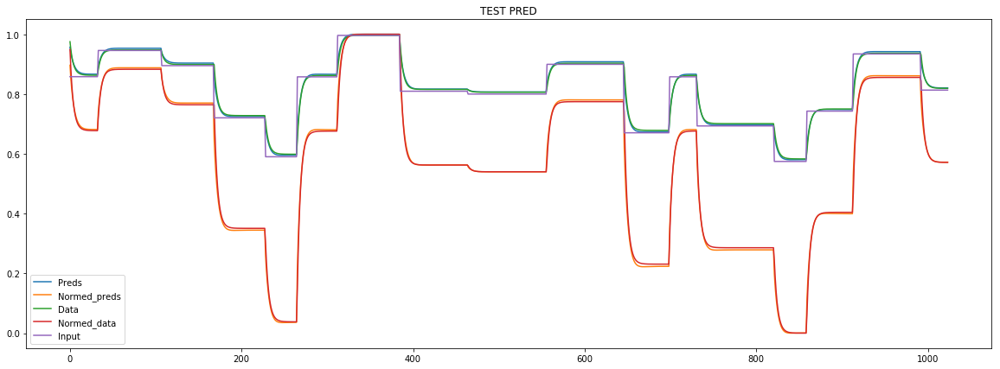

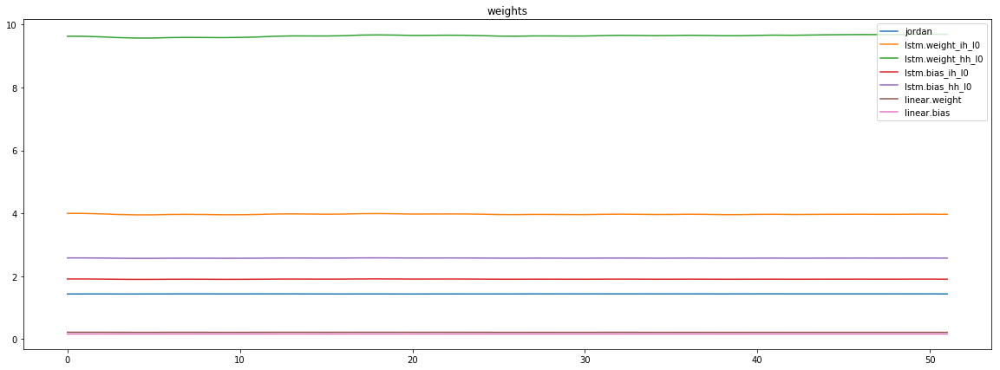

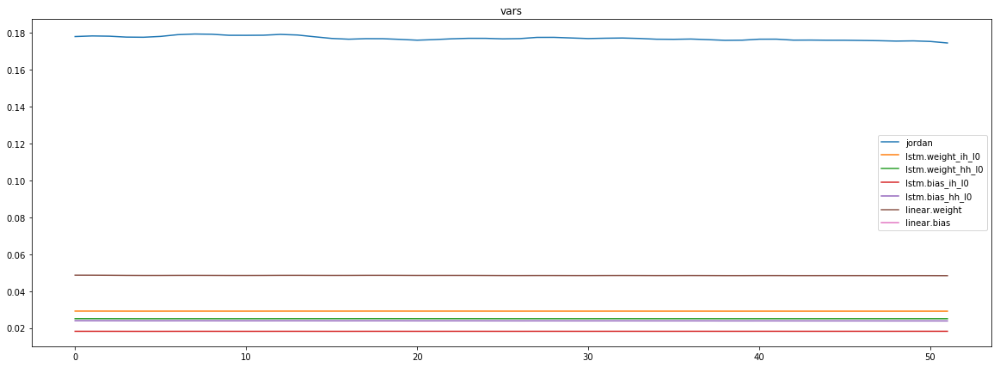

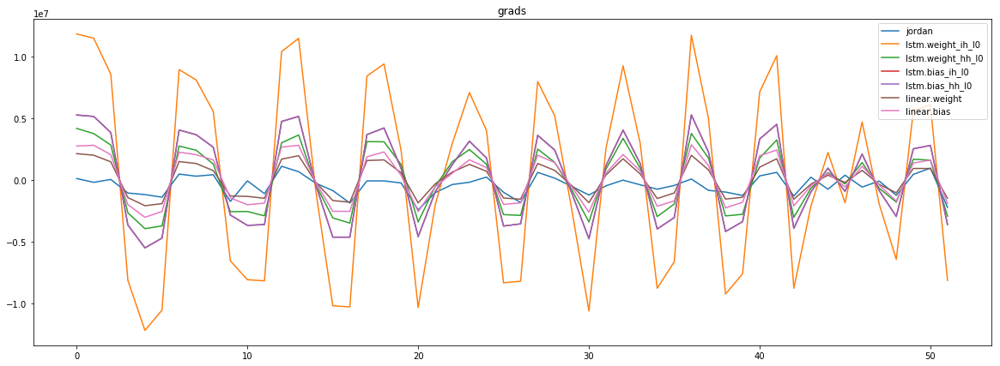

mean_p1 : -503213.59795673075
mean_p2 : 60189.931189903844


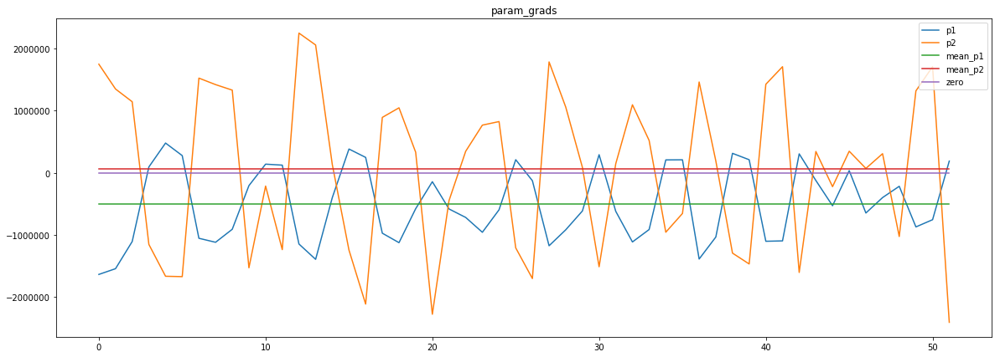

loss rate [0.11448282711594149]
Epoch [62] 
     train_loss[77644.71653395433] 
     eval_train[73020.47462815505] 
     eval_test[75480.19469105113]



aux preds: 0.42660778760910034 1.013053059577942
main loss 0.0
aux loss 32821.51297701322
jord loss 40706.65208082933
combined loss 73528.16505784255 



Parameter containing:
tensor([[0.4266, 1.0131]], requires_grad=True)


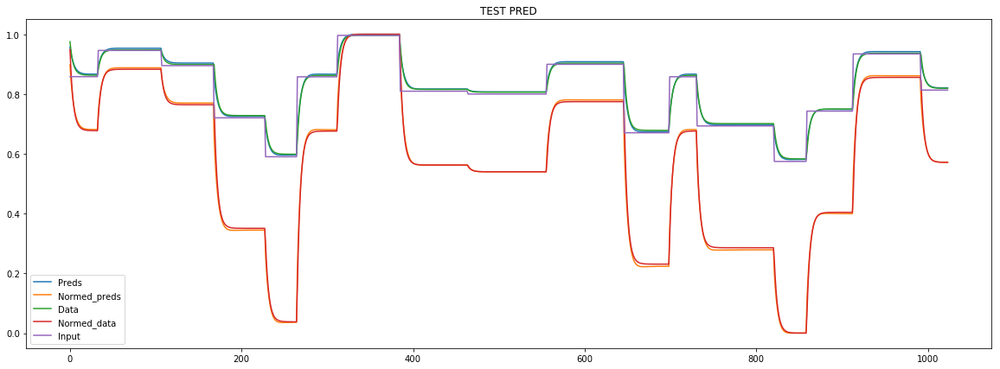

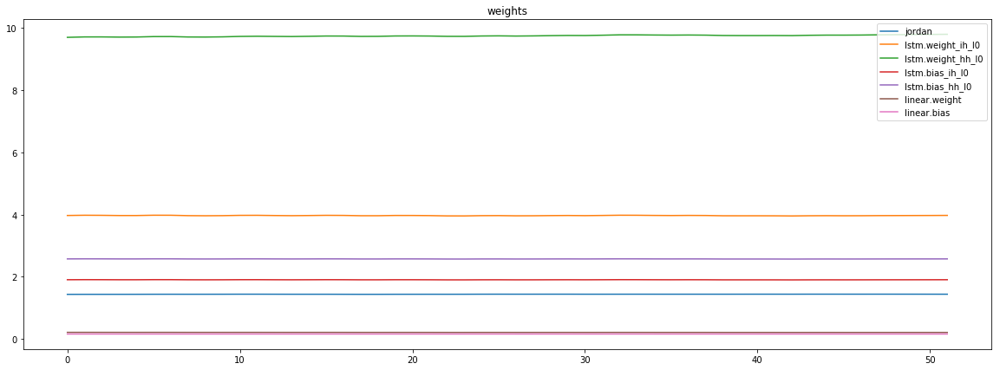

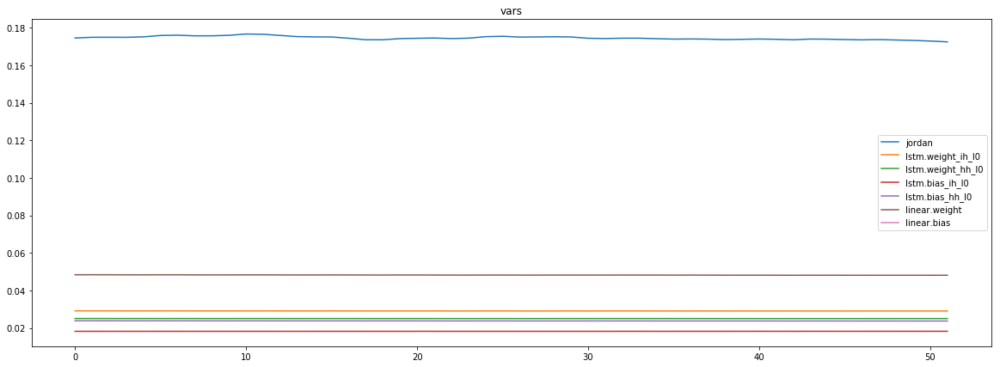

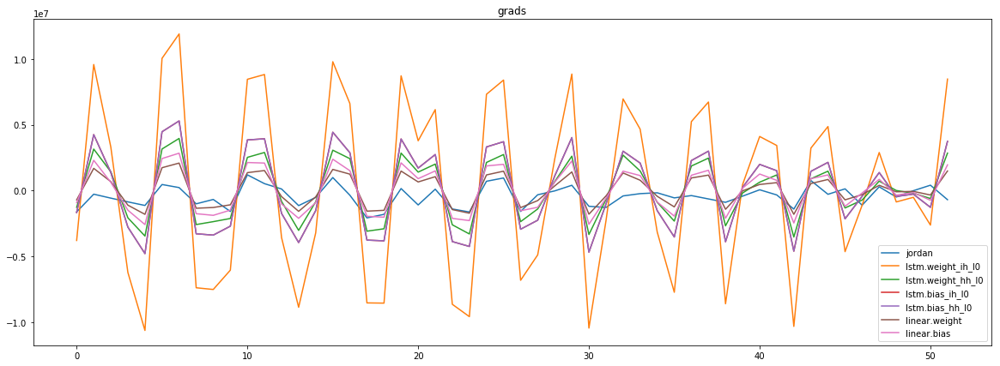

mean_p1 : -470621.0922475961
mean_p2 : 28152.629356971152


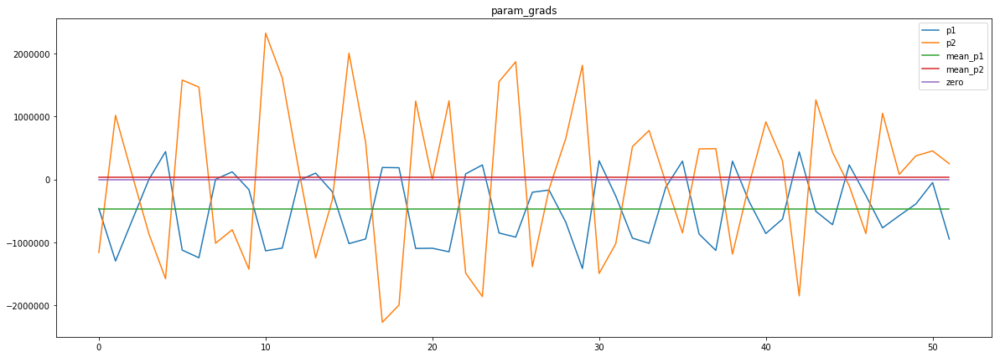

loss rate [0.11602886353513886]
Epoch [63] 
     train_loss[73528.16505784255] 
     eval_train[71022.63467172475] 
     eval_test[73444.24032315341]



aux preds: 0.43066564202308655 1.0123918056488037
main loss 0.0
aux loss 35883.08809720553
jord loss 39010.58668870192
combined loss 74893.67478590745 



Parameter containing:
tensor([[0.4307, 1.0124]], requires_grad=True)


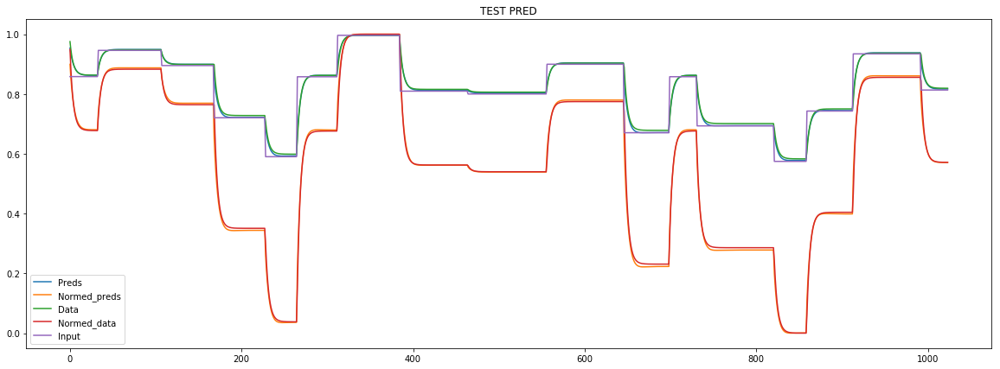

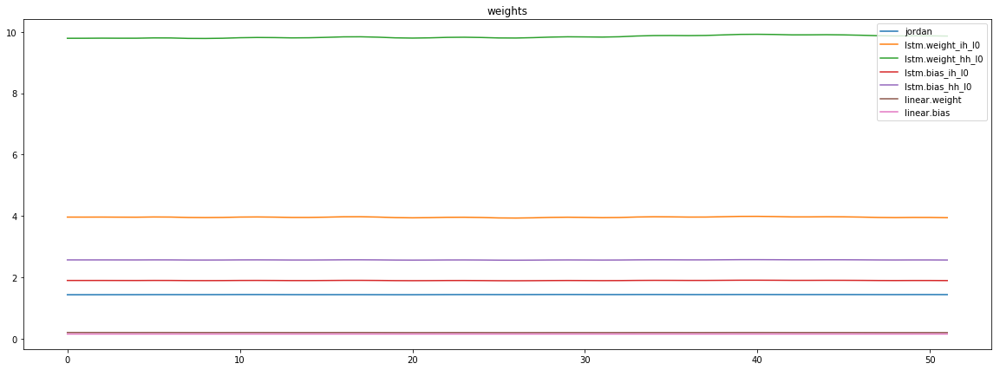

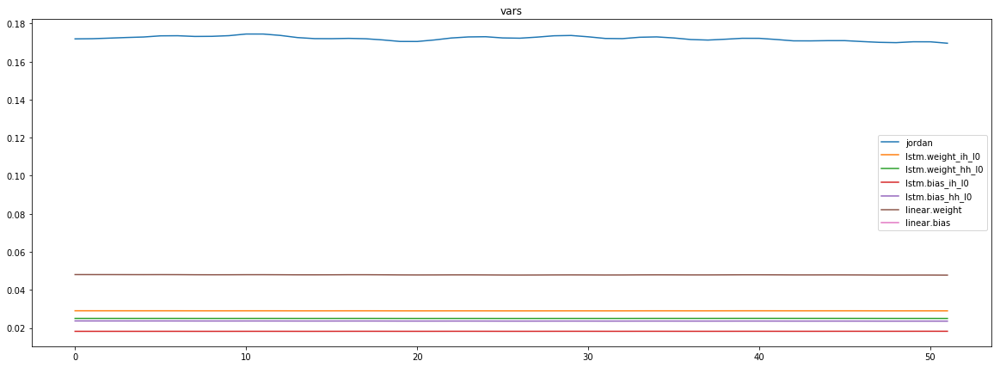

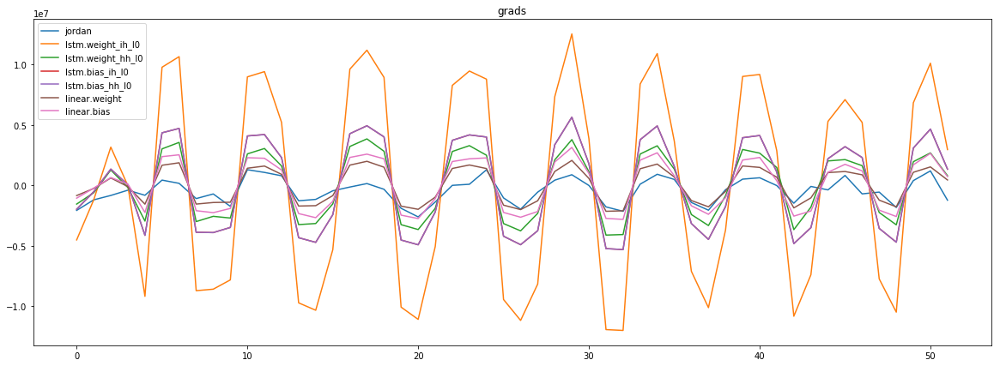

mean_p1 : -467682.87860576925
mean_p2 : 1223.051983173077


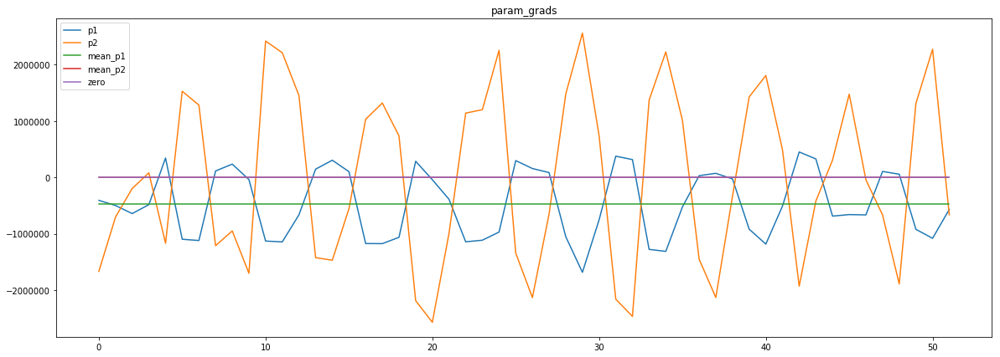

loss rate [-0.016220024625629215]
Epoch [64] 
     train_loss[74893.67478590745] 
     eval_train[77944.96784855769] 
     eval_test[80277.2646484375]



aux preds: 0.4346364438533783 1.0136299133300781
main loss 0.0
aux loss 31866.99676983173
jord loss 37188.333308293266
combined loss 69055.330078125 



Parameter containing:
tensor([[0.4346, 1.0136]], requires_grad=True)


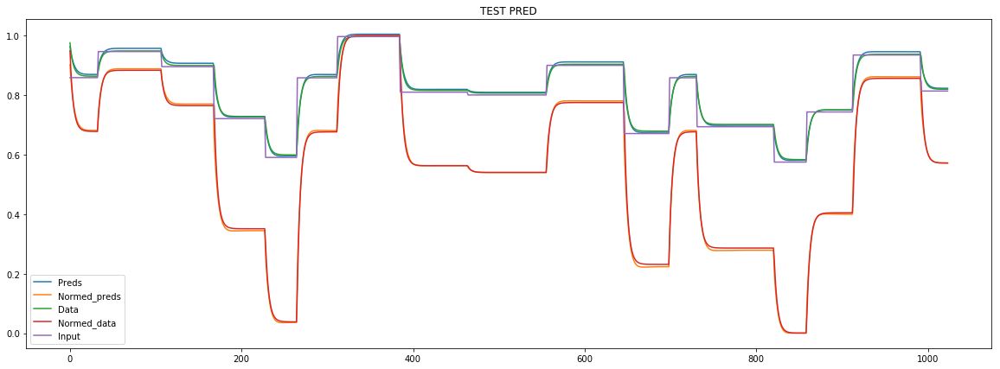

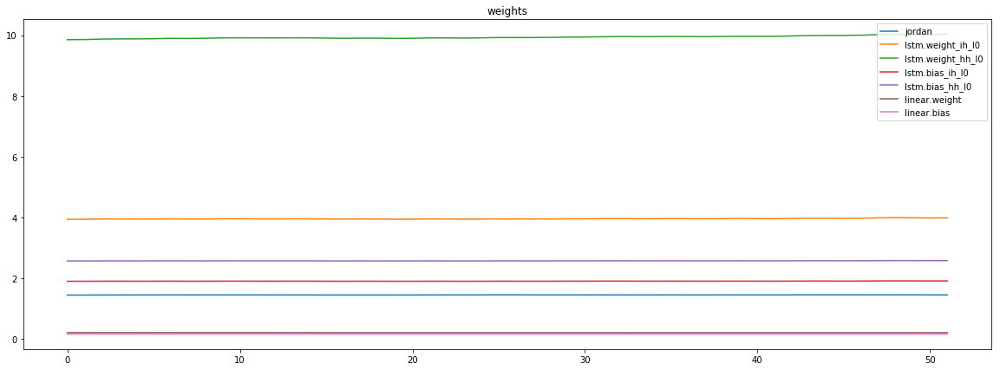

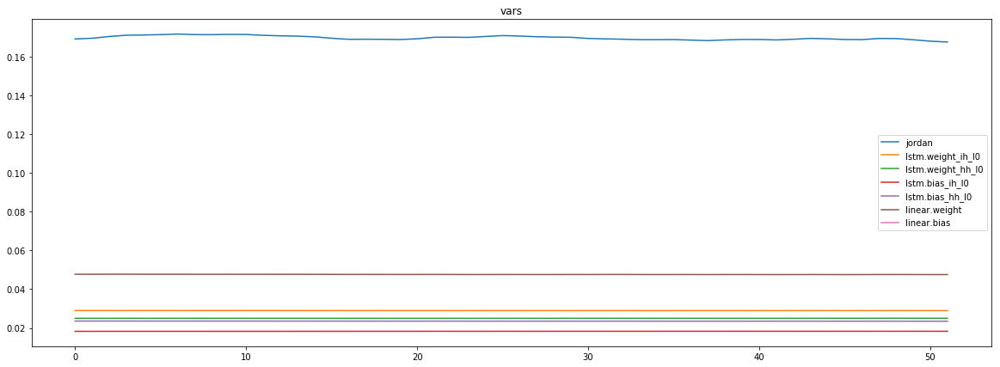

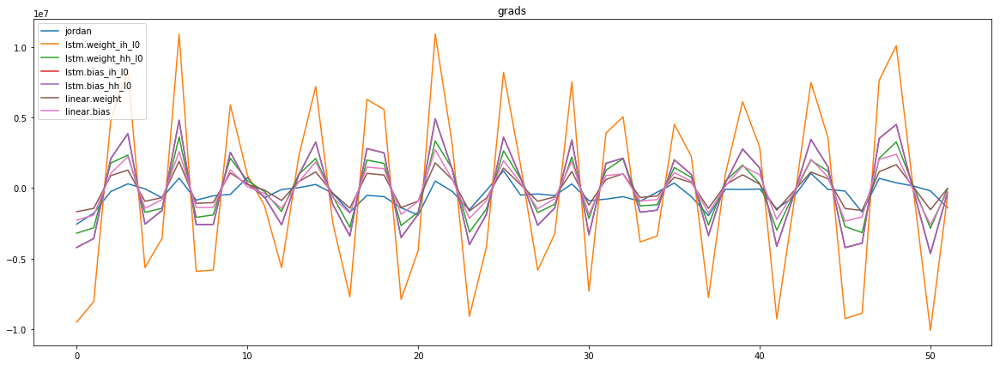

mean_p1 : -417718.11268028844
mean_p2 : -28192.60975060096


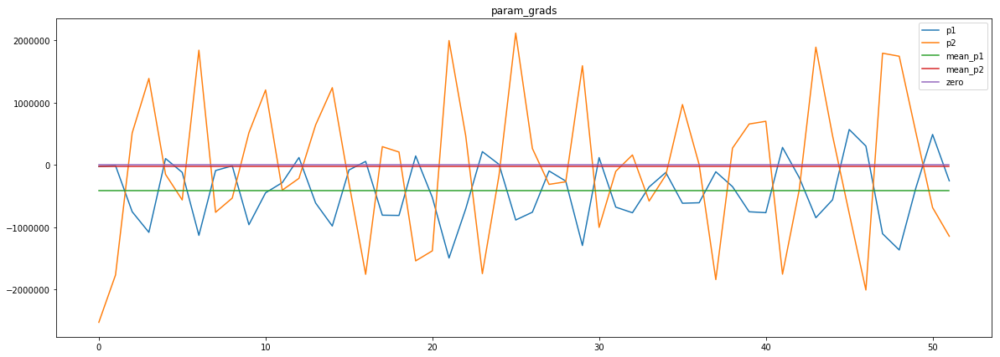

loss rate [0.09877086216379005]
Epoch [65] 
     train_loss[69055.330078125] 
     eval_train[67017.75471379206] 
     eval_test[68854.41672585226]



aux preds: 0.43872925639152527 1.0124608278274536
main loss 0.0
aux loss 35073.432542067305
jord loss 35430.29601111779
combined loss 70503.7285531851 



Parameter containing:
tensor([[0.4387, 1.0125]], requires_grad=True)


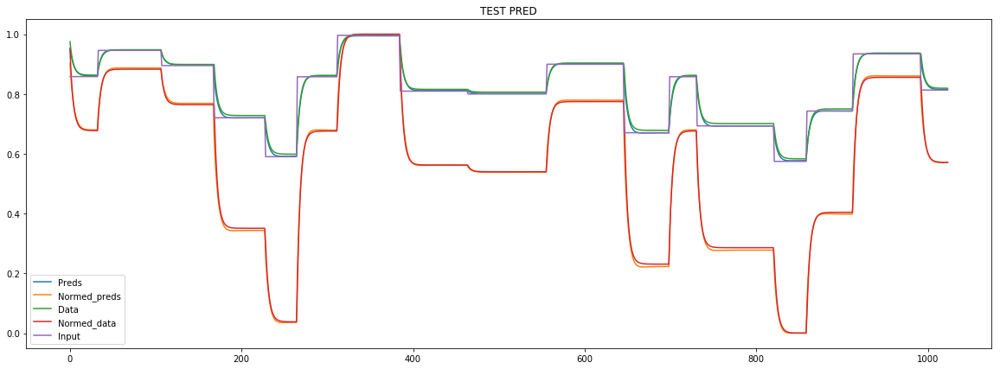

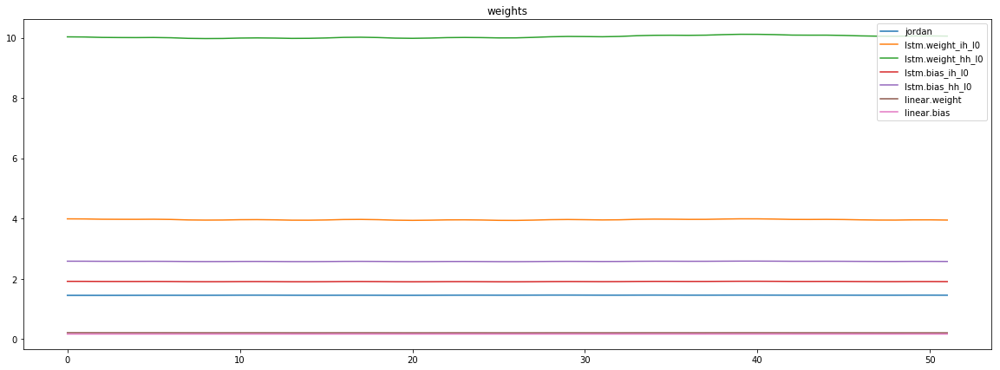

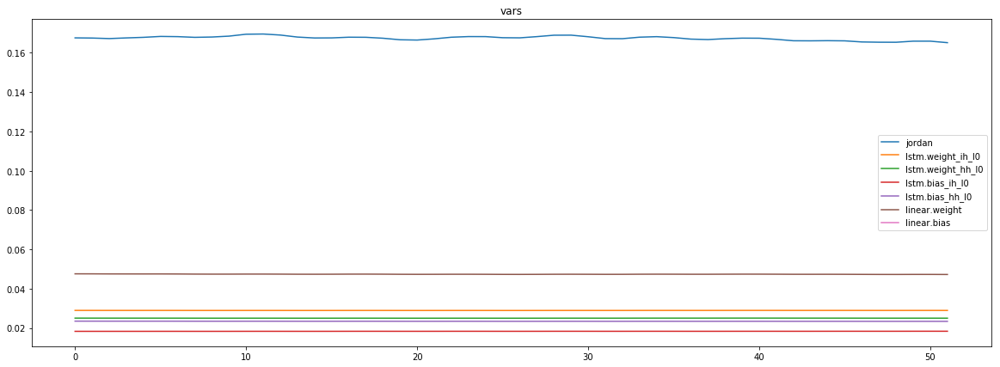

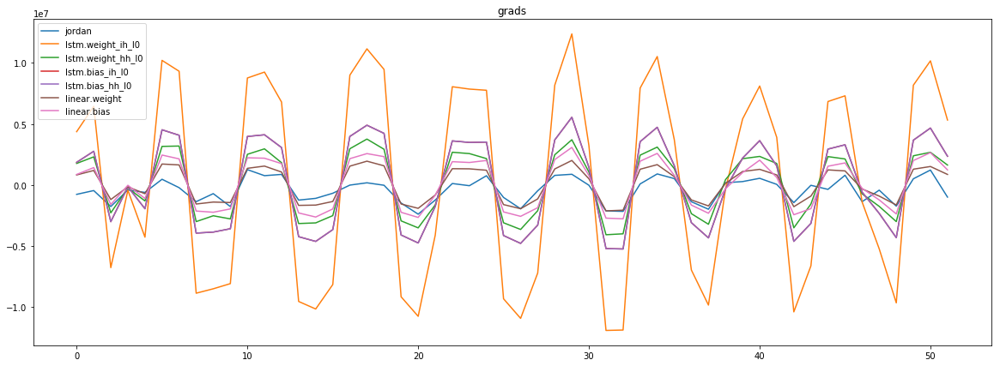

mean_p1 : -463438.93629807694
mean_p2 : 34199.85960036058


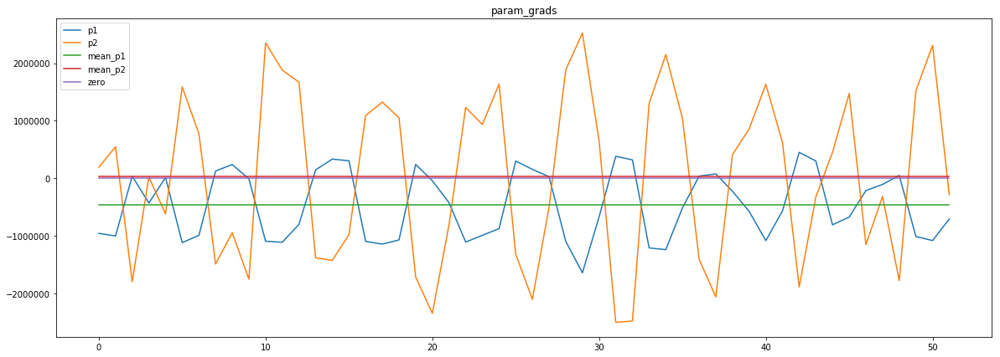

loss rate [-0.06638714086125197]
Epoch [66] 
     train_loss[70503.7285531851] 
     eval_train[76931.85246394231] 
     eval_test[79117.36692116476]



aux preds: 0.4427802860736847 1.0128002166748047
main loss 0.0
aux loss 32245.98884465144
jord loss 33726.88720703125
combined loss 65972.87605168269 



Parameter containing:
tensor([[0.4428, 1.0128]], requires_grad=True)


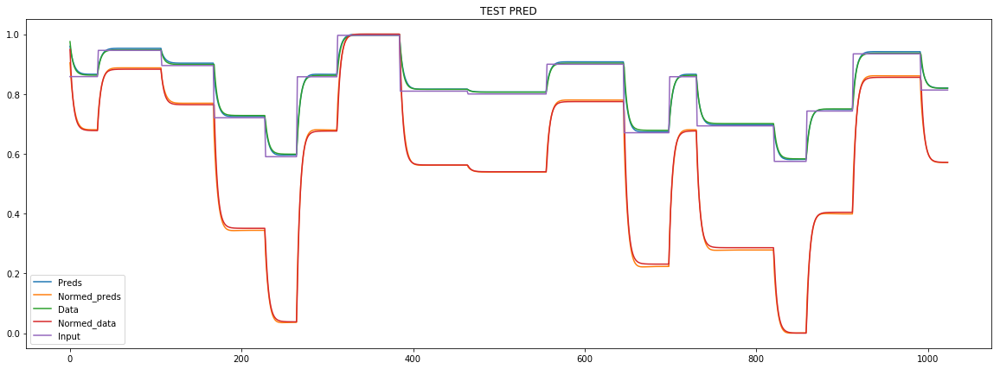

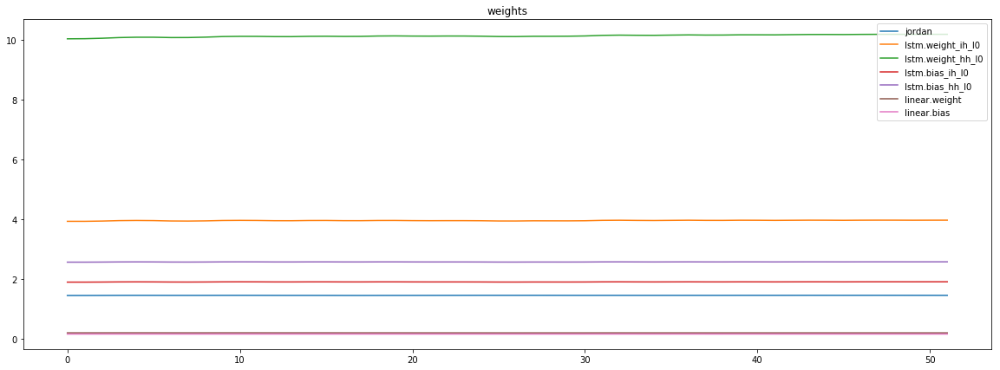

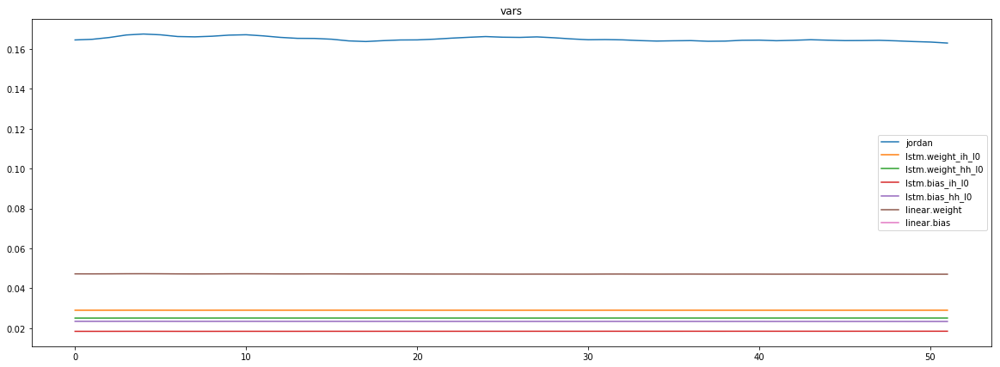

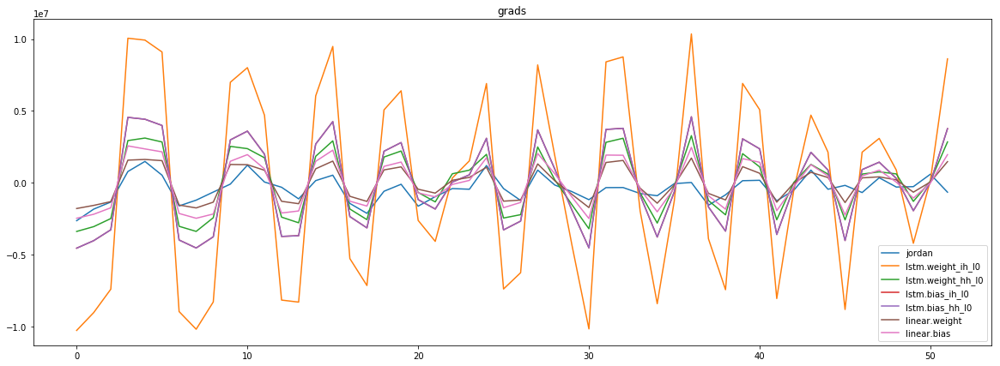

mean_p1 : -411794.2578125
mean_p2 : -3334.836162860577


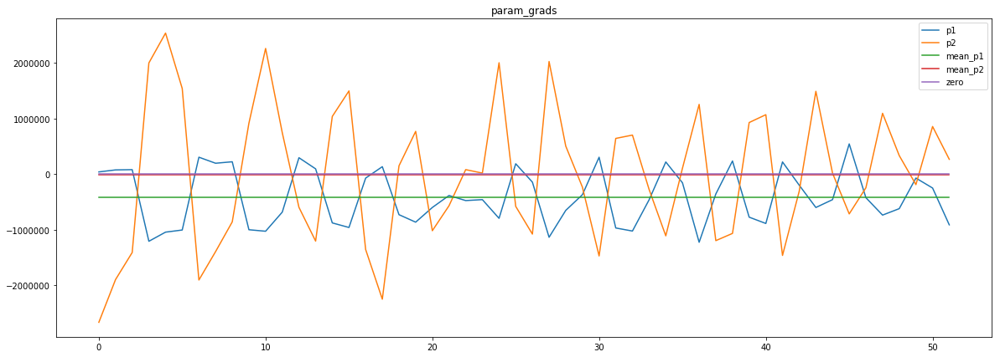

loss rate [0.13217014605320787]
Epoch [67] 
     train_loss[65972.87605168269] 
     eval_train[63912.62075570914] 
     eval_test[66027.11274857954]



aux preds: 0.4467748701572418 1.012712836265564
main loss 0.0
aux loss 31007.054180438703
jord loss 32040.012169471152
combined loss 63047.06634990986 



Parameter containing:
tensor([[0.4468, 1.0127]], requires_grad=True)


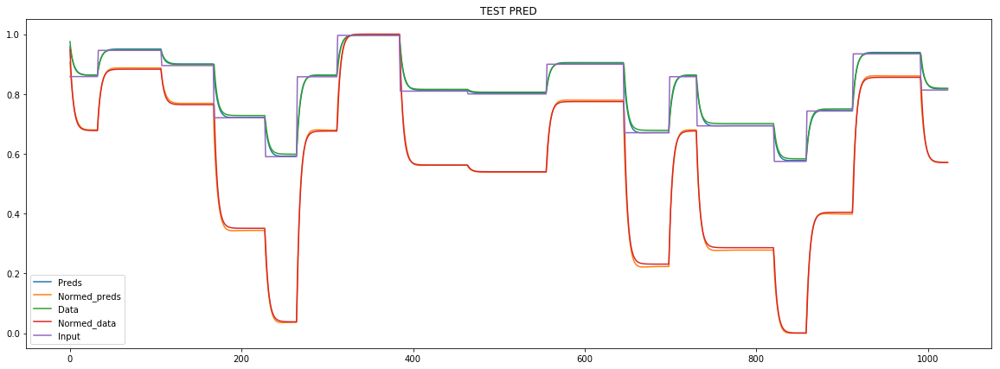

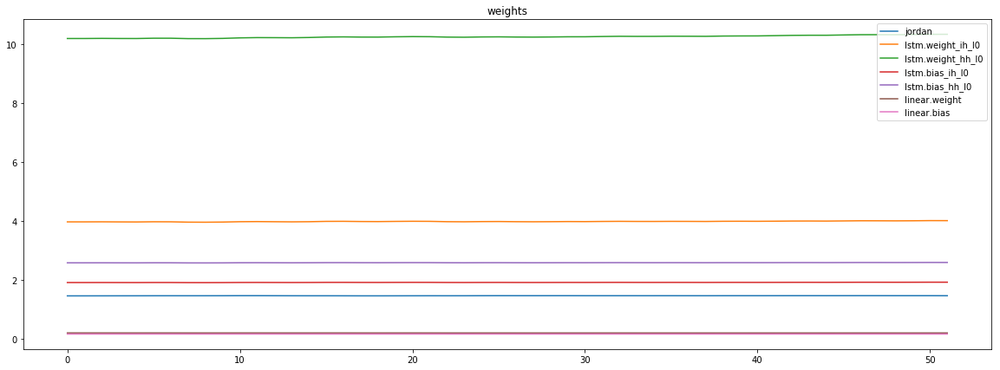

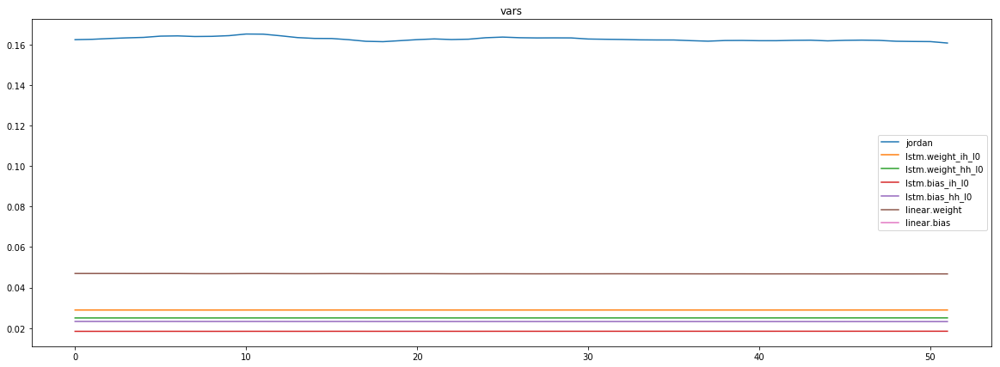

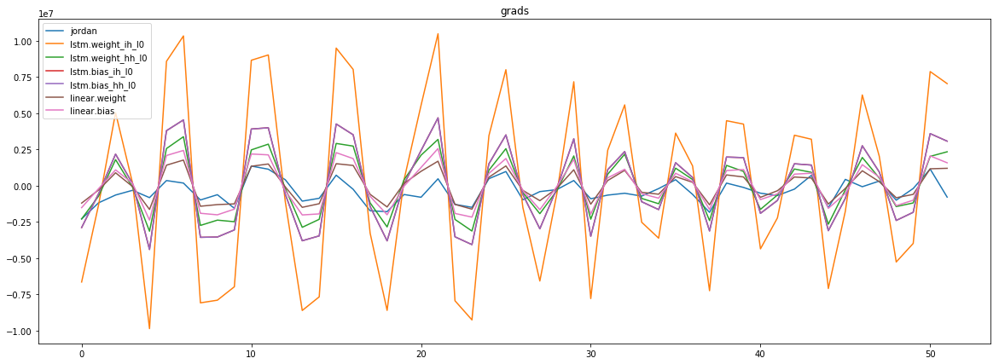

mean_p1 : -410353.51487379806
mean_p2 : 5094.6487379807695


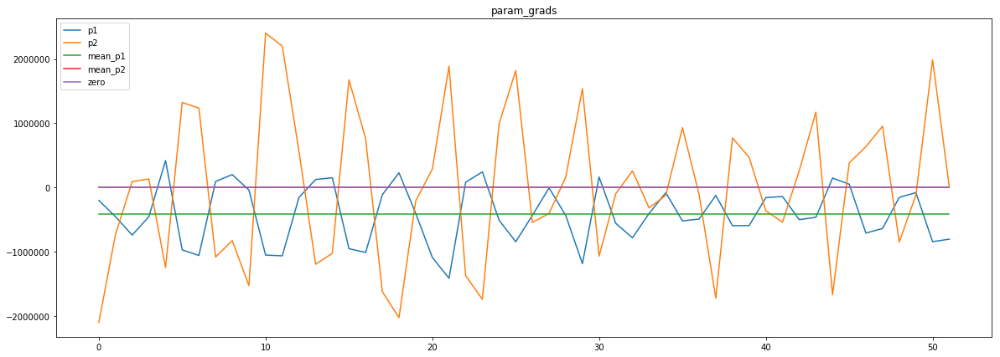

loss rate [0.018288342458309348]
Epoch [68] 
     train_loss[63047.06634990986] 
     eval_train[68038.48232797477] 
     eval_test[70028.40376420454]



aux preds: 0.45074620842933655 1.013043761253357
main loss 0.0
aux loss 30390.21814903846
jord loss 30348.478459284855
combined loss 60738.69660832331 



Parameter containing:
tensor([[0.4507, 1.0130]], requires_grad=True)


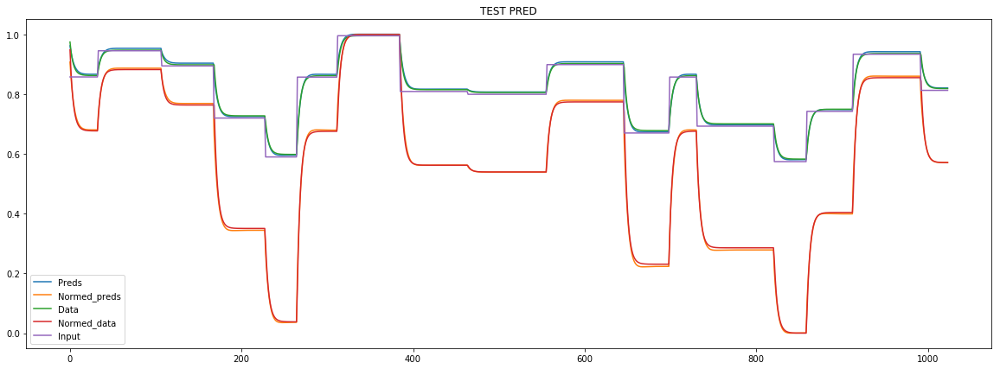

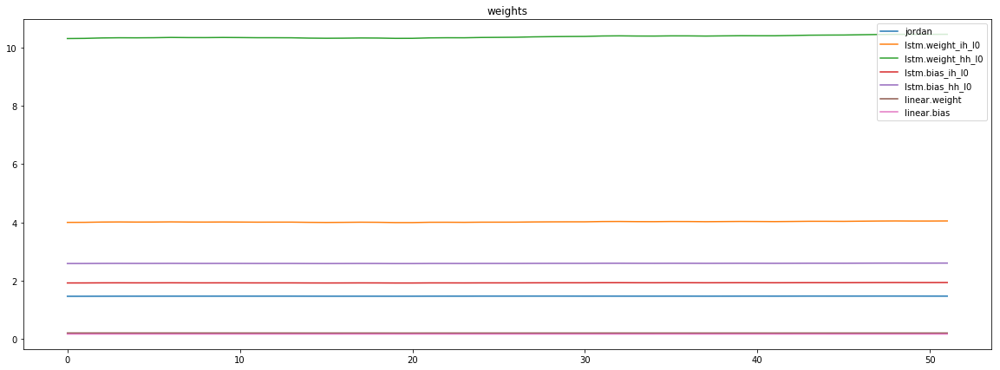

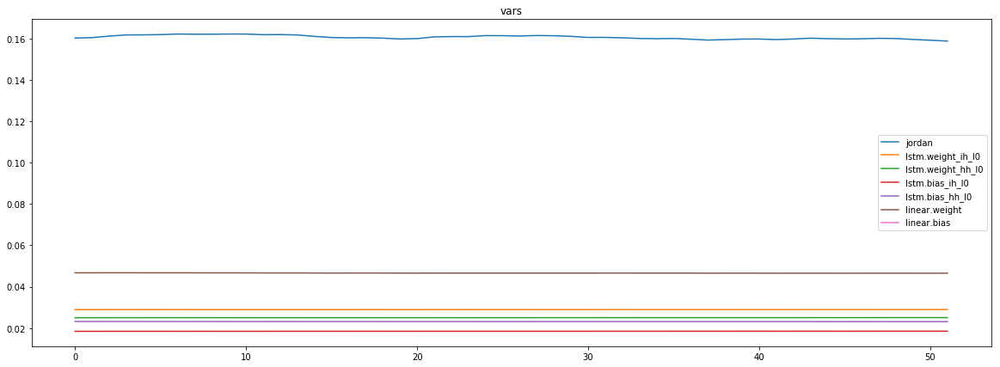

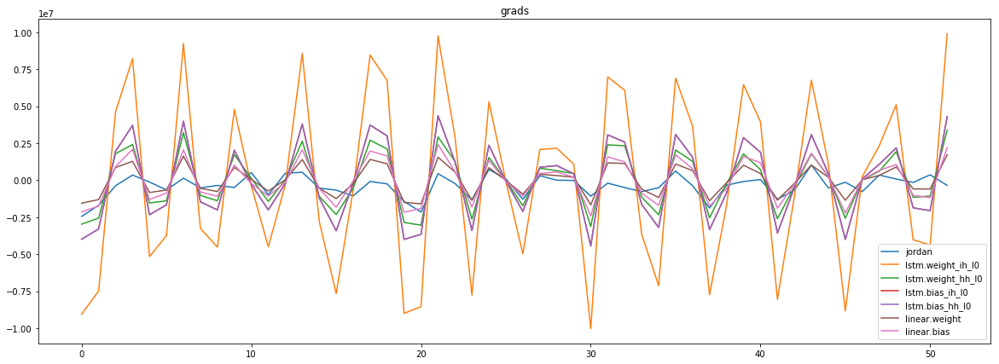

mean_p1 : -387172.56370192306
mean_p2 : -4968.899038461538


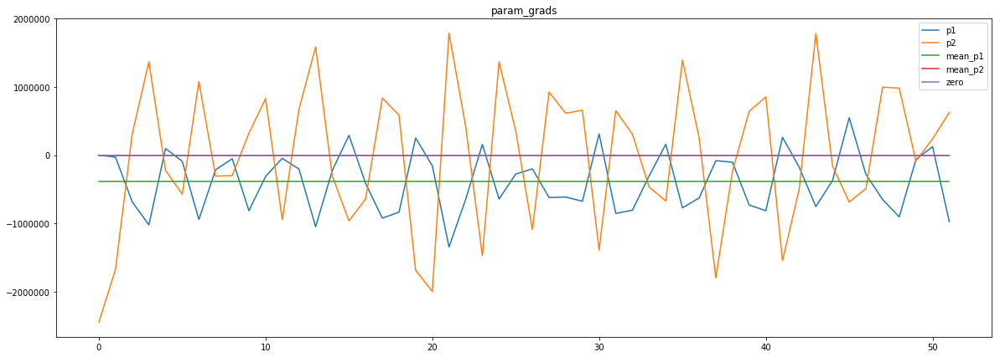

loss rate [0.15576456480941026]
Epoch [69] 
     train_loss[60738.69660832331] 
     eval_train[58625.064265324516] 
     eval_test[60552.190962357956]



aux preds: 0.45472320914268494 1.0133906602859497
main loss 0.0
aux loss 29999.829270582934
jord loss 28795.36902794471
combined loss 58795.19829852764 



Parameter containing:
tensor([[0.4547, 1.0134]], requires_grad=True)


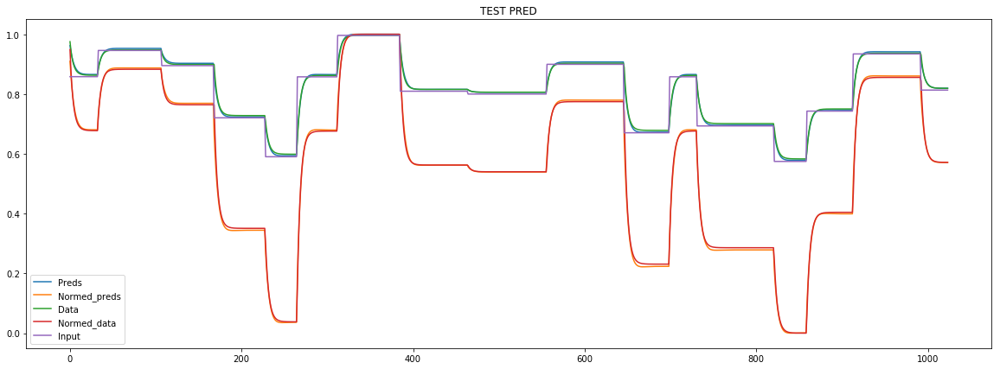

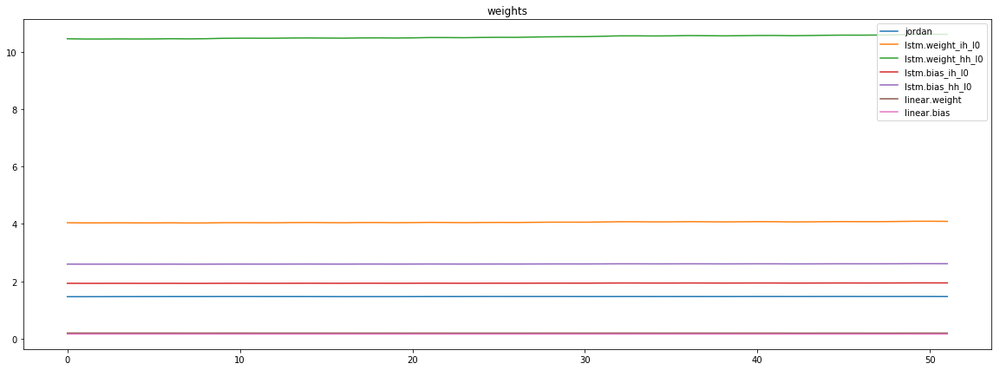

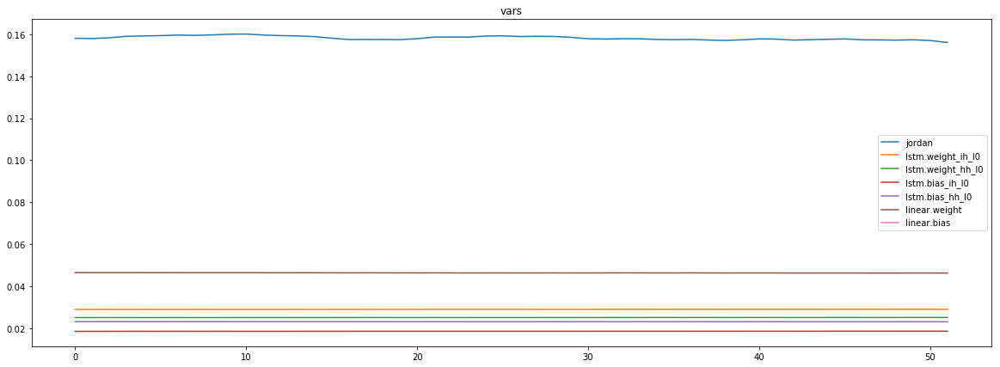

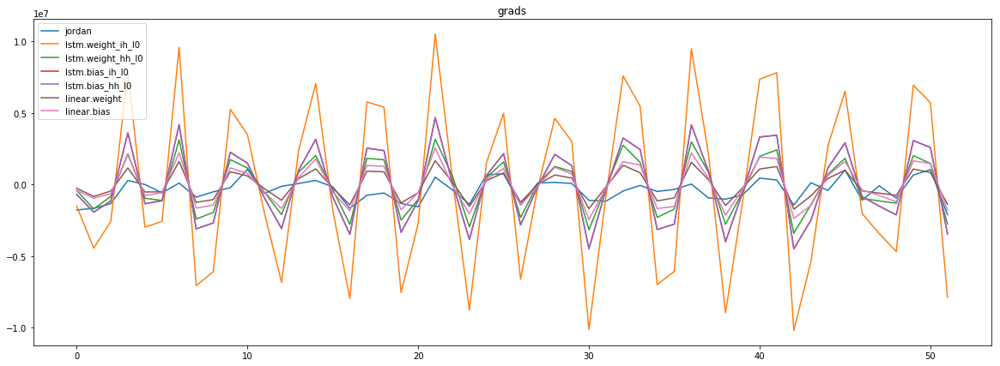

mean_p1 : -376645.5525841346
mean_p2 : -29502.374549278848


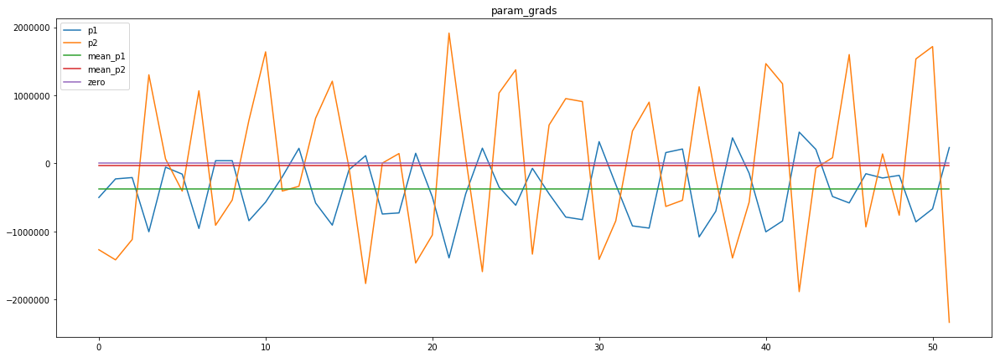

loss rate [0.08047266717997392]
Epoch [70] 
     train_loss[58795.19829852764] 
     eval_train[58354.31319486178] 
     eval_test[60262.05362215909]



aux preds: 0.4587600827217102 1.0129222869873047
main loss 0.0
aux loss 31302.34716796875
jord loss 27178.160700871395
combined loss 58480.50786884014 



Parameter containing:
tensor([[0.4588, 1.0129]], requires_grad=True)


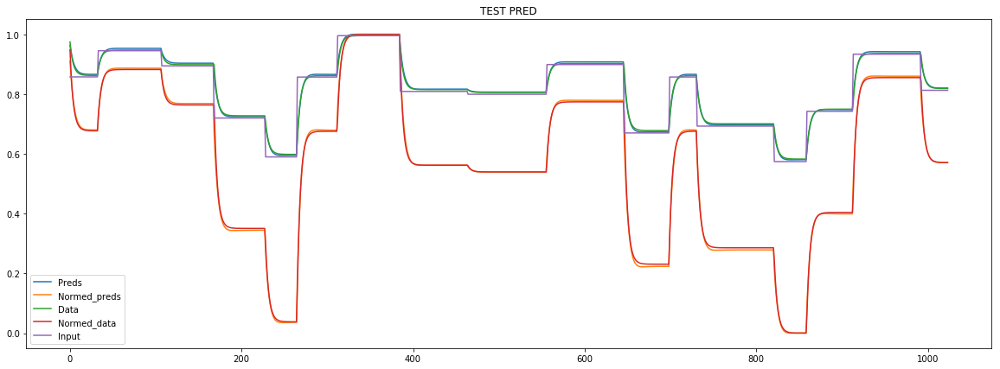

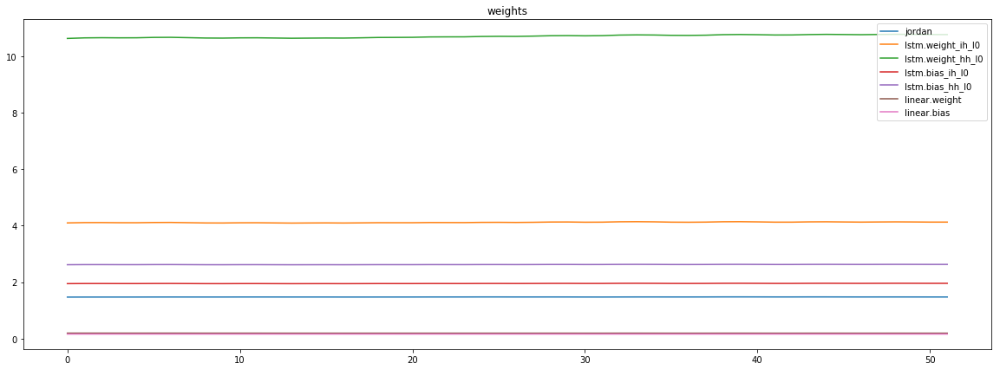

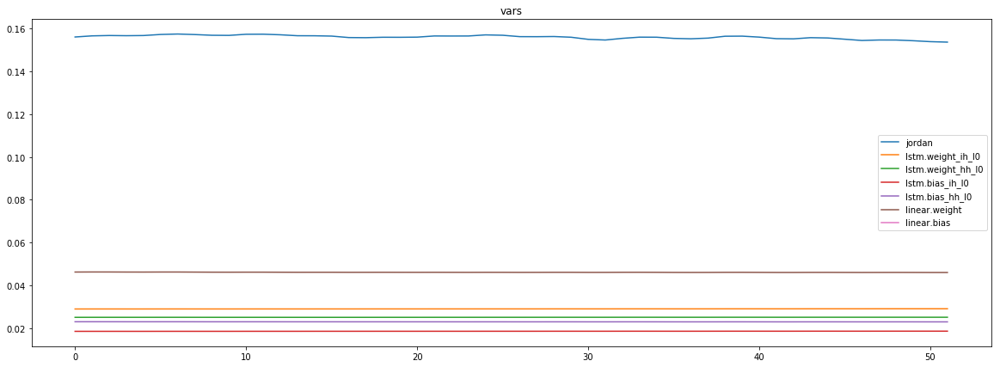

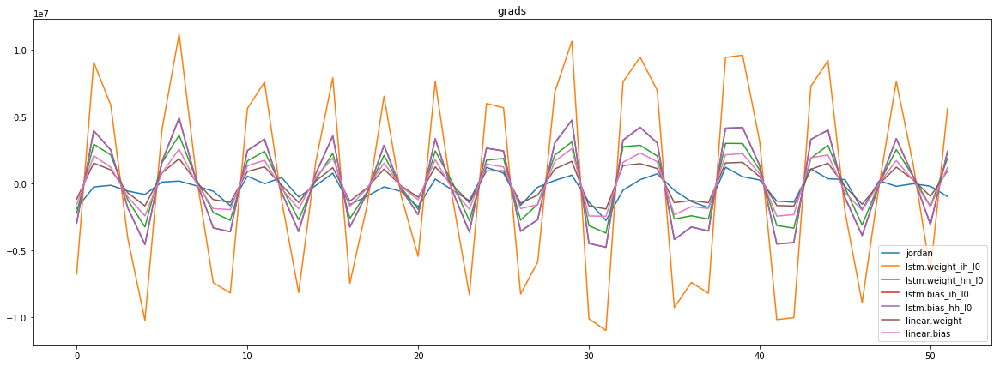

mean_p1 : -383977.41075721156
mean_p2 : 4624.931490384615


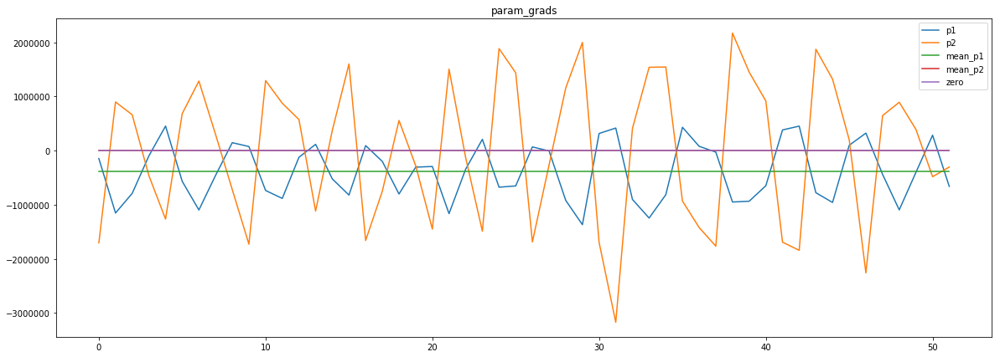

loss rate [0.10244733235935821]
Epoch [71] 
     train_loss[58480.50786884014] 
     eval_train[55234.662353515625] 
     eval_test[57097.109375]



aux preds: 0.46271243691444397 1.012766718864441
main loss 0.0
aux loss 29043.844820462742
jord loss 25765.95361328125
combined loss 54809.79843374399 



Parameter containing:
tensor([[0.4627, 1.0128]], requires_grad=True)


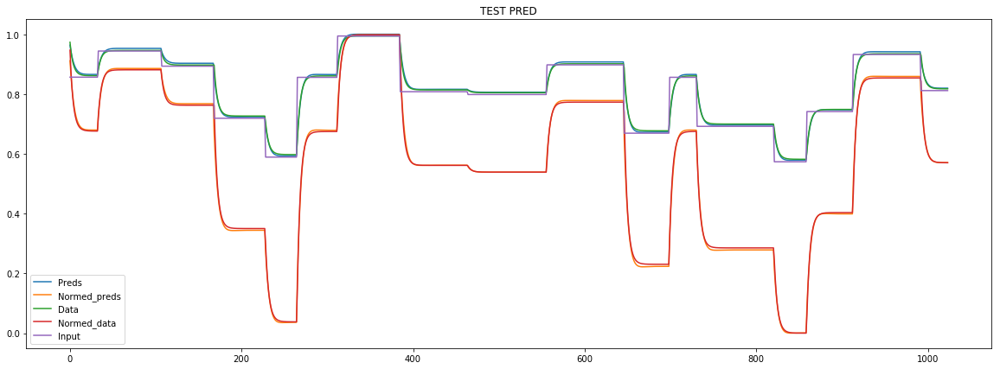

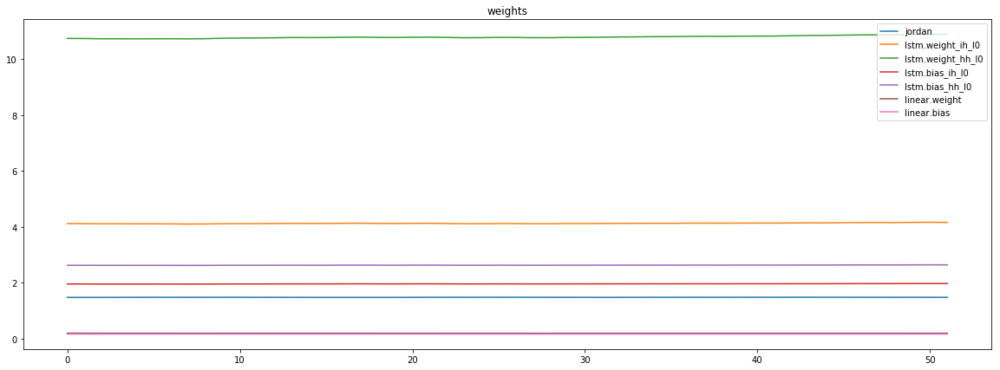

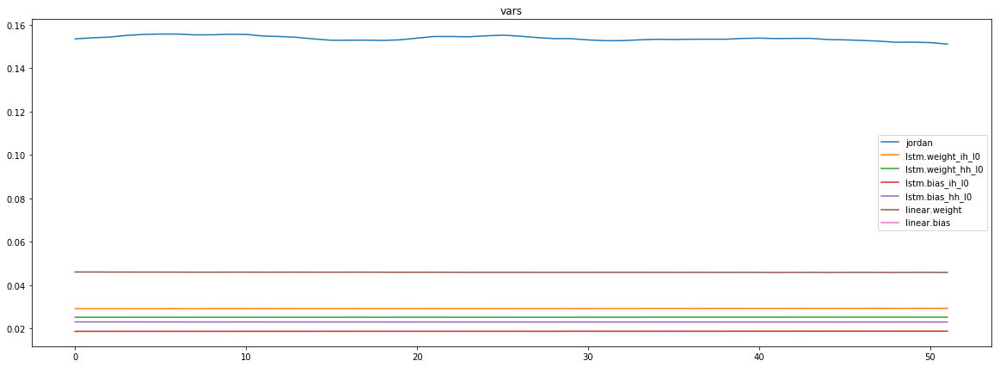

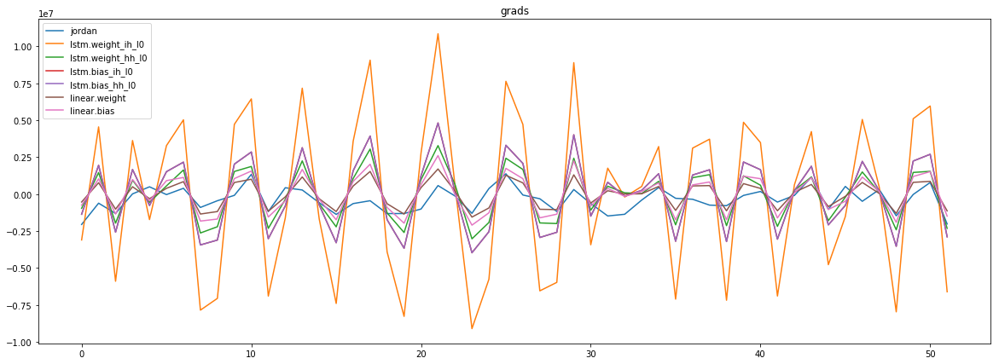

mean_p1 : -355119.0799278846
mean_p2 : -11878.81610576923


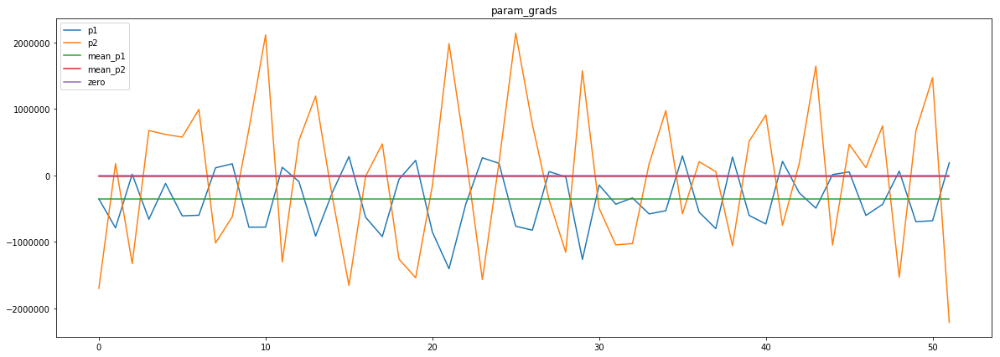

loss rate [0.06659476170923351]
Epoch [72] 
     train_loss[54809.79843374399] 
     eval_train[53625.960092397836] 
     eval_test[55354.46324573863]



aux preds: 0.46664419770240784 1.0123023986816406
main loss 0.0
aux loss 29897.302208533652
jord loss 24338.95635516827
combined loss 54236.25856370192 



Parameter containing:
tensor([[0.4666, 1.0123]], requires_grad=True)


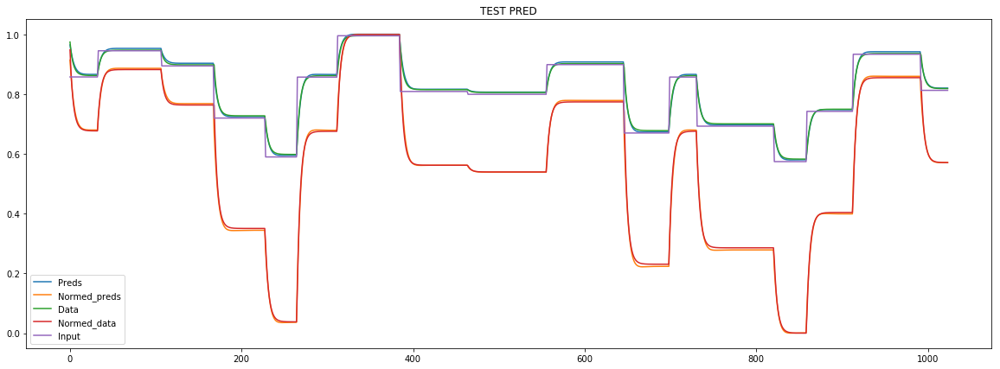

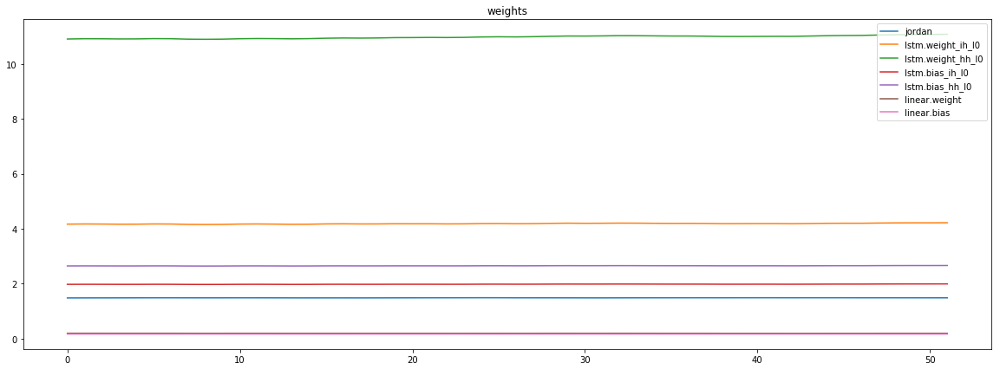

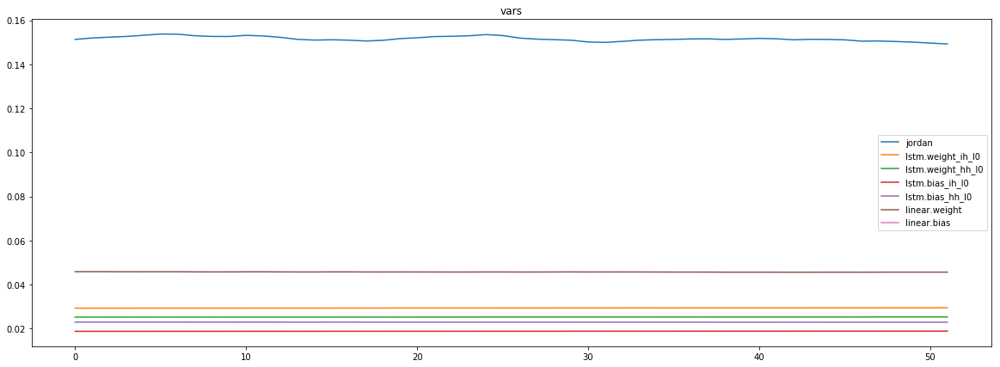

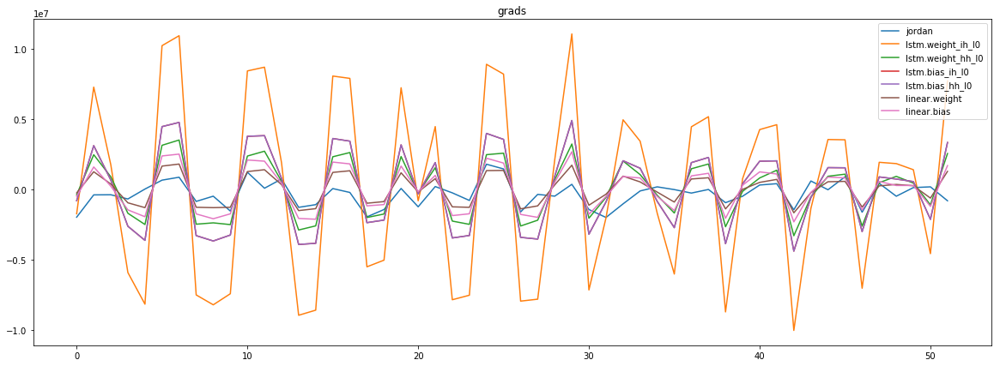

mean_p1 : -355300.6879507211
mean_p2 : 26199.692533052883


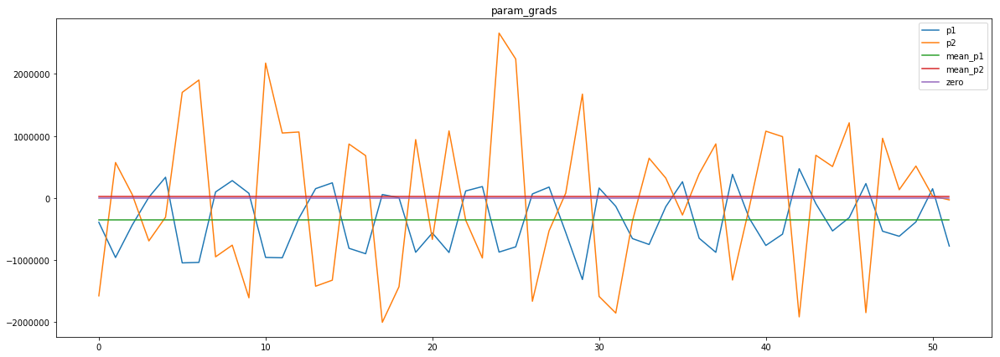

loss rate [0.053398898107639536]
Epoch [73] 
     train_loss[54236.25856370192] 
     eval_train[52698.000882662265] 
     eval_test[54496.96963778409]



aux preds: 0.4704640507698059 1.0132976770401
main loss 0.0
aux loss 29002.011455829328
jord loss 23032.144474909855
combined loss 52034.15593073919 



Parameter containing:
tensor([[0.4705, 1.0133]], requires_grad=True)


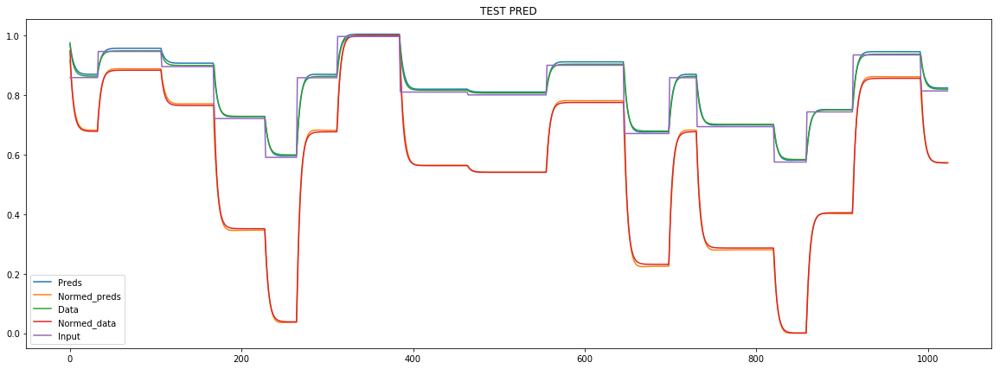

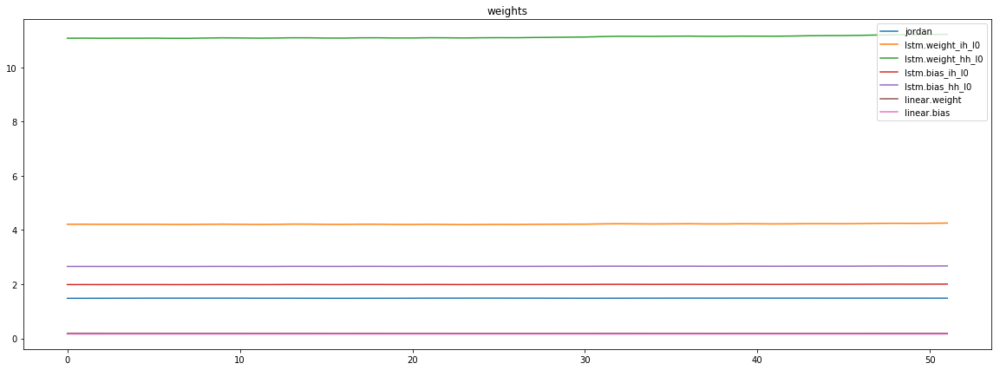

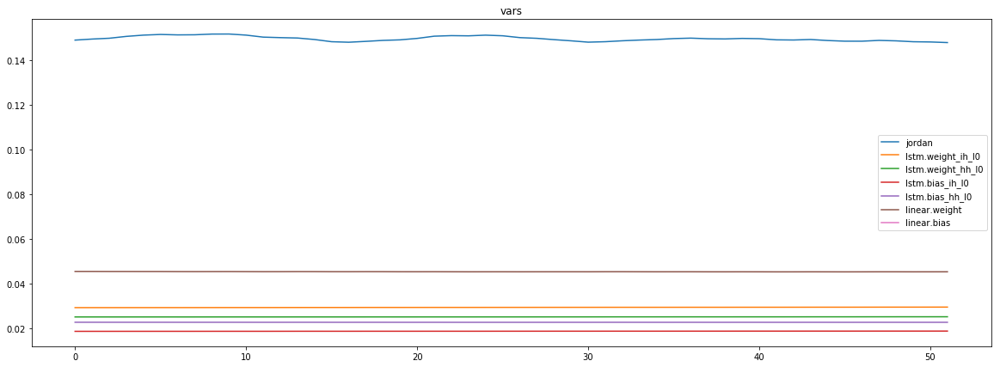

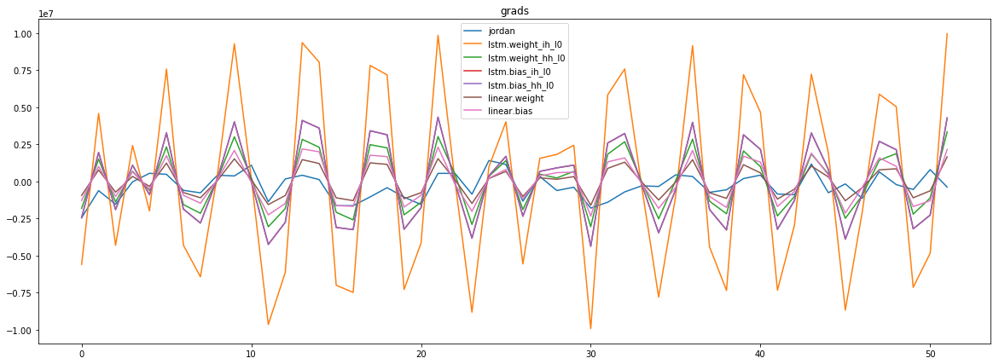

mean_p1 : -327793.54717548075
mean_p2 : 1083.214092548077


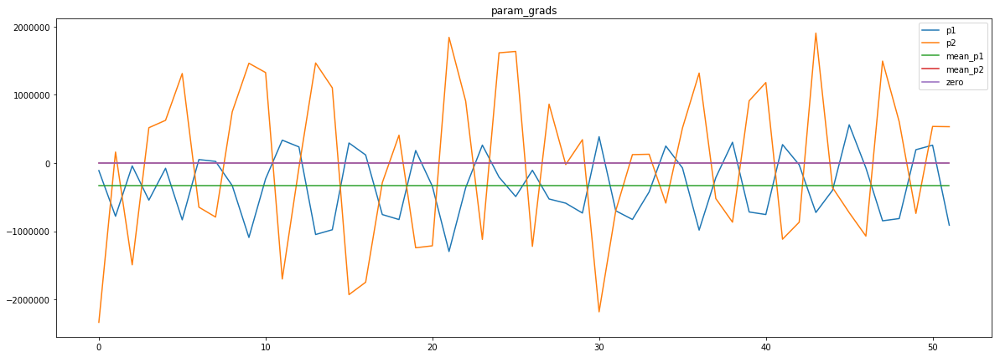

loss rate [0.0725229796636161]
Epoch [74] 
     train_loss[52034.15593073919] 
     eval_train[50274.50563401442] 
     eval_test[51613.6455078125]



aux preds: 0.4740699529647827 1.0131012201309204
main loss 0.0
aux loss 29109.88142277644
jord loss 21897.043926532453
combined loss 51006.92534930889 



Parameter containing:
tensor([[0.4741, 1.0131]], requires_grad=True)


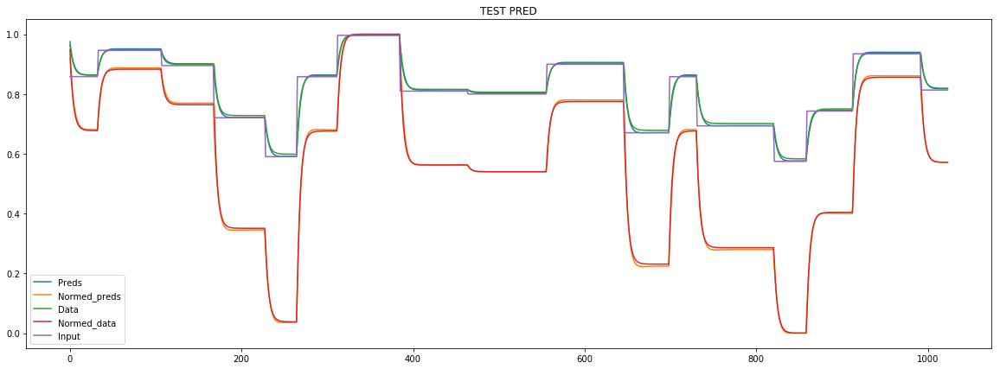

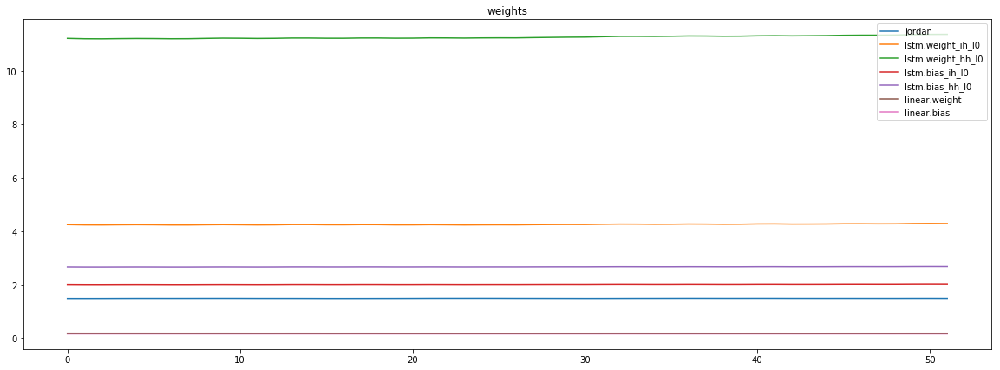

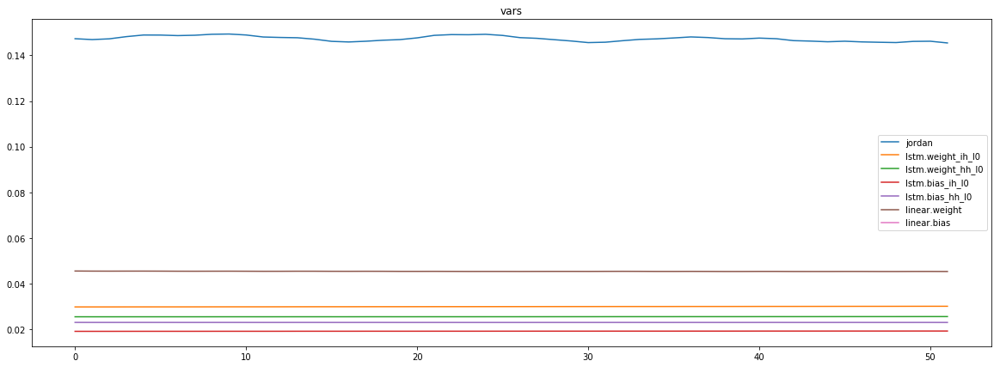

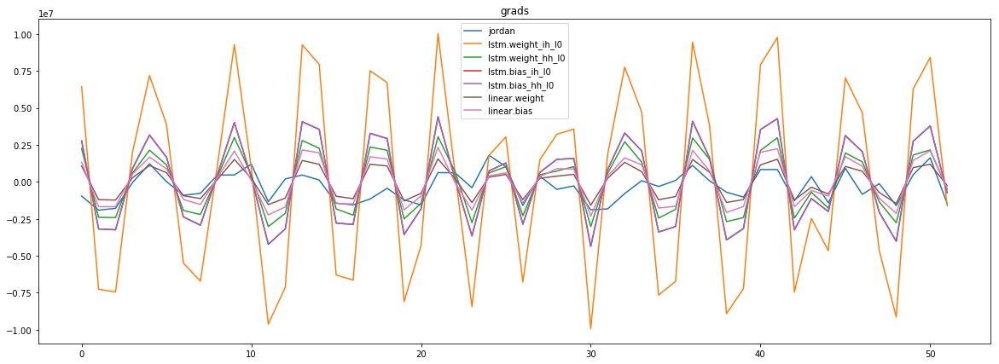

mean_p1 : -301913.17908653844
mean_p2 : -11549.94501201923


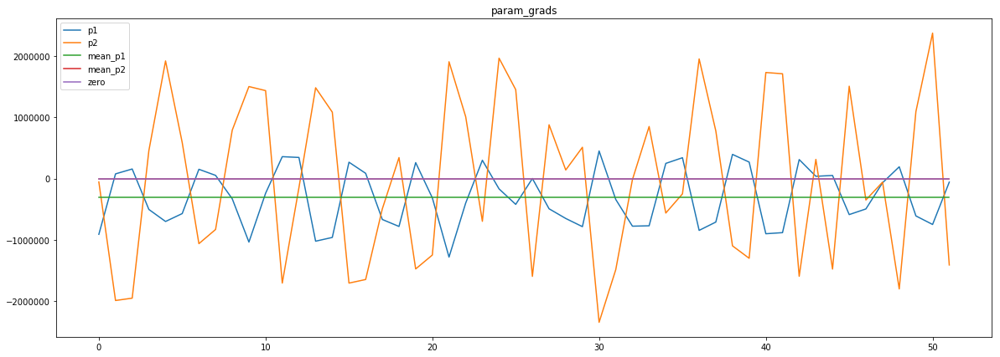

loss rate [-0.037958156568059565]
Epoch [75] 
     train_loss[51006.92534930889] 
     eval_train[54164.00813176082] 
     eval_test[55864.6650390625]



aux preds: 0.47705456614494324 1.0140960216522217
main loss 0.0
aux loss 31124.887413611777
jord loss 20825.641094501203
combined loss 51950.528508112984 



Parameter containing:
tensor([[0.4771, 1.0141]], requires_grad=True)


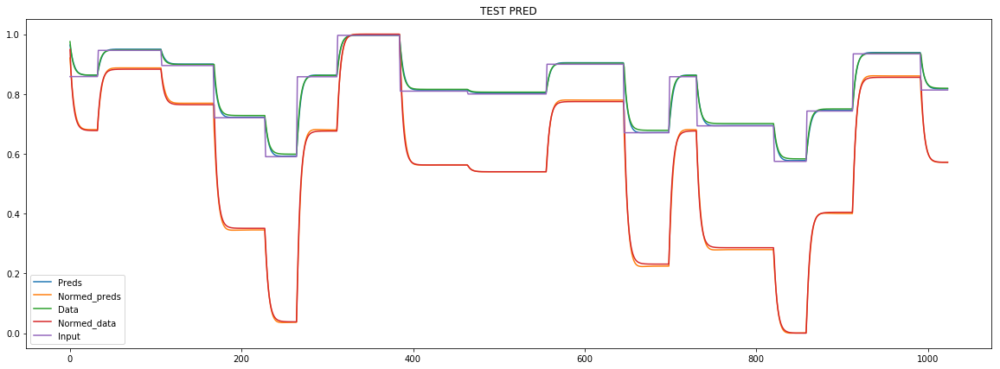

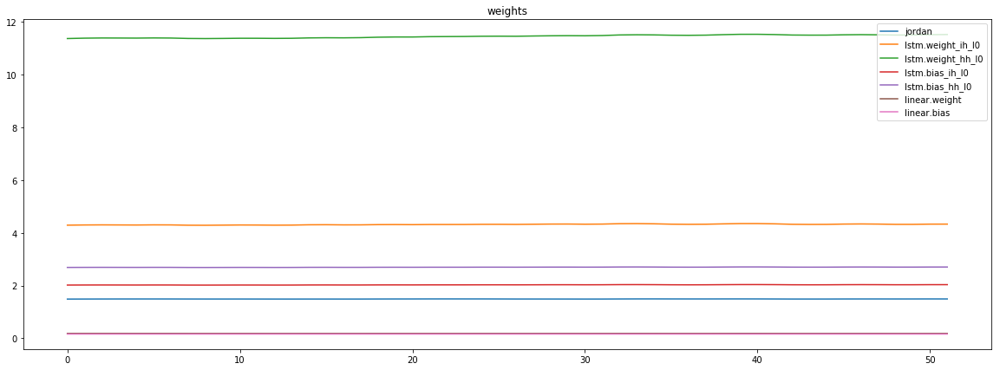

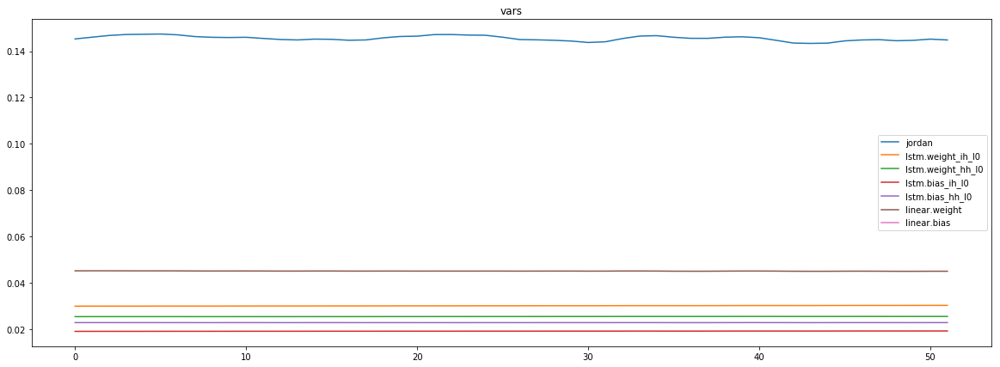

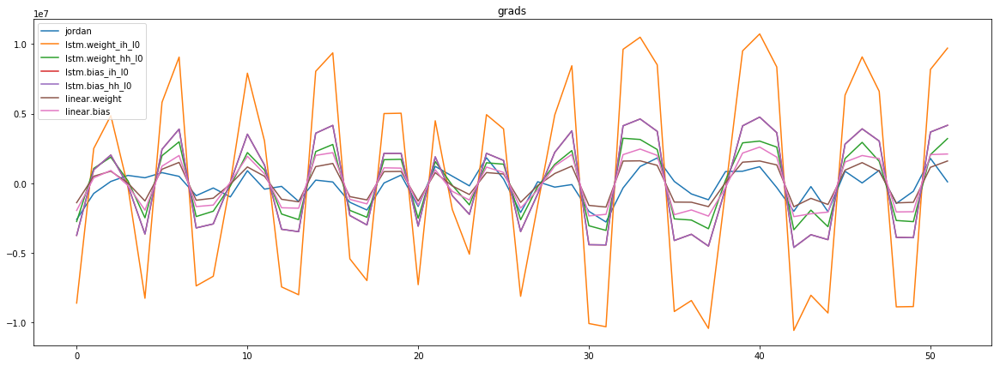

mean_p1 : -238857.27073317306
mean_p2 : 18514.921724759617


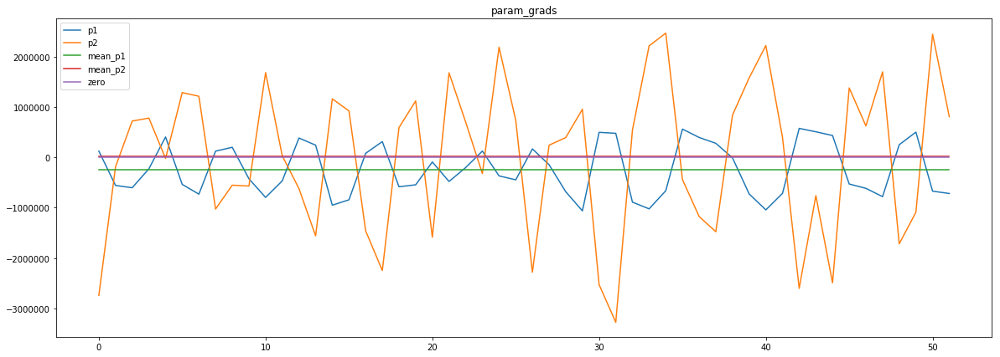

loss rate [0.017732977913522352]
Epoch [76] 
     train_loss[51950.528508112984] 
     eval_train[51345.162691556485] 
     eval_test[53034.325372869316]



aux preds: 0.4791239798069 1.0143998861312866
main loss 0.0
aux loss 31855.92431640625
jord loss 20122.831993689902
combined loss 51978.756310096156 



Parameter containing:
tensor([[0.4791, 1.0144]], requires_grad=True)


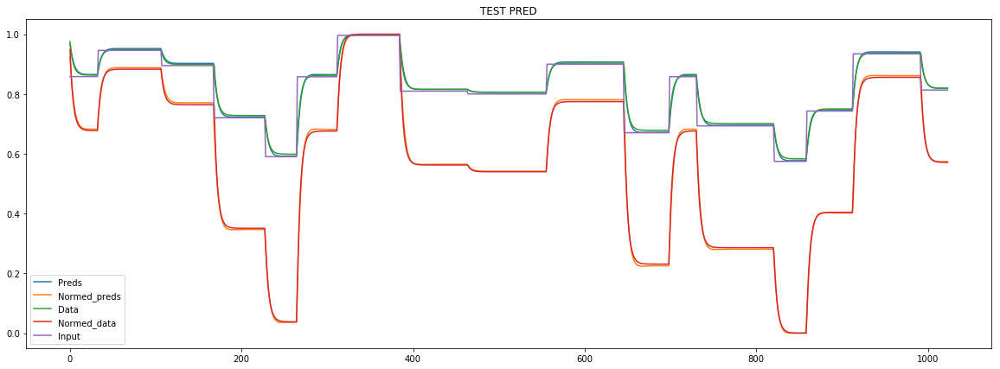

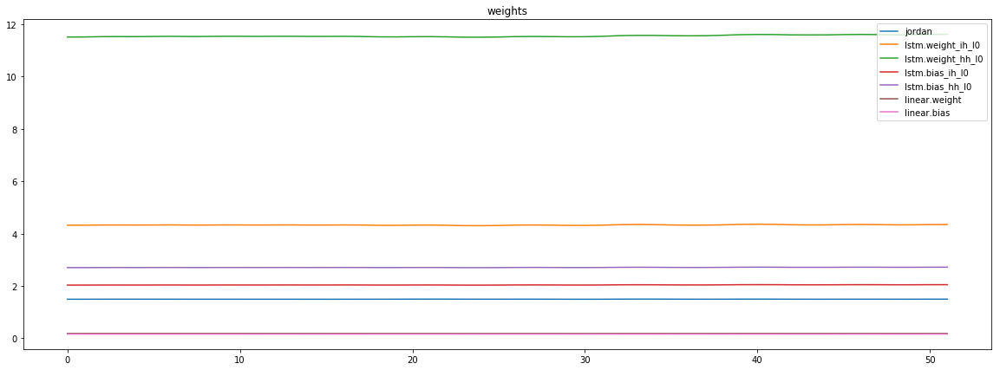

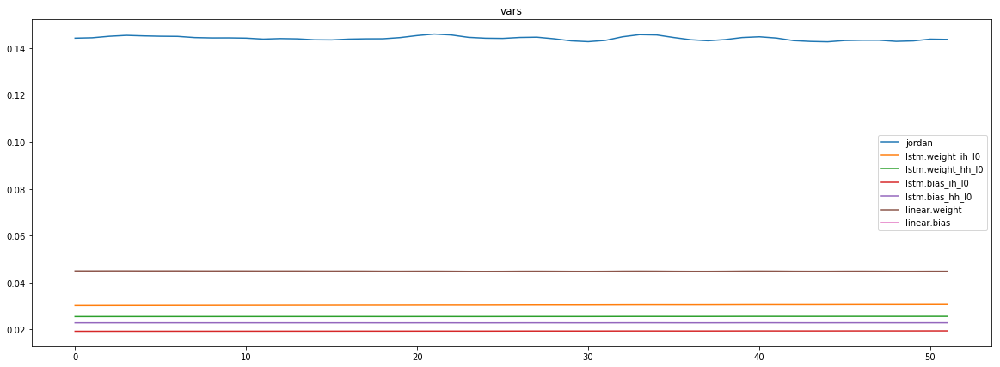

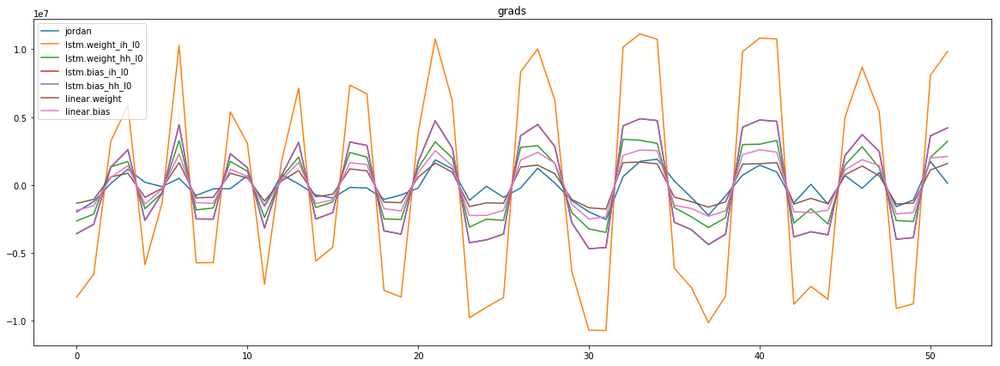

mean_p1 : -153347.02268629806
mean_p2 : -11475.774639423076


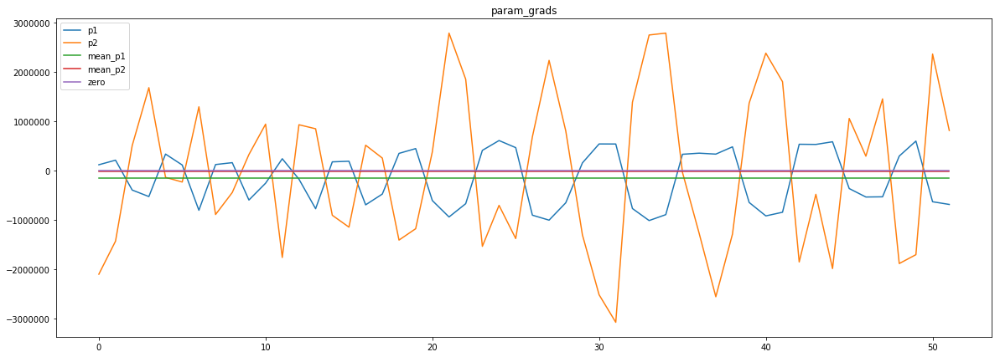

loss rate [0.07769453847321317]
Epoch [77] 
     train_loss[51978.756310096156] 
     eval_train[47659.42063551683] 
     eval_test[49347.22691761363]



aux preds: 0.4803071618080139 1.0130949020385742
main loss 0.0
aux loss 27498.660682091348
jord loss 19850.53064903846
combined loss 47349.19133112981 



Parameter containing:
tensor([[0.4803, 1.0131]], requires_grad=True)


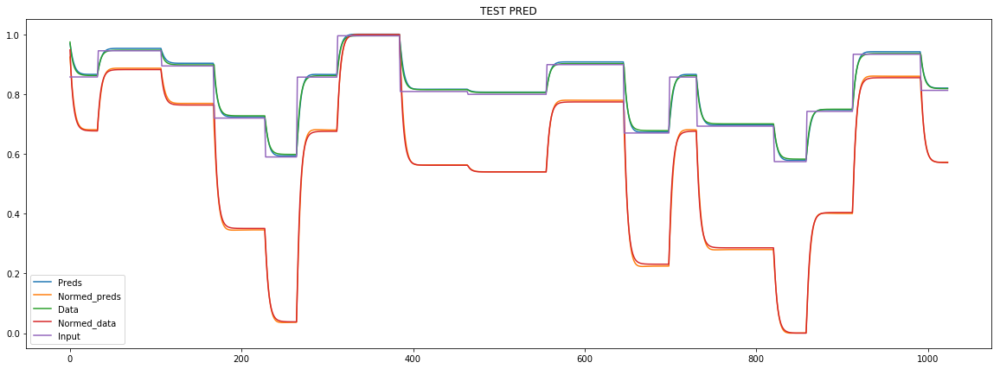

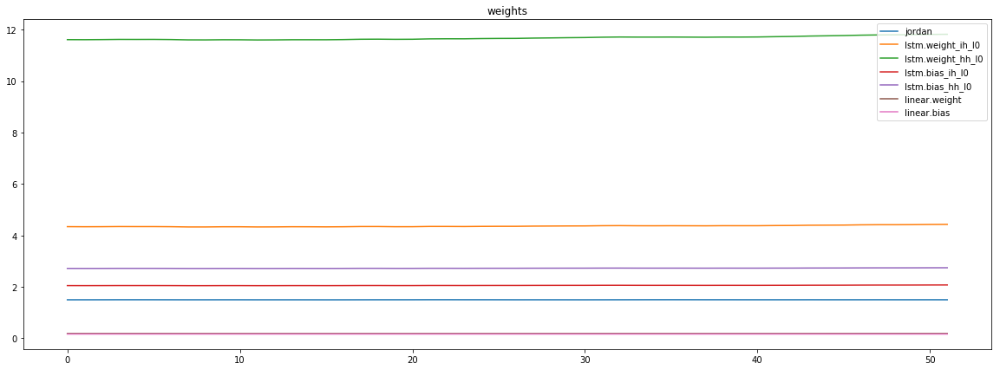

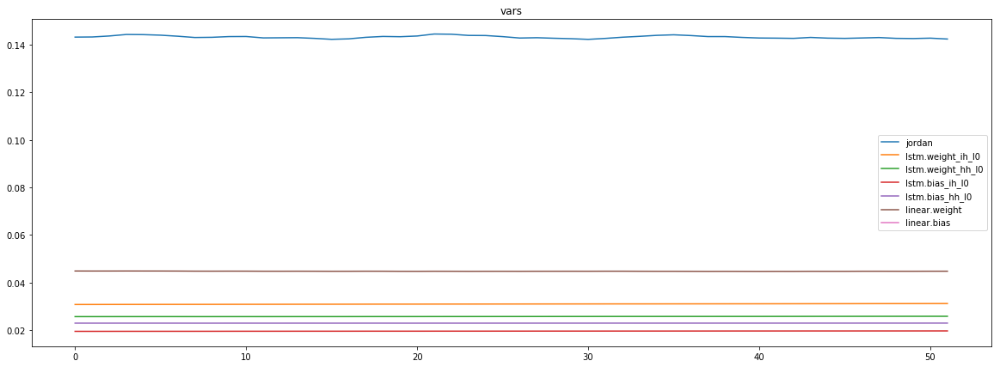

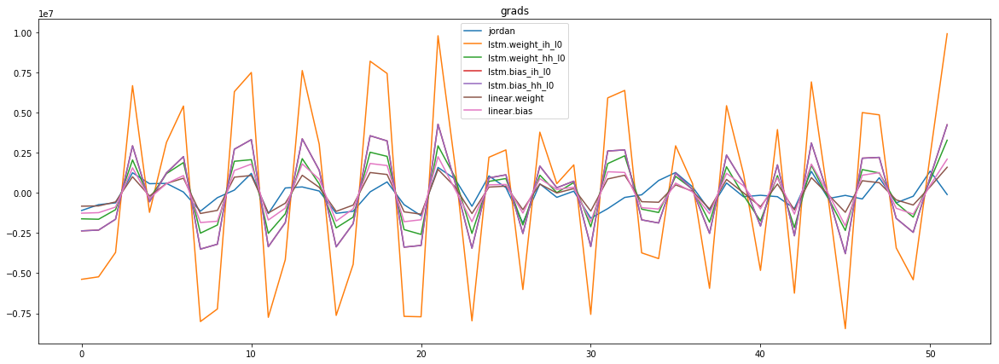

mean_p1 : -80597.06603064903
mean_p2 : 10615.851938100961


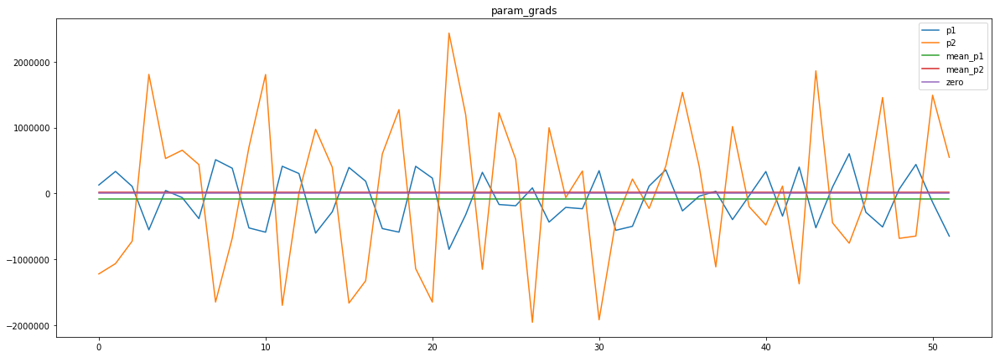

loss rate [0.08236897685610878]
Epoch [78] 
     train_loss[47349.19133112981] 
     eval_train[46773.83717698317] 
     eval_test[48403.879438920456]



aux preds: 0.4811904728412628 1.012751817703247
main loss 0.0
aux loss 27159.572998046875
jord loss 20128.382962740383
combined loss 47287.95596078726 



Parameter containing:
tensor([[0.4812, 1.0128]], requires_grad=True)


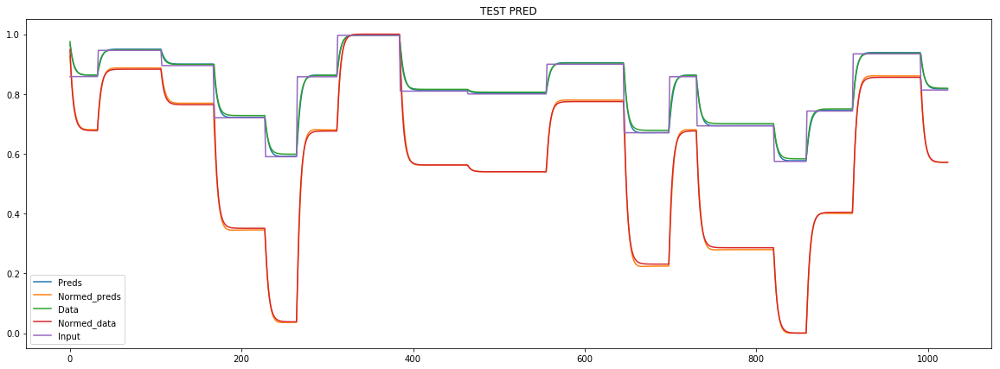

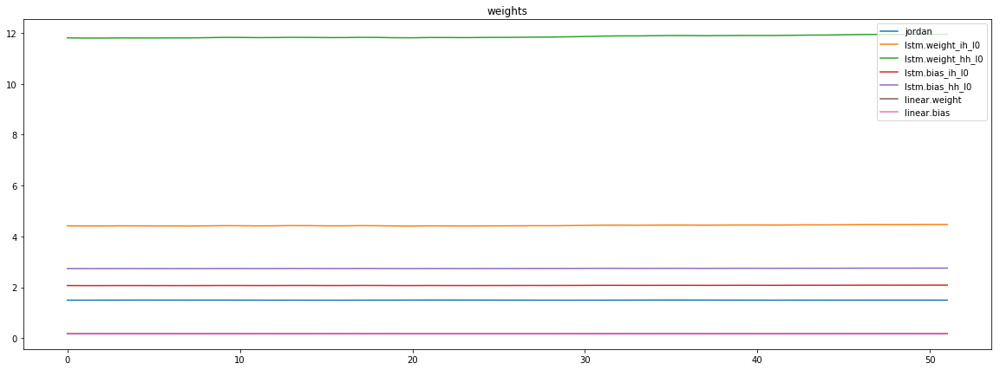

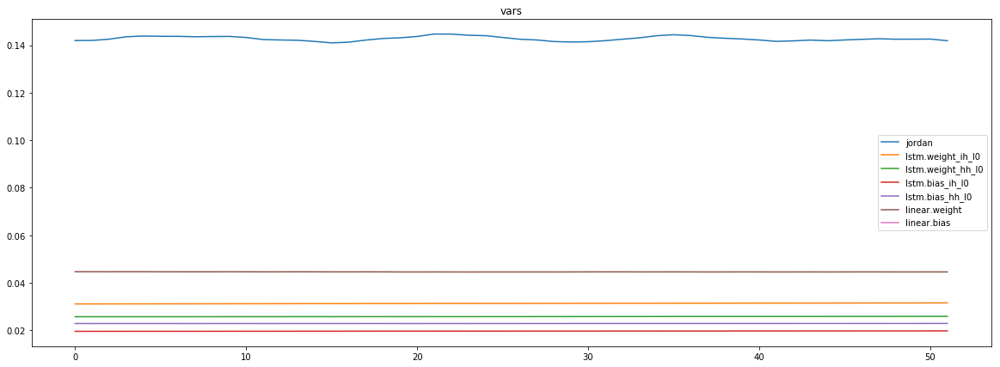

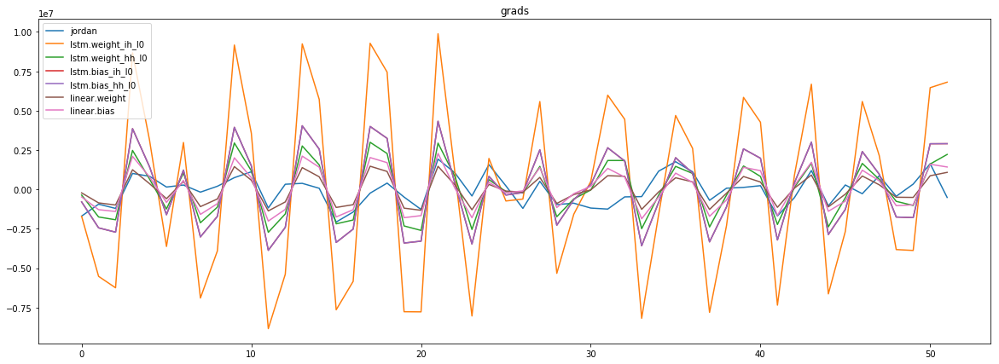

mean_p1 : -65336.69373497596
mean_p2 : 3935.155498798077


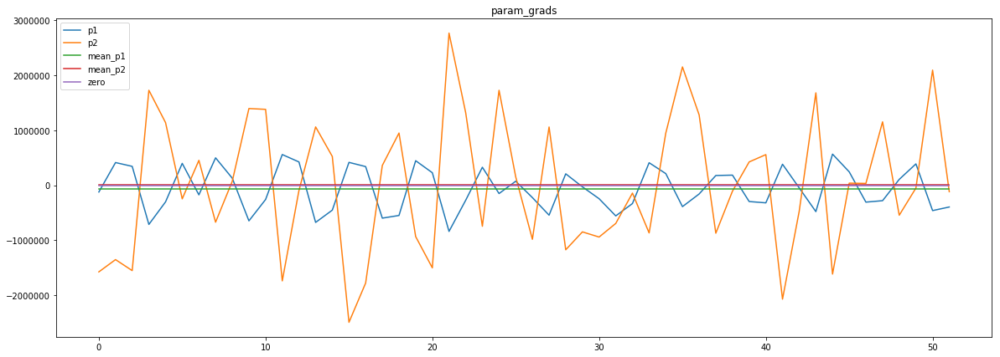

loss rate [-0.08843273436935539]
Epoch [79] 
     train_loss[47287.95596078726] 
     eval_train[53050.928091195914] 
     eval_test[54706.59992009943]



aux preds: 0.4818829894065857 1.0130174160003662
main loss 0.0
aux loss 26985.137225811297
jord loss 19974.66935847356
combined loss 46959.80658428486 



Parameter containing:
tensor([[0.4819, 1.0130]], requires_grad=True)


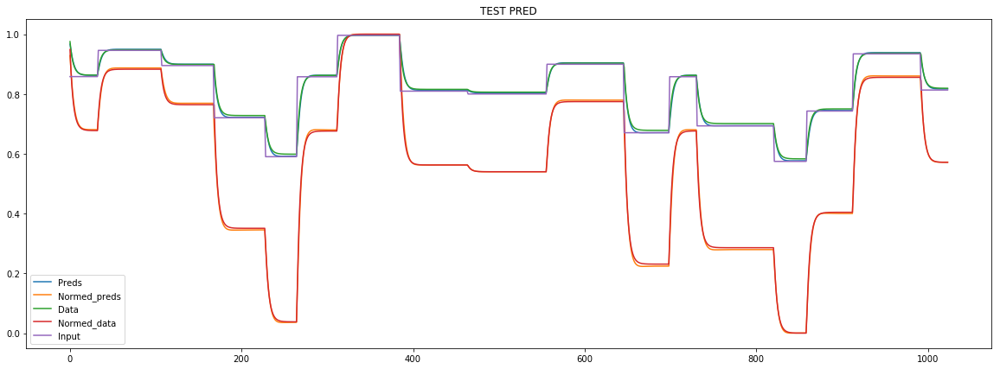

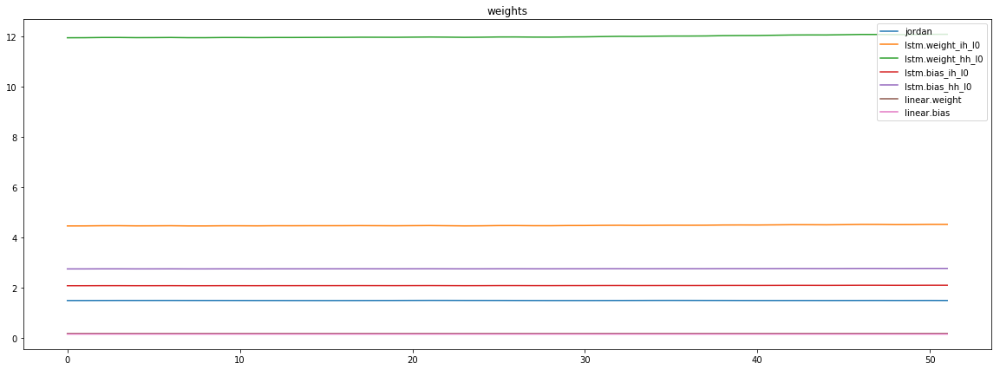

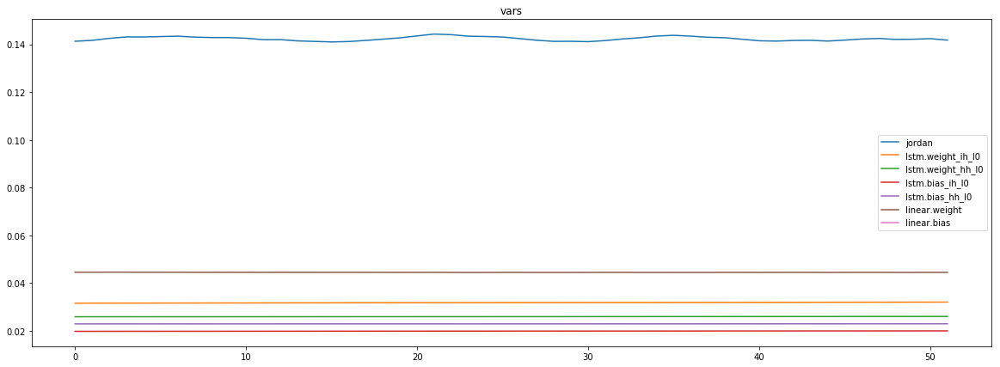

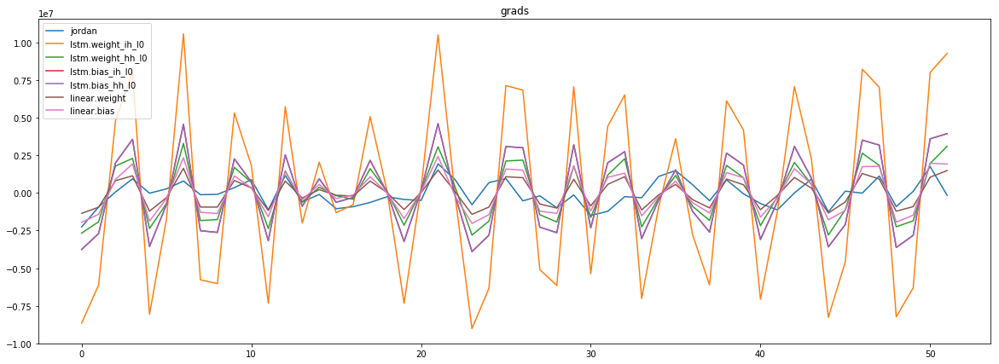

mean_p1 : -53382.165226862984
mean_p2 : 4329.906174879808


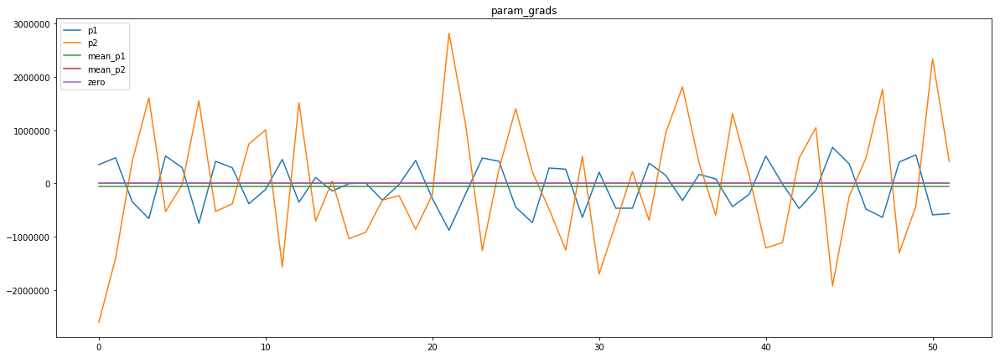

loss rate [-0.06746812190127582]
Epoch [80] 
     train_loss[46959.80658428486] 
     eval_train[52601.55474384014] 
     eval_test[54247.91379616477]



aux preds: 0.48244982957839966 1.0133731365203857
main loss 0.0
aux loss 27126.615440955527
jord loss 19888.750131460336
combined loss 47015.36557241586 



Parameter containing:
tensor([[0.4824, 1.0134]], requires_grad=True)


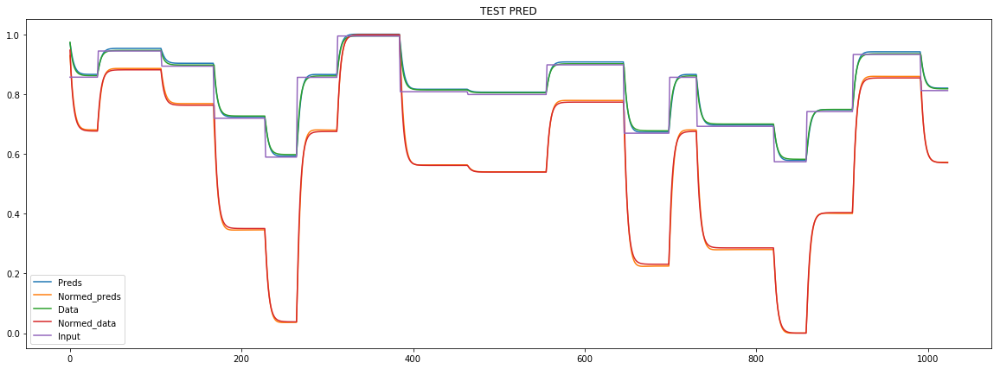

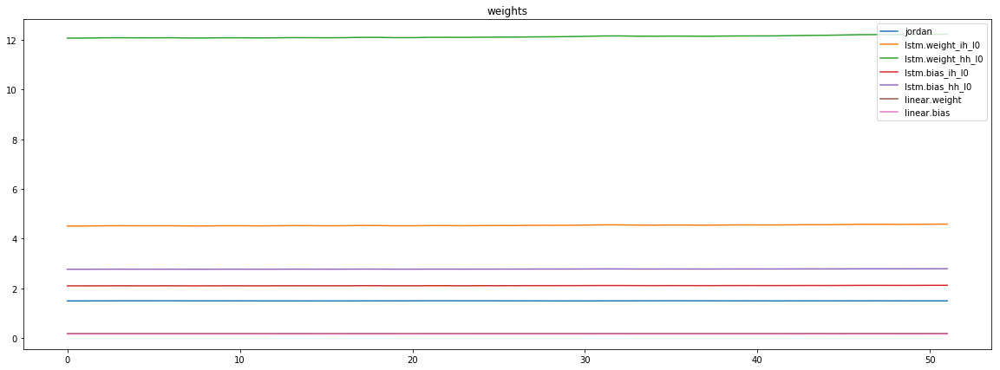

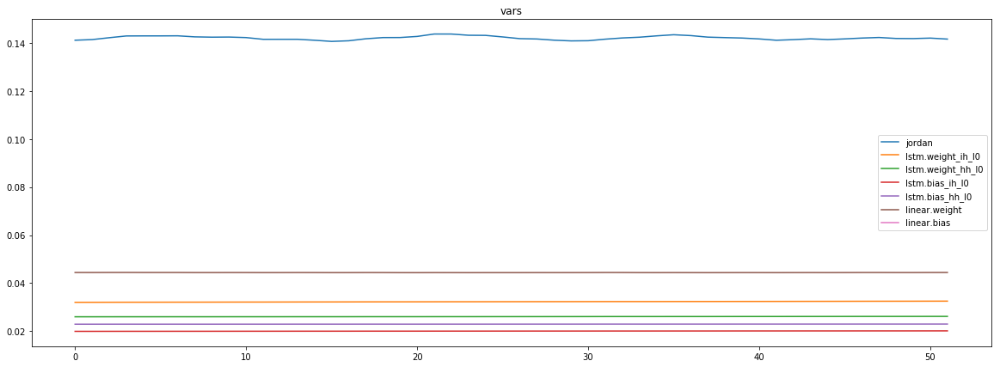

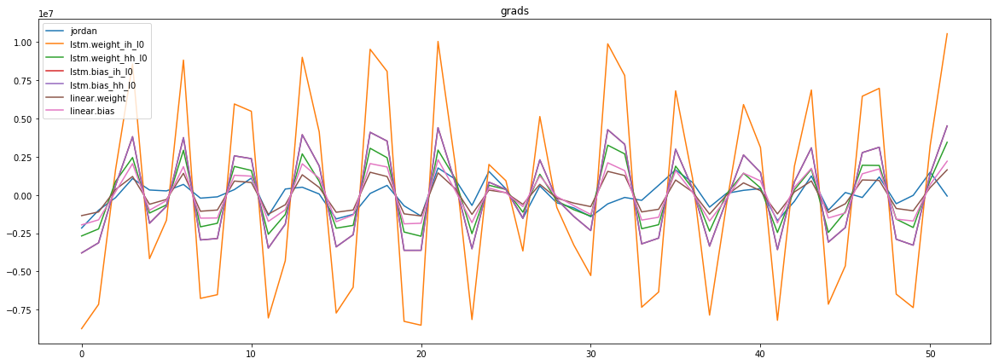

mean_p1 : -34013.75315504808
mean_p2 : -6676.184044471154


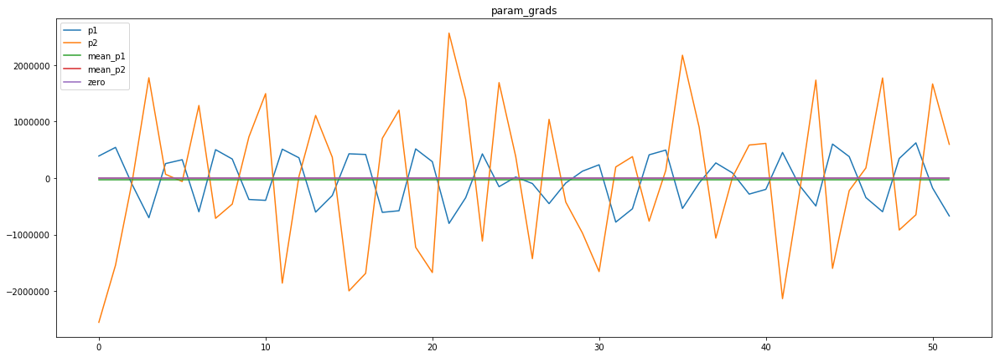

loss rate [0.1049349668649554]
Epoch [81] 
     train_loss[47015.36557241586] 
     eval_train[45483.009239783656] 
     eval_test[46948.66512784091]



aux preds: 0.48289191722869873 1.0134785175323486
main loss 0.0
aux loss 26944.601618840145
jord loss 19990.56621844952
combined loss 46935.167837289664 



Parameter containing:
tensor([[0.4829, 1.0135]], requires_grad=True)


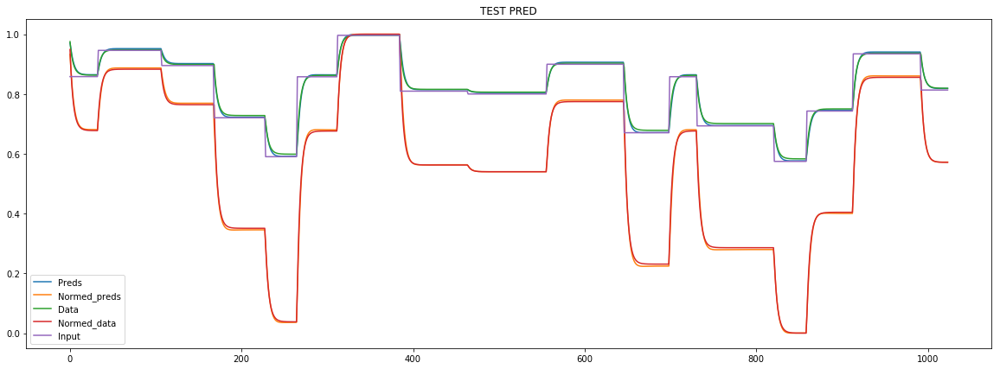

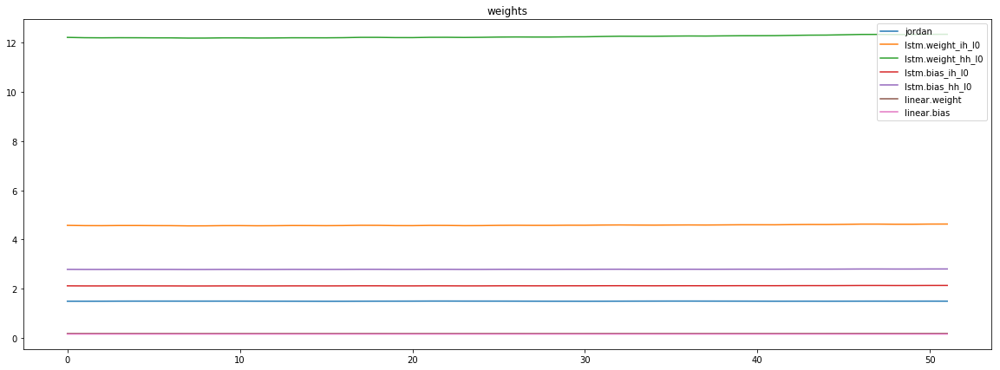

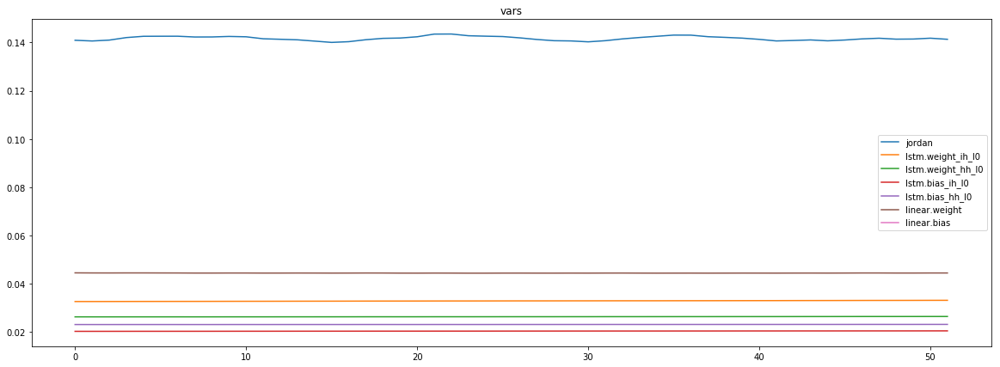

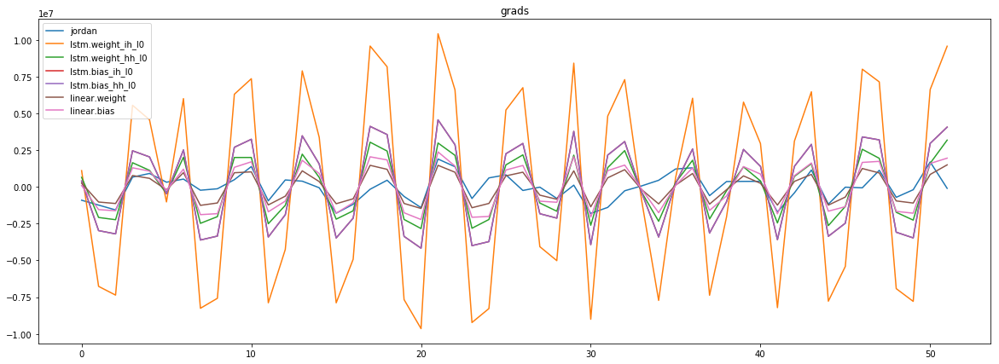

mean_p1 : -32208.31805889423
mean_p2 : -474.56678185096155


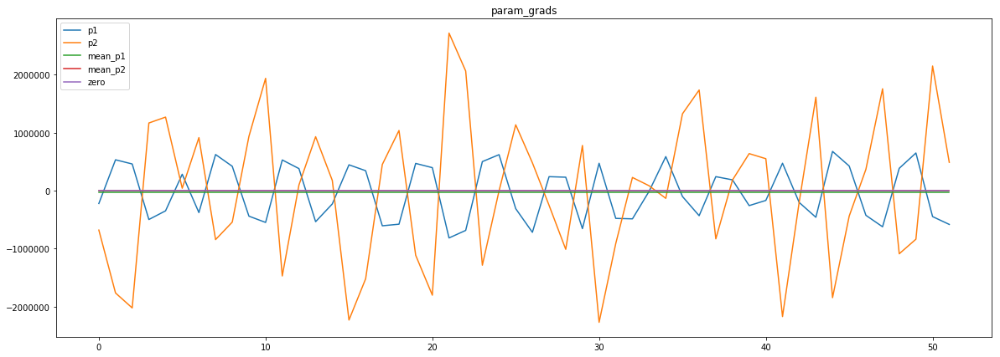

loss rate [0.029055119910559313]
Epoch [82] 
     train_loss[46935.167837289664] 
     eval_train[48856.0317570613] 
     eval_test[50457.79776278409]



aux preds: 0.4833095073699951 1.0140577554702759
main loss 0.0
aux loss 27317.961669921875
jord loss 19848.890362079328
combined loss 47166.8520320012 



Parameter containing:
tensor([[0.4833, 1.0141]], requires_grad=True)


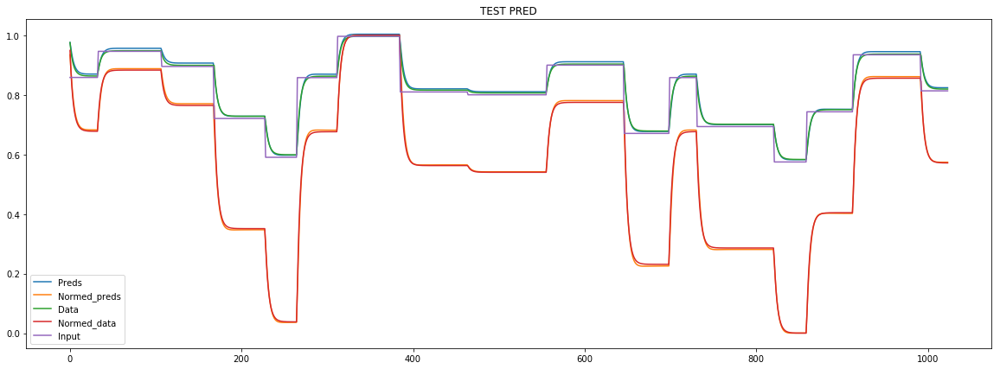

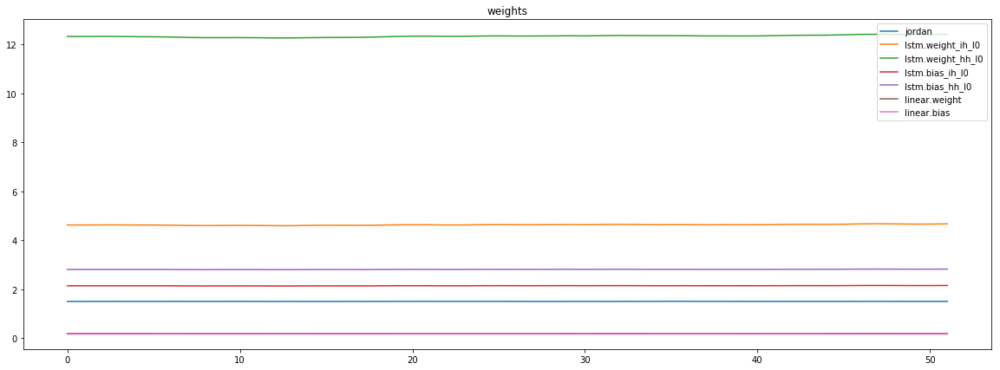

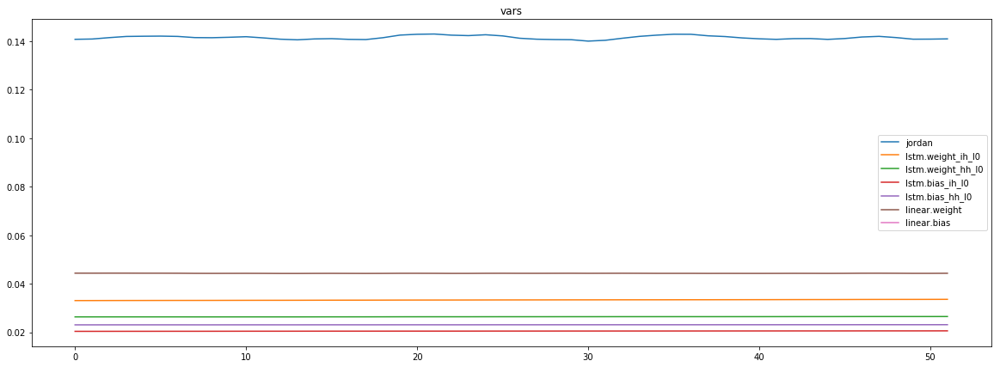

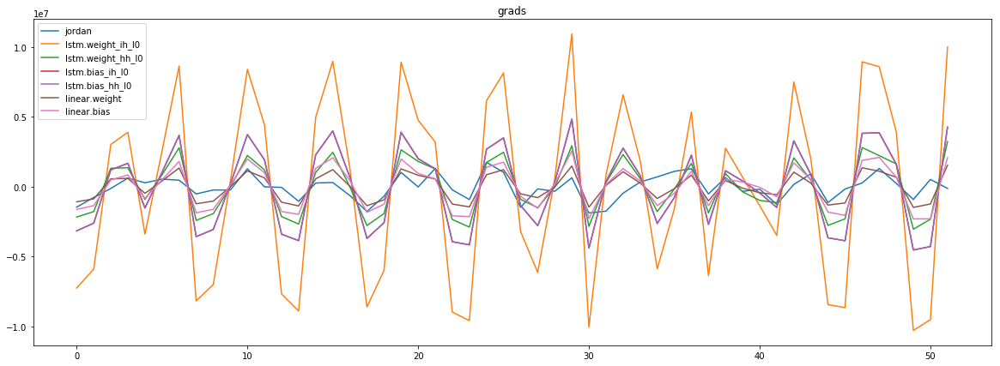

mean_p1 : -17674.04450871394
mean_p2 : -25508.611478365383


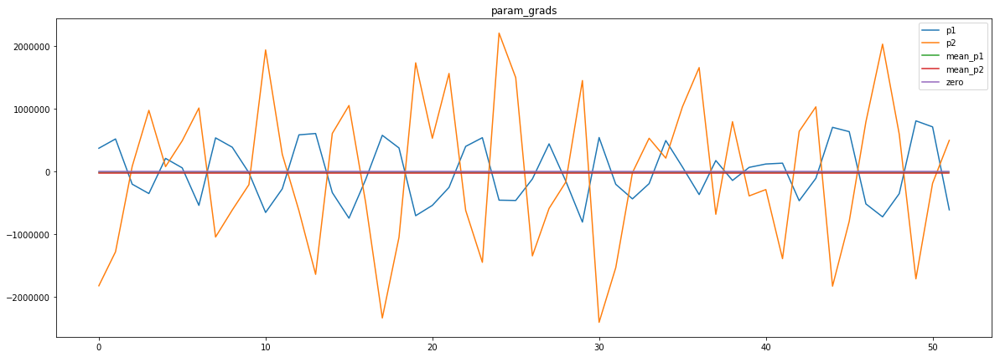

loss rate [0.05998345576476816]
Epoch [83] 
     train_loss[47166.8520320012] 
     eval_train[46376.05382361779] 
     eval_test[47519.20769708807]



aux preds: 0.4838341176509857 1.0139167308807373
main loss 0.0
aux loss 27055.736947866586
jord loss 20080.395338792066
combined loss 47136.132286658656 



Parameter containing:
tensor([[0.4838, 1.0139]], requires_grad=True)


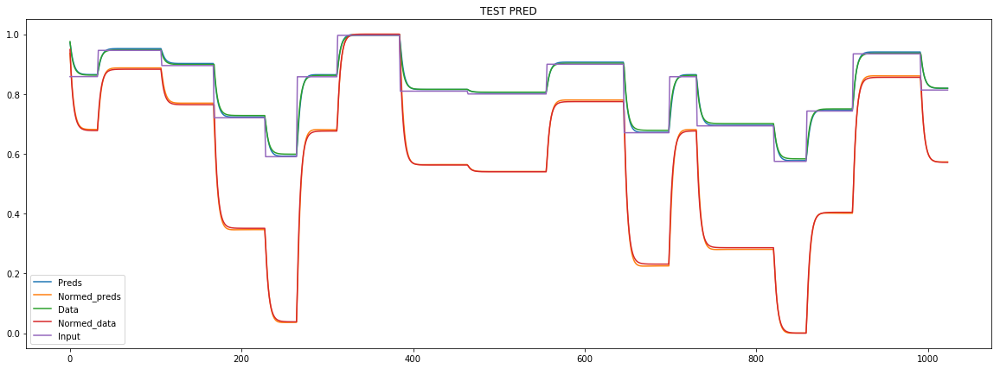

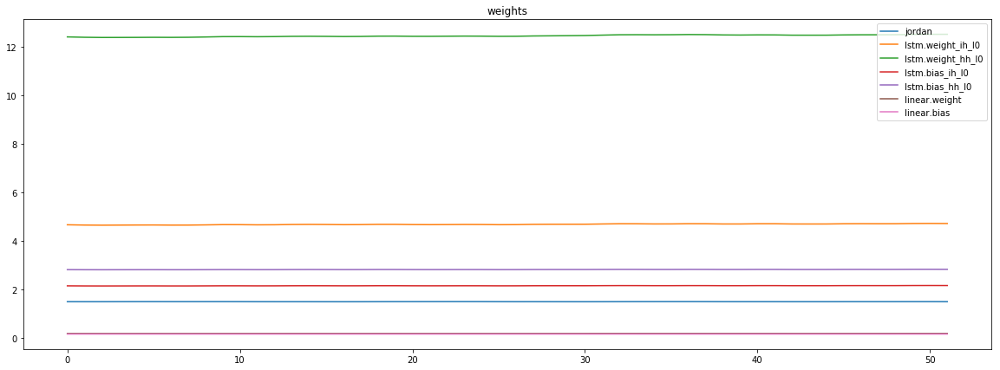

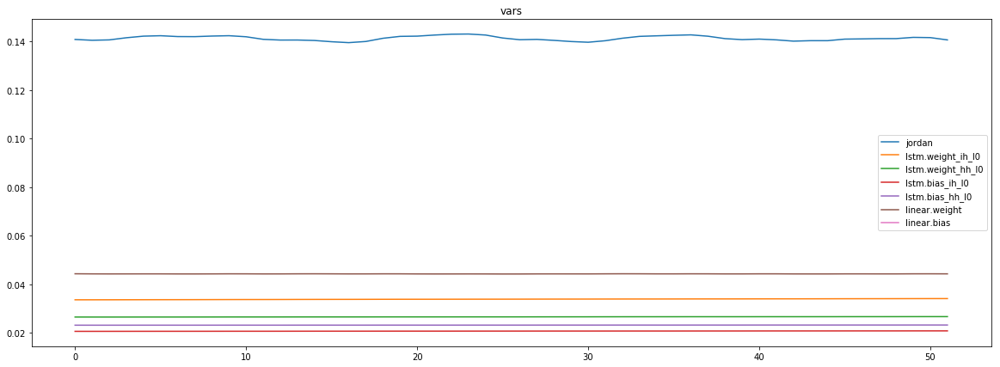

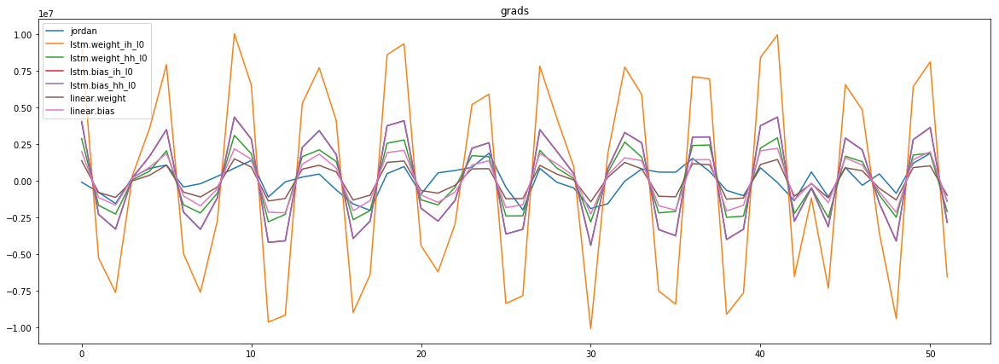

mean_p1 : -35545.23903245192
mean_p2 : 3544.682091346154


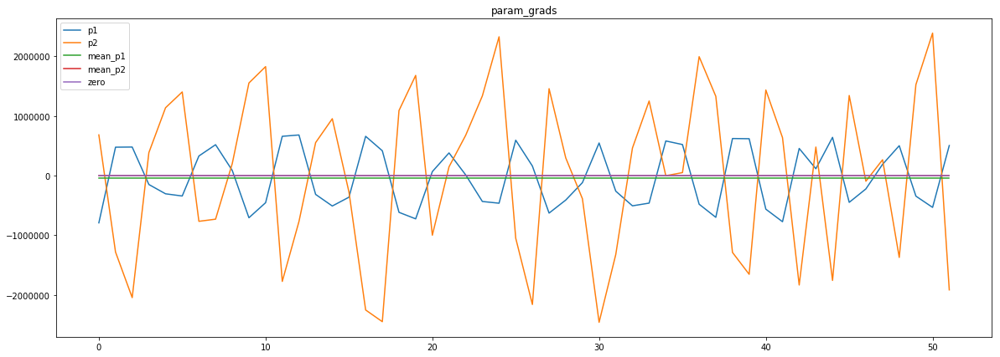

loss rate [0.0022839906587879266]
Epoch [84] 
     train_loss[47136.132286658656] 
     eval_train[46616.226806640625] 
     eval_test[48198.22056995738]



aux preds: 0.48409193754196167 1.0138068199157715
main loss 0.0
aux loss 27232.843599759617
jord loss 19883.657376802883
combined loss 47116.5009765625 



Parameter containing:
tensor([[0.4841, 1.0138]], requires_grad=True)


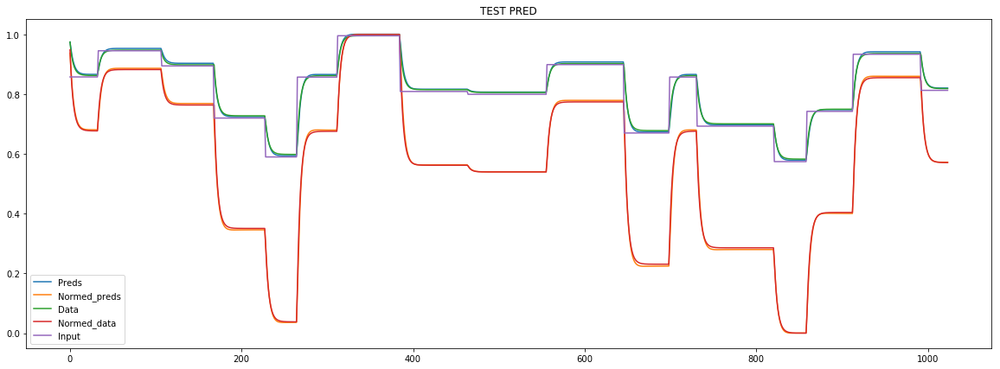

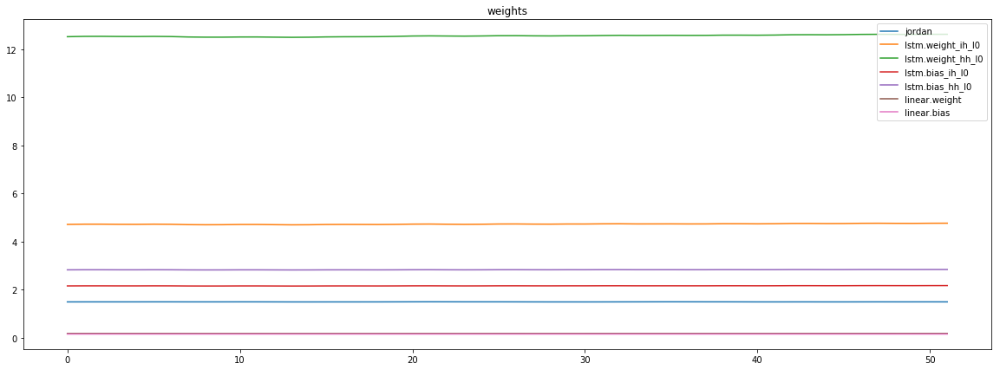

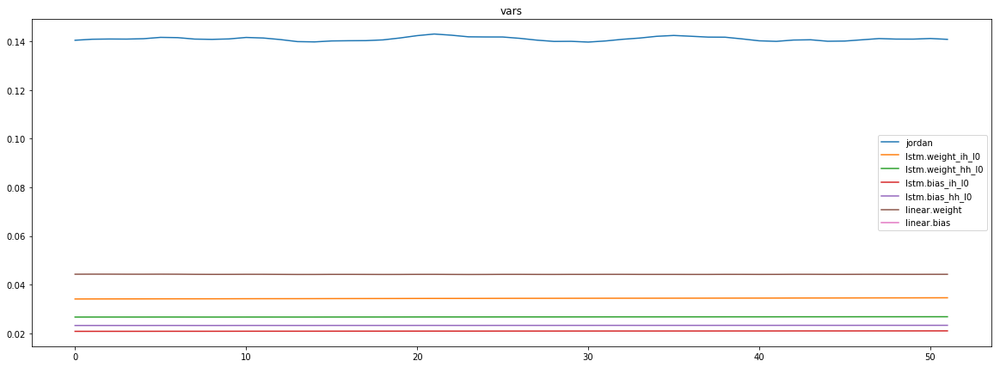

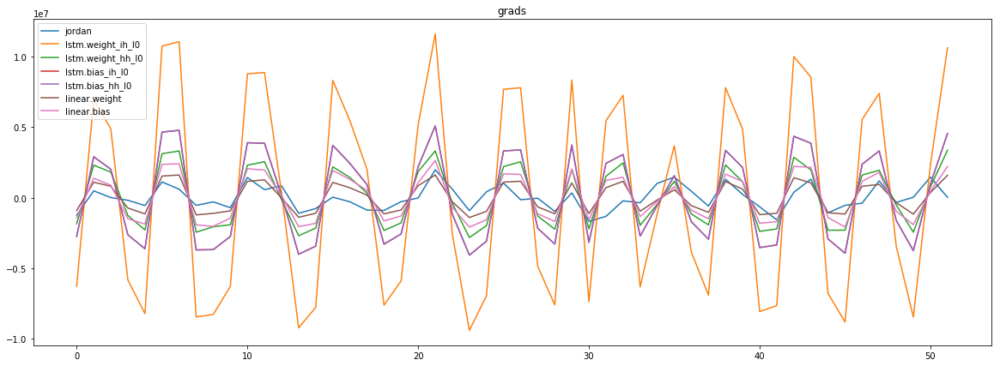

mean_p1 : -22224.45207331731
mean_p2 : 19461.30138221154


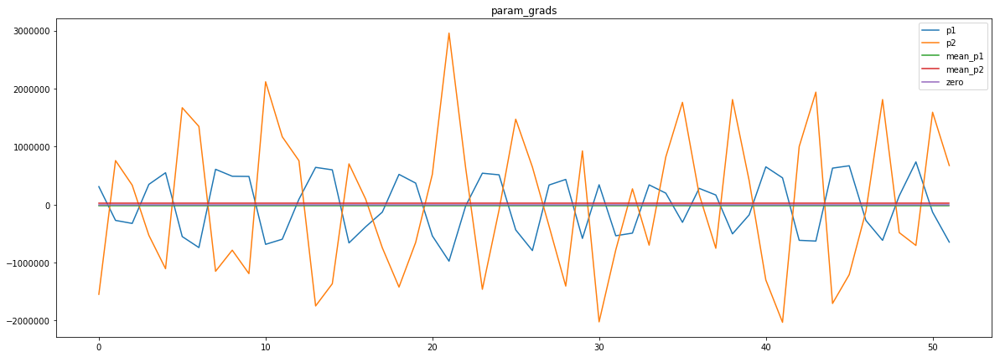

loss rate [0.06337317119933428]
Epoch [85] 
     train_loss[47116.5009765625] 
     eval_train[44152.04790790264] 
     eval_test[45637.21280184659]



aux preds: 0.4844290614128113 1.014102578163147
main loss 0.0
aux loss 26278.30525090144
jord loss 20044.307786207934
combined loss 46322.613037109375 



Parameter containing:
tensor([[0.4844, 1.0141]], requires_grad=True)


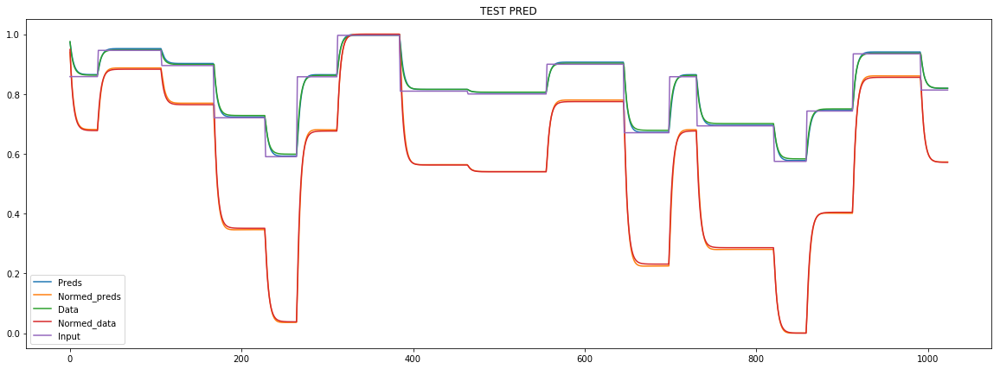

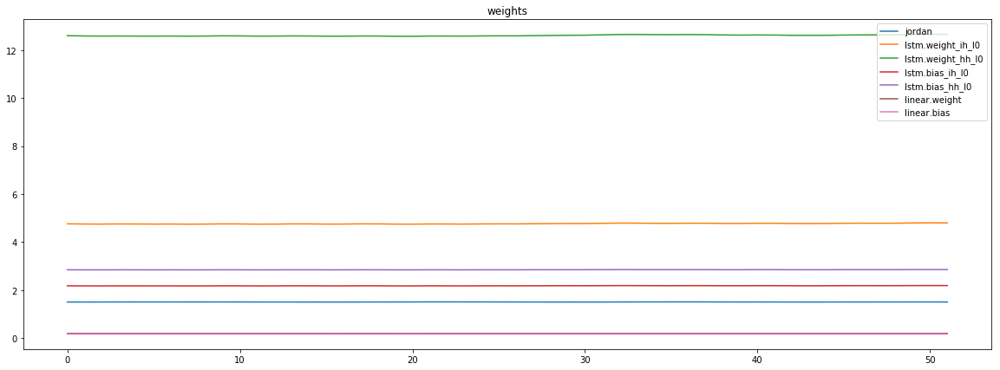

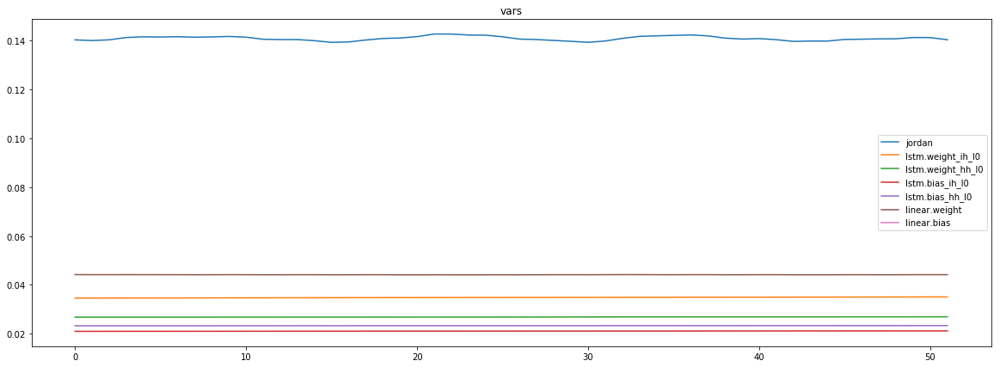

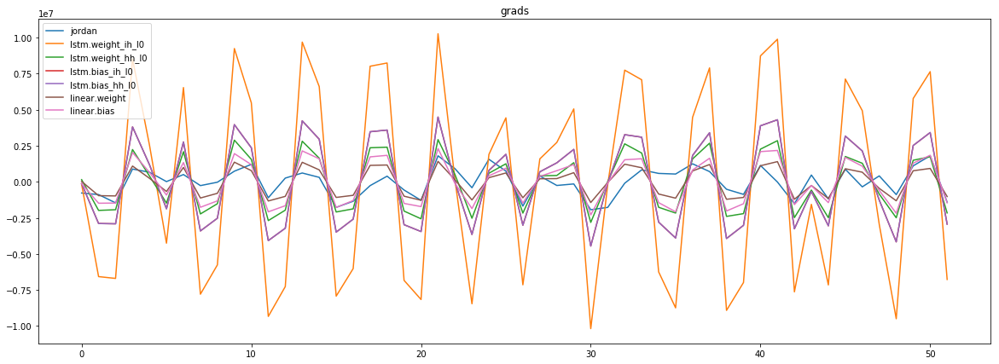

mean_p1 : -13582.985426682691
mean_p2 : -23951.716045673078


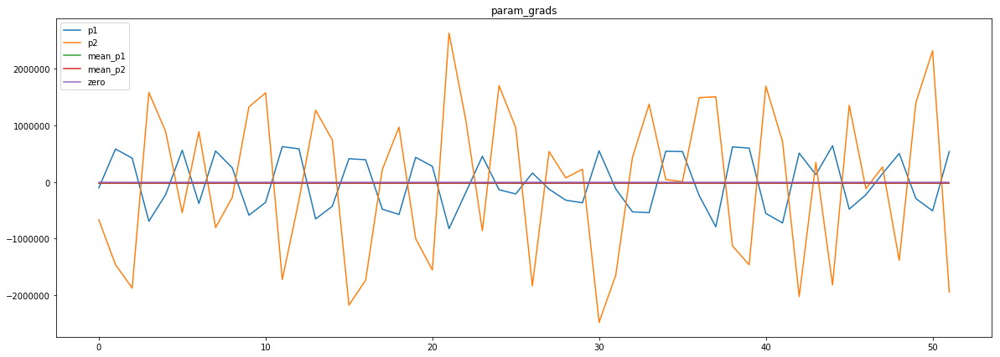

loss rate [-0.006593568240124359]
Epoch [86] 
     train_loss[46322.613037109375] 
     eval_train[45835.75548377403] 
     eval_test[47428.89084694602]



aux preds: 0.4847053289413452 1.0125374794006348
main loss 0.0
aux loss 26423.371713491586
jord loss 19932.605224609375
combined loss 46355.97693810096 



Parameter containing:
tensor([[0.4847, 1.0125]], requires_grad=True)


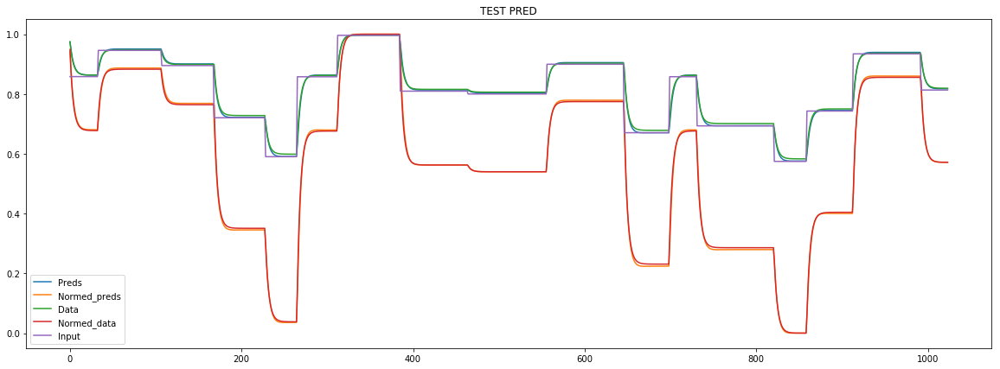

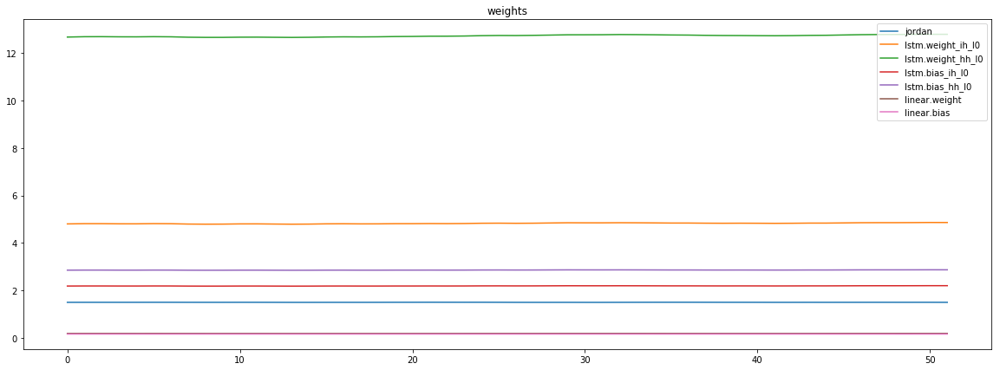

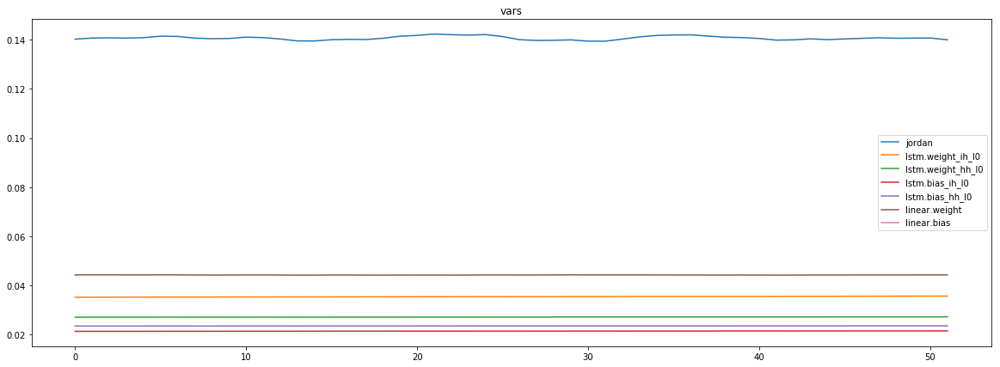

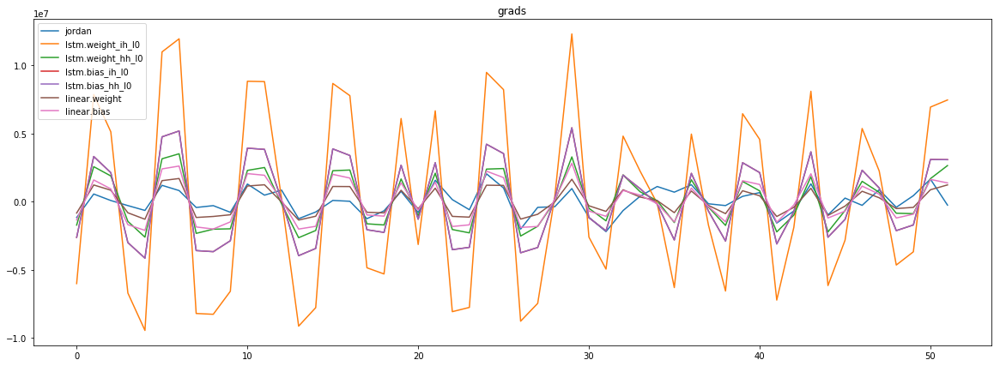

mean_p1 : -26585.794771634617
mean_p2 : 33846.4296875


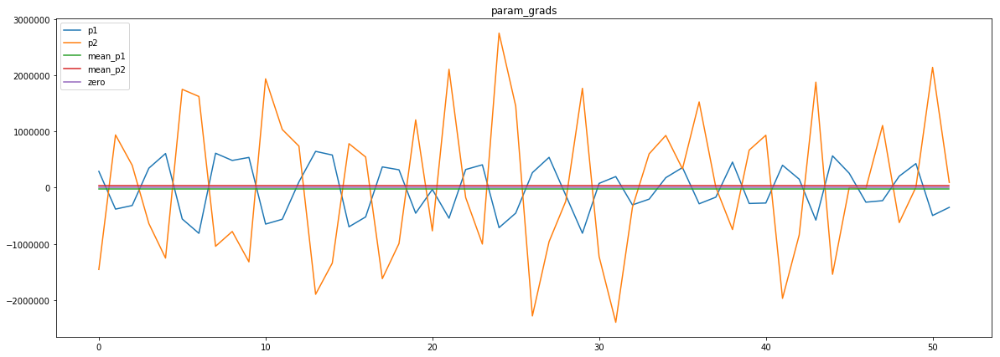

loss rate [-0.13592663384294723]
Epoch [87] 
     train_loss[46355.97693810096] 
     eval_train[51914.0141789363] 
     eval_test[53488.63609730113]



aux preds: 0.4849975109100342 1.0143266916275024
main loss 0.0
aux loss 28120.32196514423
jord loss 20082.248929537258
combined loss 48202.570894681485 



Parameter containing:
tensor([[0.4850, 1.0143]], requires_grad=True)


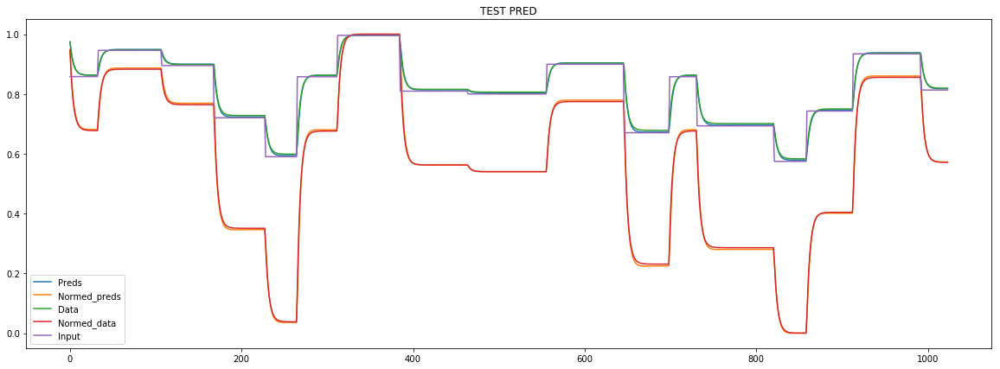

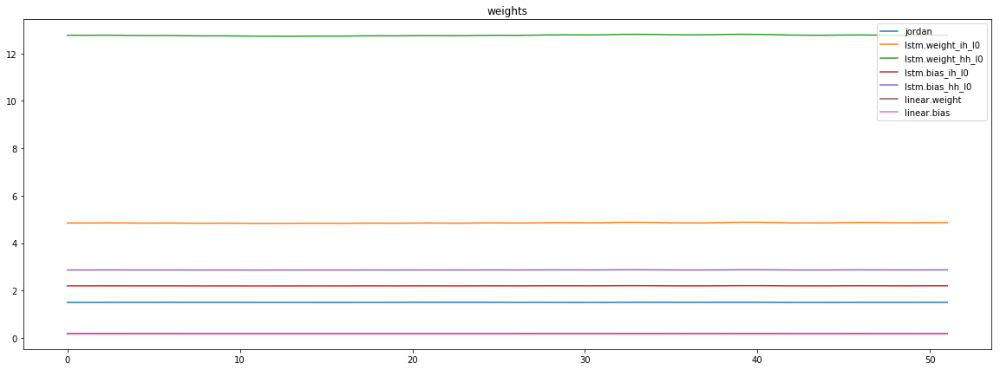

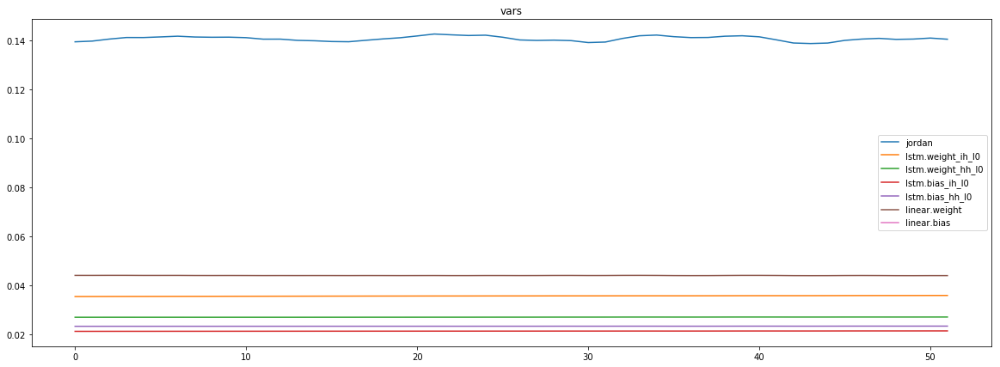

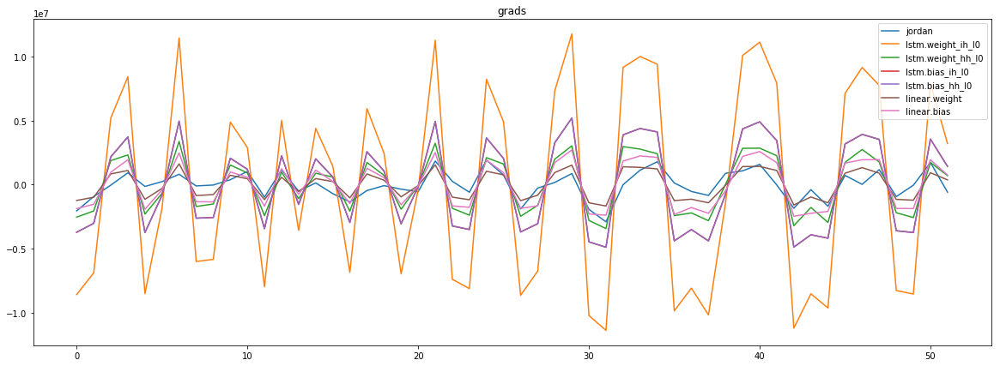

mean_p1 : -14590.509615384615
mean_p2 : -25996.09284855769


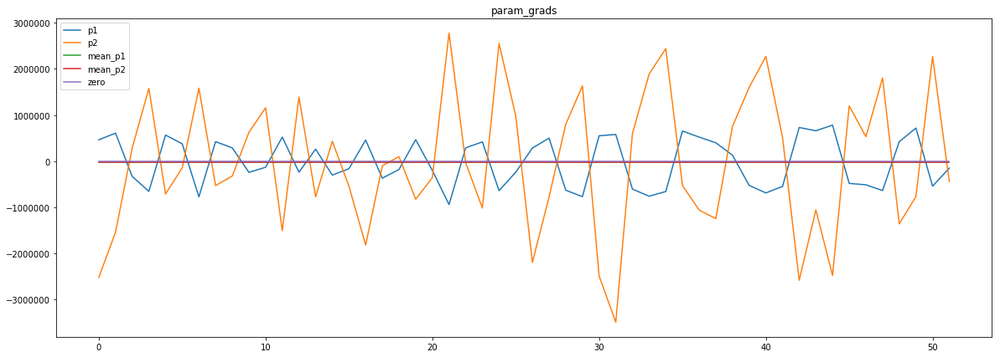

loss rate [0.012355881436646121]
Epoch [88] 
     train_loss[48202.570894681485] 
     eval_train[46608.75326772837] 
     eval_test[48247.9755859375]



aux preds: 0.4853712320327759 1.0141655206680298
main loss 0.0
aux loss 29460.23918269231
jord loss 19963.390042818508
combined loss 49423.62922551081 



Parameter containing:
tensor([[0.4854, 1.0142]], requires_grad=True)


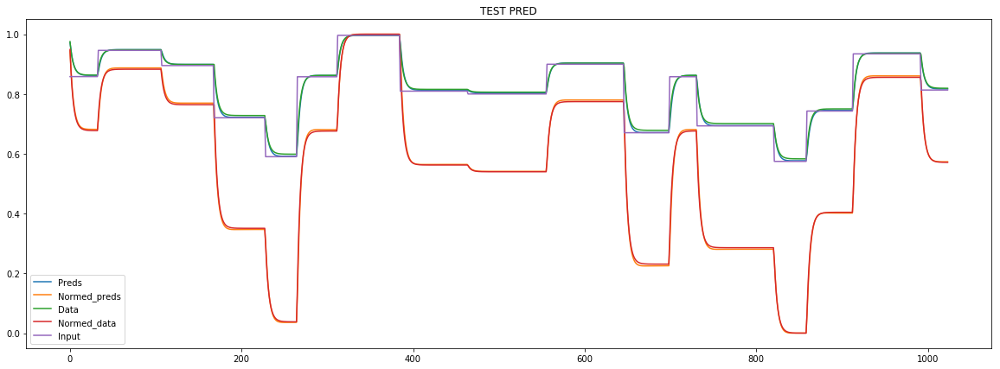

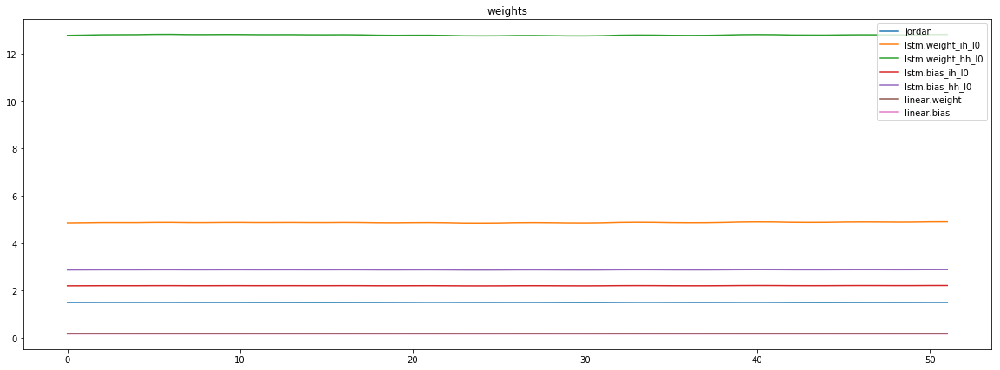

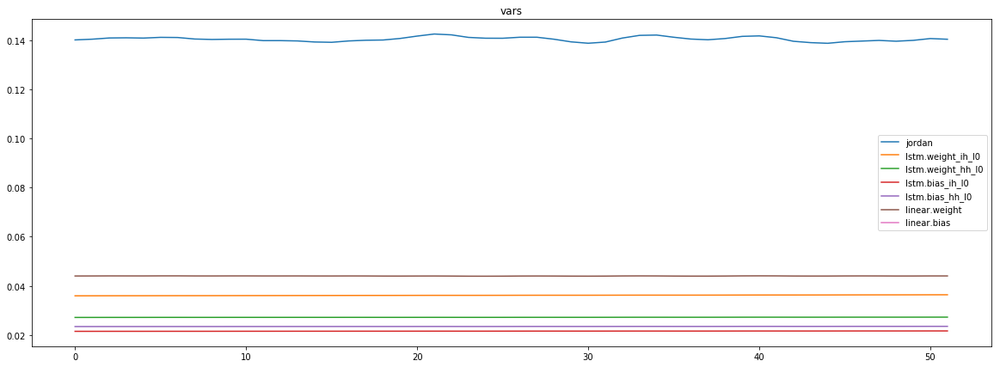

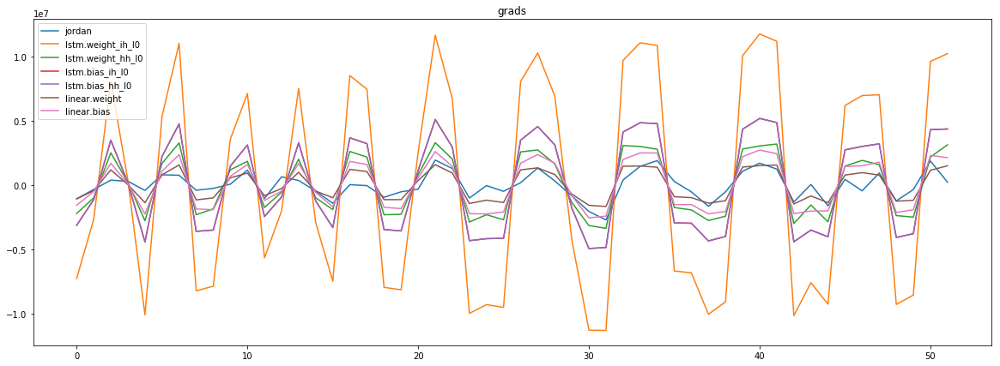

mean_p1 : -27890.918118990383
mean_p2 : 14035.336087740385


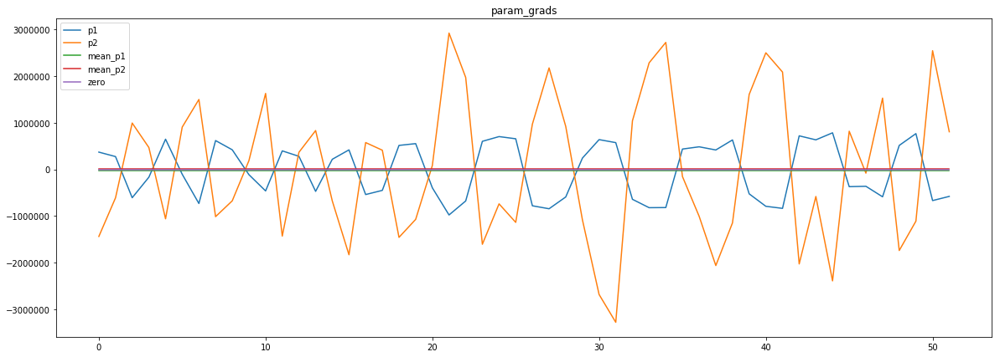

loss rate [-0.01899335395308044]
Epoch [89] 
     train_loss[49423.62922551081] 
     eval_train[49022.68740609976] 
     eval_test[50666.218572443184]



aux preds: 0.4856615364551544 1.0140480995178223
main loss 0.0
aux loss 29494.716533954328
jord loss 19993.625544621395
combined loss 49488.34207857572 



Parameter containing:
tensor([[0.4857, 1.0140]], requires_grad=True)


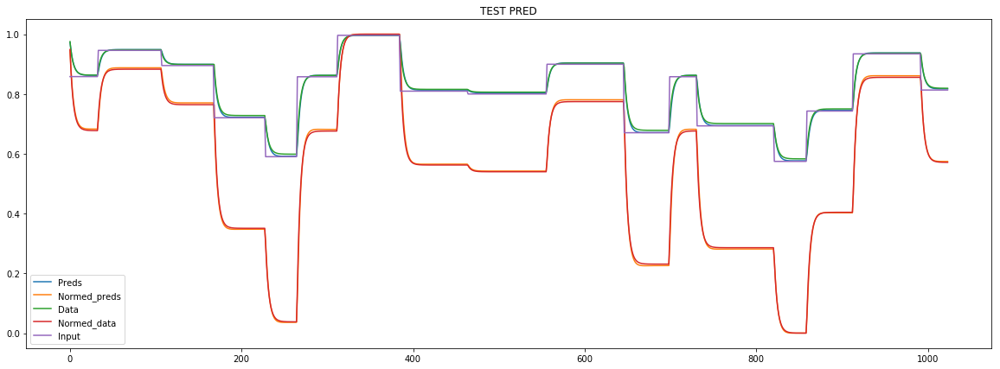

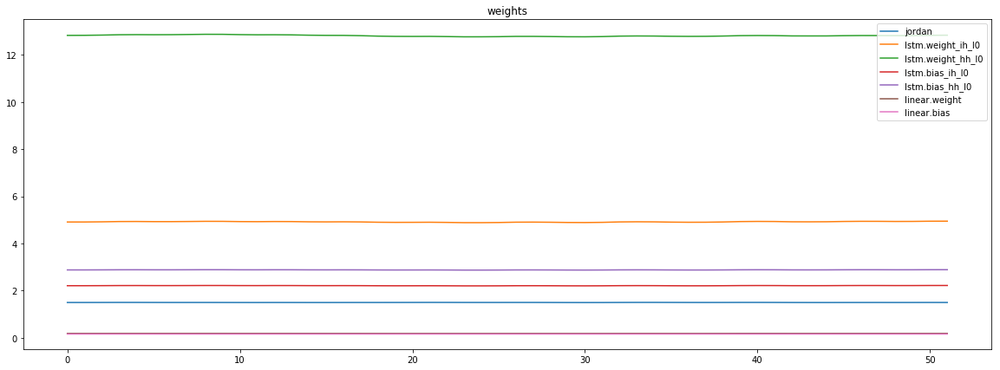

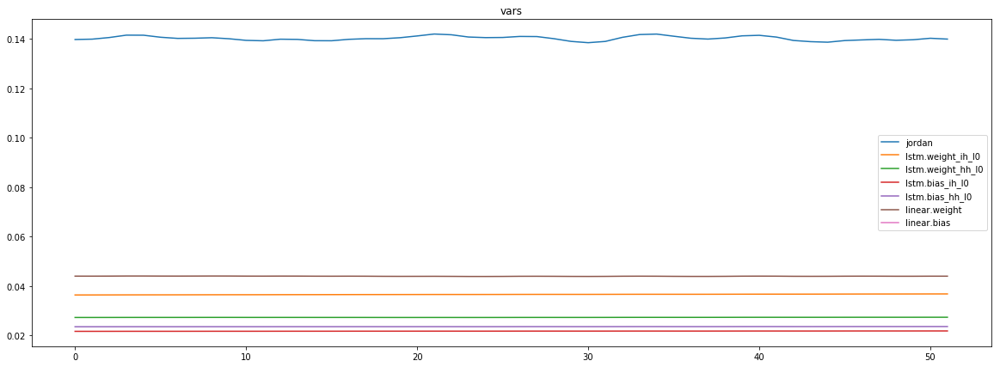

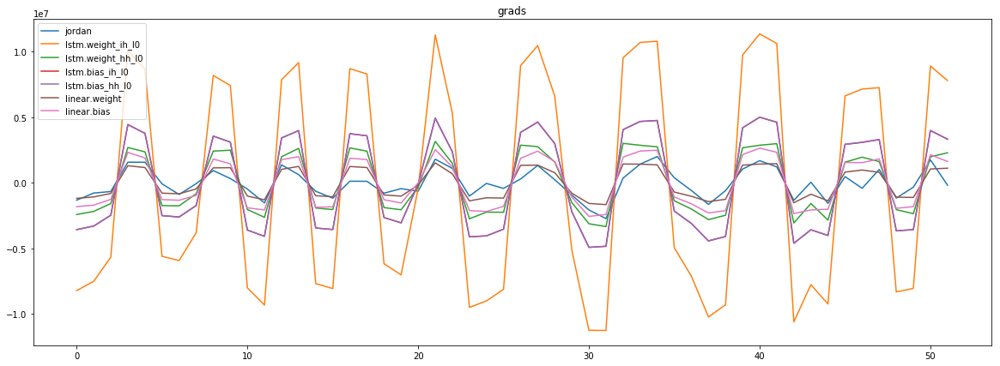

mean_p1 : -14169.40204326923
mean_p2 : -7242.138521634615


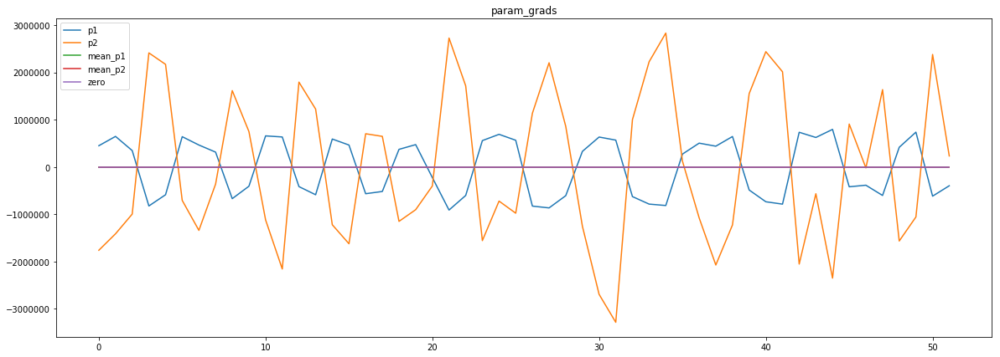

Epoch    90: reducing learning rate of group 0 to 3.0000e-03.
Epoch    90: reducing learning rate of group 1 to 3.0000e-04.
Epoch    90: reducing learning rate of group 2 to 3.0000e-04.
loss rate [0.004049300566118519]
Epoch [90] 
     train_loss[49488.34207857572] 
     eval_train[48895.23135141226] 
     eval_test[50595.23512961648]



aux preds: 0.48566049337387085 1.0140379667282104
main loss 0.0
aux loss 24605.876145582934
jord loss 19734.186842698316
combined loss 44340.06298828125 



Parameter containing:
tensor([[0.4857, 1.0140]], requires_grad=True)


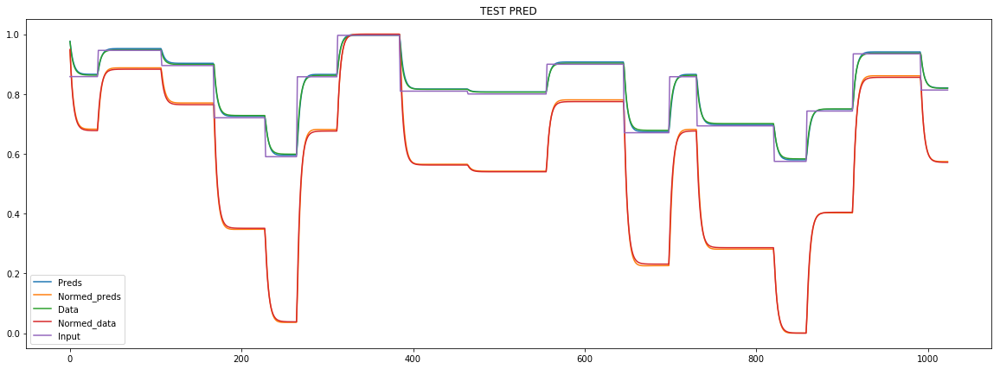

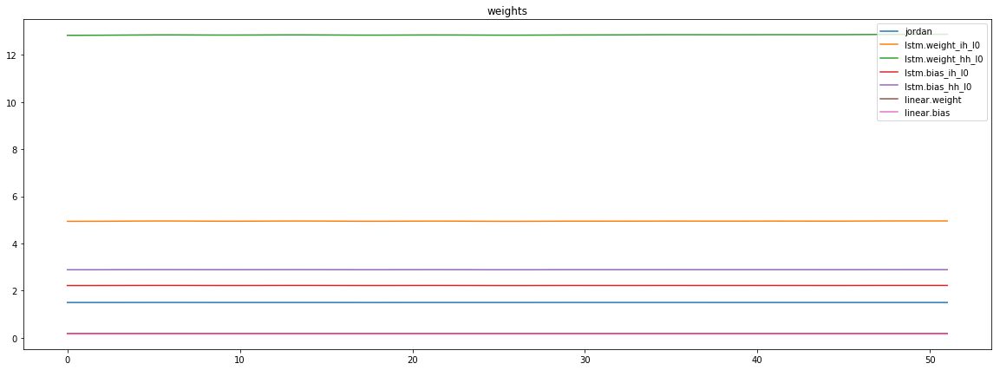

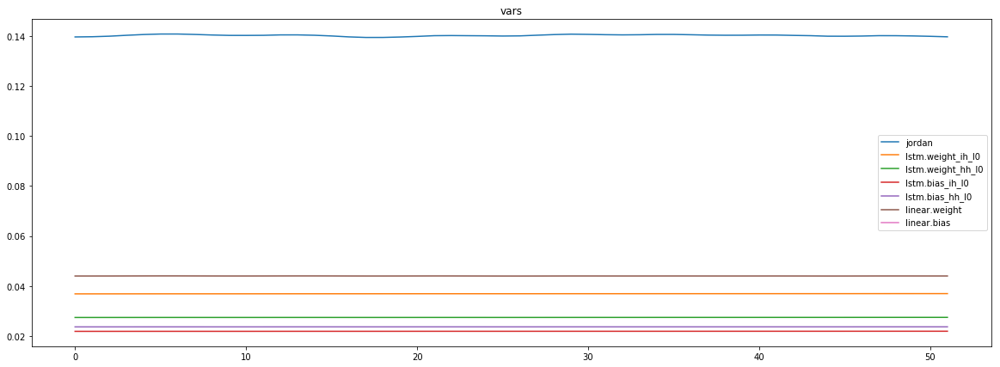

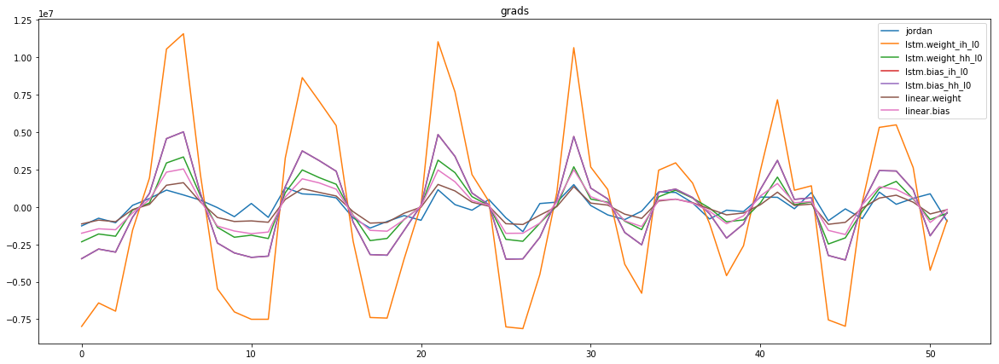

mean_p1 : 12800.277944711539
mean_p2 : -9211.386268028846


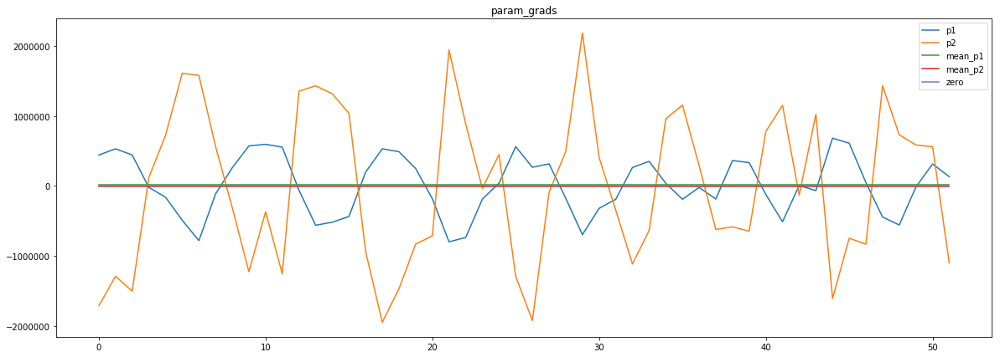

loss rate [0.09714535759934373]
Epoch [91] 
     train_loss[44340.06298828125] 
     eval_train[43384.562049278844] 
     eval_test[44995.09410511363]



aux preds: 0.48568058013916016 1.0134963989257812
main loss 0.0
aux loss 23949.060884915867
jord loss 19727.70984825721
combined loss 43676.77073317308 



Parameter containing:
tensor([[0.4857, 1.0135]], requires_grad=True)


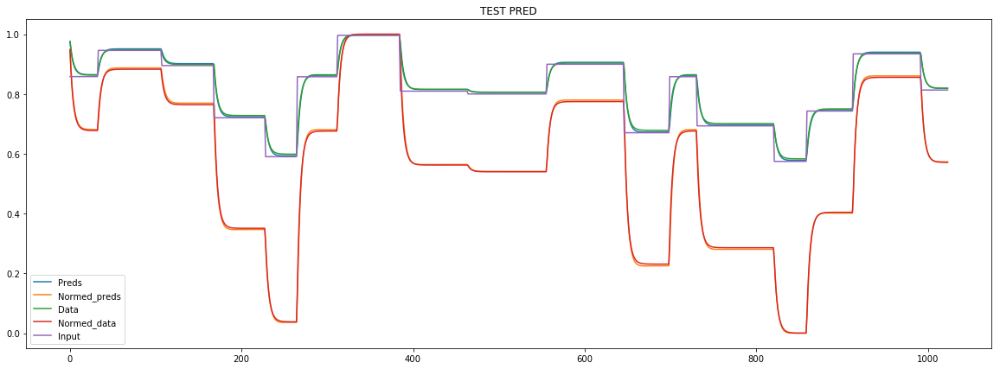

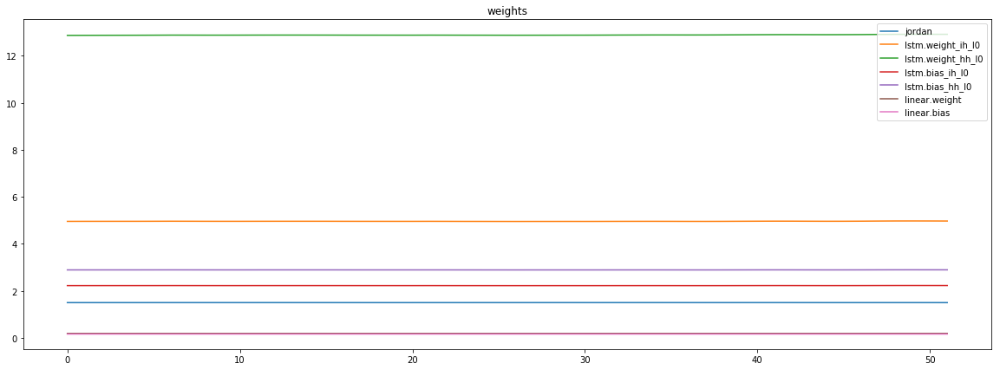

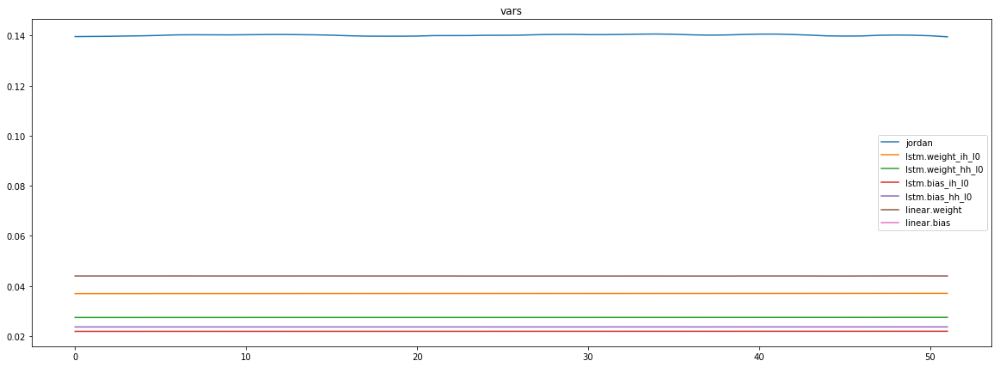

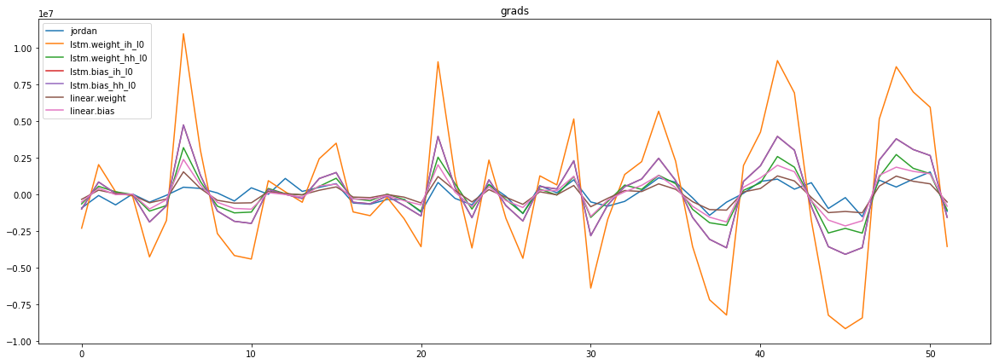

mean_p1 : -14395.251878004809
mean_p2 : 28068.94287109375


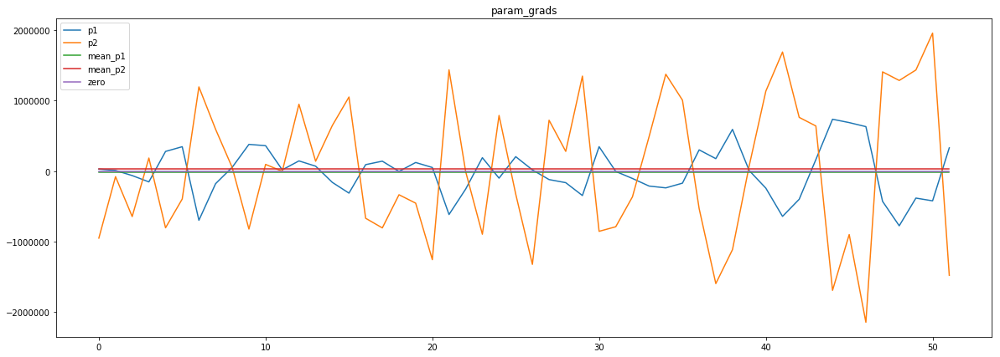

loss rate [0.015873958469387217]
Epoch [92] 
     train_loss[43676.77073317308] 
     eval_train[46330.75520207331] 
     eval_test[47978.29248046875]



aux preds: 0.4857095777988434 1.0133873224258423
main loss 0.0
aux loss 24552.42108623798
jord loss 19756.134821965145
combined loss 44308.555908203125 



Parameter containing:
tensor([[0.4857, 1.0134]], requires_grad=True)


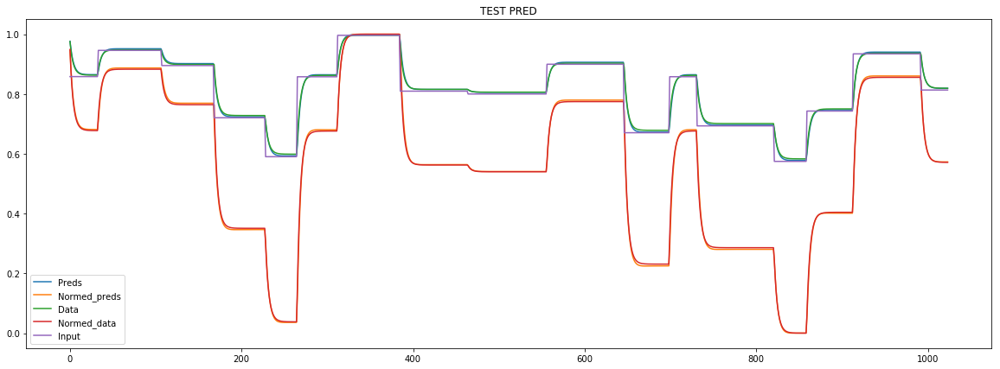

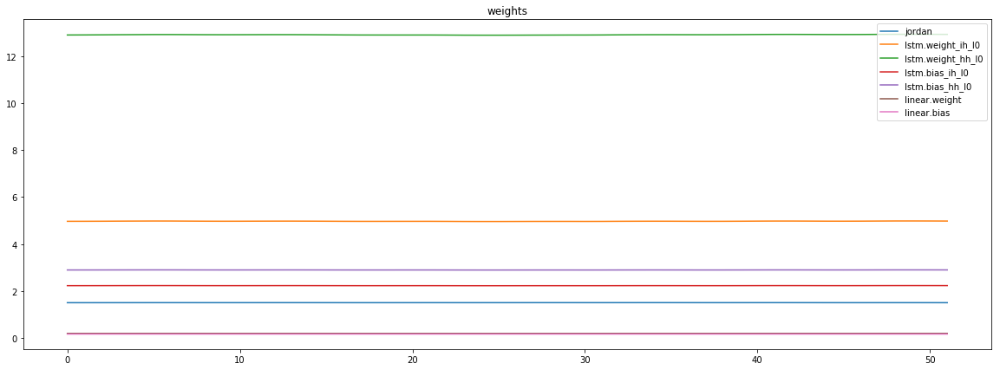

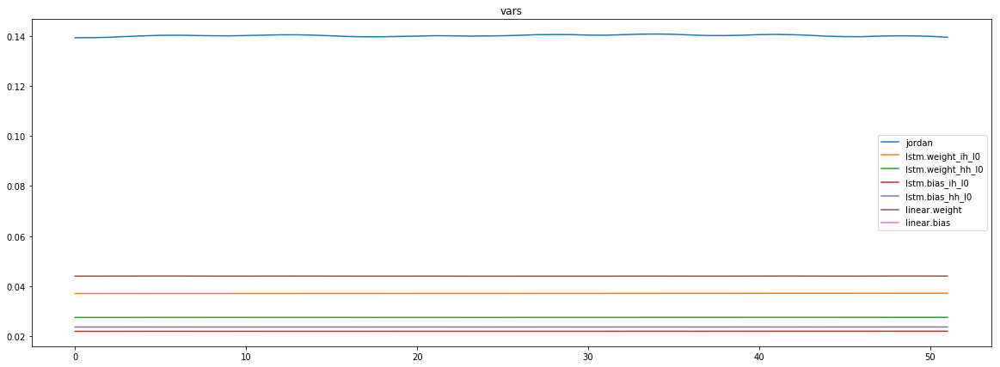

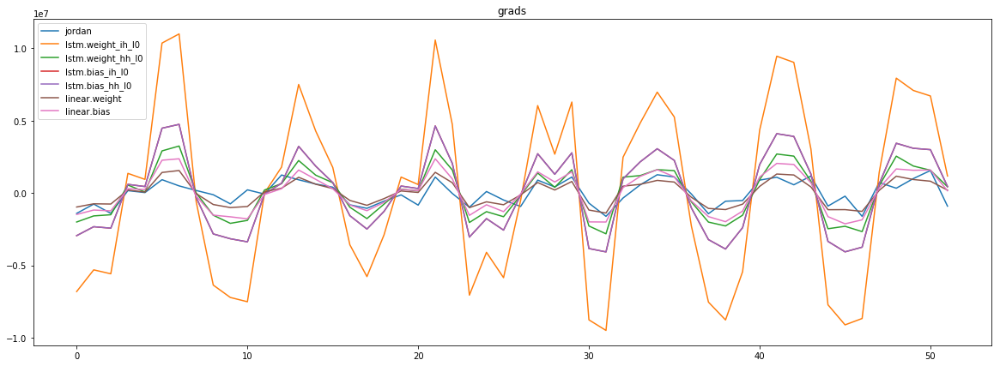

mean_p1 : -8831.456280048076
mean_p2 : 5471.380934495192


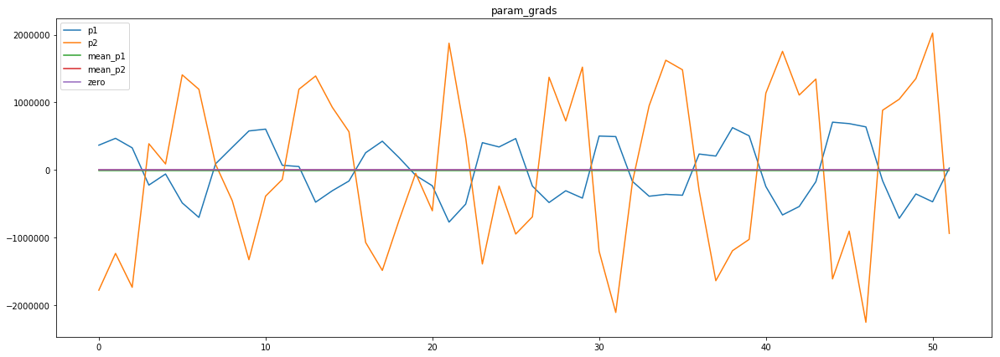

loss rate [-0.003456062803749438]
Epoch [93] 
     train_loss[44308.555908203125] 
     eval_train[46399.68718073919] 
     eval_test[48021.60129616478]



aux preds: 0.48573580384254456 1.0135854482650757
main loss 0.0
aux loss 24562.509934645434
jord loss 19768.208289513223
combined loss 44330.718224158656 



Parameter containing:
tensor([[0.4857, 1.0136]], requires_grad=True)


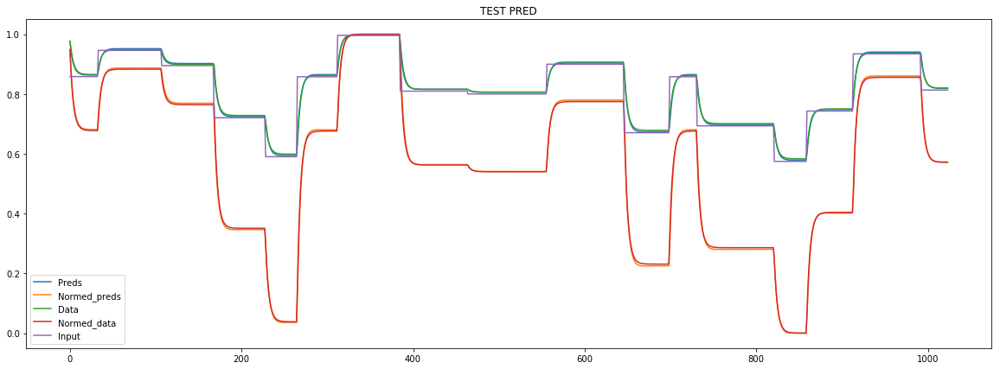

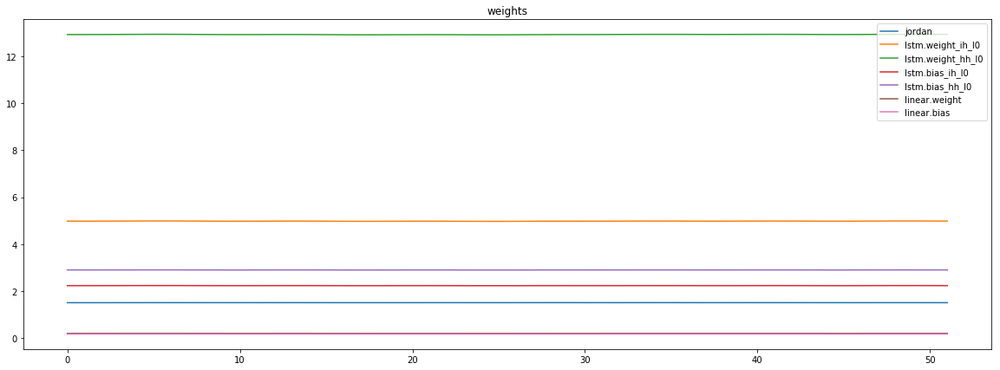

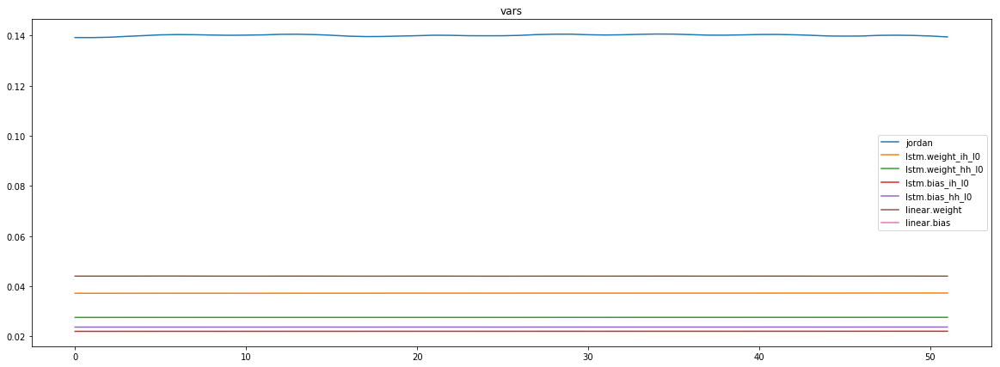

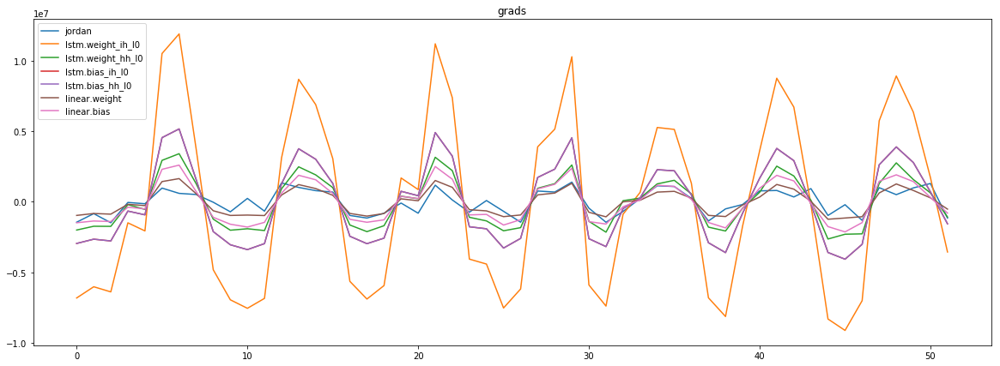

mean_p1 : 4369.055063100962
mean_p2 : -14397.22979266827


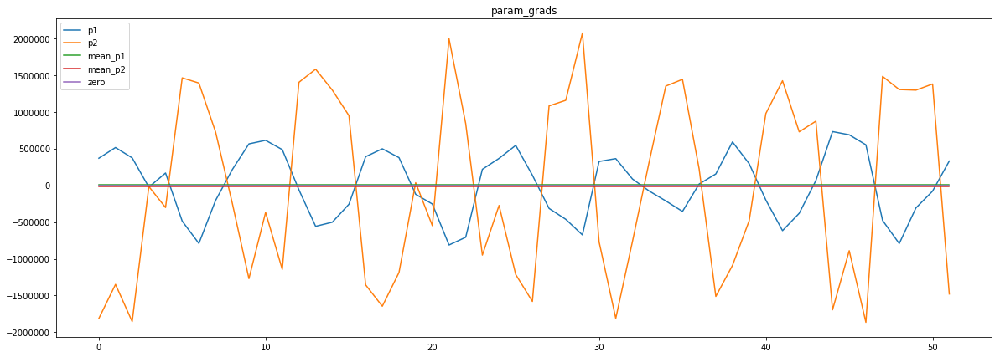

loss rate [0.008029305882865101]
Epoch [94] 
     train_loss[44330.718224158656] 
     eval_train[44997.82611553486] 
     eval_test[46620.96533203125]



aux preds: 0.4857223331928253 1.0141913890838623
main loss 0.0
aux loss 23641.089111328125
jord loss 19710.149151141828
combined loss 43351.23826246995 



Parameter containing:
tensor([[0.4857, 1.0142]], requires_grad=True)


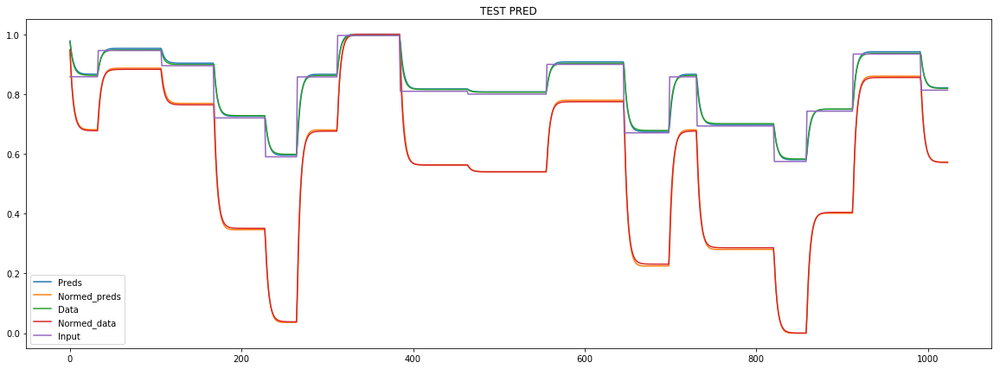

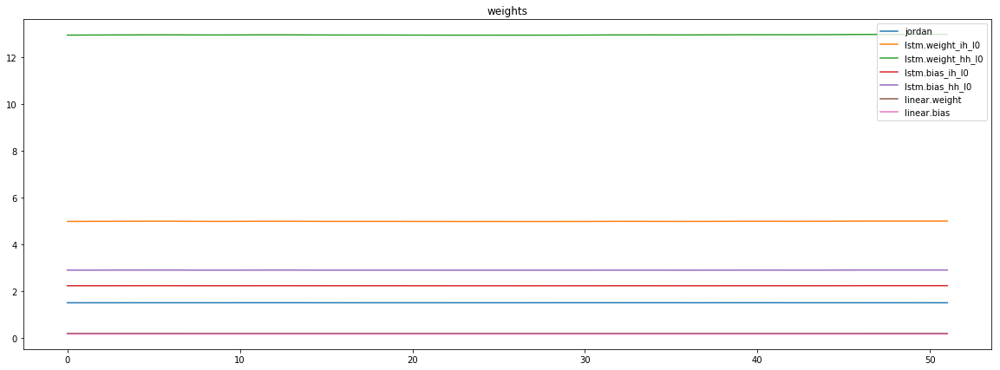

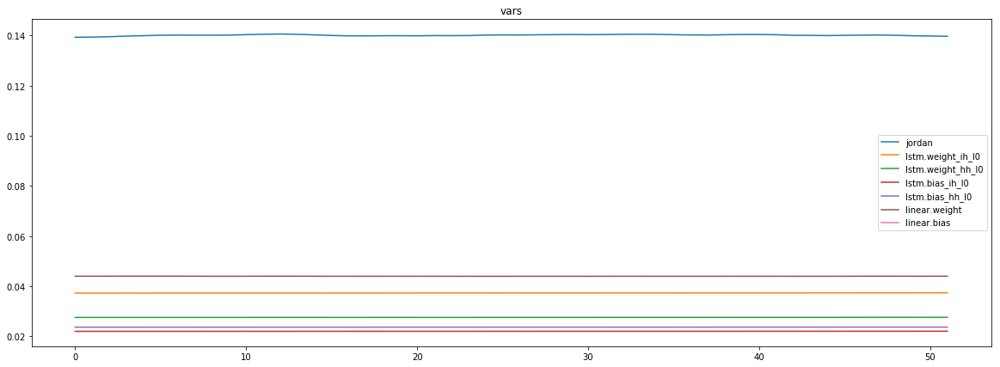

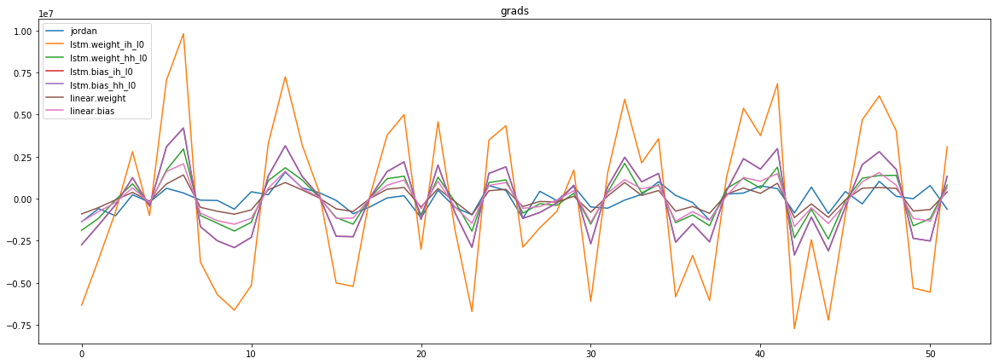

mean_p1 : 10178.138559194711
mean_p2 : -21508.59187199519


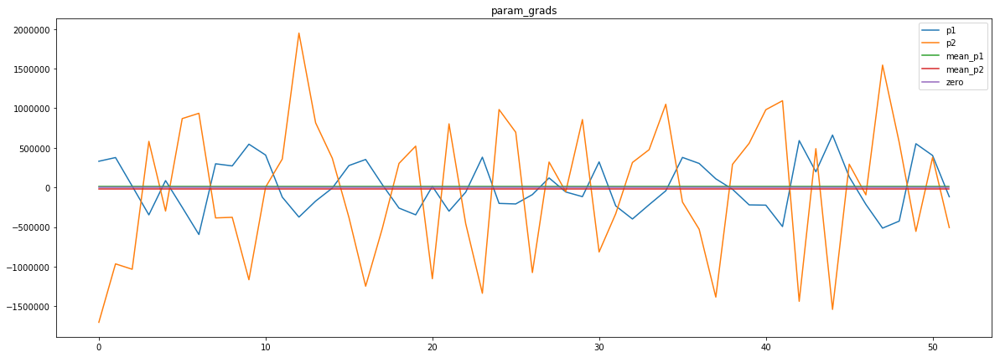

loss rate [0.06696340111963106]
Epoch [95] 
     train_loss[43351.23826246995] 
     eval_train[42901.479586087735] 
     eval_test[44356.827104048294]



aux preds: 0.4857393801212311 1.0138005018234253
main loss 0.0
aux loss 23837.789306640625
jord loss 19728.18975360577
combined loss 43565.97906024639 



Parameter containing:
tensor([[0.4857, 1.0138]], requires_grad=True)


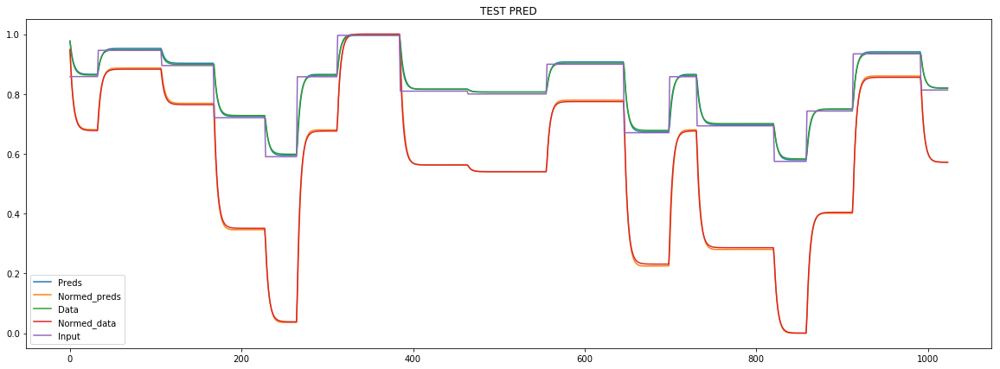

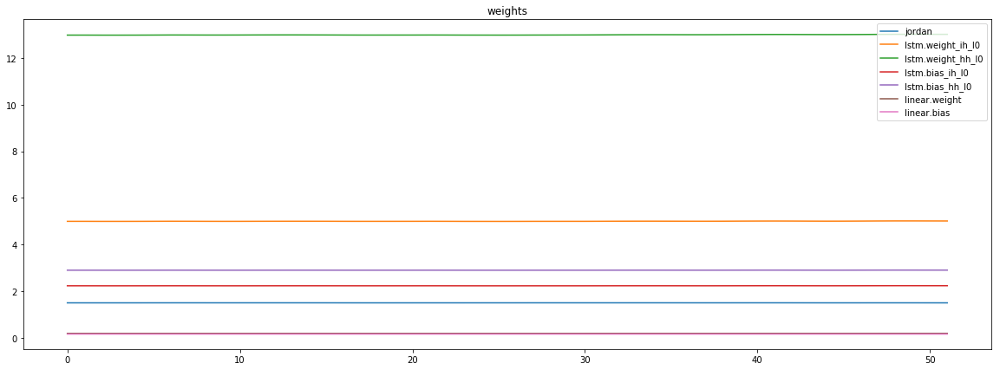

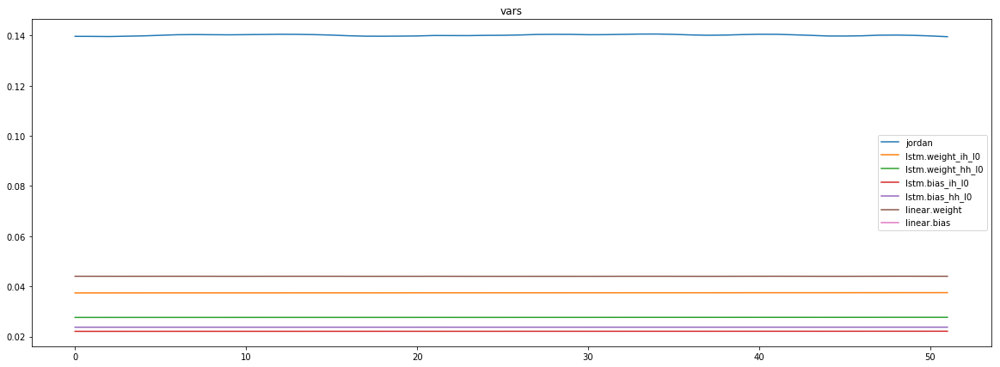

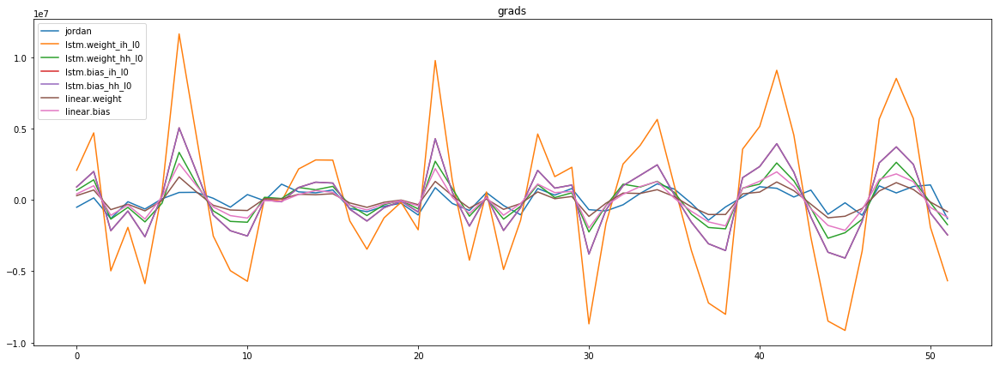

mean_p1 : -4640.389761117788
mean_p2 : 5673.212806114783


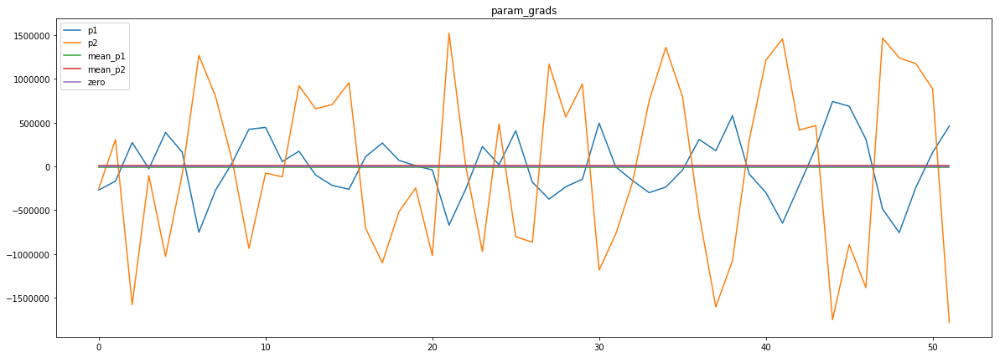

loss rate [0.02685740904316436]
Epoch [96] 
     train_loss[43565.97906024639] 
     eval_train[43522.66511418269] 
     eval_test[45088.74338600853]



aux preds: 0.48574596643447876 1.013832926750183
main loss 0.0
aux loss 23782.875769981973
jord loss 19729.22002704327
combined loss 43512.09579702524 



Parameter containing:
tensor([[0.4857, 1.0138]], requires_grad=True)


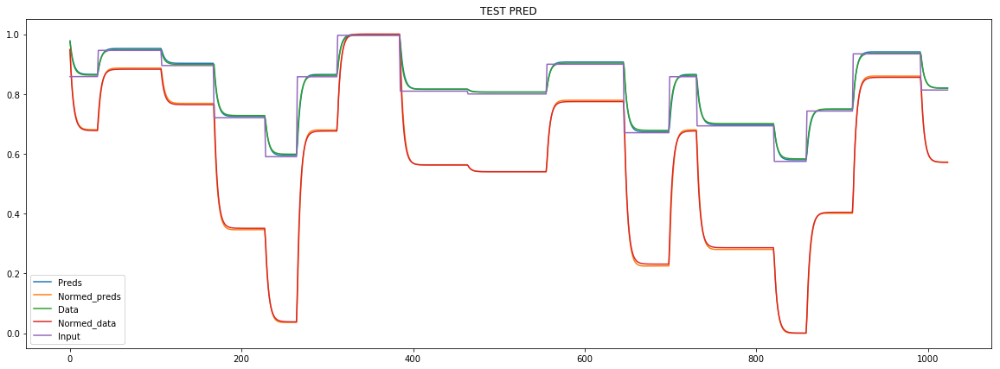

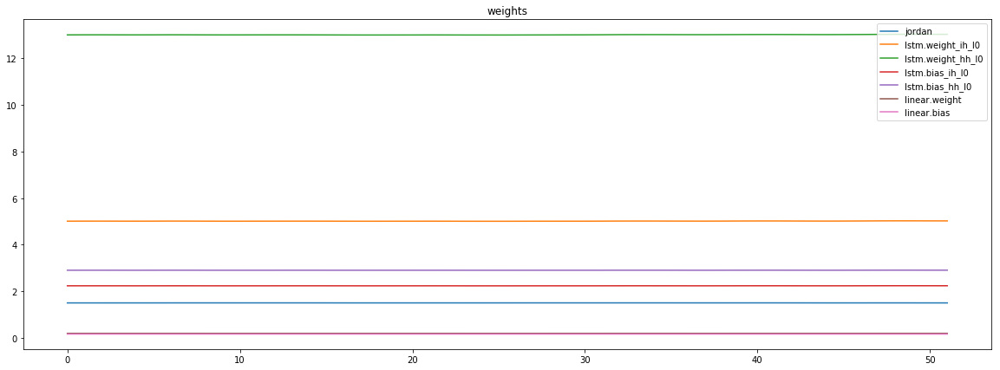

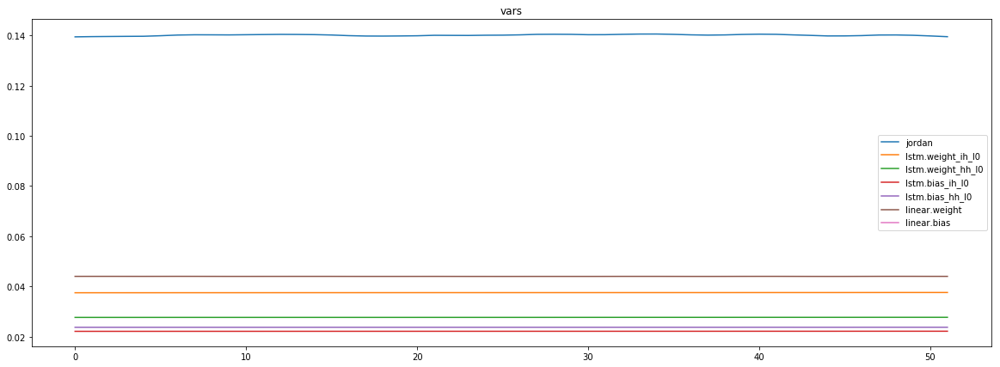

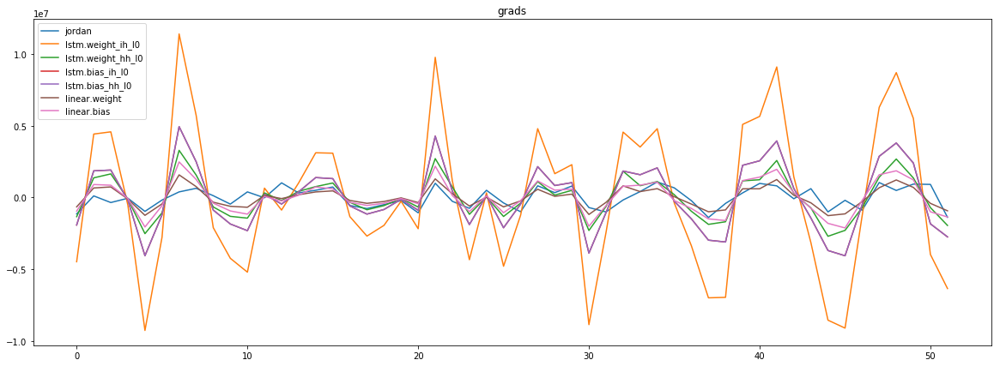

mean_p1 : 969.0216346153846
mean_p2 : -3989.314640925481


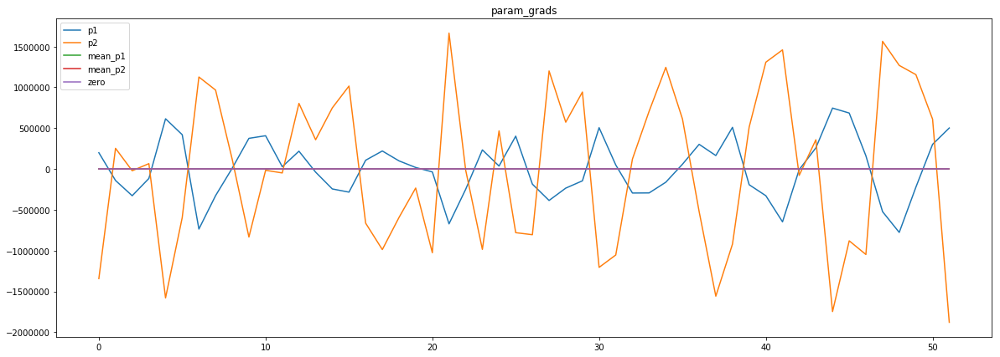

loss rate [0.0037394823105476593]
Epoch [97] 
     train_loss[43512.09579702524] 
     eval_train[43618.61669921875] 
     eval_test[45185.905806107956]



aux preds: 0.4857569932937622 1.0141465663909912
main loss 0.0
aux loss 23541.974646935098
jord loss 19712.273681640625
combined loss 43254.24832857572 



Parameter containing:
tensor([[0.4858, 1.0141]], requires_grad=True)


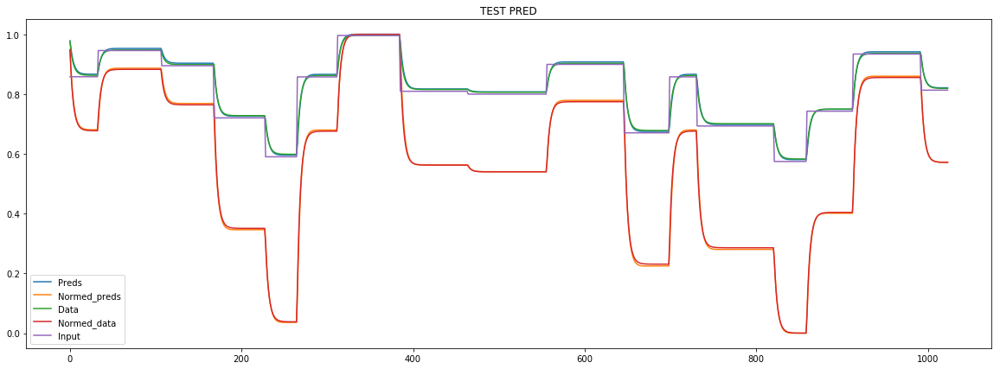

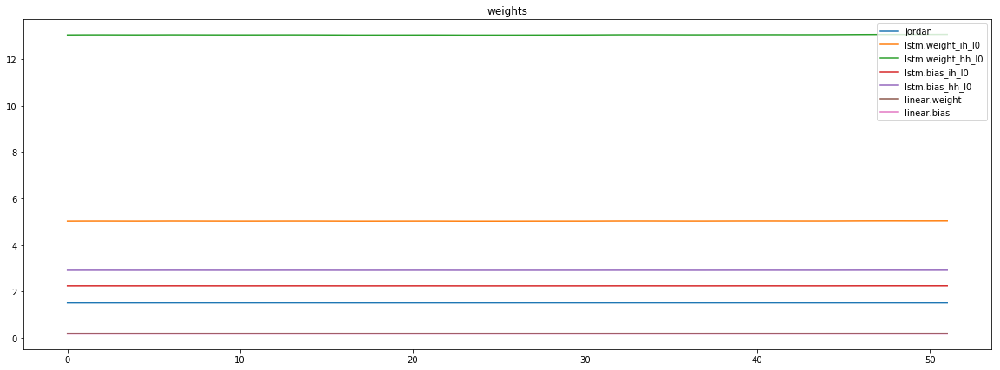

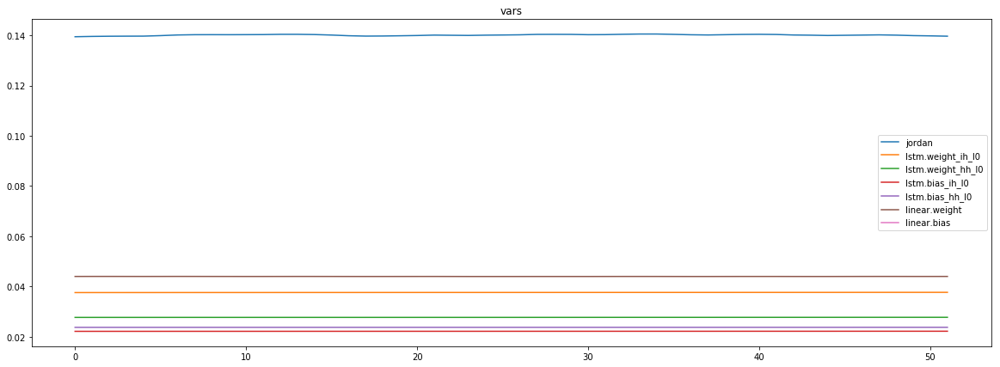

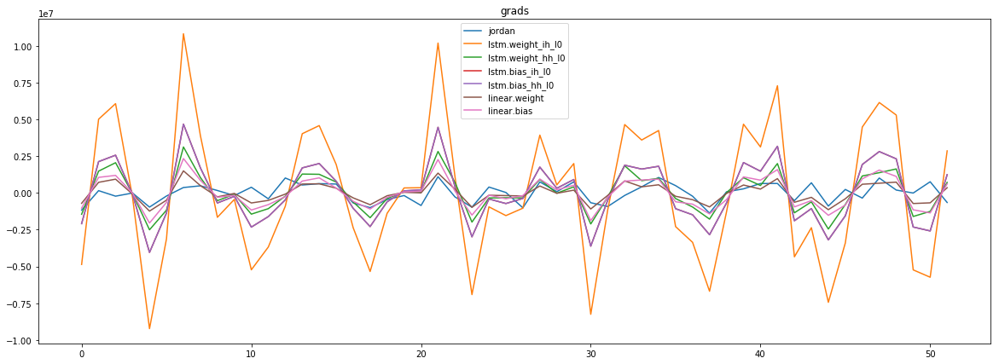

mean_p1 : -2450.0494666466348
mean_p2 : -2201.099158653846


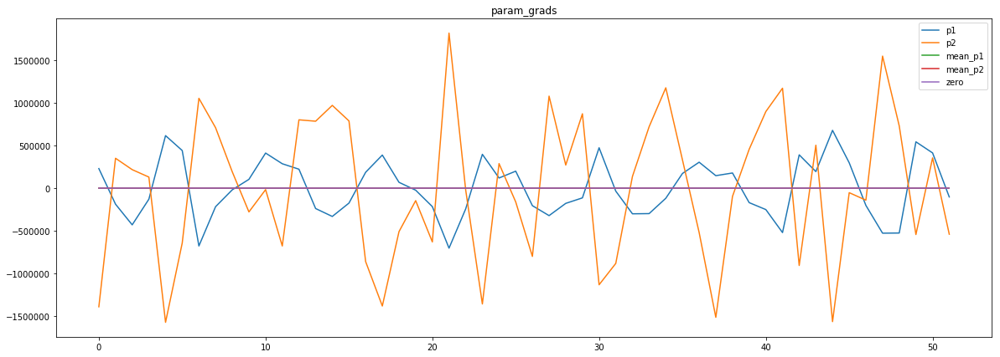

loss rate [0.013503959599246995]
Epoch [98] 
     train_loss[43254.24832857572] 
     eval_train[42795.82861328125] 
     eval_test[44271.13942649147]



aux preds: 0.4857657551765442 1.0142320394515991
main loss 0.0
aux loss 23486.746544471152
jord loss 19715.36756310096
combined loss 43202.11410757211 



Parameter containing:
tensor([[0.4858, 1.0142]], requires_grad=True)


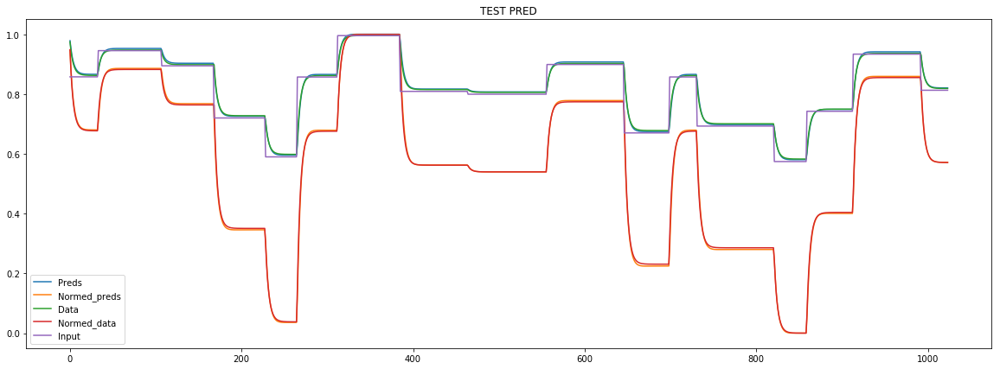

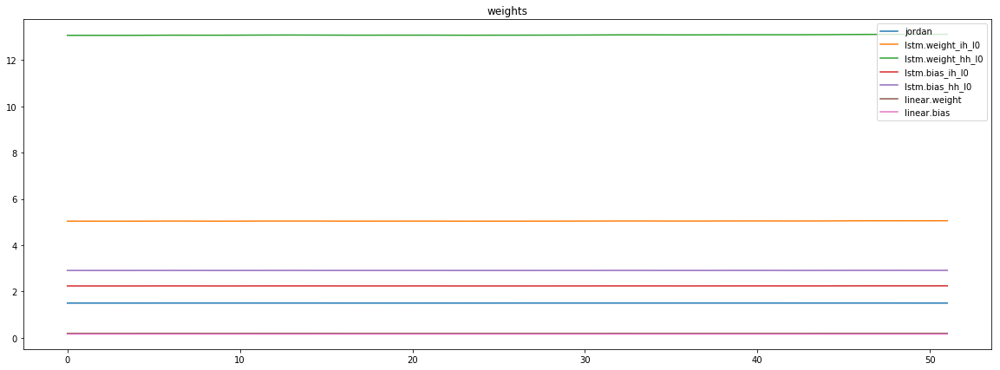

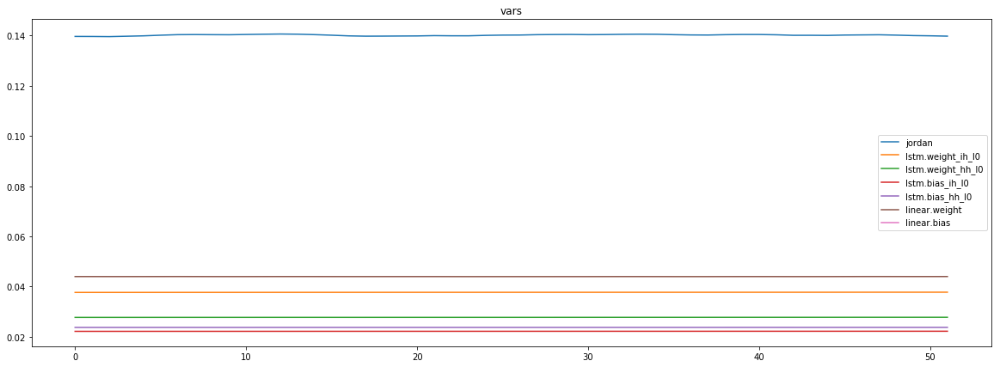

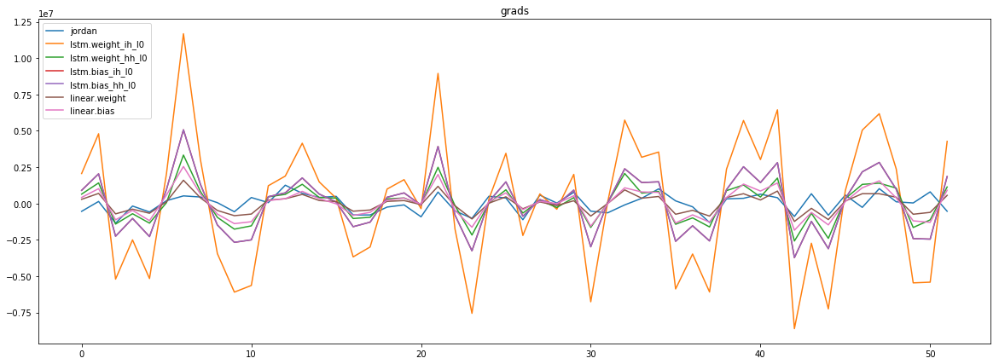

mean_p1 : -1307.1539963942307
mean_p2 : 2438.3106219951924


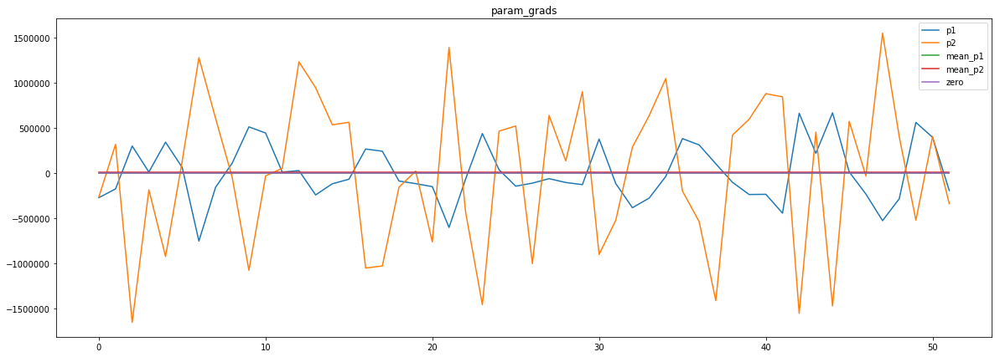

loss rate [0.01489303074688908]
Epoch [99] 
     train_loss[43202.11410757211] 
     eval_train[42768.96533203125] 
     eval_test[44180.66468394887]



aux preds: 0.4857771098613739 1.0144238471984863
main loss 0.0
aux loss 23558.837853064902
jord loss 19706.639141376203
combined loss 43265.47699444111 



Parameter containing:
tensor([[0.4858, 1.0144]], requires_grad=True)


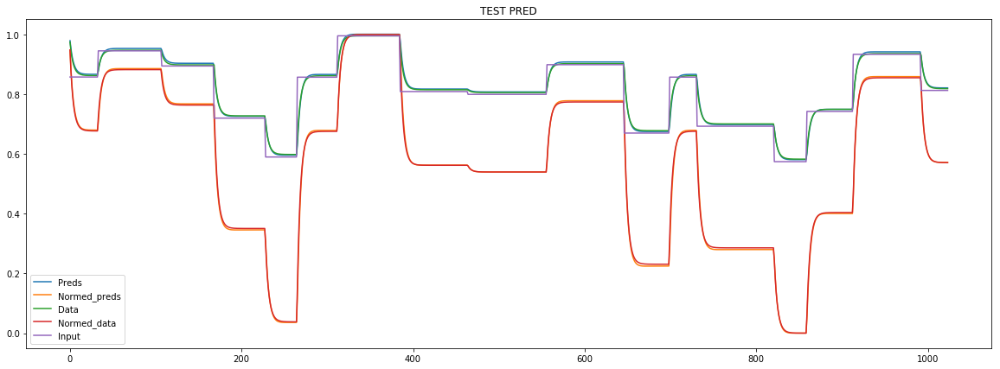

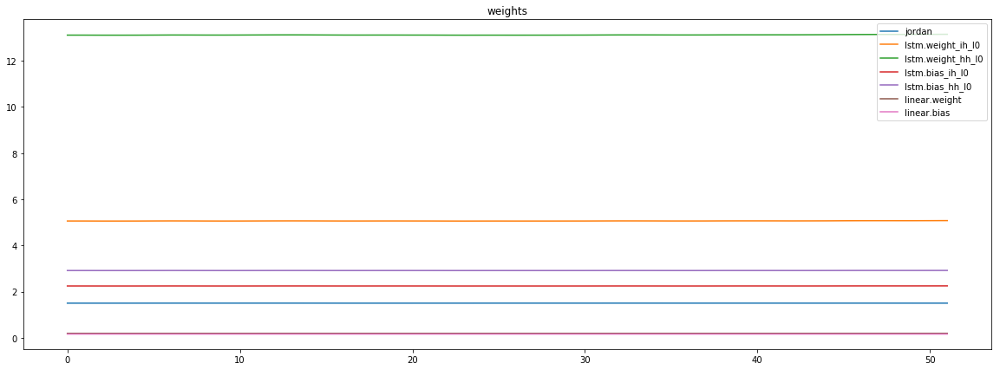

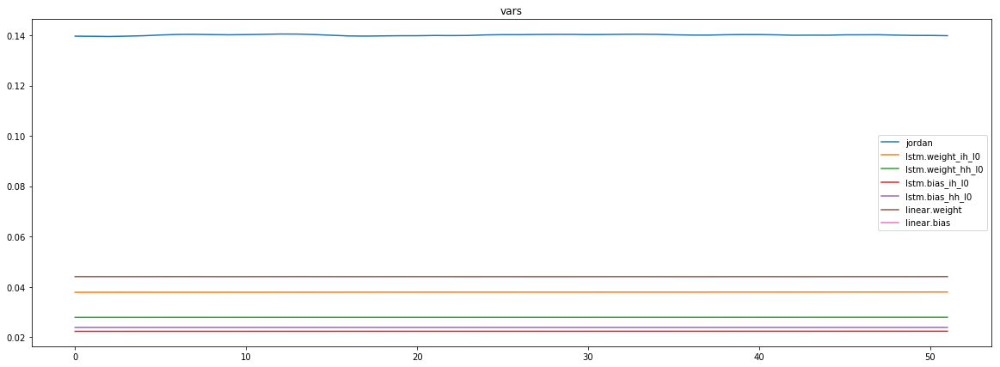

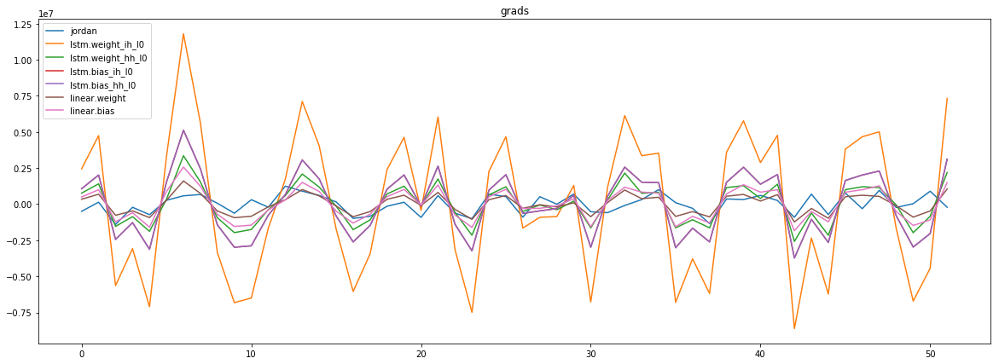

mean_p1 : -2057.248497596154
mean_p2 : 1175.655498798077


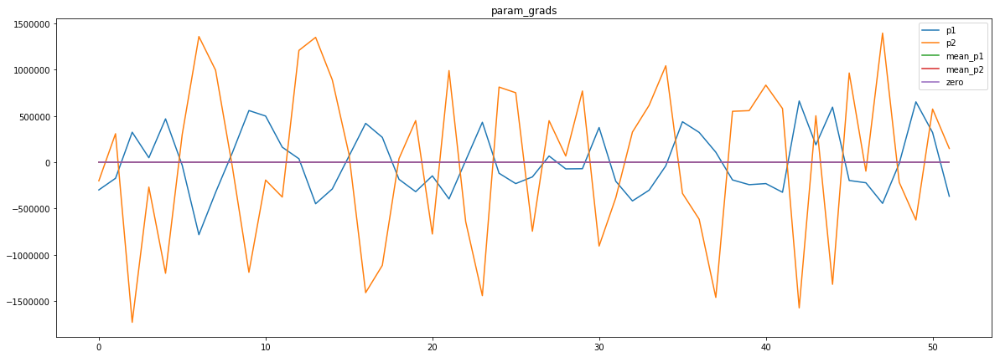

loss rate [0.004710907646046425]
Epoch [100] 
     train_loss[43265.47699444111] 
     eval_train[43083.00775615986] 
     eval_test[44336.05166903409]



aux preds: 0.4858001470565796 1.0142176151275635
main loss 0.0
aux loss 23834.694993239184
jord loss 19709.24455378606
combined loss 43543.93954702524 



Parameter containing:
tensor([[0.4858, 1.0142]], requires_grad=True)


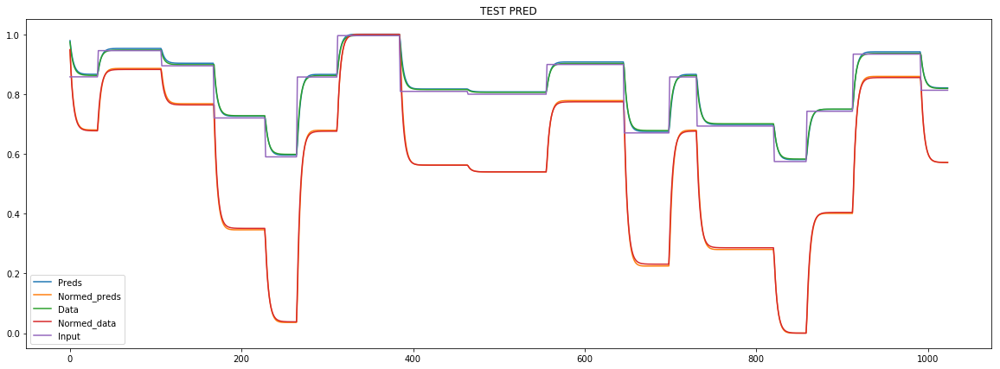

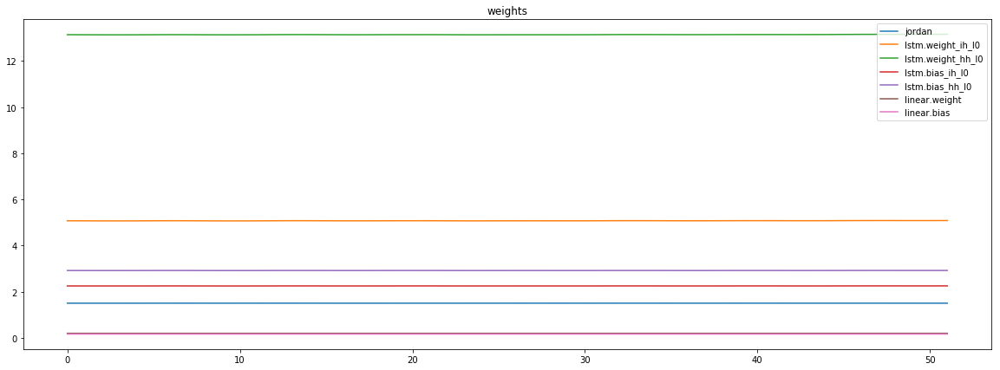

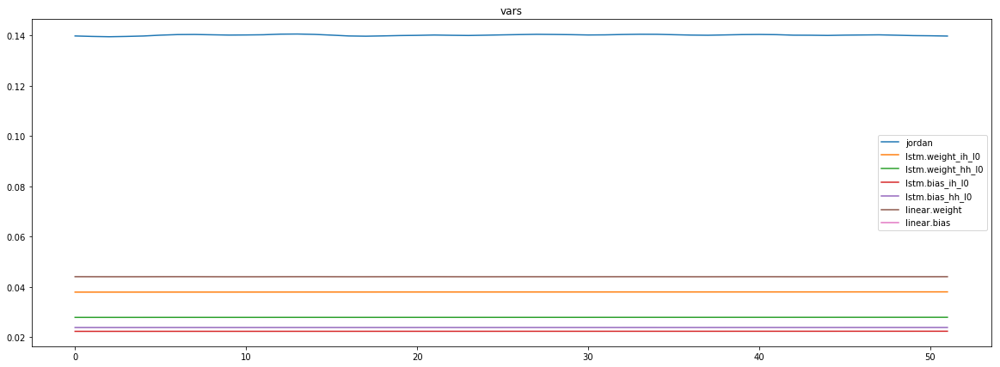

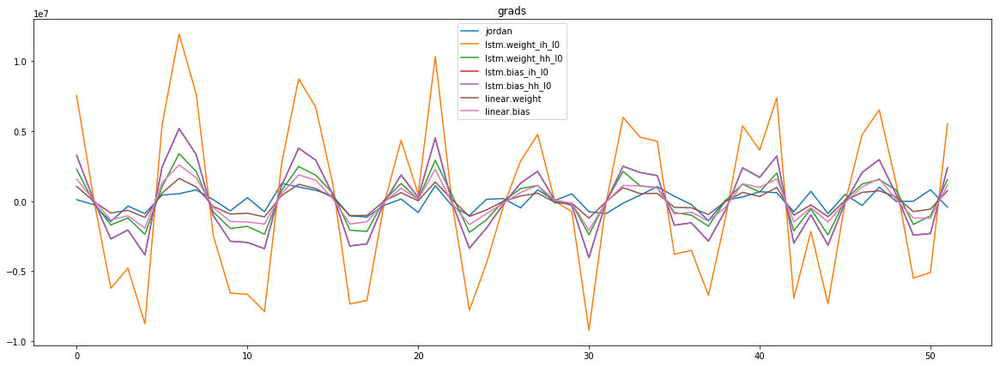

mean_p1 : -4541.048227163462
mean_p2 : -449.6436298076923


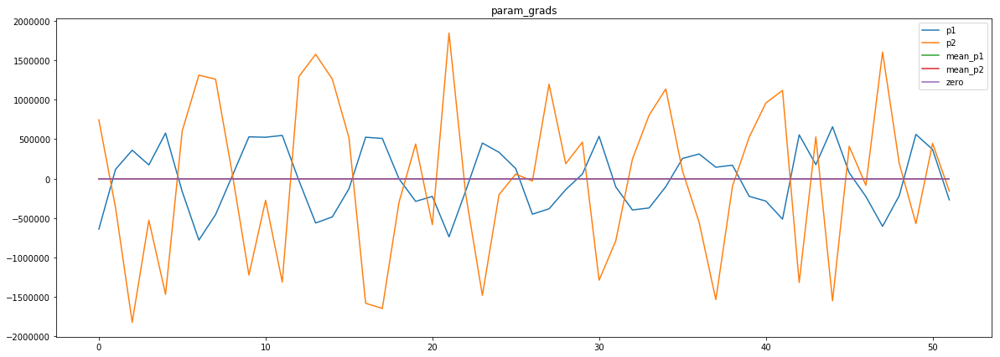

loss rate [0.0026298613166960694]
Epoch [101] 
     train_loss[43543.93954702524] 
     eval_train[42725.871619591344] 
     eval_test[44146.21404474432]



aux preds: 0.48580679297447205 1.0142873525619507
main loss 0.0
aux loss 23323.588961087742
jord loss 19721.775353064902
combined loss 43045.36431415264 



Parameter containing:
tensor([[0.4858, 1.0143]], requires_grad=True)


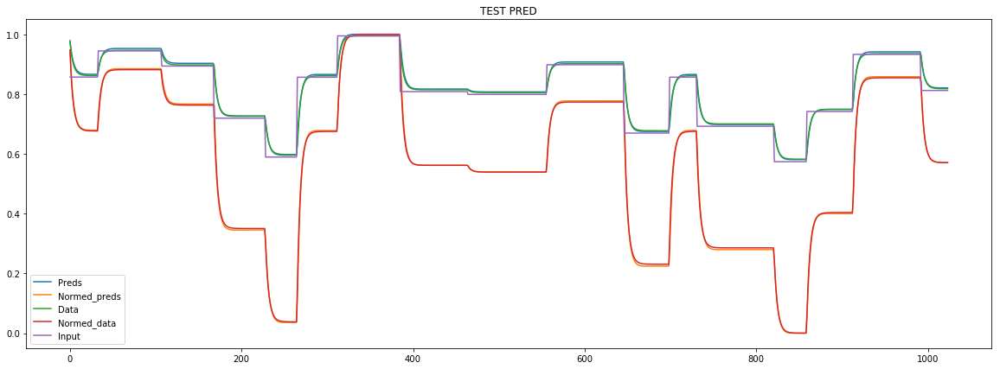

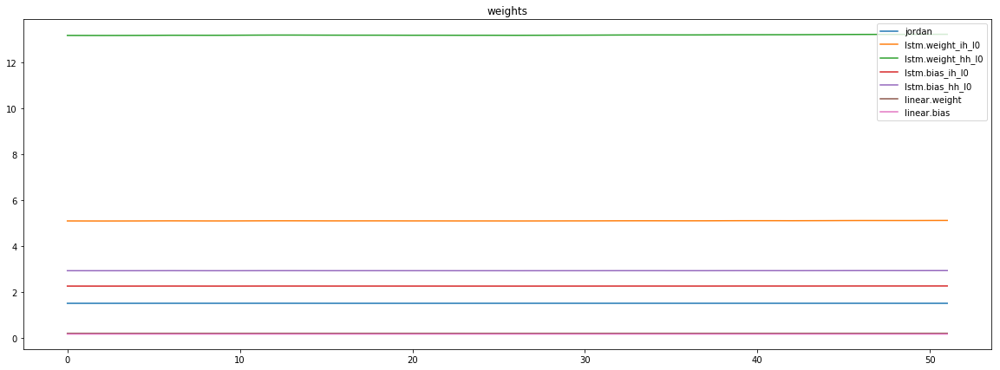

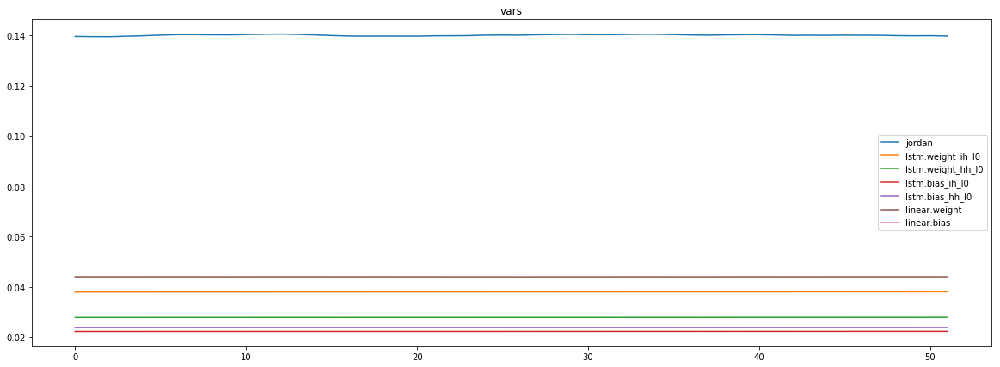

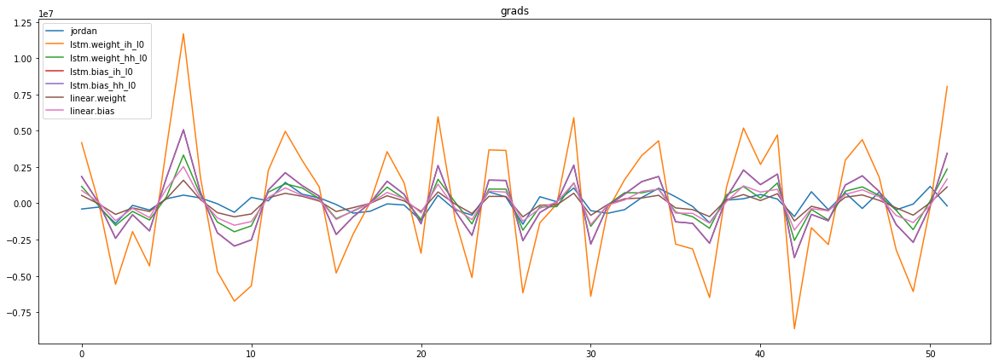

mean_p1 : -2357.6000225360576
mean_p2 : 6034.225435697115


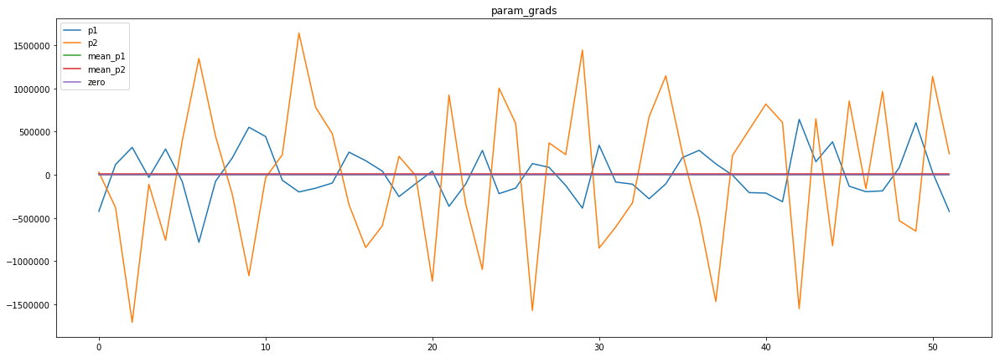

loss rate [-0.0030950443731265764]
Epoch [102] 
     train_loss[43045.36431415264] 
     eval_train[43083.932373046875] 
     eval_test[44357.84268465909]



aux preds: 0.4858401119709015 1.014424204826355
main loss 0.0
aux loss 23864.052790715145
jord loss 19715.86944110577
combined loss 43579.922231820914 



Parameter containing:
tensor([[0.4858, 1.0144]], requires_grad=True)


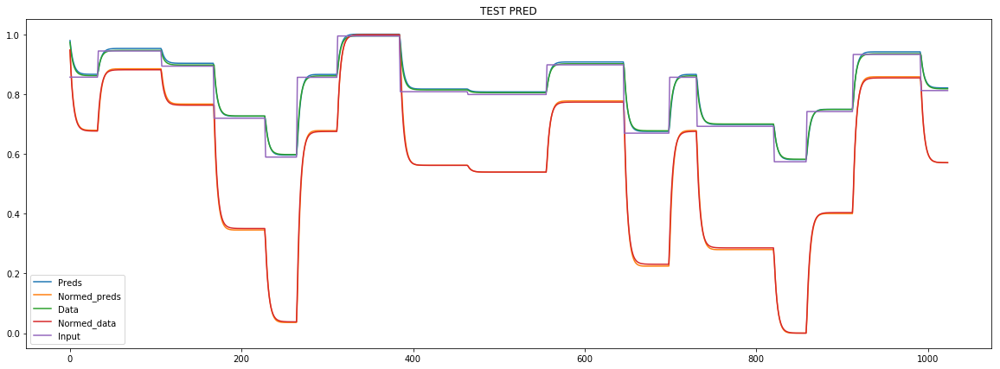

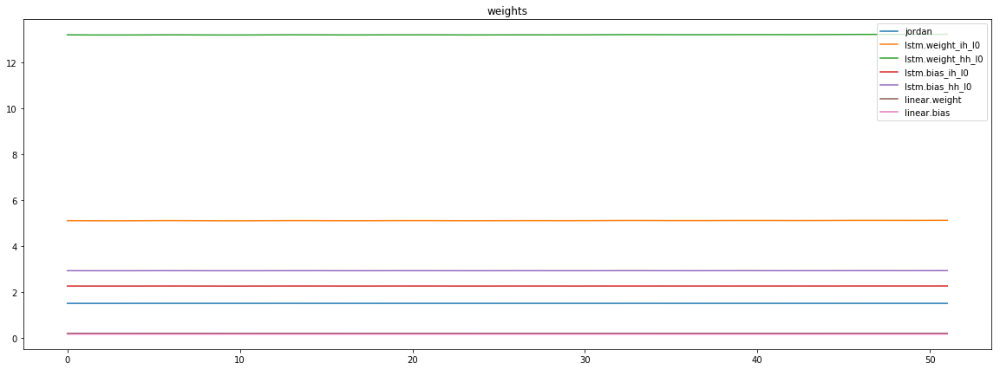

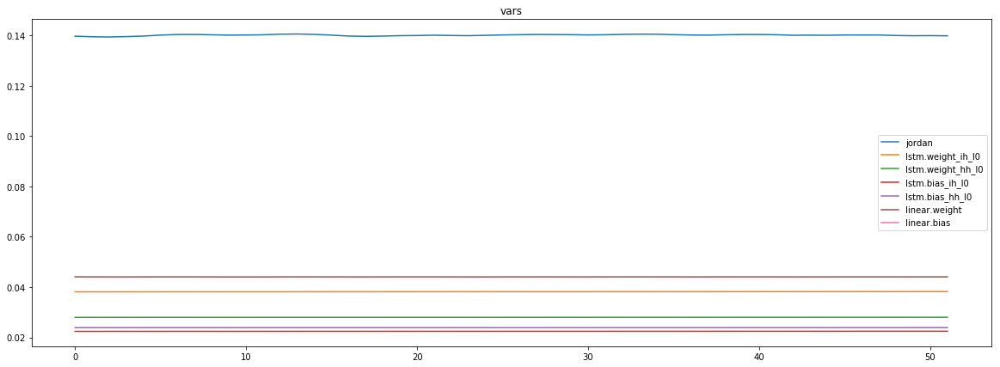

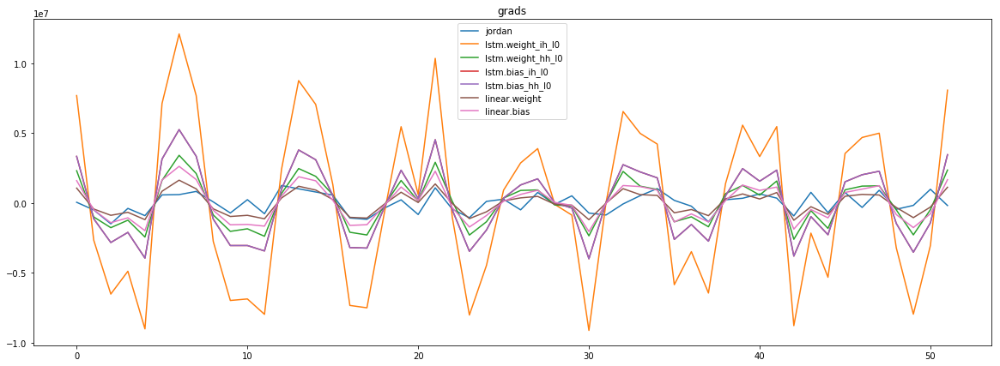

mean_p1 : -3434.825984074519
mean_p2 : -6877.295372596154


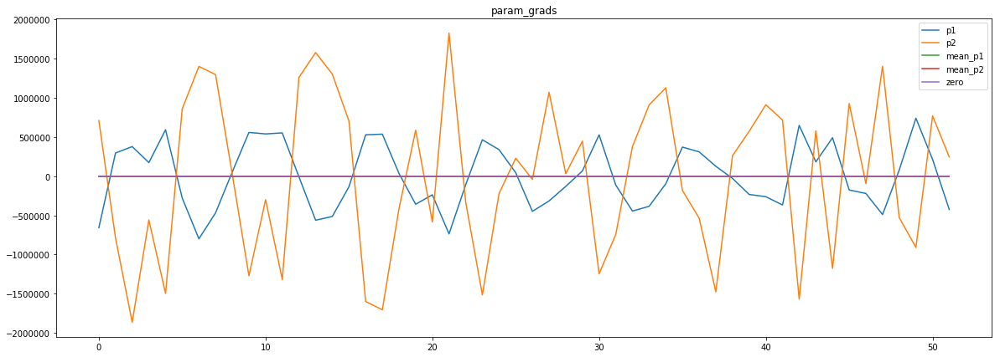

loss rate [-0.013183102811166414]
Epoch [103] 
     train_loss[43579.922231820914] 
     eval_train[43651.932373046875] 
     eval_test[44863.78440163353]



aux preds: 0.48587915301322937 1.0140570402145386
main loss 0.0
aux loss 23595.720665564902
jord loss 19727.917687049277
combined loss 43323.63835261418 



Parameter containing:
tensor([[0.4859, 1.0141]], requires_grad=True)


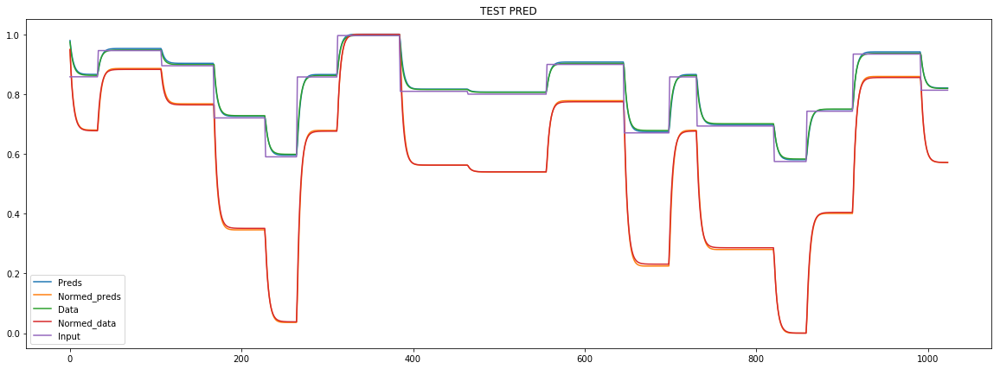

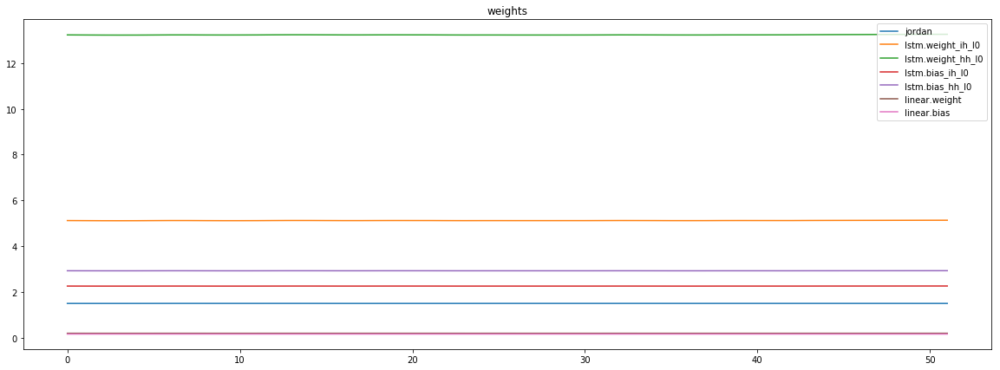

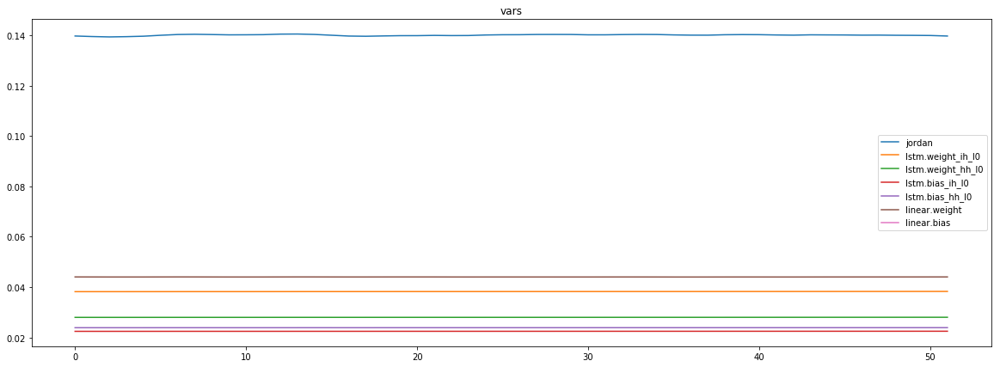

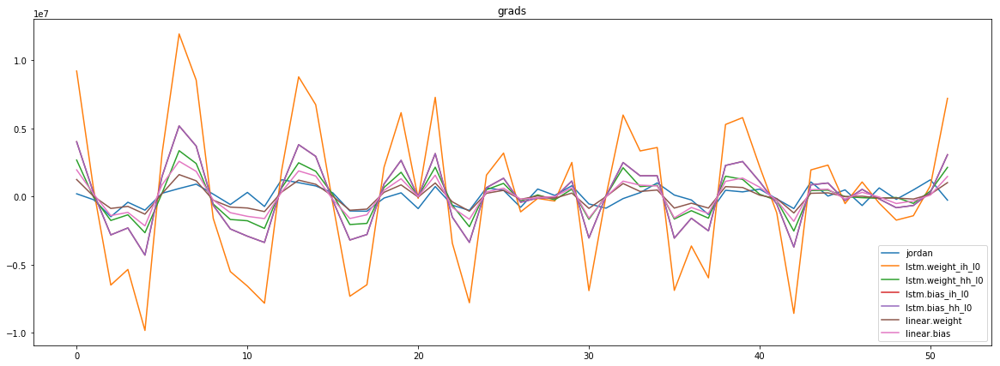

mean_p1 : -9197.672738882211
mean_p2 : 17425.9765625


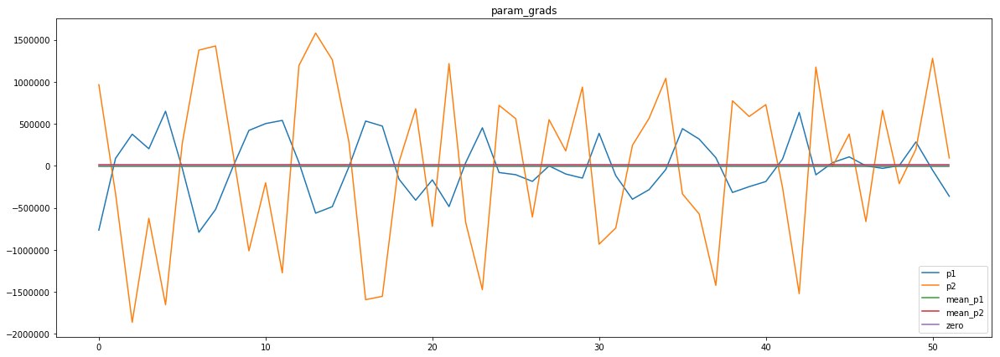

Epoch   104: reducing learning rate of group 0 to 9.0000e-04.
Epoch   104: reducing learning rate of group 1 to 9.0000e-05.
Epoch   104: reducing learning rate of group 2 to 9.0000e-05.
loss rate [0.006271898729867331]
Epoch [104] 
     train_loss[43323.63835261418] 
     eval_train[42669.05947641226] 
     eval_test[44177.12384588068]


KeyboardInterrupt: 

In [19]:
logging.info("Training process STARTED")

model.hidden = model.init_hidden()


for t in range(num_epochs):
    
    batch_local_hist = hist["train"]["batches"]
    long_term_hist = hist["train"]["epochs"]
    
    for i, data in enumerate(tqdm(train_dl)):
        
        model.hidden = model.init_hidden()
        
        y_pred, jordan = batch_iteration(
            iter_index=i,
            model=model,
            optimizer=optimizer,
            batch_data=data,
            backprop=True,
            hist_part=batch_local_hist
        )
        
    hist['mean_params_sample']['1'][t] = jordan[:, 0].item()
    hist['mean_params_sample']['2'][t] = jordan[:, 1].item()
    
    print(f"aux preds: {hist['mean_params_sample']['1'][t]} {hist['mean_params_sample']['2'][t]}")
    
    mean_losses = update_long_term_hist(batches_hist=batch_local_hist,
                                                            long_term_hist=long_term_hist)
    mean_main, mean_aux, mean_jord = mean_losses
    # TODO add w8 decay
    print(f"main loss {mean_main}")
    print(f"aux loss {mean_aux}")
    print(f"jord loss {mean_jord}")
    print(f"combined loss {sum(mean_losses)} ")
    
    # VISUALISE TRAINING PROGRESS
#     x_batch, y_batch, indexes = data
#     plot_shared_scale([
#         (y_pred[:, 0].detach().numpy(),"Preds" ),
#          (y_batch[:, 0].detach().numpy(), "Data"),
#          (x_batch[-1].detach().numpy(), "Input")
#         ],
#         title="TRAIN PREDICT")
          
#     residuals = y_batch[:, 0] - y_pred[:, 0]
#     plot_multiscale([
#         (residuals.detach().numpy(), "Red"),
#         (y_batch[:, 0].detach().numpy(), "Green"),
#         (y_pred[:, 0].detach().numpy(), "Brown")
#     ],
#         title="TRAIN RESID"
#     ) 
    # /VISUALISE TRAINING PROGRESS

    # EVAL
    with torch.no_grad():
          
          model = model.eval()
          
          for i, data in enumerate(tqdm(train_dl)):
              batch_local_hist = hist['eval_train']['batches']
              long_term_hist=hist["eval_train"]["epochs"]
              y_pred, jordan = batch_iteration(
                iter_index=i,
                model=model,
                optimizer=optimizer,
                batch_data=data,
                backprop=False,
                hist_part=batch_local_hist
              )
          
          update_long_term_hist(batches_hist=batch_local_hist,
                                long_term_hist=long_term_hist)
          
          
          for i, data in enumerate(tqdm(test_dl)):
              batch_local_hist = hist['eval_test']['batches']
              long_term_hist=hist["eval_test"]["epochs"]
          
              y_pred_test, jordan = batch_iteration(
                iter_index=i,
                model=model,
                optimizer=optimizer,
                batch_data=data,
                backprop=False,
                hist_part=batch_local_hist
              )
          
          update_long_term_hist(batches_hist=batch_local_hist,
                                long_term_hist=long_term_hist)
          
          model = model.train()
    # /EVAL
          
    # VISUALISE ITERATION PRED
    x_batch_test, y_batch_test, indexes = data
    print(jordan)
          
    sample_y_pred_test = y_pred_test[:, 0].detach().numpy().copy()
    sample_y_pred_test -= np.min(sample_y_pred_test)
    sample_y_pred_test /= (np.max(sample_y_pred_test) - np.min(sample_y_pred_test))
    normed_data = y_batch_test[:, 0].detach().numpy().copy()
    normed_data -= np.min(normed_data)
    normed_data /= (np.max(normed_data) - np.min(normed_data))
    plot_shared_scale([
            (y_pred_test[:, 0].detach().numpy(), "Preds"),
            (sample_y_pred_test,"Normed_preds" ),
             (y_batch_test[:, 0].detach().numpy(), "Data"),
             (normed_data, "Normed_data"),
             (x_batch_test[-1].detach().numpy(), "Input")
    ],
        title = 'TEST PRED'
    )
    
#           print(y_pred.detach().numpy() == y_batch().detach().numpy())
#     plt.plot(y_pred.detach().numpy())
#     plt.show()
    
          # /VISUALISE ITERATION PRED
   
               
    plot_shared_scale([(v,k)for k, v in hist['weights']['batches'].items()], title='weights')
    plot_shared_scale([(v,k)for k, v in hist['vars']['batches'].items()], title='vars')
    plot_shared_scale([(v,k)for k, v in hist['grads']['batches'].items()], title='grads')
    
    param_grads = [(v,k) for k, v in hist['param_grads']['batches'].items()]
    param_grads_means = [ (np.full(v.shape, np.mean(v)), 'mean_' + k ) for v,k in param_grads]
    for par_gr_mean, name in param_grads_means:
          print(f"{name} : {par_gr_mean[0]}")
    plot_shared_scale(param_grads + param_grads_means +
                      [(np.zeros(len(train_dl)), 'zero')], title='param_grads')
          
    visualise_resid = False
    if visualise_resid:
        residuals = y_batch_test[:, 0] - y_pred_test[:, 0]
        plot_multiscale(
                [
                 (residuals.detach().numpy(), "Red"), 
                 (y_batch_test[:, 0].detach().numpy(),"Green")
                ],
            title = 'TEST RESID'
        )
    
    
    # UPDATE LR
    val_loss = slice_loss_sum(hist['eval_test']['epochs'], t)
    scheduler.step(val_loss)
    hist['weights_sum'][t] = torch.as_tensor([p.sum() for p in model.parameters(recurse=True)]).sum().item()
    hist['weights_var'][t] = torch.as_tensor([p.var() for p in model.parameters(recurse=True)]).sum().item()
    
    for name, parameter in model.named_parameters():
          hist['grads']['epochs'][name][t] = np.mean(hist['grads']['batches'][name])
          hist['weights']['epochs'][name][t] = np.mean(hist['weights']['batches'][name])
          hist['vars']['epochs'][name][t] = np.mean(hist['vars']['batches'][name])
    hist['param_grads']['epochs']['p1'][t] = np.mean(hist['param_grads']['batches']['p1'])
    hist['param_grads']['epochs']['p2'][t] = np.mean(hist['param_grads']['batches']['p2'])
          
    
    hist['lr'][t] = scheduler.optimizer.param_groups[0]['lr']
    if hist['lr'][t] <= 10**p_sched['early_stop_order'] * 1.0001: # 1+eps 
          print("Loss critically low, EARLY STOPPING")
          break
          
    if t > 3:
          h = hist["eval_test"]["epochs"]
          loss_rate = 1 - slice_loss_sum(h, t) / np.mean([slice_loss_sum(h, k) for k in range(t-3,t)])          
          hist['loss_rate'][t] = loss_rate              
          print(f"loss rate [{loss_rate}]")
    # /UPDATE LR
                       
    # FINAL PROGRESS LOGGING
    msg = "Epoch [{t}] \n \
    train_loss[{train_loss}] \n \
    eval_train[{eval_train}] \n \
    eval_test[{eval_test}]".format(t=t,
                                train_loss=sum([val[t] for val in hist['train']['epochs'].values()]), 
                                eval_train=sum([val[t] for val in hist['eval_train']['epochs'].values()]),
                                eval_test=sum([val[t] for val in hist['eval_test']['epochs'].values()])
                               )
    print(msg)
    logging.info(msg)
                       
    # /FINAL PROGRESS LOGGING

In [20]:
torch.save(model, 'jordan.pt')

In [ ]:
def get_size(dicts):
    acc = 0
    for key, val in dicts.items():
        if type(val) == dict:
            print(key)
            acc += get_size(val)            
        else:
            acc+=sys.getsizeof(val)
    return acc

In [ ]:
import sys
get_size(hist) / 1024

In [ ]:
s = 100
e = -1
plot_shared_scale([
    (hist['grad_global']['p1'][s:e], 'p1'),
    (hist['grad_global']['p2'][s:e], 'p2'),
    (hist['grad_global']['lstm'][s:e], 'lstm_grad'),
    (hist['grad_global']['linear'][s:e], 'linear_grad'),
    (hist['aux_global'][s:e], 'aux_global')
], title="param_grads")
s =  10
e = -1

In [ ]:
s, e = 0, t

In [ ]:
plot_shared_scale([(v[s:e],k)for k, v in hist['grads']['epochs'].items()])

In [ ]:
plot_shared_scale([(v[s:e],k)for k, v in hist['weights']['epochs'].items()])

In [ ]:
plot_shared_scale([(v[s:e],k)for k, v in hist['vars']['epochs'].items()])

In [ ]:
s = 20
plot_shared_scale([(v[s:e],k)for k, v in hist['param_grads']['epochs'].items()])

In [ ]:
s, e = 0, -1
plot_multiscale([
    (hist['lr'][s:e],"Red" ),
    (hist['loss_rate'][s:e], "Green"),
    (hist['weights_sum'][s:e], "Blue"),
    (hist['weights_var'][s:e], "Yellow"),
    (hist['eval_test']['epochs']['aux'][s:e], "Black")
])

In [ ]:
plot_shared_scale([
    (hist['train']["epochs"]['main'][s:e],"Train" ),
    (hist['eval_train']["epochs"]['main'][s:e], "Eval_train"),
    (hist['eval_test']["epochs"]['main'][s:e], "Eval_test"),
    (hist['train']["epochs"]['aux'][s:e], "aux_train"),
    (hist['eval_train']['epochs']['aux'][s:e], "aux_Eval_train"),
    (hist['eval_test']['epochs']['aux'][s:e], "aux_Eval_test")
])

In [ ]:
plot_shared_scale([
    (hist['train']["epochs"]['jordan'][s:e],"Train" ),
    (hist['eval_train']["epochs"]['jordan'][s:e], "Eval_train"),
    (hist['eval_test']["epochs"]['jordan'][s:e], "Eval_test"),
#     (hist['train']["epochs"]['aux'][s:e], "aux_train"),
#     (hist['eval_train']['epochs']['aux'][s:e], "aux_Eval_train"),
#     (hist['eval_test']['epochs']['aux'][s:e], "aux_Eval_test")
])

In [ ]:
plot_shared_scale([
    (hist['train']["epochs"]['jordan'][s:e],"Train" ),
    (hist['eval_train']["epochs"]['jordan'][s:e], "Eval_train"),
    (hist['eval_test']["epochs"]['jordan'][s:e], "Eval_test"),
    (hist['train']["epochs"]['aux'][s:e], "aux_train"),
    (hist['eval_train']['epochs']['aux'][s:e], "aux_Eval_train"),
    (hist['eval_test']['epochs']['aux'][s:e], "aux_Eval_test")
])

In [ ]:
# To the prove of faster convergence

In [ ]:
plot_multiscale(
[
    (hist['eval_test']["epochs"]['jordan'][s:e], 'Green'),
    
    (hist['eval_test']["epochs"]['aux'][s:e], 'Red'),
]
)

In [ ]:
for n, v in model.named_parameters():
    print(n, "\t", v.shape, "\t", v.sum())

In [ ]:
plot_shared_scale([
                  (hist['mean_params_sample']['1'][s:e], "p1"),
                  ((hist['mean_params_sample']['2']*0 + 1)[s:e], "p2"),
                  (hist['mean_params_sample']['2'][s:e], "p2"),
                  ((hist['mean_params_sample']['2']*0 + 0.5)[s:e], "p2"),
])

In [ ]:
model.buffers

In [ ]:
logging.info("Training process END")